In [1]:
import numpy as np
import time
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM,Dense, Dropout
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import mean_absolute_error, mean_squared_error
from tabulate import tabulate
from scipy.signal import welch
import matplotlib.pyplot as plt
import pandas as pd
from tensorflow.keras.callbacks import Callback
from tensorflow.keras.models import load_model

In [2]:
def gensenales(signal_len,f1,f2,f3,am1,am2,am3,Time,wo):
  fs = signal_len/Time
  t = np.linspace(0, Time, signal_len)
  signal = (am1 * np.cos(wo * f1 * t) - am2 * np.sin(wo * f2 * t) +am3 * np.cos(wo * f3 * t))
  return signal

In [3]:
def noise_gaussian(len_signal, sigmas, num_repeats,signal):
    ruido = []
    for _ in range(num_repeats):
      noise = np.random.normal(0, sigmas, len_signal)
      ruido.append(noise)
    señales_con_ruido = signal + ruido
    return np.array(señales_con_ruido)

In [4]:
def umbral_error(calculado,frec):
  from scipy.signal import find_peaks

  # Encontrar picos en la PSD
  peaks, _ = find_peaks(calculado, height=0.01)  # Ajusta el parámetro 'height' según sea necesario

  # Obtener las frecuencias y valores de PSD correspondientes a los picos
  peak_freqs = frec[peaks]
  peak_psd_values = calculado[peaks]
  # Establecer un rango para buscar armónicos
  harmonic_indices = []

  # Buscar picos que se asemejan a frecuencias armónicas
  for base_freq in range(1, 6):  # Probar con armónicos de 1 a 5 veces
      target_freq = base_freq * 50  # Ajusta '50' según la frecuencia fundamental esperada
      idx = np.argmin(np.abs(peak_freqs - target_freq))
      if np.abs(peak_freqs[idx] - target_freq) < 10:  # Tolerancia de 10 Hz
          harmonic_indices.append(idx)

  # Seleccionar los armónicos más importantes
  harmonic_peaks = [peak_freqs[i] for i in harmonic_indices]
  # Determinar el valor del menor pico detectado
  if len(peak_psd_values) > 0:
      min_peak_value = min(peak_psd_values)
  else:
      min_peak_value = 0
  return peak_freqs, peak_psd_values, min_peak_value


In [50]:
def ploteo_umbral(calculado,frec,peak_freqs,peak_psd_values,min_peak_value):
  min_peak_value=min_peak_value/2
  plt.figure(figsize=(10, 6))
  plt.semilogy(frec, calculado, label='PSD')
  plt.scatter(peak_freqs, peak_psd_values, color='red', marker='x', label='Picos detectados')
  # Configurar el gráfico
  plt.title('Densidad Espectral de Potencia (Welch)')
  plt.xlabel('Frecuencia (Hz)')
  plt.ylabel('PSD')
  plt.legend()
  plt.axhline(y=min_peak_value, color='blue', linestyle='--', label=f'Umbral ({min_peak_value:.1e})')
  plt.xlim(0,7)
  plt.ylim(10**-8, 10**1)
  plt.grid(True)
  plt.show()

In [6]:
def calcular_welch_arreglo(señales, fs):
    num_signals = señales.shape[0]
    psd_array = []
    freqs = []
    for i in range(num_signals):
        freq, Pxx_den = welch(señales[i], fs=fs, nperseg=1024)
        psd_array.append(Pxx_den)
        freqs.append(freq)
    psd_array = np.array(psd_array)
    freq_array= np.array(freqs)
    return freq_array, psd_array

In [20]:
def create_model(input_shape, output_shape,ruido1,psds1):
    model = Sequential()
    model.add(Dense(256, input_shape=(input_shape,), activation='relu'))
    model.add(Dropout(0.3))
    model.add(Dense(256, activation='relu'))
    model.add(Dropout(0.3))
    model.add(Dense(128, activation='relu'))
    model.add(Dropout(0.3))
    model.add(Dense(output_shape, activation='linear'))
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')

    X_train, X_test, y_train, y_test = train_test_split(ruido1, psds1, test_size=0.3, random_state=42)
    entrenamiento,history,final_epoch, final_mse, final_l1, final_l2, final_rmse, training_time=train_model_with_metrics(model, X_train, y_train, X_test, y_test, epochs=500)
    return model,final_epoch, final_mse, final_l1, final_l2, final_rmse, training_time,X_test,y_test

In [8]:
def create_model_2(input_shape, output_shape):
    model = Sequential()

    # Añadir una capa LSTM. El número de unidades puede ajustarse según el problema.
    model.add(LSTM(64, input_shape=(input_shape,1), return_sequences=True))
    model.add(Dropout(0.4))

    # Añadir una segunda capa LSTM. Opcionalmente, puedes añadir más capas LSTM.
    model.add(LSTM(32, return_sequences=False))
    model.add(Dropout(0.4))

    # Capa densa para la salida
    model.add(Dense(output_shape, activation='linear'))

    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    return model

In [74]:
def calcular_psd(senal, fs, nperseg):
    """Calcula la densidad espectral de potencia (PSD) usando el método de Welch."""
    f, Pxx_den = welch(senal, fs=fs, nperseg=nperseg)
    return f, Pxx_den

In [67]:
import numpy as np
def generar_senal(frecuencia_base, armonicos, duracion, fs, ruido_amplitud=0):
    """
    Genera una señal con armónicos específicos y ruido opcional.

    Args:
        frecuencia_base (float): Frecuencia base de la señal.
        armonicos (list): Lista de frecuencias de los armónicos a incluir.
        duracion (float): Duración de la señal en segundos.
        fs (int): Frecuencia de muestreo.
        ruido_amplitud (float): Amplitud del ruido gaussiano a añadir.

    Returns:
        np.array: Señal generada.
    """
    t = np.arange(0, duracion, 1/fs)
    senal = np.zeros(len(t))
    for armonico in armonicos:
        senal += np.sin(2 * np.pi * armonico * t)

    # Añadir ruido
    senal += ruido_amplitud * np.random.randn(len(t))
    return senal

In [75]:
def realizar_experimento(num_iteraciones=1000, fs=100, duracion=10, ruido_amplitud=0.1):
    """
    Realiza el experimento de detección de armónicos.

    Args:
        num_iteraciones (int): Número de iteraciones a realizar.
        fs (int): Frecuencia de muestreo.
        duracion (float): Duración de la señal en segundos.
        ruido_amplitud (float): Amplitud del ruido gaussiano a añadir.

    Returns:
        dict: Resultados del experimento indicando la eficacia de la detección.
    """
    # Frecuencias objetivo
    frecuencias_objetivo = [1, 3, 5]
    resultados = []

    for _ in range(num_iteraciones):
        # Decidir aleatoriamente si cada armónico se incluye o no
        armonicos_presentes = [np.random.choice([True, False]) for _ in frecuencias_objetivo]
        armonicos = [freq for freq, presente in zip(frecuencias_objetivo, armonicos_presentes) if presente]

        # Generar señal
        senal = generar_senal(0, armonicos, duracion, fs, ruido_amplitud)

        # Calcular PSD
        f, Pxx = calcular_psd(senal, fs,len(senal))

        # Detección de frecuencias
        deteccion = detectar_frecuencias_especificas(Pxx, f)

        # Guardar resultado
        resultados.append({
            'armonicos_presentes': armonicos_presentes,
            'deteccion': deteccion
        })

    return resultados

In [69]:
def calcular_eficacia(resultados):
    """
    Calcula la eficacia de la detección de armónicos.

    Args:
        resultados (list): Lista de resultados del experimento.

    Returns:
        dict: Métricas de eficacia de la detección.
    """
    detecciones_correctas = {1: 0, 3: 0, 5: 0}
    detecciones_incorrectas = {1: 0, 3: 0, 5: 0}

    for resultado in resultados:
        armonicos_presentes = resultado['armonicos_presentes']
        deteccion = resultado['deteccion']

        for freq in [1, 3, 5]:
            presente = armonicos_presentes[freq//2]  # 1->0, 3->1, 5->2
            detectado = bool(deteccion[freq])
            if presente and detectado:
                detecciones_correctas[freq] += 1
            elif not presente and not detectado:
                detecciones_correctas[freq] += 1
            else:
                detecciones_incorrectas[freq] += 1

    total_pruebas = len(resultados) * 3  # Tres frecuencias objetivo por iteración
    eficacia = {freq: (detecciones_correctas[freq] / len(resultados)) * 100 for freq in [1, 3, 5]}
    error = {freq: (detecciones_incorrectas[freq] / len(resultados)) * 100 for freq in [1, 3, 5]}

    # Eficacia total y error total
    eficacia_total = sum(detecciones_correctas.values()) / total_pruebas * 100
    error_total = sum(detecciones_incorrectas.values()) / total_pruebas * 100

    return {'eficacia': eficacia, 'error': error, 'eficacia_total': eficacia_total, 'error_total': error_total}

In [70]:
def graficar_eficacia(metricas):
    """
    Grafica la eficacia y el error de detección.

    Args:
        metricas (dict): Métricas de eficacia y error.
    """
    labels = ['1 Hz', '3 Hz', '5 Hz', 'Total']
    eficacia = [metricas['eficacia'][1], metricas['eficacia'][3], metricas['eficacia'][5], metricas['eficacia_total']]
    error = [metricas['error'][1], metricas['error'][3], metricas['error'][5], metricas['error_total']]

    x = np.arange(len(labels))
    width = 0.35

    fig, ax = plt.subplots()
    rects1 = ax.bar(x - width/2, eficacia, width, label='Eficacia')
    rects2 = ax.bar(x + width/2, error, width, label='Error')

    ax.set_xlabel('Frecuencia')
    ax.set_ylabel('Porcentaje (%)')
    ax.set_title('Eficacia y Error de Detección')
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    ax.legend()

    fig.tight_layout()
    plt.show()


In [17]:
class MetricsPlotCallback(Callback):
  def __init__(self, X_test, y_test, interval=50):
      super().__init__()
      self.X_test = X_test
      self.y_test = y_test
      self.interval = interval
      self.epochs = []
      self.mse_values = []
      self.l1_values = []
      self.l2_values = []
      self.rmse_values = []

  def on_epoch_end(self, epoch, logs=None):
      if (epoch + 1) % self.interval == 0:
          y_pred = self.model.predict(self.X_test)
          mse = mean_squared_error(self.y_test, y_pred)
          l1 = mean_absolute_error(self.y_test, y_pred)
          l2 = np.sqrt(mse)  # L2 norm is equivalent to RMSE
          rmse = l2

          self.epochs.append(epoch + 1)
          self.mse_values.append(mse)
          self.l1_values.append(l1)
          self.l2_values.append(l2)
          self.rmse_values.append(rmse)

          # Plotting the metrics
          plt.figure(figsize=(14, 8))

          plt.subplot(2, 2, 1)
          plt.plot(self.epochs, self.mse_values, marker='o', label='MSE')
          plt.xlabel('Epoch')
          plt.ylabel('MSE')
          plt.yscale('log')
          plt.title('Mean Squared Error')
          plt.grid(True)

          plt.subplot(2, 2, 2)
          plt.plot(self.epochs, self.l1_values, marker='o', label='L1')
          plt.xlabel('Epoch')
          plt.ylabel('L1')
          plt.yscale('log')
          plt.title('Mean Absolute Error (L1)')
          plt.grid(True)

          plt.subplot(2, 2, 3)
          plt.plot(self.epochs, self.l2_values, marker='o', label='L2')
          plt.xlabel('Epoch')
          plt.ylabel('L2')
          plt.yscale('log')
          plt.title('L2 Norm')
          plt.grid(True)
          plt.subplot(2, 2, 4)
          plt.plot(self.epochs, self.rmse_values, marker='o', label='RMSE')
          plt.xlabel('Epoch')
          plt.ylabel('RMSE')
          plt.yscale('log')
          plt.title('Root Mean Squared Error (RMSE)')
          plt.grid(True)

          plt.tight_layout()
          plt.show()


In [41]:
def promedio(psd_preds2,y_test,frec):
  # Comparación muestra a muestra vs promedio de todas las muestras
  avg_pred = np.mean(psd_preds2, axis=0)
  avg_real = np.mean(y_test, axis=0)
  avg_pred = np.squeeze(avg_pred)
  avg_real = np.squeeze(avg_real)
  plt.figure(figsize=(12, 6))
  plt.plot(frec, avg_real, label='PSD Real Promedio', color='blue')
  plt.plot(frec, avg_pred, label='PSD Predicho Promedio', color='red')
  plt.xlabel('Frequency')
  plt.ylabel('PSD')
  plt.title('Comparación entre PSD Real y Predicha (Promedio de todas las muestras)')
  plt.legend()
  plt.grid(True)
  plt.yscale('log')
  plt.xlim(0, 5)
  plt.ylim(10**-1, 10**0.4)
  plt.show()

In [77]:
def detectar_frecuencias_especificas(psd, freqs, umbral_factor=0.5):
    """
    Detecta las frecuencias específicas de 1 Hz, 3 Hz y 5 Hz en el PSD.

    Args:
        psd (numpy array): Densidad espectral de potencia.
        freqs (numpy array): Array de frecuencias correspondiente al PSD.
        umbral_factor (float): Factor para calcular el umbral basado en la potencia del armónico de 5 Hz.

    Returns:
        dict: Diccionario con 0 o 1 indicando si se detecta cada frecuencia.
    """
    # Frecuencias de interés
    frecuencias_objetivo = [1, 3, 5]

    # Encuentra los índices de las frecuencias más cercanas a 1 Hz, 3 Hz, y 5 Hz
    indices_objetivo = [np.argmin(np.abs(freqs - f)) for f in frecuencias_objetivo]

    # Calcula el umbral basado en la mitad del valor promedio de la potencia a 5 Hz
    umbral = umbral_factor * np.mean(psd[indices_objetivo[2]])

    deteccion = {}
    for i, freq in zip(indices_objetivo, frecuencias_objetivo):
        deteccion[freq] = 1 if psd[i] >= umbral else 0

    return deteccion

In [18]:
def plotear_comparacion(psd_preds1,calculados,frec):
  psd_preds = psd_preds1.squeeze()  # Si psd_preds tiene forma (1, 350), esto lo convierte en (350,)
  frec = frec.squeeze()

  # Graficar ambas curvas en el mismo gráfico
  plt.figure(figsize=(12, 8))
  plt.semilogy(frec, calculados[0], label='PSD de la señal de prueba original', color='blue')
  plt.semilogy(frec, psd_preds, label='PSD de la señal de prueba predicha', color='red', linestyle='--')
  plt.xlabel('Frecuencia (Hz)')
  plt.ylabel('Densidad Espectral de Potencia (PSD)')
  plt.title('Comparación de Densidad Espectral de Potencia (PSD)')
  plt.grid(True)
  plt.xlim(0, 8)  # Ajusta el rango de frecuencias si es necesario
  plt.yscale('symlog')
  plt.ylim(10**-10, 10**0.7)
  plt.legend()
  plt.show()

  # Calcular la distancia euclidiana entre los PSDs
  # Asegúrate de que los datos sean arrays numpy
  calculado = calculados.squeeze()  # Si calculado tiene forma (1, 350), esto lo convierte en (350,)
  psd_preds = psd_preds.squeeze()
  distancia_euclidiana = np.linalg.norm(calculado - psd_preds)

  # Calcular el porcentaje de error
  # Se asume que calculado no tiene valores cero para evitar división por cero
  error = np.abs((calculados - psd_preds) / (calculados + 1e-10))  # Añadir un pequeño valor para evitar división por cero
  porcentaje_error = np.mean(error) * 100

  # Imprimir los resultados
  print(f"Distancia Euclidiana entre los PSDs: {distancia_euclidiana:.4f}")

In [16]:
def train_model_with_metrics(model,X_train, y_train, X_test, y_test, epochs=350):

  # Create and use the custom callback
  metrics_plot_callback = MetricsPlotCallback(X_test, y_test, interval=50)
  start_time = time.time()  # Record start time
  history = model.fit(X_train, y_train,
                    epochs=epochs,
                    batch_size=16,
                    validation_data=(X_test, y_test),
                    callbacks=[metrics_plot_callback])
  end_time = time.time()  # Record end time
  training_time = end_time - start_time

  # Final metrics
  final_epoch = metrics_plot_callback.epochs[-1] if metrics_plot_callback.epochs else epochs
  final_mse = metrics_plot_callback.mse_values[-1] if metrics_plot_callback.mse_values else np.nan
  final_l1 = metrics_plot_callback.l1_values[-1] if metrics_plot_callback.l1_values else np.nan
  final_l2 = metrics_plot_callback.l2_values[-1] if metrics_plot_callback.l2_values else np.nan
  final_rmse = metrics_plot_callback.rmse_values[-1] if metrics_plot_callback.rmse_values else np.nan

  loss = history.history['loss']
  val_loss = history.history['val_loss']

  # Graficar las métricas de rendimiento
  plt.figure(figsize=(12, 6))
  plt.plot(loss, label='Training Loss')
  plt.plot(val_loss, label='Validation Loss')
  plt.xlabel('Epochs')
  plt.ylabel('Loss')
  plt.title('Model Loss')
  plt.legend()
  plt.grid(True)
  plt.show()

  return model, history, final_epoch, final_mse, final_l1, final_l2, final_rmse, training_time

In [11]:
def plotear_tablas(final_epoch, final_mse, final_l1, final_l2, final_rmse, training_time):
  # Crear una tabla con los resultados
  # Print final metrics in a table
  print("\nFinal Metrics:")
  print(f"{'Metric':<10} {'Value':<10}")
  print(f"{'-'*20}")
  print(f"{'Epoch':<10} {final_epoch:<10}")
  print(f"{'MSE':<10} {final_mse:<10.4f}")
  print(f"{'L1':<10} {final_l1:<10.4f}")
  print(f"{'L2':<10} {final_l2:<10.4f}")
  print(f"{'RMSE':<10} {final_rmse:<10.4f}")
  print(f"{'Training Time':<10} {training_time:<10.2f} seconds")

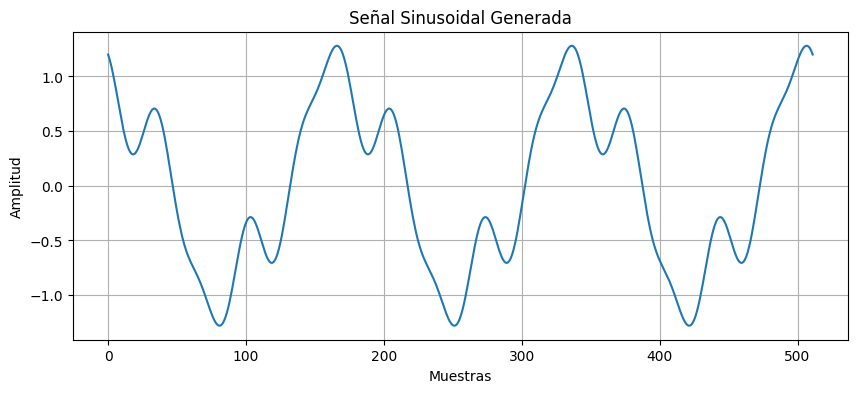

In [12]:
# Definir parámetros
signal_len = 512  # longitud de la señal
f1, f2, f3 = 1, 3, 5  # frecuencias de las señales
am1, am2, am3 = 1.0, 1/3, 1/5  # amplitudes de las señales
Time = 3  # duración de la señal en segundos
wo = 2 * np.pi  # frecuencia angular

# Generar señal sinusoidal
signal = gensenales(signal_len, f1, f2, f3, am1, am2, am3, Time, wo)

# Visualización de la señal generada
plt.figure(figsize=(10, 4))
plt.plot(signal)
plt.title('Señal Sinusoidal Generada')
plt.xlabel('Muestras')
plt.ylabel('Amplitud')
plt.grid(True)
plt.show()

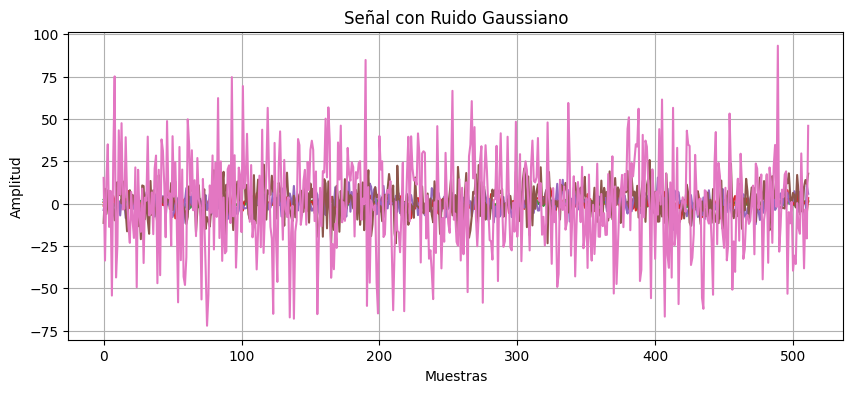

In [13]:
# Definir parámetros para el ruido
#1024, [0.1, 0.3, 1,3,5,10,30], 50
num_repeats = 128  # cantidad de veces que se repite para cada sigma
# Generar ruido
ruido1 = noise_gaussian(512, 0.1, num_repeats,signal)
ruido2 = noise_gaussian(512, 0.3, num_repeats,signal)
ruido3 = noise_gaussian(512, 1, num_repeats,signal)
ruido4 = noise_gaussian(512, 3, num_repeats,signal)
ruido5 = noise_gaussian(512, 5, num_repeats,signal)
ruido6 = noise_gaussian(512, 10, num_repeats,signal)
ruido7 = noise_gaussian(512, 30, num_repeats,signal)

# Visualización de la señal con ruido agregado
plt.figure(figsize=(10, 4))
plt.plot(ruido1[0])  # mostrar la primera señal con ruido
plt.plot(ruido2[0])  # mostrar la primera señal con ruido
plt.plot(ruido3[0])  # mostrar la primera señal con ruido
plt.plot(ruido4[0])  # mostrar la primera señal con ruido
plt.plot(ruido5[0])  # mostrar la primera señal con ruido
plt.plot(ruido6[0])  # mostrar la primera señal con ruido
plt.plot(ruido7[0])  # mostrar la primera señal con ruido
plt.title('Señal con Ruido Gaussiano')
plt.xlabel('Muestras')
plt.ylabel('Amplitud')
plt.grid(True)
plt.show()


/usr/local/lib/python3.10/dist-packages/scipy/signal/_spectral_py.py:600: UserWarning: nperseg = 1024 is greater than input length  = 512, using nperseg = 512
  freqs, _, Pxy = _spectral_helper(x, y, fs, window, nperseg, noverlap,


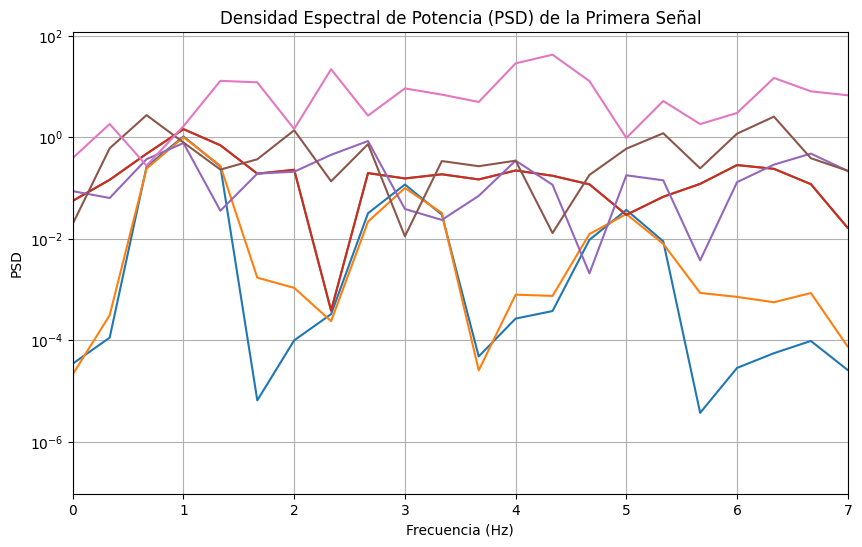

In [14]:

# Frecuencia de muestreo
fs = signal_len / Time

# Calcular PSD utilizando el método de Welch
freqs1, psds1 =calcular_welch_arreglo(ruido1, fs)
freqs2, psds2 =calcular_welch_arreglo(ruido2, fs)
freqs3, psds3 =calcular_welch_arreglo(ruido3, fs)
freqs4, psds4 =calcular_welch_arreglo(ruido4, fs)
freqs5, psds5 =calcular_welch_arreglo(ruido5, fs)
freqs6, psds6 =calcular_welch_arreglo(ruido6, fs)
freqs7, psds7 =calcular_welch_arreglo(ruido7, fs)

# Visualizar la primera PSD calculada
plt.figure(figsize=(10, 6))
plt.semilogy(freqs1[0], psds1[0])
plt.semilogy(freqs2[0], psds2[0])
plt.semilogy(freqs3[0], psds4[0])
plt.semilogy(freqs4[0], psds4[0])
plt.semilogy(freqs5[0], psds5[0])
plt.semilogy(freqs6[0], psds6[0])
plt.semilogy(freqs7[0], psds7[0])
plt.title('Densidad Espectral de Potencia (PSD) de la Primera Señal')
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('PSD')
plt.xlim(0, 7)
plt.grid(True)
plt.show()

In [ ]:
ruido1.shape[]


512

Epoch 1/500


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - loss: 0.1239 - val_loss: 0.0043
Epoch 2/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0084 - val_loss: 0.0042
Epoch 3/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0052 - val_loss: 0.0042
Epoch 4/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0044 - val_loss: 0.0041
Epoch 5/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0041 - val_loss: 0.0039
Epoch 6/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0039 - val_loss: 0.0036
Epoch 7/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0037 - val_loss: 0.0033
Epoch 8/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0035 - val_loss: 0.0031
Epoch 9/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0032 - val_loss: 0.0028
Epoch 10/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0030 - val_loss: 0.0025
Epoch 11/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0028 - val_loss: 0.0020
Epoch 12/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0025 - val_loss: 0.0017
E

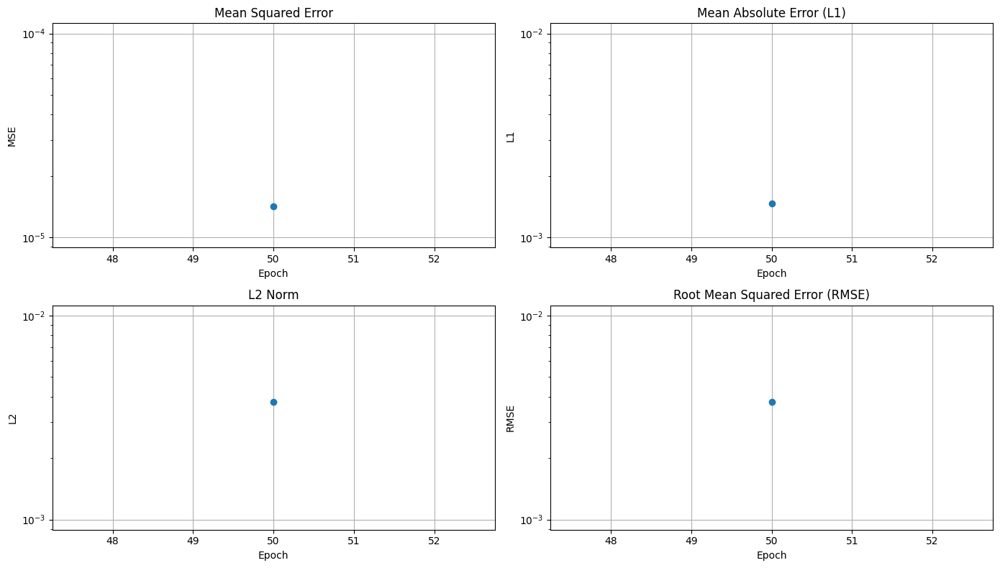

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 365ms/step - loss: 2.2112e-04 - val_loss: 1.4132e-05
Epoch 51/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 2.5377e-04 - val_loss: 1.9197e-05
Epoch 52/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 2.1784e-04 - val_loss: 2.4084e-05
Epoch 53/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 1.7542e-04 - val_loss: 3.8396e-05
Epoch 54/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.0650e-04 - val_loss: 5.2091e-05
Epoch 55/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 1.7517e-04 - val_loss: 3.2372e-05
Epoch 56/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 1.9382e-04 - val_loss: 8.3876e-06
Epoch 57/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 1.5853e-04 - val_loss: 1.2770e-05
Epoch 58/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 1.5379e-04 - val_loss: 2.9810e-05
Epoch 59/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 1.3487e-04 - val_loss: 4.1496e-05
Epoch 60/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 2.1548e-04 - val_loss: 

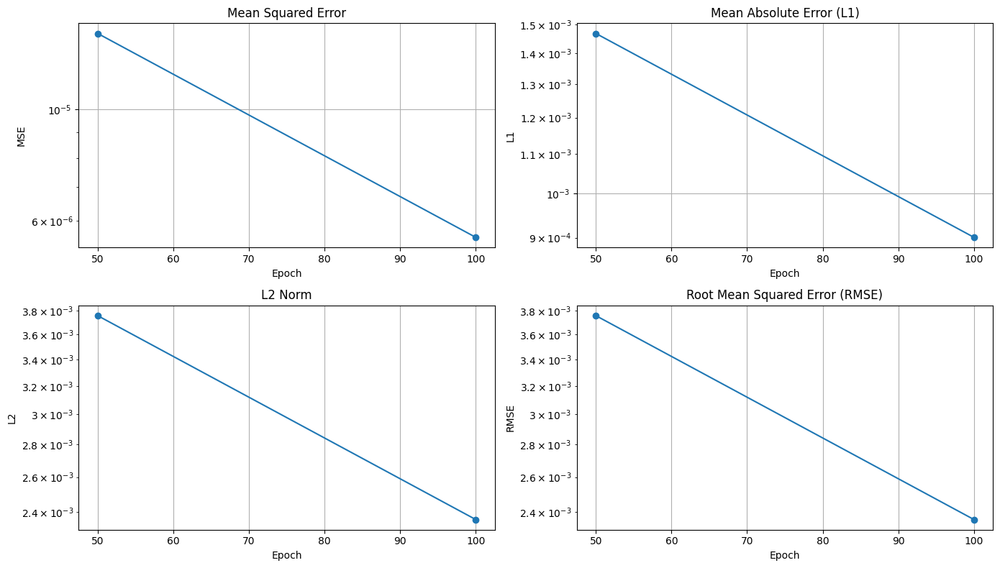

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 322ms/step - loss: 1.1342e-04 - val_loss: 5.5690e-06
Epoch 101/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 1.4495e-04 - val_loss: 1.5694e-05
Epoch 102/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 1.3360e-04 - val_loss: 1.0694e-05
Epoch 103/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 1.1103e-04 - val_loss: 8.1856e-06
Epoch 104/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 1.2791e-04 - val_loss: 4.8036e-06
Epoch 105/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 1.0479e-04 - val_loss: 1.0161e-05
Epoch 106/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 1.3320e-04 - val_loss: 9.7952e-06
Epoch 107/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 1.3940e-04 - val_loss: 9.2062e-06
Epoch 108/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 1.0026e-04 - val_loss: 1.2369e-05
Epoch 109/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 1.0419e-04 - val_loss: 1.2085e-05
Epoch 110/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 1.1360e-04 - 

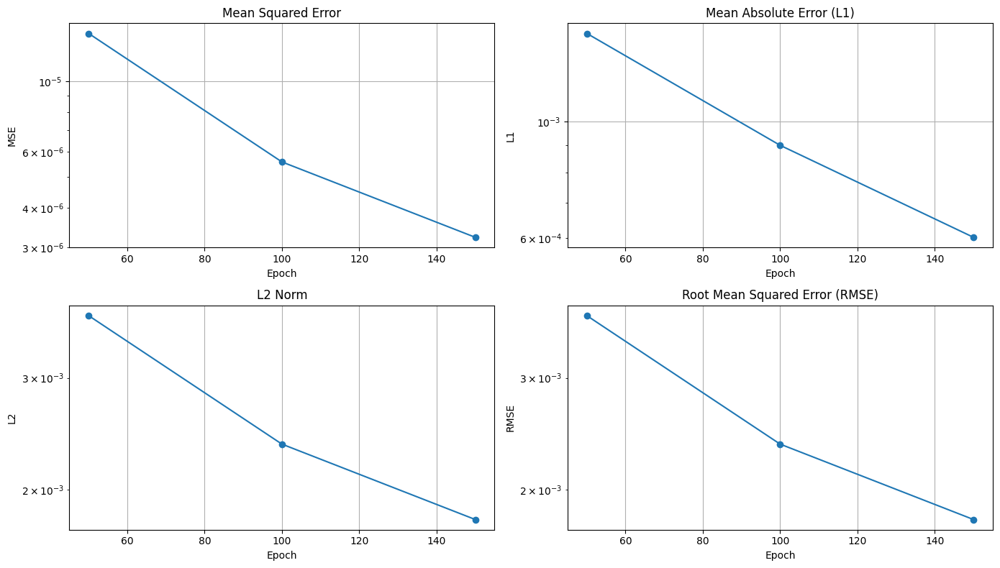

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 408ms/step - loss: 1.1900e-04 - val_loss: 3.2254e-06
Epoch 151/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 9.2122e-05 - val_loss: 2.7909e-06
Epoch 152/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 9.1218e-05 - val_loss: 7.0529e-06
Epoch 153/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.2257e-04 - val_loss: 9.3191e-06
Epoch 154/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 9.1670e-05 - val_loss: 1.0213e-05
Epoch 155/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 1.0453e-04 - val_loss: 7.8937e-06
Epoch 156/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 7.8916e-05 - val_loss: 3.5399e-06
Epoch 157/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 9.1617e-05 - val_loss: 2.2379e-06
Epoch 158/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 9.4371e-05 - val_loss: 2.0271e-06
Epoch 159/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 8.6617e-05 - val_loss: 4.0038e-06
Epoch 160/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 7.9677e-05 - 

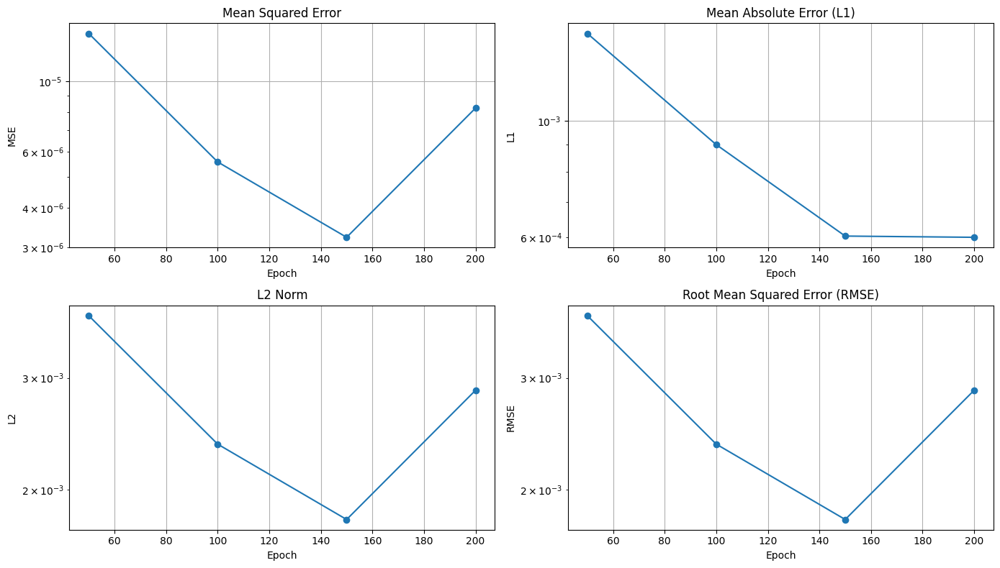

6/6 ━━━━━━━━━━━━━━━━━━━━ 54s 11s/step - loss: 6.3538e-05 - val_loss: 8.2311e-06
Epoch 201/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 6.5591e-05 - val_loss: 5.0358e-06
Epoch 202/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 9.0209e-05 - val_loss: 2.0721e-06
Epoch 203/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 8.8615e-05 - val_loss: 1.7724e-06
Epoch 204/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 5.6064e-05 - val_loss: 3.7864e-06
Epoch 205/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 6.6037e-05 - val_loss: 7.2432e-06
Epoch 206/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 7.5165e-05 - val_loss: 7.1351e-06
Epoch 207/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 7.0971e-05 - val_loss: 7.7393e-06
Epoch 208/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 7.6837e-05 - val_loss: 4.9880e-06
Epoch 209/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 8.0420e-05 - val_loss: 2.4307e-06
Epoch 210/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 8.3726e-05 - v

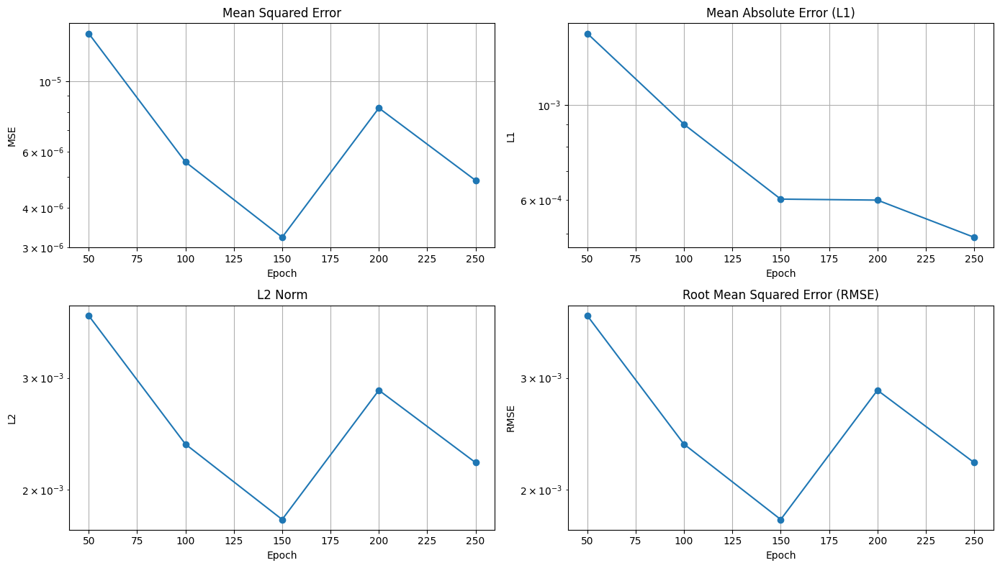

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 362ms/step - loss: 5.0439e-05 - val_loss: 4.8714e-06
Epoch 251/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 6.5279e-05 - val_loss: 3.1407e-06
Epoch 252/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 5.5777e-05 - val_loss: 2.3718e-06
Epoch 253/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 6.3883e-05 - val_loss: 2.2084e-06
Epoch 254/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 5.7130e-05 - val_loss: 3.4500e-06
Epoch 255/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 7.3348e-05 - val_loss: 4.1598e-06
Epoch 256/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 5.4939e-05 - val_loss: 3.6602e-06
Epoch 257/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 5.1584e-05 - val_loss: 2.1795e-06
Epoch 258/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 5.7575e-05 - val_loss: 2.6044e-06
Epoch 259/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 7.1085e-05 - val_loss: 3.7883e-06
Epoch 260/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 6.4390e-05 - 

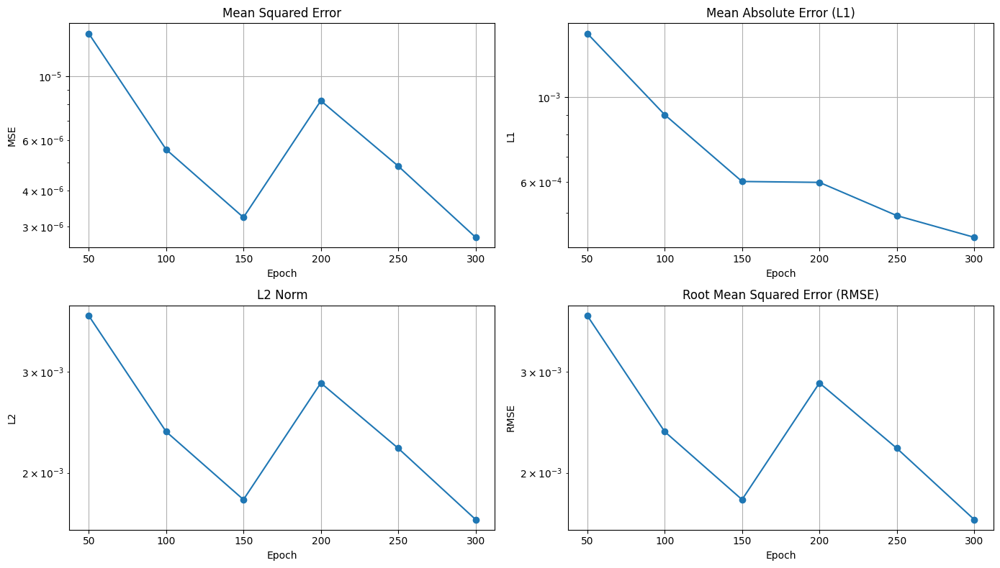

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 351ms/step - loss: 5.4740e-05 - val_loss: 2.7493e-06
Epoch 301/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 6.0342e-05 - val_loss: 4.2023e-06
Epoch 302/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 5.1222e-05 - val_loss: 4.8677e-06
Epoch 303/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 5.0280e-05 - val_loss: 6.0157e-06
Epoch 304/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 4.1206e-05 - val_loss: 5.3448e-06
Epoch 305/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 6.3059e-05 - val_loss: 2.5961e-06
Epoch 306/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 6.1914e-05 - val_loss: 1.8517e-06
Epoch 307/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 6.0601e-05 - val_loss: 2.4858e-06
Epoch 308/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 5.0058e-05 - val_loss: 2.9641e-06
Epoch 309/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 4.1036e-05 - val_loss: 2.8053e-06
Epoch 310/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 4.9070e-05 - 

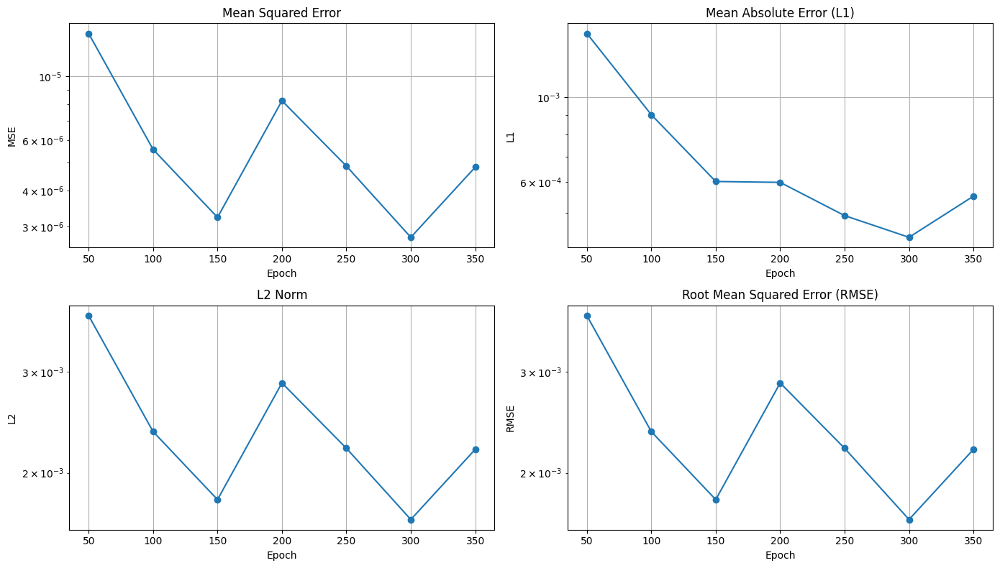

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 508ms/step - loss: 4.1714e-05 - val_loss: 4.8294e-06
Epoch 351/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - loss: 3.8599e-05 - val_loss: 8.7700e-06
Epoch 352/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 4.5452e-05 - val_loss: 6.7194e-06
Epoch 353/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 4.3425e-05 - val_loss: 2.8860e-06
Epoch 354/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 3.7180e-05 - val_loss: 1.8191e-06
Epoch 355/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 4.4031e-05 - val_loss: 1.6808e-06
Epoch 356/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 4.6923e-05 - val_loss: 1.6123e-06
Epoch 357/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 4.7437e-05 - val_loss: 1.6340e-06
Epoch 358/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 4.9690e-05 - val_loss: 1.8372e-06
Epoch 359/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 4.3518e-05 - val_loss: 3.5020e-06
Epoch 360/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 4.2602e-05 - 

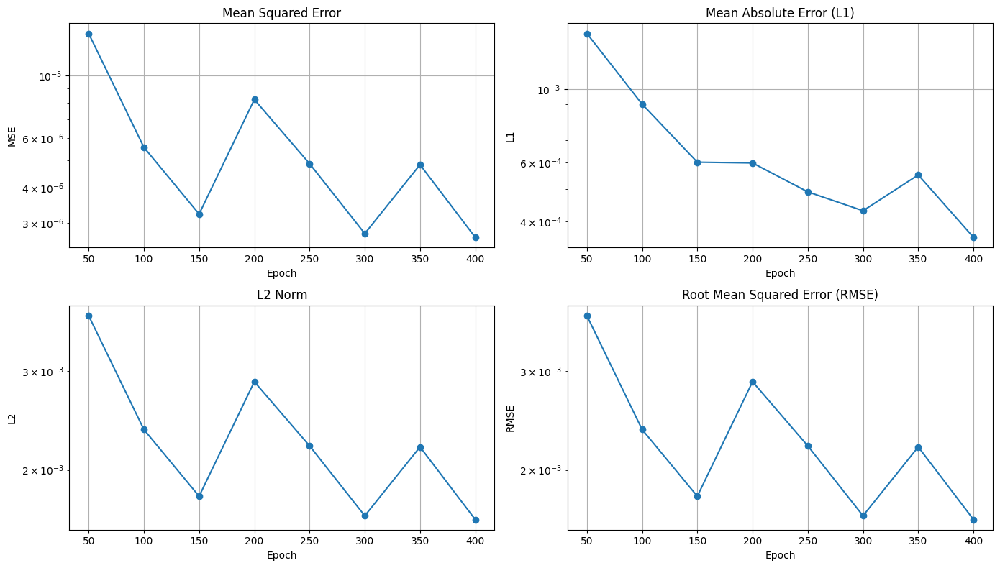

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 474ms/step - loss: 3.0325e-05 - val_loss: 2.6668e-06
Epoch 401/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 3.6024e-05 - val_loss: 2.3649e-06
Epoch 402/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 4.4148e-05 - val_loss: 2.0807e-06
Epoch 403/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 3.5755e-05 - val_loss: 1.9892e-06
Epoch 404/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 4.5780e-05 - val_loss: 1.6265e-06
Epoch 405/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 3.8841e-05 - val_loss: 1.6409e-06
Epoch 406/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 3.2703e-05 - val_loss: 2.9388e-06
Epoch 407/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.9878e-05 - val_loss: 2.3397e-06
Epoch 408/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 2.6606e-05 - val_loss: 1.8883e-06
Epoch 409/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 3.7187e-05 - val_loss: 2.8892e-06
Epoch 410/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 2.7691e-05 - 

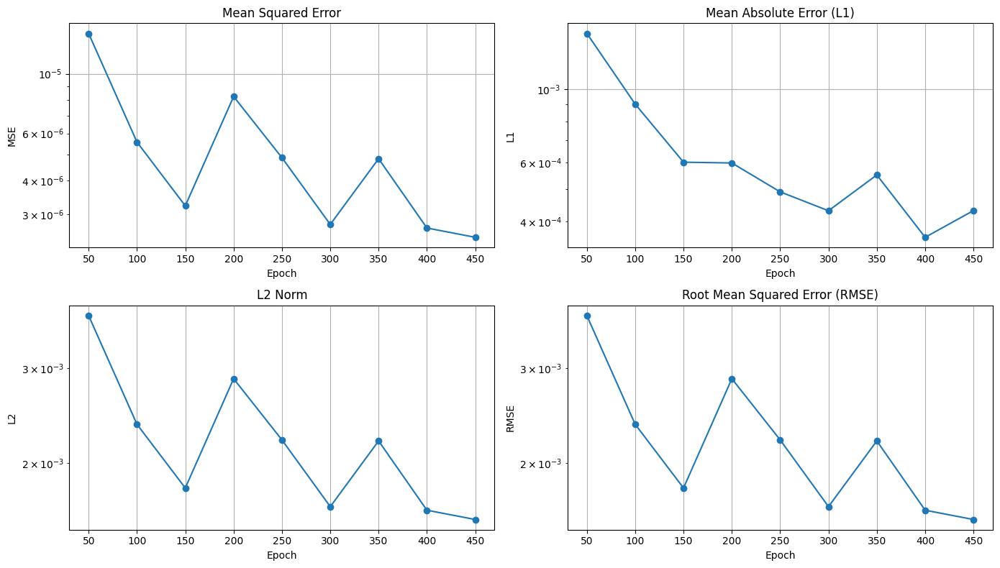

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 479ms/step - loss: 2.6979e-05 - val_loss: 2.4626e-06
Epoch 451/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 3.2819e-05 - val_loss: 1.6816e-06
Epoch 452/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 3.3063e-05 - val_loss: 1.8705e-06
Epoch 453/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 2.9711e-05 - val_loss: 2.1850e-06
Epoch 454/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 2.3778e-05 - val_loss: 2.1868e-06
Epoch 455/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.6682e-05 - val_loss: 2.3178e-06
Epoch 456/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 3.3189e-05 - val_loss: 1.9619e-06
Epoch 457/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 2.8823e-05 - val_loss: 1.5744e-06
Epoch 458/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 3.0044e-05 - val_loss: 1.8487e-06
Epoch 459/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 1.7413e-05 - val_loss: 2.8587e-06
Epoch 460/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 3.2337e-05 - 

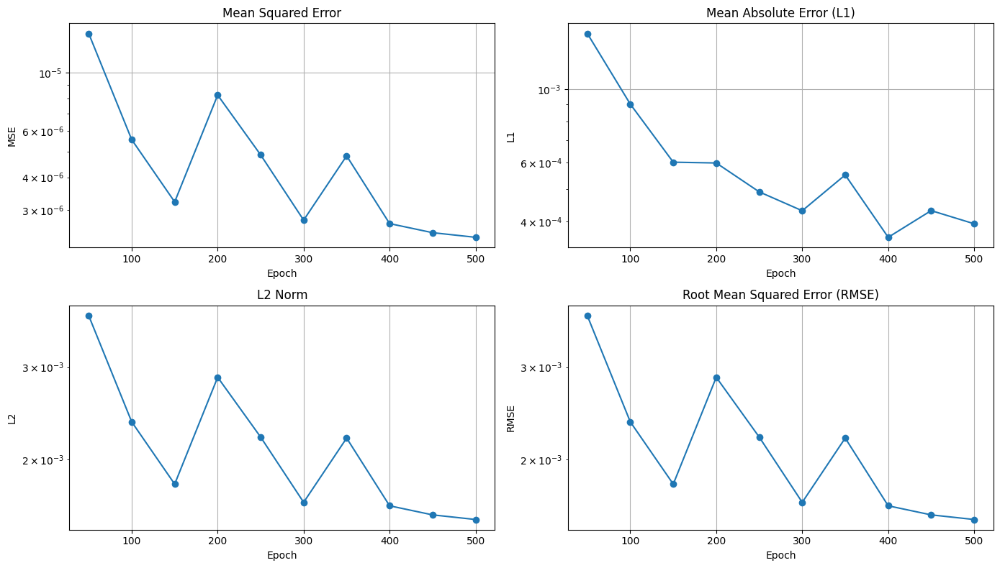

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 350ms/step - loss: 2.4245e-05 - val_loss: 2.3649e-06


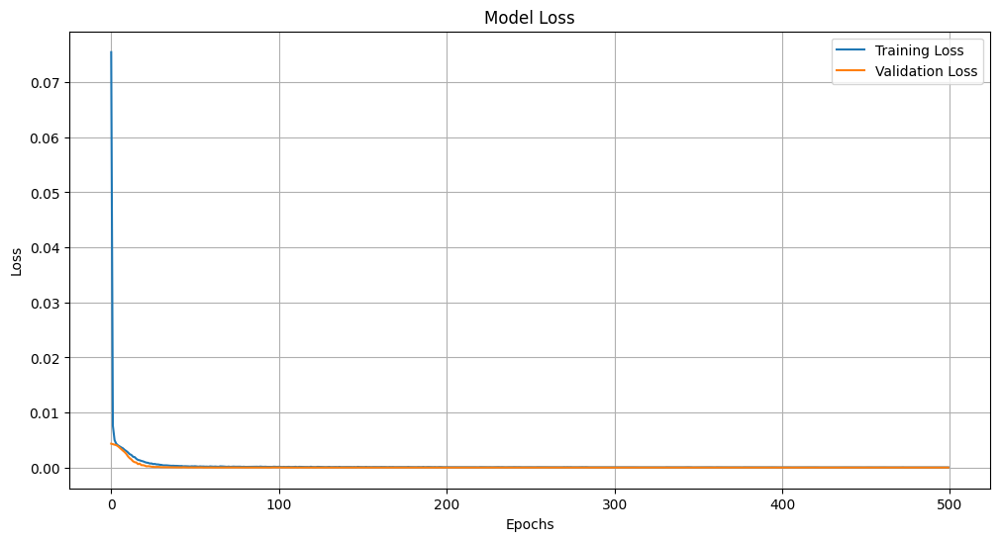

Epoch 1/500


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 39ms/step - loss: 0.1585 - val_loss: 0.0053
Epoch 2/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0117 - val_loss: 0.0044
Epoch 3/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0066 - val_loss: 0.0043
Epoch 4/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0048 - val_loss: 0.0042
Epoch 5/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0043 - val_loss: 0.0041
Epoch 6/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0041 - val_loss: 0.0040
Epoch 7/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0040 - val_loss: 0.0039
Epoch 8/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 0.0039 - val_loss: 0.0038
Epoch 9/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0039 - val_loss: 0.0037
Epoch 10/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 0.0038 - val_loss: 0.0035
Epoch 11/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0035 - val_loss: 0.0034
Epoch 12/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.0035 - val_loss: 0.0032
E

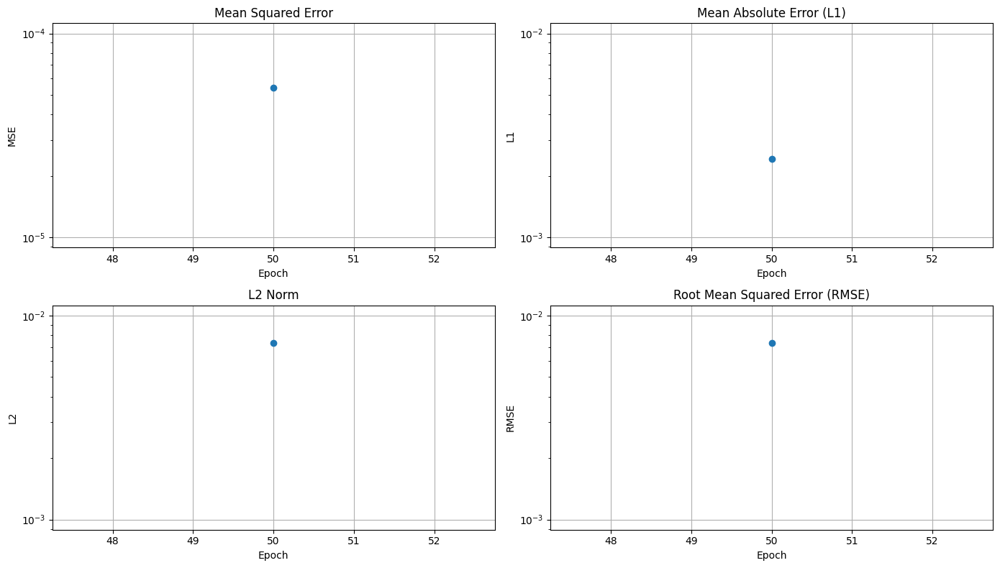

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 364ms/step - loss: 2.5898e-04 - val_loss: 5.4075e-05
Epoch 51/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 3.0111e-04 - val_loss: 4.3998e-05
Epoch 52/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2.7536e-04 - val_loss: 4.6253e-05
Epoch 53/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.1461e-04 - val_loss: 5.3788e-05
Epoch 54/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 2.4728e-04 - val_loss: 4.9464e-05
Epoch 55/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 1.9069e-04 - val_loss: 4.4326e-05
Epoch 56/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.2501e-04 - val_loss: 4.9440e-05
Epoch 57/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 2.3109e-04 - val_loss: 4.7700e-05
Epoch 58/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 2.2042e-04 - val_loss: 4.2672e-05
Epoch 59/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 2.0387e-04 - val_loss: 5.1903e-05
Epoch 60/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2.4300e-04 - val_loss: 

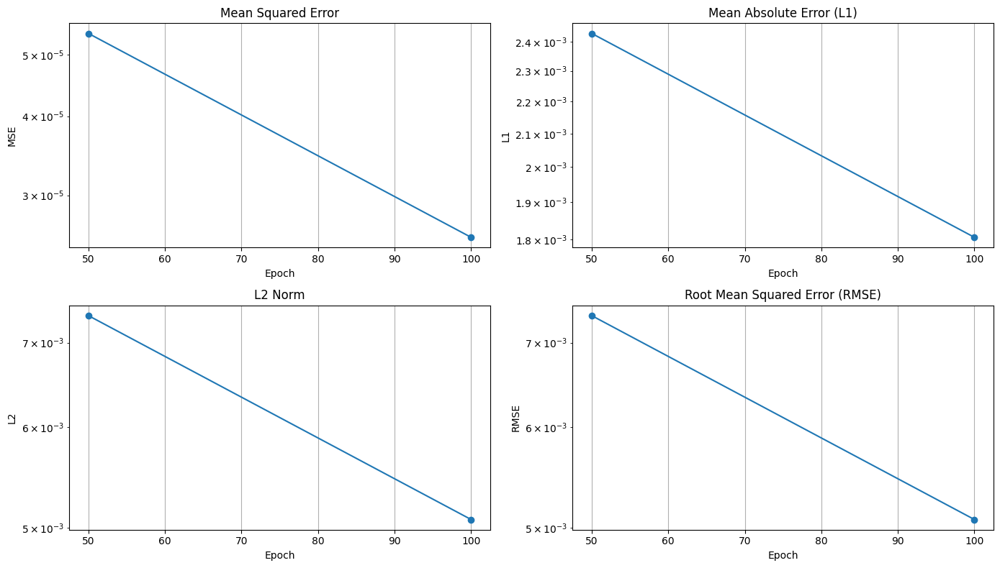

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 322ms/step - loss: 1.5564e-04 - val_loss: 2.5745e-05
Epoch 101/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 1.5832e-04 - val_loss: 2.8015e-05
Epoch 102/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 1.6888e-04 - val_loss: 3.0649e-05
Epoch 103/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 1.4012e-04 - val_loss: 3.5430e-05
Epoch 104/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 1.5133e-04 - val_loss: 3.2042e-05
Epoch 105/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 1.6404e-04 - val_loss: 3.2709e-05
Epoch 106/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 1.2435e-04 - val_loss: 3.0475e-05
Epoch 107/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 1.3079e-04 - val_loss: 3.3328e-05
Epoch 108/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 1.6581e-04 - val_loss: 2.7060e-05
Epoch 109/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 1.4197e-04 - val_loss: 2.6008e-05
Epoch 110/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.2472e-04 - 

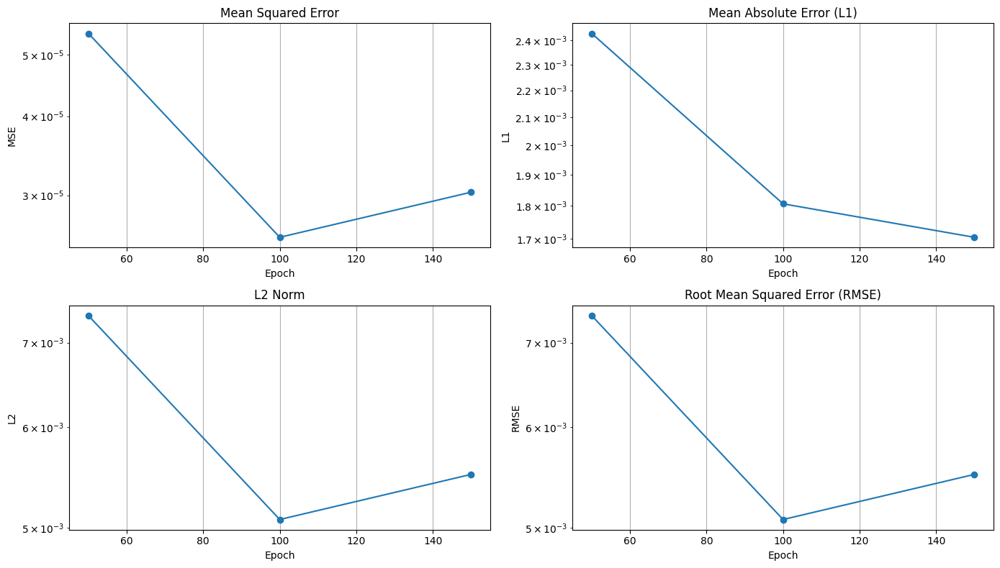

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 471ms/step - loss: 1.1252e-04 - val_loss: 3.0339e-05
Epoch 151/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 1.2735e-04 - val_loss: 2.5299e-05
Epoch 152/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 1.1939e-04 - val_loss: 2.5219e-05
Epoch 153/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 8.2901e-05 - val_loss: 2.7182e-05
Epoch 154/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 1.2828e-04 - val_loss: 2.6598e-05
Epoch 155/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 1.1445e-04 - val_loss: 2.5468e-05
Epoch 156/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 1.0384e-04 - val_loss: 2.5422e-05
Epoch 157/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 1.3178e-04 - val_loss: 2.5780e-05
Epoch 158/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 1.1849e-04 - val_loss: 2.5106e-05
Epoch 159/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.1415e-04 - val_loss: 2.5049e-05
Epoch 160/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 8.6782e-05 - 

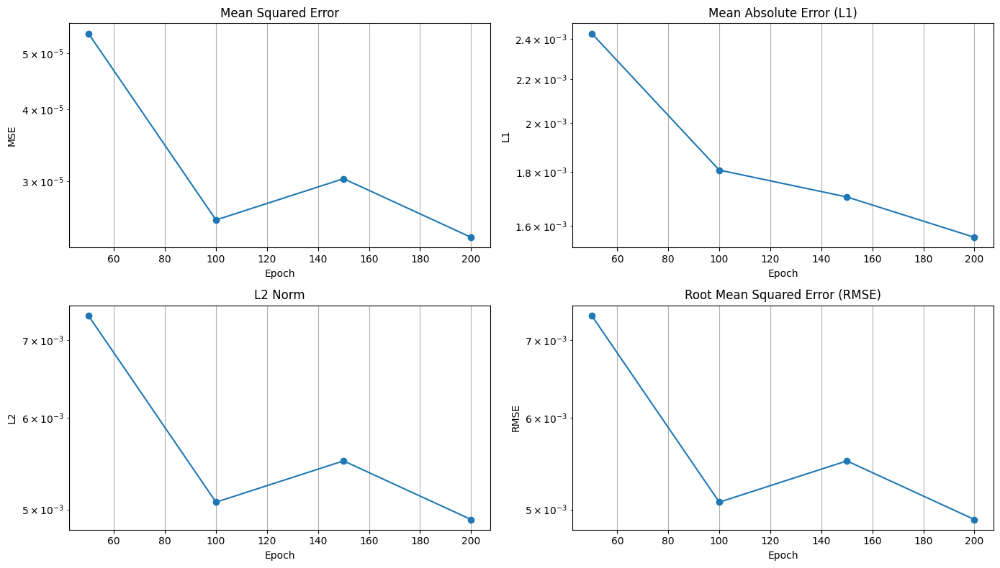

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 423ms/step - loss: 9.5572e-05 - val_loss: 2.4028e-05
Epoch 201/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 9.6396e-05 - val_loss: 2.4348e-05
Epoch 202/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 7.9181e-05 - val_loss: 2.3944e-05
Epoch 203/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 8.8528e-05 - val_loss: 2.4340e-05
Epoch 204/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 9.2131e-05 - val_loss: 2.4206e-05
Epoch 205/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 7.9577e-05 - val_loss: 2.4110e-05
Epoch 206/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 8.0235e-05 - val_loss: 2.4022e-05
Epoch 207/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 7.9839e-05 - val_loss: 2.3992e-05
Epoch 208/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 8.7970e-05 - val_loss: 2.4545e-05
Epoch 209/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 8.1241e-05 - val_loss: 2.4136e-05
Epoch 210/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 8.2581e-05 - 

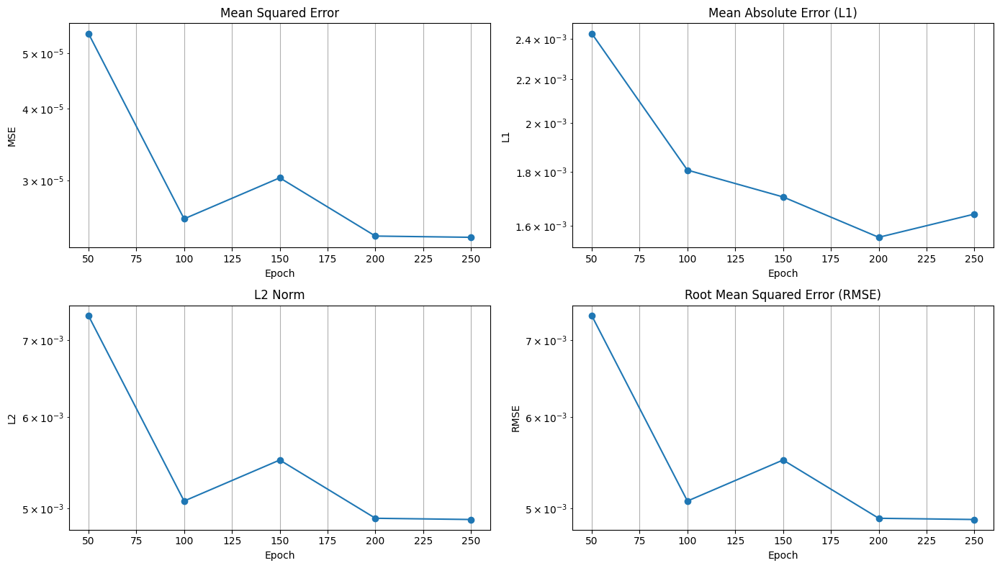

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 341ms/step - loss: 7.5247e-05 - val_loss: 2.3911e-05
Epoch 251/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 6.6400e-05 - val_loss: 2.3619e-05
Epoch 252/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 8.6530e-05 - val_loss: 2.3670e-05
Epoch 253/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 8.1711e-05 - val_loss: 2.4711e-05
Epoch 254/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 5.9149e-05 - val_loss: 2.4452e-05
Epoch 255/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 8.4509e-05 - val_loss: 2.3607e-05
Epoch 256/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 7.4516e-05 - val_loss: 2.4168e-05
Epoch 257/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 7.5794e-05 - val_loss: 2.4040e-05
Epoch 258/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 7.3758e-05 - val_loss: 2.3979e-05
Epoch 259/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 7.7262e-05 - val_loss: 2.3406e-05
Epoch 260/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 7.0321e-05 - 

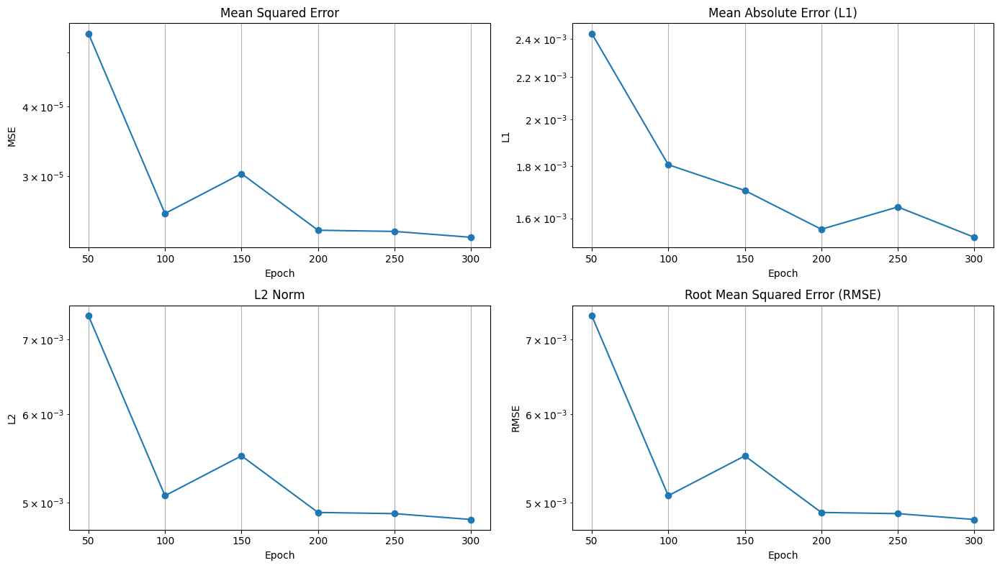

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 324ms/step - loss: 7.6446e-05 - val_loss: 2.3339e-05
Epoch 301/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 5.5435e-05 - val_loss: 2.5236e-05
Epoch 302/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 7.1802e-05 - val_loss: 2.4366e-05
Epoch 303/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 5.9487e-05 - val_loss: 2.3373e-05
Epoch 304/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 5.8198e-05 - val_loss: 2.3282e-05
Epoch 305/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 5.5242e-05 - val_loss: 2.4049e-05
Epoch 306/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 5.0988e-05 - val_loss: 2.3552e-05
Epoch 307/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 5.4765e-05 - val_loss: 2.3792e-05
Epoch 308/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 7.3916e-05 - val_loss: 2.3175e-05
Epoch 309/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 5.8978e-05 - val_loss: 2.3163e-05
Epoch 310/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 6.0776e-05 - 

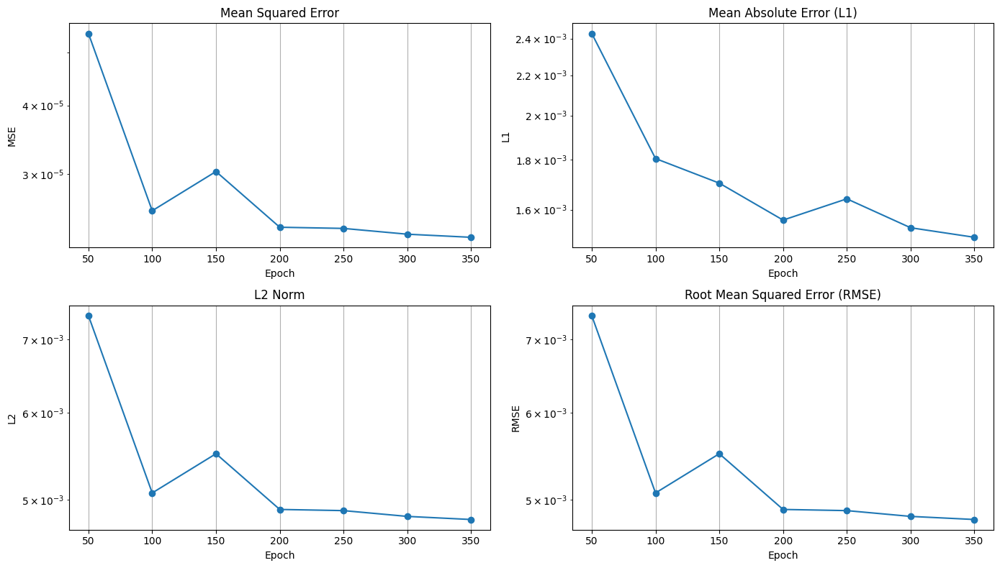

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 347ms/step - loss: 5.4744e-05 - val_loss: 2.3038e-05
Epoch 351/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 5.3073e-05 - val_loss: 2.3065e-05
Epoch 352/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 5.4498e-05 - val_loss: 2.3082e-05
Epoch 353/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 5.3567e-05 - val_loss: 2.3020e-05
Epoch 354/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 5.4841e-05 - val_loss: 2.2978e-05
Epoch 355/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 5.9065e-05 - val_loss: 2.3062e-05
Epoch 356/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 5.4535e-05 - val_loss: 2.3141e-05
Epoch 357/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 4.5155e-05 - val_loss: 2.3001e-05
Epoch 358/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 4.9621e-05 - val_loss: 2.2962e-05
Epoch 359/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 5.2329e-05 - val_loss: 2.2933e-05
Epoch 360/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 5.0178e-05 - 

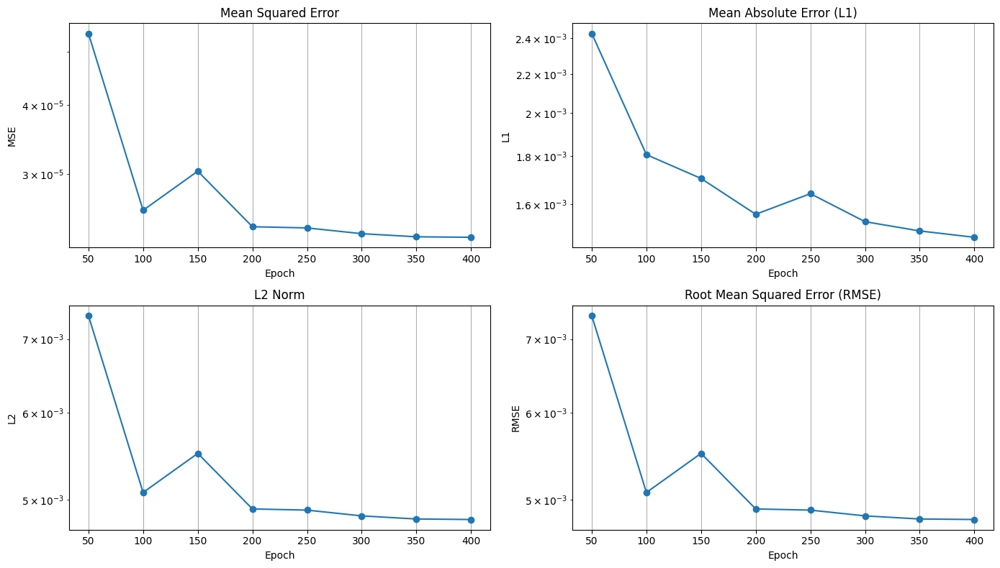

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 424ms/step - loss: 3.7284e-05 - val_loss: 2.2987e-05
Epoch 401/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 5.4459e-05 - val_loss: 2.3053e-05
Epoch 402/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 4.5918e-05 - val_loss: 2.2961e-05
Epoch 403/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 5.0737e-05 - val_loss: 2.3014e-05
Epoch 404/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 5.5314e-05 - val_loss: 2.2995e-05
Epoch 405/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 5.3756e-05 - val_loss: 2.3002e-05
Epoch 406/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 3.6850e-05 - val_loss: 2.3029e-05
Epoch 407/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 5.6193e-05 - val_loss: 2.3853e-05
Epoch 408/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 5.1862e-05 - val_loss: 2.3163e-05
Epoch 409/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 5.6988e-05 - val_loss: 2.2941e-05
Epoch 410/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 4.2155e-05 - 

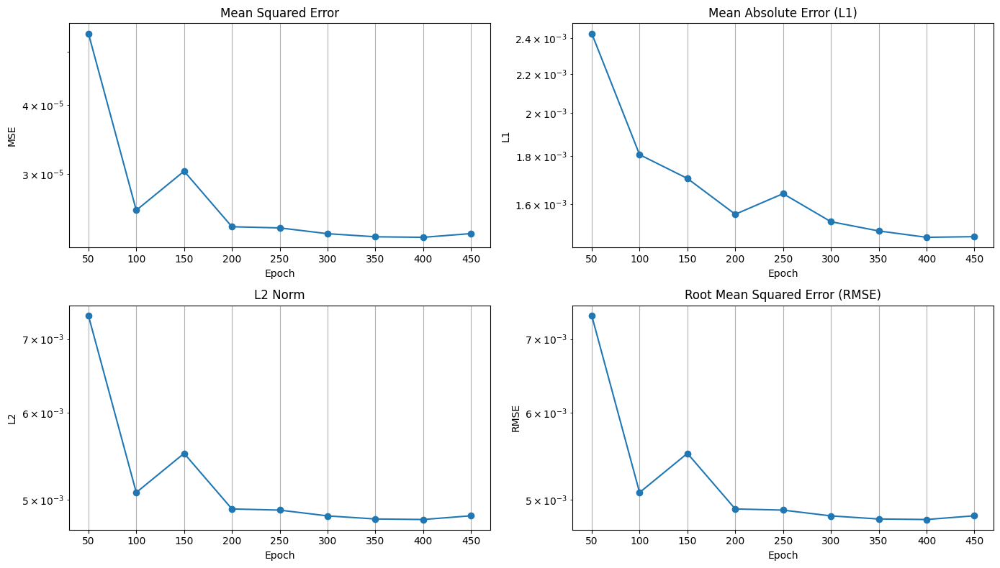

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 427ms/step - loss: 4.9343e-05 - val_loss: 2.3350e-05
Epoch 451/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 3.6314e-05 - val_loss: 2.2871e-05
Epoch 452/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 4.4298e-05 - val_loss: 2.2837e-05
Epoch 453/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 3.9374e-05 - val_loss: 2.2886e-05
Epoch 454/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 4.8135e-05 - val_loss: 2.3087e-05
Epoch 455/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 4.2780e-05 - val_loss: 2.3045e-05
Epoch 456/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 4.9738e-05 - val_loss: 2.3291e-05
Epoch 457/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 4.6413e-05 - val_loss: 2.2879e-05
Epoch 458/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 4.2622e-05 - val_loss: 2.3007e-05
Epoch 459/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 3.8034e-05 - val_loss: 2.2922e-05
Epoch 460/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 4.1545e-05 - 

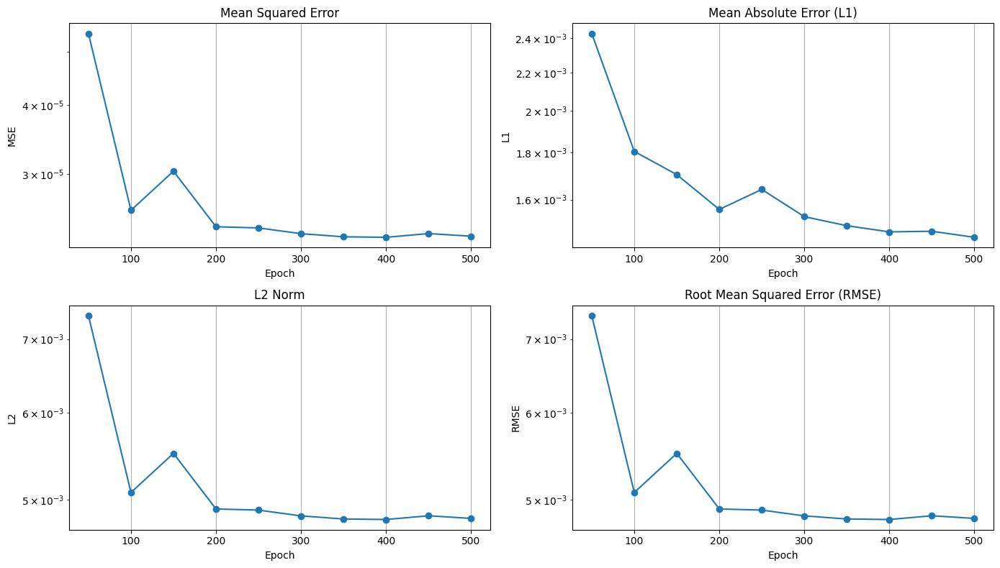

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 324ms/step - loss: 4.2854e-05 - val_loss: 2.3094e-05


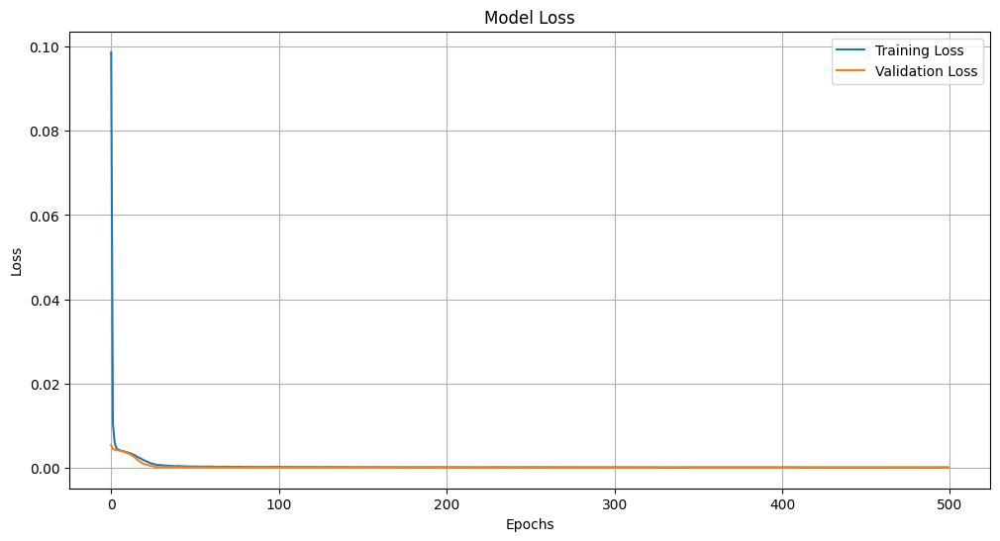

Epoch 1/500


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 42ms/step - loss: 0.3492 - val_loss: 0.0118
Epoch 2/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0332 - val_loss: 0.0064
Epoch 3/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0156 - val_loss: 0.0053
Epoch 4/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0094 - val_loss: 0.0050
Epoch 5/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0082 - val_loss: 0.0048
Epoch 6/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 0.0061 - val_loss: 0.0047
Epoch 7/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0052 - val_loss: 0.0046
Epoch 8/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0050 - val_loss: 0.0045
Epoch 9/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0048 - val_loss: 0.0044
Epoch 10/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0045 - val_loss: 0.0043
Epoch 11/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0044 - val_loss: 0.0043
Epoch 12/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0044 - val_loss: 0.0042
E

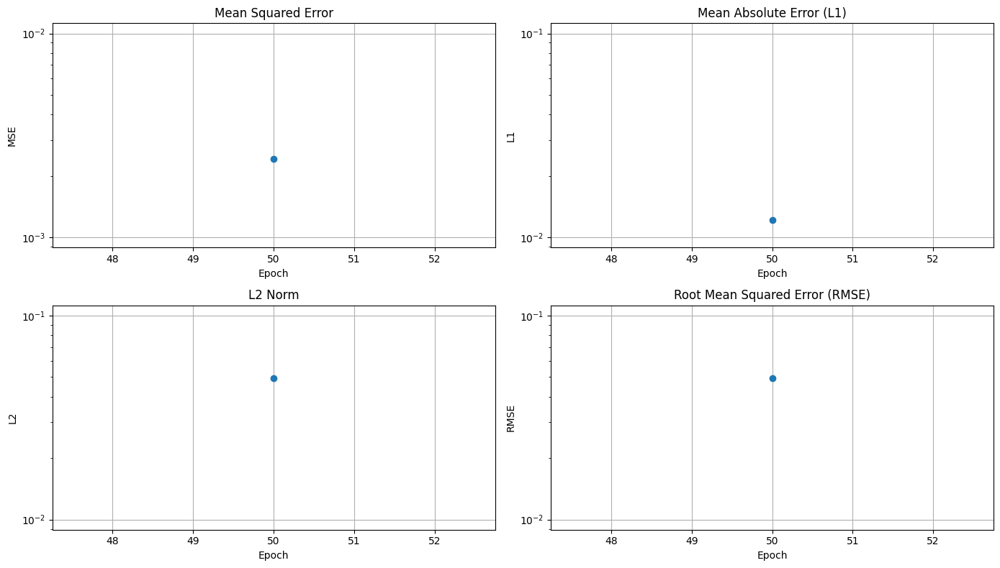

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 375ms/step - loss: 0.0023 - val_loss: 0.0024
Epoch 51/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0022 - val_loss: 0.0024
Epoch 52/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0022 - val_loss: 0.0024
Epoch 53/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0022 - val_loss: 0.0023
Epoch 54/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0021 - val_loss: 0.0023
Epoch 55/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0022 - val_loss: 0.0023
Epoch 56/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0022 - val_loss: 0.0022
Epoch 57/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0020 - val_loss: 0.0022
Epoch 58/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0020 - val_loss: 0.0022
Epoch 59/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0019 - val_loss: 0.0022
Epoch 60/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0020 - val_loss: 0.0021
Epoch 61/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0020 - val_loss:

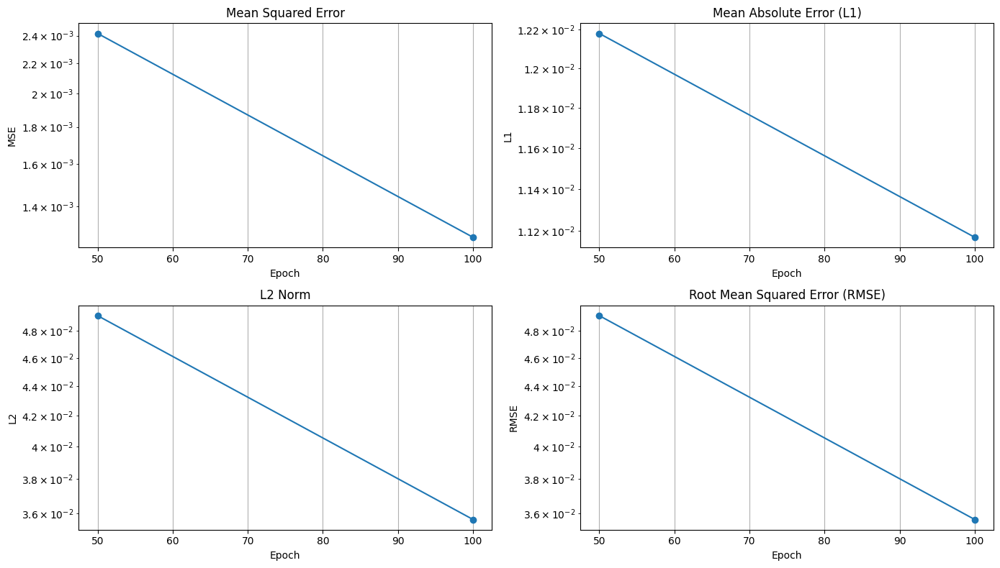

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 408ms/step - loss: 0.0012 - val_loss: 0.0013
Epoch 101/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0011 - val_loss: 0.0013
Epoch 102/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0011 - val_loss: 0.0012
Epoch 103/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0011 - val_loss: 0.0012
Epoch 104/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0011 - val_loss: 0.0012
Epoch 105/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0011 - val_loss: 0.0012
Epoch 106/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0010 - val_loss: 0.0012
Epoch 107/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0011 - val_loss: 0.0012
Epoch 108/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 109/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0010 - val_loss: 0.0011
Epoch 110/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0010 - val_loss: 0.0011
Epoch 111/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 9.8504e

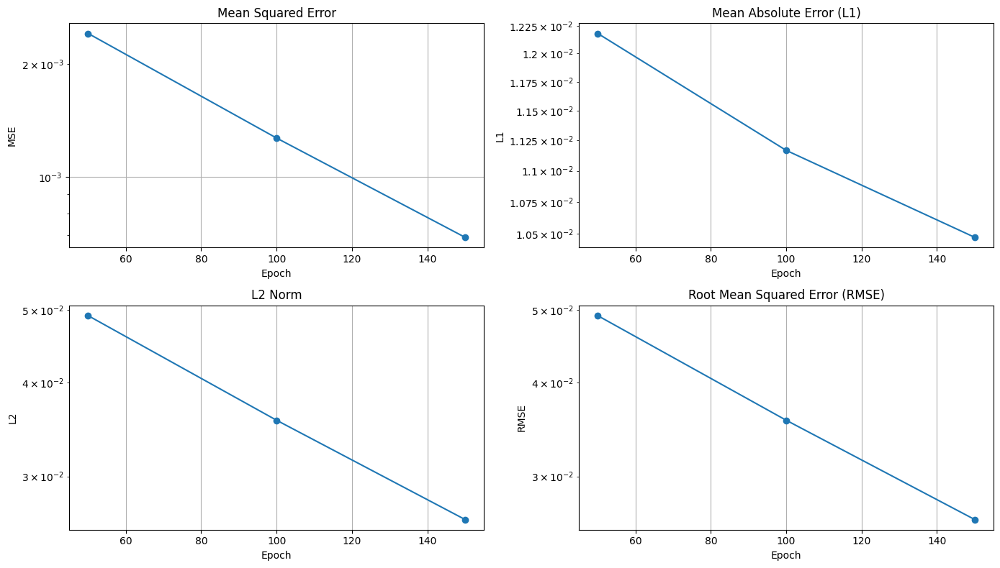

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 472ms/step - loss: 6.4225e-04 - val_loss: 6.9033e-04
Epoch 151/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 5.7721e-04 - val_loss: 6.8279e-04
Epoch 152/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 5.9952e-04 - val_loss: 6.7530e-04
Epoch 153/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 5.6001e-04 - val_loss: 6.6792e-04
Epoch 154/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 6.1031e-04 - val_loss: 6.6058e-04
Epoch 155/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 5.4881e-04 - val_loss: 6.5351e-04
Epoch 156/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 5.6614e-04 - val_loss: 6.4645e-04
Epoch 157/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 5.9105e-04 - val_loss: 6.3941e-04
Epoch 158/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 5.3903e-04 - val_loss: 6.3263e-04
Epoch 159/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 5.4399e-04 - val_loss: 6.2581e-04
Epoch 160/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 5.6364e-04 - 

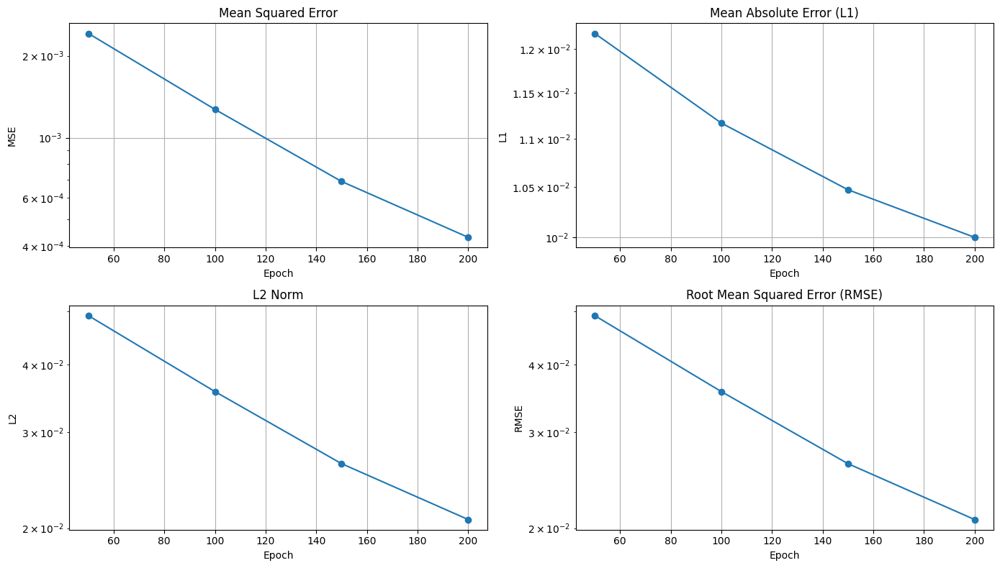

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 640ms/step - loss: 3.6650e-04 - val_loss: 4.3027e-04
Epoch 201/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - loss: 3.7439e-04 - val_loss: 4.2691e-04
Epoch 202/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 3.6725e-04 - val_loss: 4.2359e-04
Epoch 203/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 3.8982e-04 - val_loss: 4.2035e-04
Epoch 204/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 3.9882e-04 - val_loss: 4.1736e-04
Epoch 205/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 3.8197e-04 - val_loss: 4.1452e-04
Epoch 206/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 3.5418e-04 - val_loss: 4.1189e-04
Epoch 207/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 3.7937e-04 - val_loss: 4.0904e-04
Epoch 208/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 3.7282e-04 - val_loss: 4.0615e-04
Epoch 209/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 3.5317e-04 - val_loss: 4.0350e-04
Epoch 210/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - loss: 3.4120e-04 - 

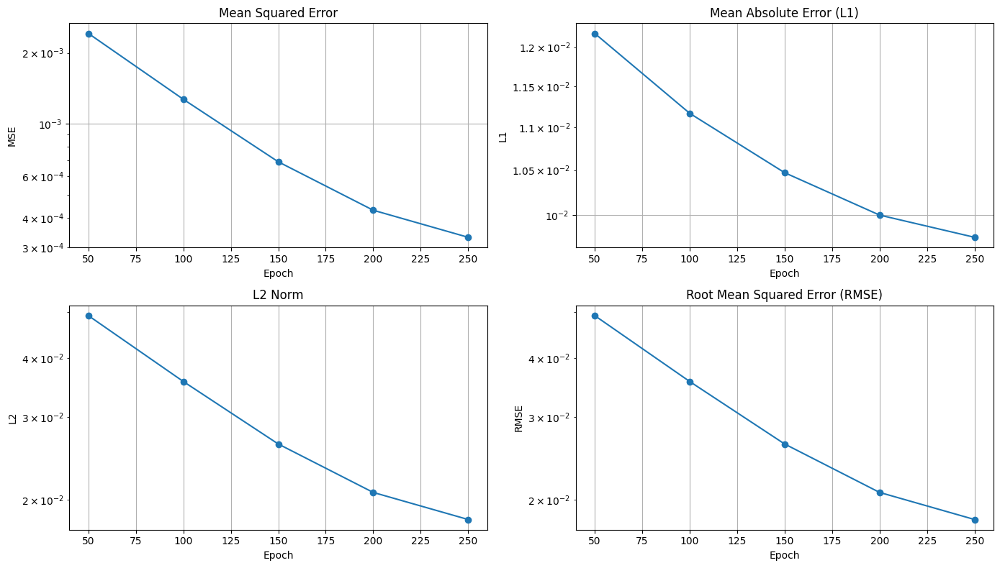

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 570ms/step - loss: 3.1955e-04 - val_loss: 3.3030e-04
Epoch 251/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 2.9475e-04 - val_loss: 3.2927e-04
Epoch 252/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2.8605e-04 - val_loss: 3.2807e-04
Epoch 253/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 3.0041e-04 - val_loss: 3.2702e-04
Epoch 254/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 3.0067e-04 - val_loss: 3.2604e-04
Epoch 255/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 3.0185e-04 - val_loss: 3.2507e-04
Epoch 256/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.7892e-04 - val_loss: 3.2429e-04
Epoch 257/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.8768e-04 - val_loss: 3.2334e-04
Epoch 258/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.7887e-04 - val_loss: 3.2245e-04
Epoch 259/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.7708e-04 - val_loss: 3.2147e-04
Epoch 260/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.8645e-04 - 

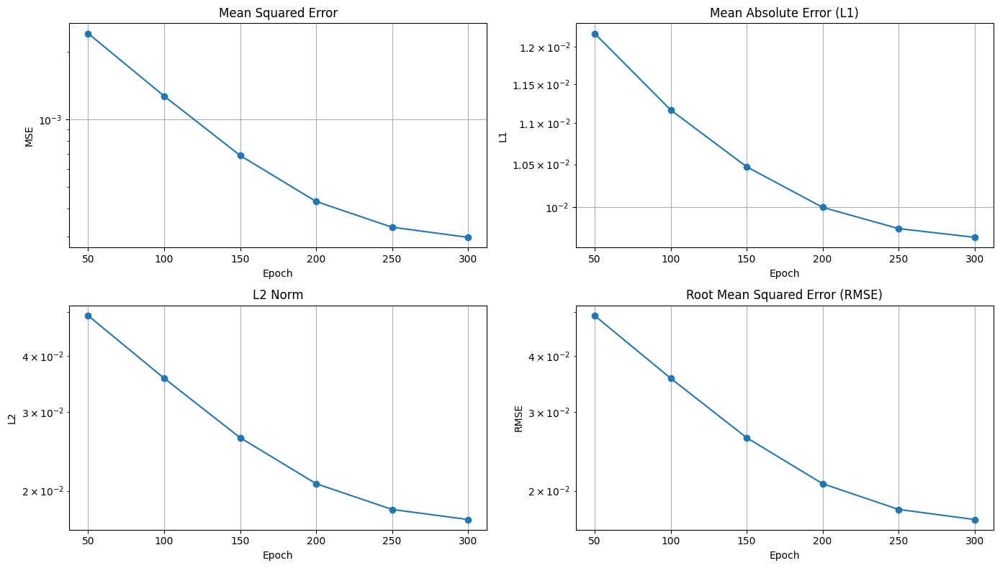

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 600ms/step - loss: 2.6363e-04 - val_loss: 2.9779e-04
Epoch 301/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 2.6270e-04 - val_loss: 2.9742e-04
Epoch 302/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 2.7240e-04 - val_loss: 2.9727e-04
Epoch 303/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 2.7262e-04 - val_loss: 2.9682e-04
Epoch 304/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 2.6189e-04 - val_loss: 2.9644e-04
Epoch 305/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 2.7961e-04 - val_loss: 2.9612e-04
Epoch 306/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 2.6742e-04 - val_loss: 2.9592e-04
Epoch 307/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 2.5842e-04 - val_loss: 2.9571e-04
Epoch 308/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 2.6086e-04 - val_loss: 2.9520e-04
Epoch 309/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 2.6540e-04 - val_loss: 2.9488e-04
Epoch 310/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 2.7263e-04 - 

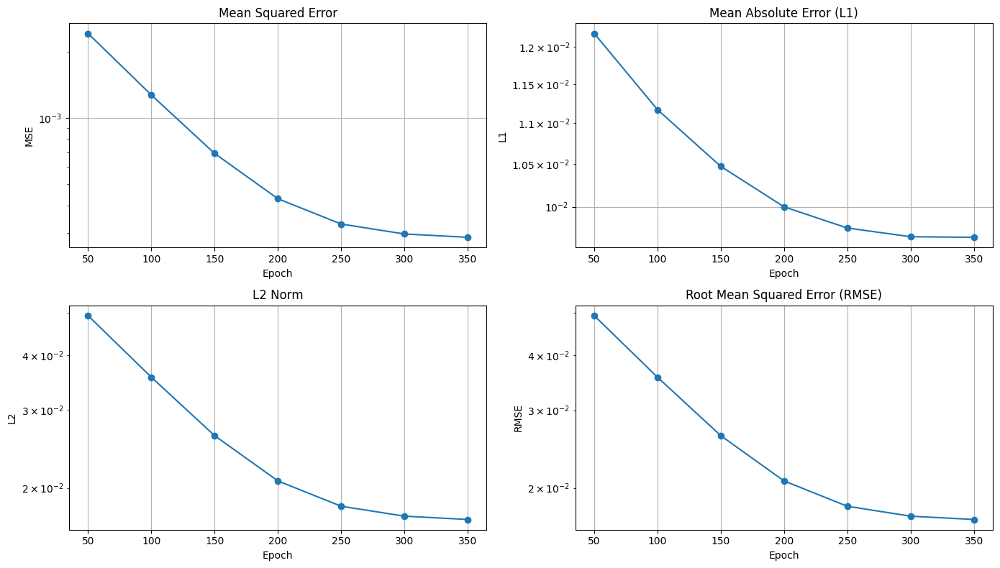

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 388ms/step - loss: 2.7802e-04 - val_loss: 2.8757e-04
Epoch 351/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 2.7576e-04 - val_loss: 2.8758e-04
Epoch 352/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 2.6456e-04 - val_loss: 2.8753e-04
Epoch 353/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 2.6848e-04 - val_loss: 2.8736e-04
Epoch 354/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 2.6588e-04 - val_loss: 2.8716e-04
Epoch 355/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 2.8073e-04 - val_loss: 2.8711e-04
Epoch 356/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.6343e-04 - val_loss: 2.8728e-04
Epoch 357/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 2.6349e-04 - val_loss: 2.8722e-04
Epoch 358/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 2.6350e-04 - val_loss: 2.8722e-04
Epoch 359/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 2.5715e-04 - val_loss: 2.8702e-04
Epoch 360/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 2.6903e-04 - 

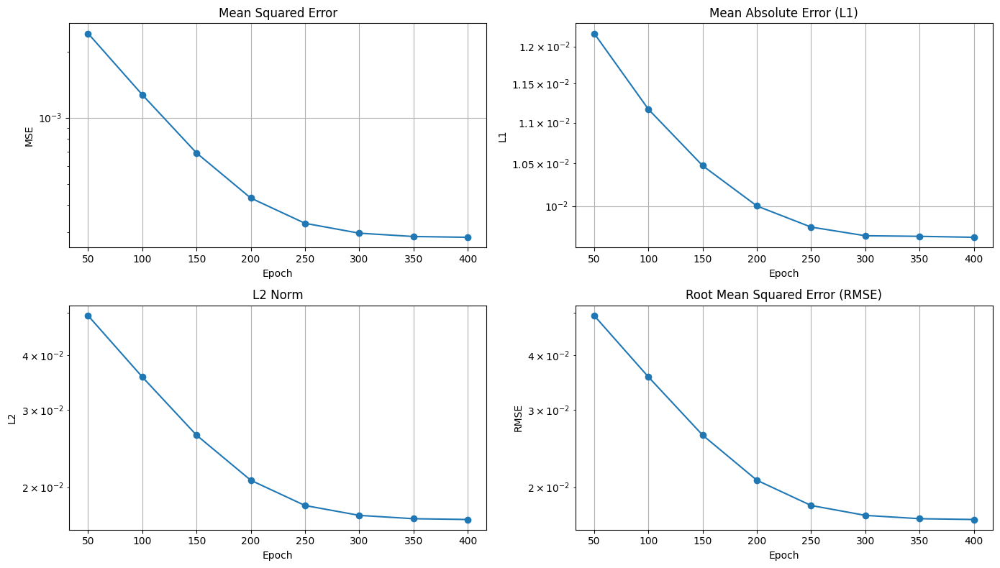

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 354ms/step - loss: 2.7871e-04 - val_loss: 2.8517e-04
Epoch 401/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 2.5942e-04 - val_loss: 2.8515e-04
Epoch 402/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 2.6577e-04 - val_loss: 2.8523e-04
Epoch 403/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.6255e-04 - val_loss: 2.8500e-04
Epoch 404/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.6826e-04 - val_loss: 2.8484e-04
Epoch 405/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.6427e-04 - val_loss: 2.8518e-04
Epoch 406/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.5707e-04 - val_loss: 2.8506e-04
Epoch 407/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.5081e-04 - val_loss: 2.8509e-04
Epoch 408/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.6489e-04 - val_loss: 2.8496e-04
Epoch 409/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2.6866e-04 - val_loss: 2.8515e-04
Epoch 410/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.6803e-04 - 

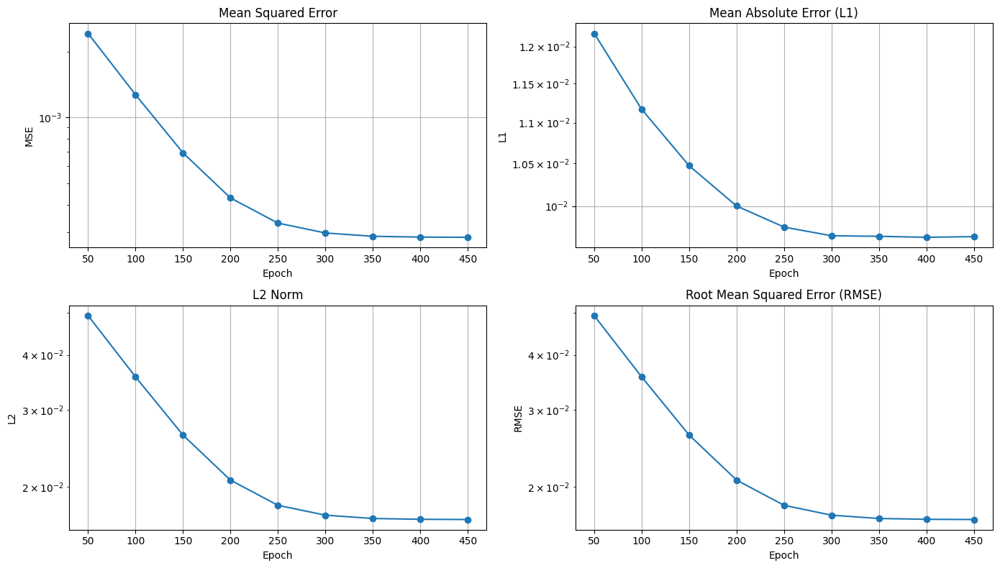

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 452ms/step - loss: 2.5241e-04 - val_loss: 2.8452e-04
Epoch 451/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.6364e-04 - val_loss: 2.8432e-04
Epoch 452/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.5358e-04 - val_loss: 2.8444e-04
Epoch 453/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.7033e-04 - val_loss: 2.8438e-04
Epoch 454/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.7529e-04 - val_loss: 2.8427e-04
Epoch 455/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.6310e-04 - val_loss: 2.8460e-04
Epoch 456/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.6537e-04 - val_loss: 2.8438e-04
Epoch 457/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 2.6093e-04 - val_loss: 2.8458e-04
Epoch 458/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.7394e-04 - val_loss: 2.8455e-04
Epoch 459/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.6242e-04 - val_loss: 2.8457e-04
Epoch 460/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.5396e-04 - 

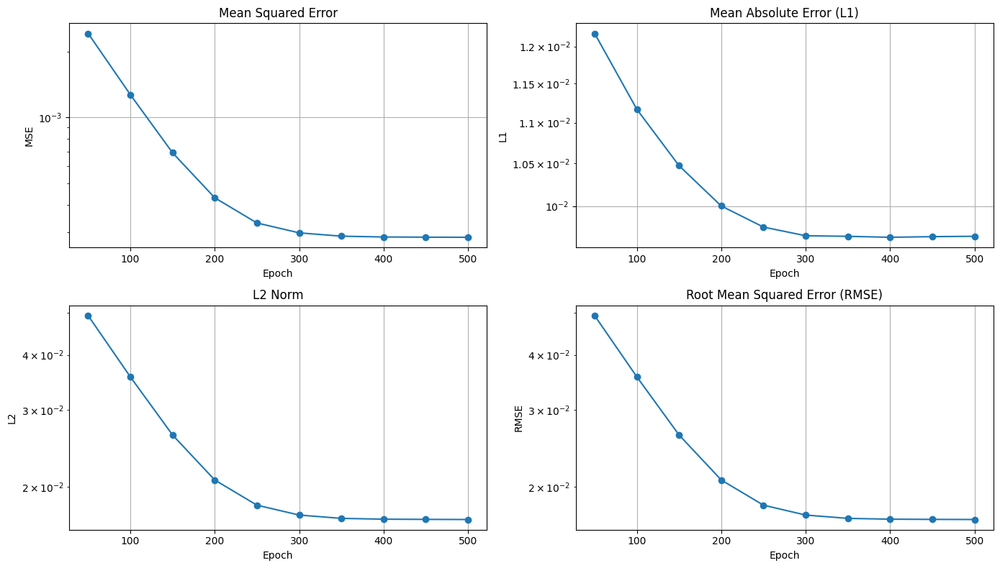

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 334ms/step - loss: 2.6144e-04 - val_loss: 2.8419e-04


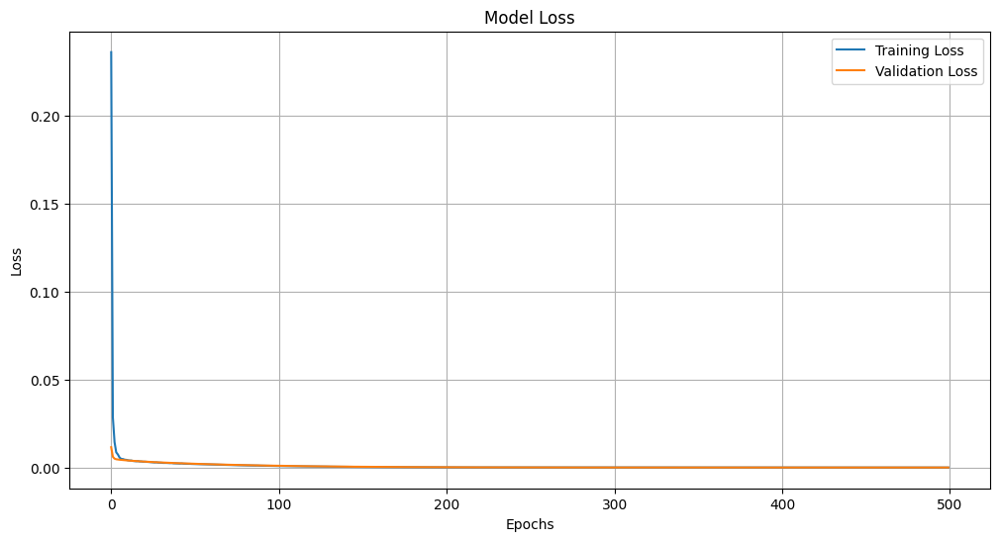

Epoch 1/500


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 46ms/step - loss: 2.4278 - val_loss: 0.1372
Epoch 2/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.4430 - val_loss: 0.0598
Epoch 3/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.1526 - val_loss: 0.0407
Epoch 4/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 0.0966 - val_loss: 0.0336
Epoch 5/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0676 - val_loss: 0.0306
Epoch 6/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0546 - val_loss: 0.0289
Epoch 7/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0505 - val_loss: 0.0277
Epoch 8/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0447 - val_loss: 0.0269
Epoch 9/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0435 - val_loss: 0.0262
Epoch 10/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0352 - val_loss: 0.0256
Epoch 11/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0376 - val_loss: 0.0251
Epoch 12/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0326 - val_loss: 0.0246
E

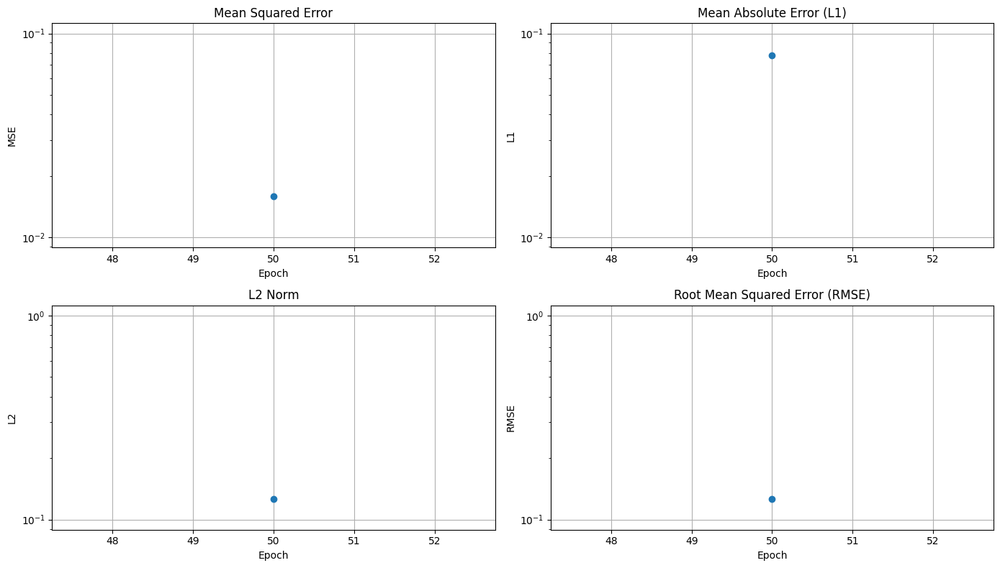

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 398ms/step - loss: 0.0152 - val_loss: 0.0159
Epoch 51/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0150 - val_loss: 0.0158
Epoch 52/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0151 - val_loss: 0.0157
Epoch 53/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0148 - val_loss: 0.0157
Epoch 54/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0148 - val_loss: 0.0156
Epoch 55/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0149 - val_loss: 0.0156
Epoch 56/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0154 - val_loss: 0.0155
Epoch 57/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0148 - val_loss: 0.0155
Epoch 58/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0153 - val_loss: 0.0154
Epoch 59/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0151 - val_loss: 0.0154
Epoch 60/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0144 - val_loss: 0.0153
Epoch 61/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0142 - val_loss:

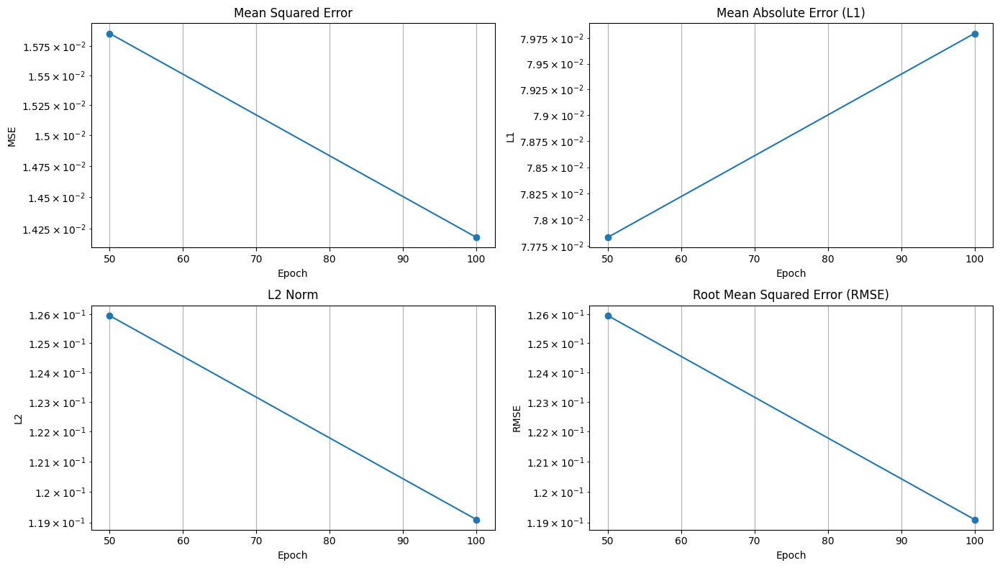

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 355ms/step - loss: 0.0134 - val_loss: 0.0142
Epoch 101/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0132 - val_loss: 0.0142
Epoch 102/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0134 - val_loss: 0.0141
Epoch 103/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0130 - val_loss: 0.0141
Epoch 104/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0133 - val_loss: 0.0141
Epoch 105/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0136 - val_loss: 0.0141
Epoch 106/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0128 - val_loss: 0.0141
Epoch 107/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0132 - val_loss: 0.0141
Epoch 108/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0133 - val_loss: 0.0140
Epoch 109/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0134 - val_loss: 0.0140
Epoch 110/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0127 - val_loss: 0.0140
Epoch 111/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0128 

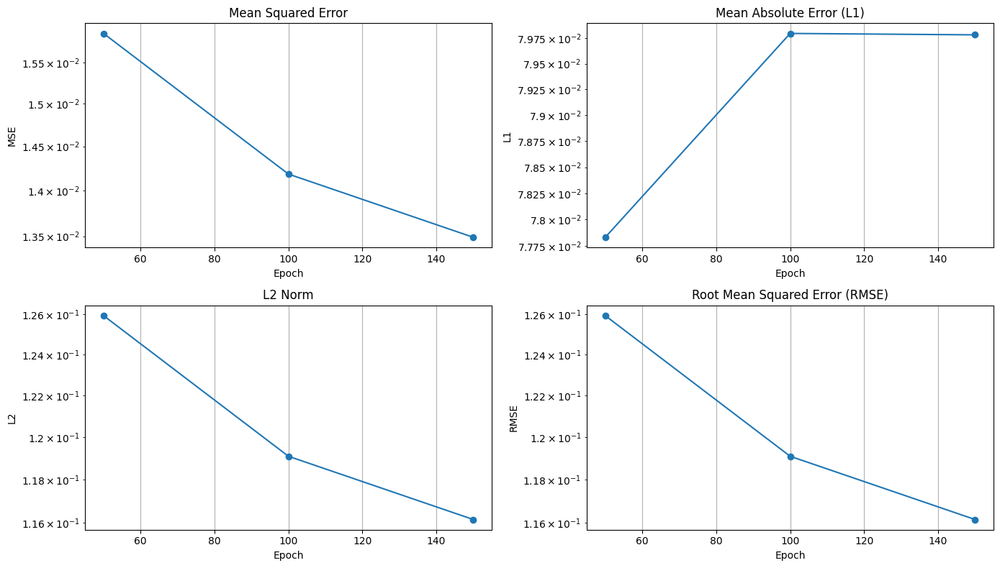

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 377ms/step - loss: 0.0127 - val_loss: 0.0135
Epoch 151/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0133 - val_loss: 0.0135
Epoch 152/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0125 - val_loss: 0.0135
Epoch 153/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0131 - val_loss: 0.0135
Epoch 154/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0121 - val_loss: 0.0135
Epoch 155/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0125 - val_loss: 0.0134
Epoch 156/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0128 - val_loss: 0.0134
Epoch 157/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0130 - val_loss: 0.0134
Epoch 158/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0127 - val_loss: 0.0134
Epoch 159/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0126 - val_loss: 0.0134
Epoch 160/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0121 - val_loss: 0.0134
Epoch 161/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0123 

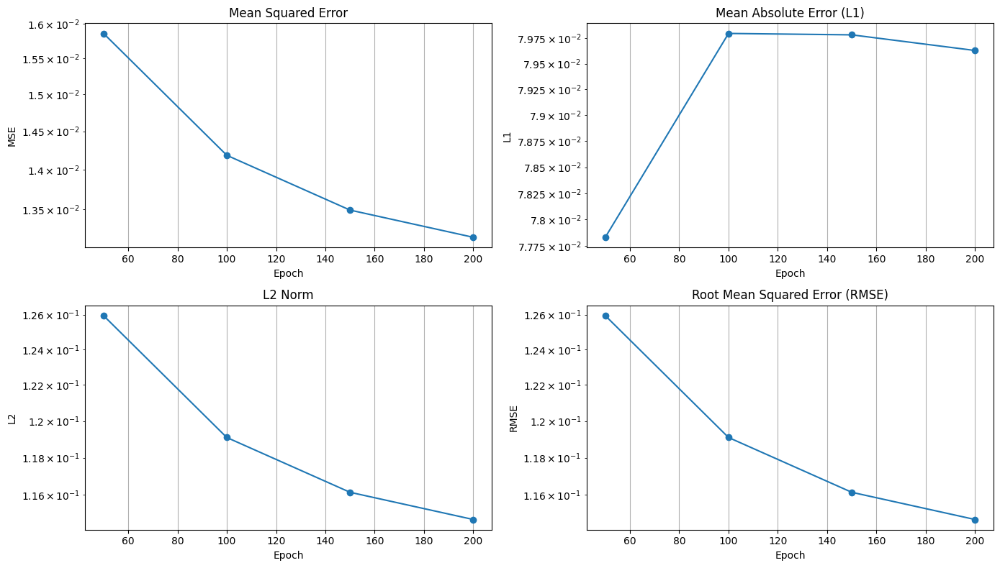

6/6 ━━━━━━━━━━━━━━━━━━━━ 26s 5s/step - loss: 0.0126 - val_loss: 0.0132
Epoch 201/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 15s 29ms/step - loss: 0.0119 - val_loss: 0.0132
Epoch 202/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0120 - val_loss: 0.0131
Epoch 203/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0119 - val_loss: 0.0131
Epoch 204/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0122 - val_loss: 0.0131
Epoch 205/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0122 - val_loss: 0.0131
Epoch 206/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0120 - val_loss: 0.0131
Epoch 207/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0125 - val_loss: 0.0131
Epoch 208/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0118 - val_loss: 0.0131
Epoch 209/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0117 - val_loss: 0.0131
Epoch 210/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0121 - val_loss: 0.0131
Epoch 211/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0120 -

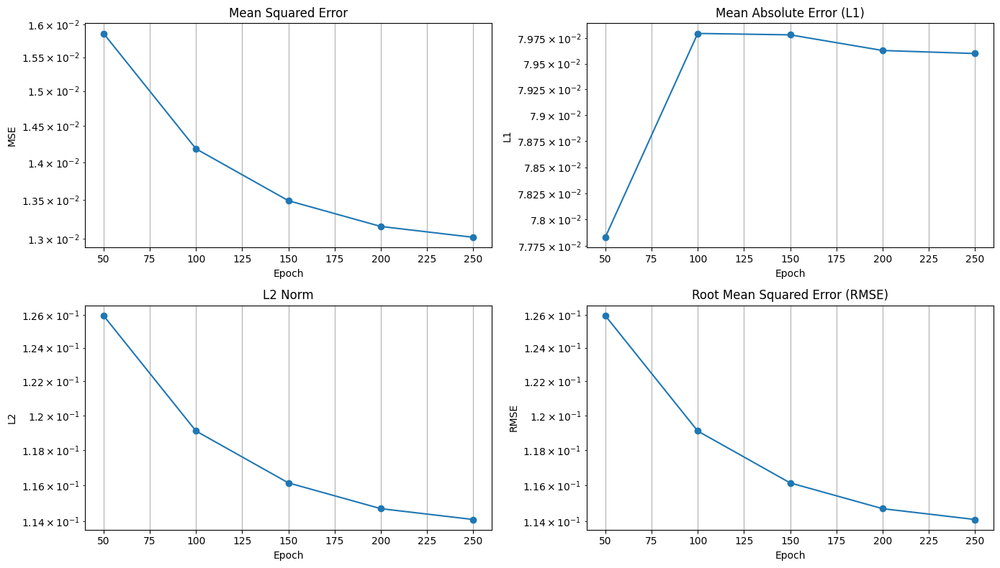

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 564ms/step - loss: 0.0121 - val_loss: 0.0130
Epoch 251/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0123 - val_loss: 0.0130
Epoch 252/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0121 - val_loss: 0.0130
Epoch 253/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0120 - val_loss: 0.0130
Epoch 254/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0124 - val_loss: 0.0130
Epoch 255/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0119 - val_loss: 0.0130
Epoch 256/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0120 - val_loss: 0.0130
Epoch 257/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0124 - val_loss: 0.0130
Epoch 258/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0122 - val_loss: 0.0130
Epoch 259/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0117 - val_loss: 0.0130
Epoch 260/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0118 - val_loss: 0.0130
Epoch 261/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0120 

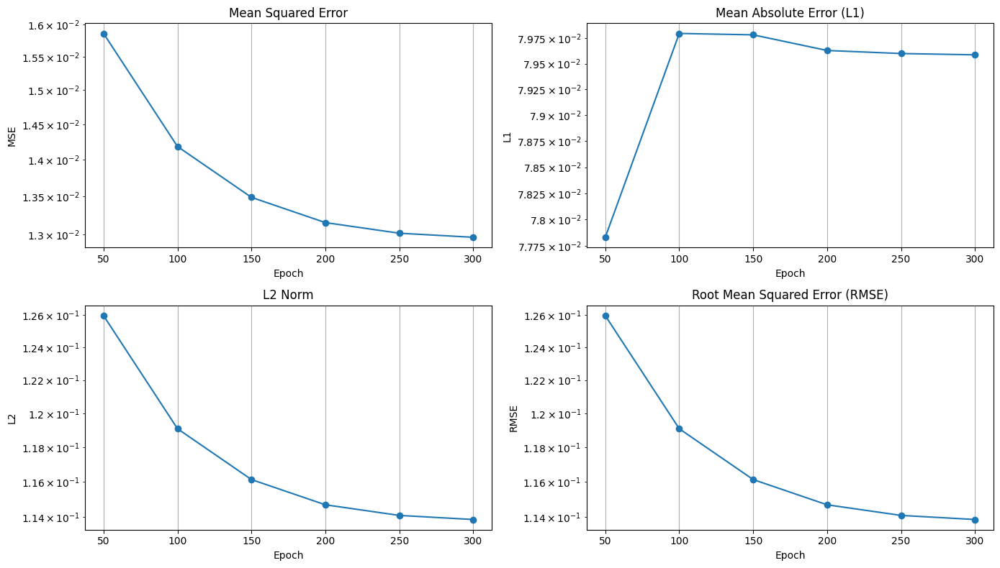

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 594ms/step - loss: 0.0119 - val_loss: 0.0130
Epoch 301/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step - loss: 0.0121 - val_loss: 0.0130
Epoch 302/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0118 - val_loss: 0.0130
Epoch 303/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0119 - val_loss: 0.0130
Epoch 304/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0120 - val_loss: 0.0130
Epoch 305/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0120 - val_loss: 0.0130
Epoch 306/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0122 - val_loss: 0.0130
Epoch 307/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0121 - val_loss: 0.0130
Epoch 308/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0120 - val_loss: 0.0130
Epoch 309/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0119 - val_loss: 0.0130
Epoch 310/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0118 - val_loss: 0.0130
Epoch 311/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0124 

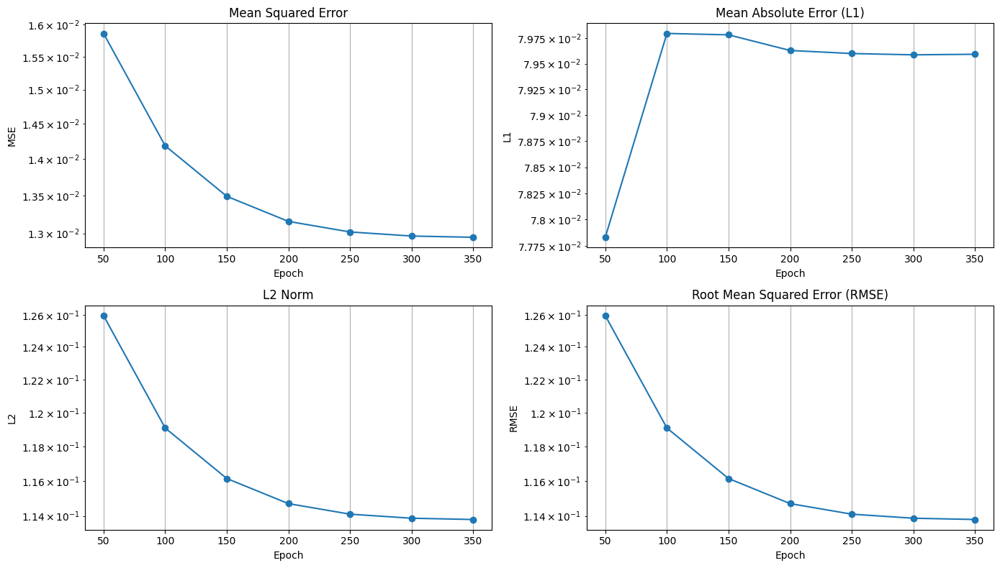

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 566ms/step - loss: 0.0119 - val_loss: 0.0129
Epoch 351/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0115 - val_loss: 0.0129
Epoch 352/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0122 - val_loss: 0.0129
Epoch 353/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0122 - val_loss: 0.0129
Epoch 354/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0121 - val_loss: 0.0129
Epoch 355/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0116 - val_loss: 0.0129
Epoch 356/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0119 - val_loss: 0.0130
Epoch 357/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0124 - val_loss: 0.0130
Epoch 358/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0121 - val_loss: 0.0129
Epoch 359/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0118 - val_loss: 0.0130
Epoch 360/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0120 - val_loss: 0.0130
Epoch 361/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0117 

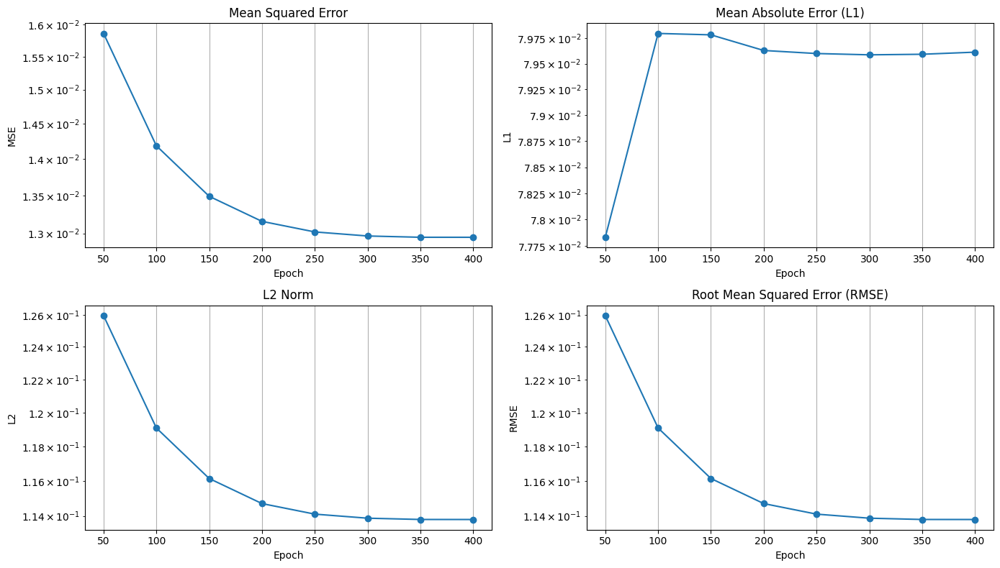

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 615ms/step - loss: 0.0120 - val_loss: 0.0129
Epoch 401/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0120 - val_loss: 0.0129
Epoch 402/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0122 - val_loss: 0.0129
Epoch 403/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0122 - val_loss: 0.0129
Epoch 404/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0123 - val_loss: 0.0129
Epoch 405/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0121 - val_loss: 0.0129
Epoch 406/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0119 - val_loss: 0.0129
Epoch 407/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0120 - val_loss: 0.0129
Epoch 408/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0121 - val_loss: 0.0129
Epoch 409/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0119 - val_loss: 0.0129
Epoch 410/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 0.0123 - val_loss: 0.0129
Epoch 411/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0119 

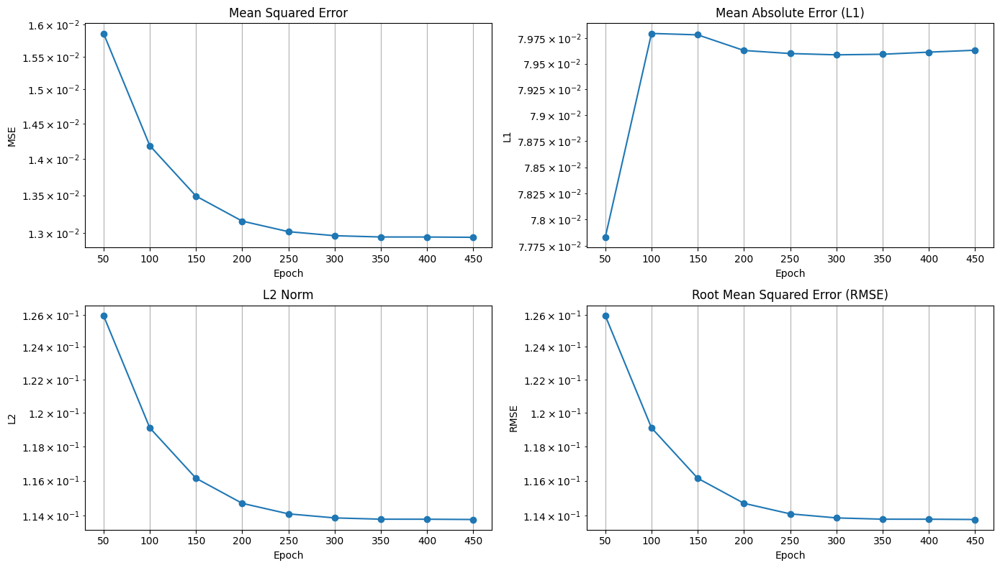

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 567ms/step - loss: 0.0124 - val_loss: 0.0129
Epoch 451/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0119 - val_loss: 0.0129
Epoch 452/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 0.0120 - val_loss: 0.0129
Epoch 453/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.0124 - val_loss: 0.0129
Epoch 454/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.0120 - val_loss: 0.0129
Epoch 455/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0121 - val_loss: 0.0129
Epoch 456/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0118 - val_loss: 0.0129
Epoch 457/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0121 - val_loss: 0.0129
Epoch 458/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0125 - val_loss: 0.0129
Epoch 459/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0122 - val_loss: 0.0129
Epoch 460/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0120 - val_loss: 0.0129
Epoch 461/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0121 

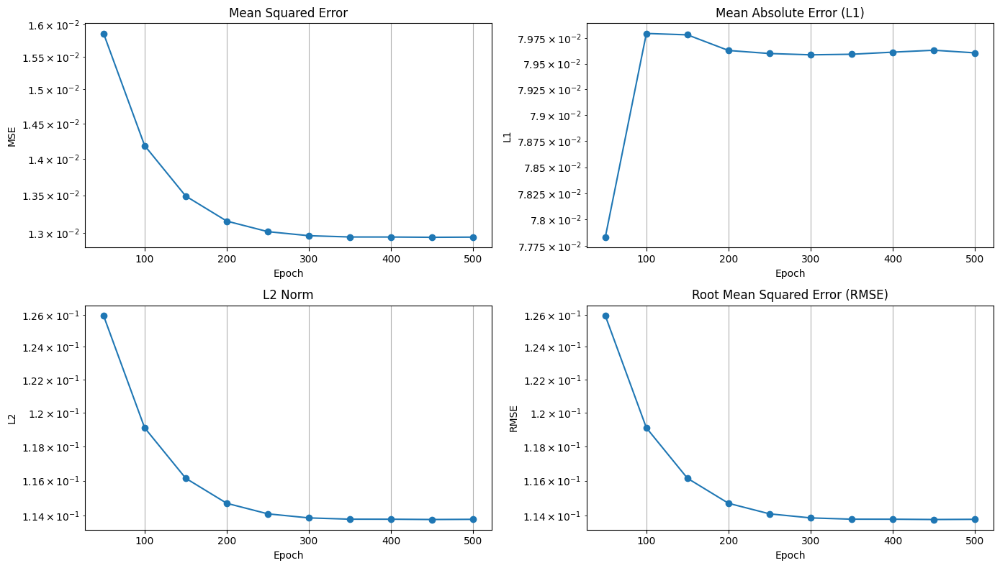

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 488ms/step - loss: 0.0120 - val_loss: 0.0129


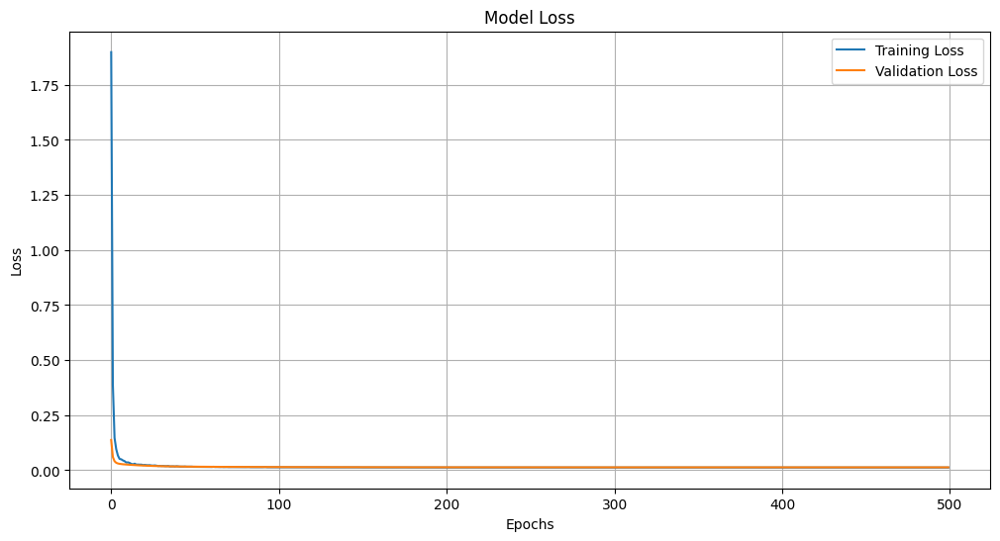

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 49ms/step - loss: 8.1005 - val_loss: 0.5326
Epoch 2/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 1.4814 - val_loss: 0.2823
Epoch 3/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.7499 - val_loss: 0.2208
Epoch 4/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.4543 - val_loss: 0.1982
Epoch 5/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.3317 - val_loss: 0.1876
Epoch 6/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.2698 - val_loss: 0.1816
Epoch 7/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.2518 - val_loss: 0.1775
Epoch 8/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.2381 - val_loss: 0.1744
Epoch 9/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.2198 - val_loss: 0.1718
Epoch 10/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.2088 - val_loss: 0.1696
Epoch 11/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.2055 - val_loss: 0.1675
Epoch 12/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.1944 - val_lo

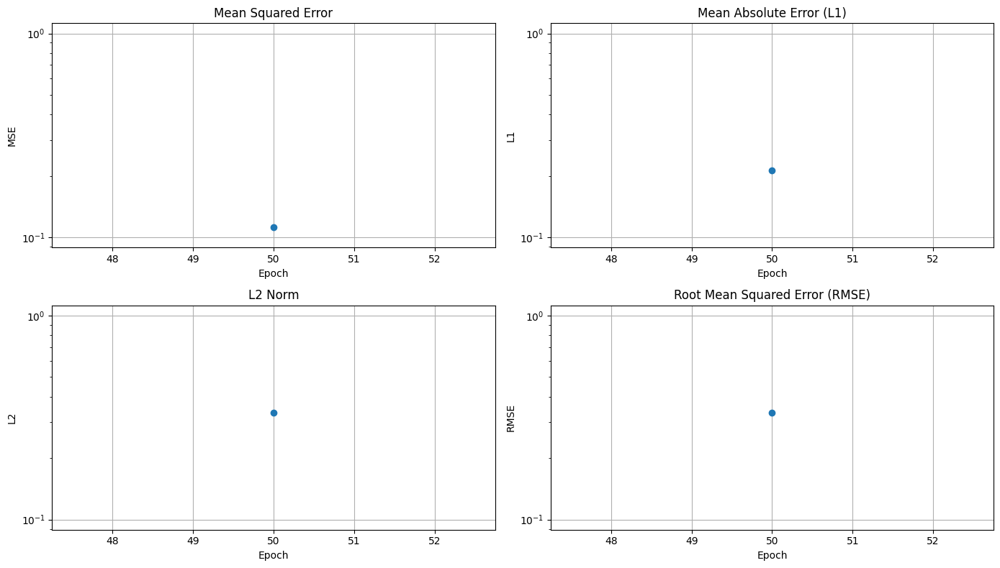

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 628ms/step - loss: 0.1226 - val_loss: 0.1119
Epoch 51/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.1182 - val_loss: 0.1111
Epoch 52/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.1174 - val_loss: 0.1104
Epoch 53/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.1145 - val_loss: 0.1097
Epoch 54/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.1191 - val_loss: 0.1090
Epoch 55/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.1125 - val_loss: 0.1084
Epoch 56/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.1142 - val_loss: 0.1077
Epoch 57/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.1117 - val_loss: 0.1071
Epoch 58/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.1112 - val_loss: 0.1065
Epoch 59/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.1148 - val_loss: 0.1060
Epoch 60/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.1092 - val_loss: 0.1054
Epoch 61/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.1141 - val_loss:

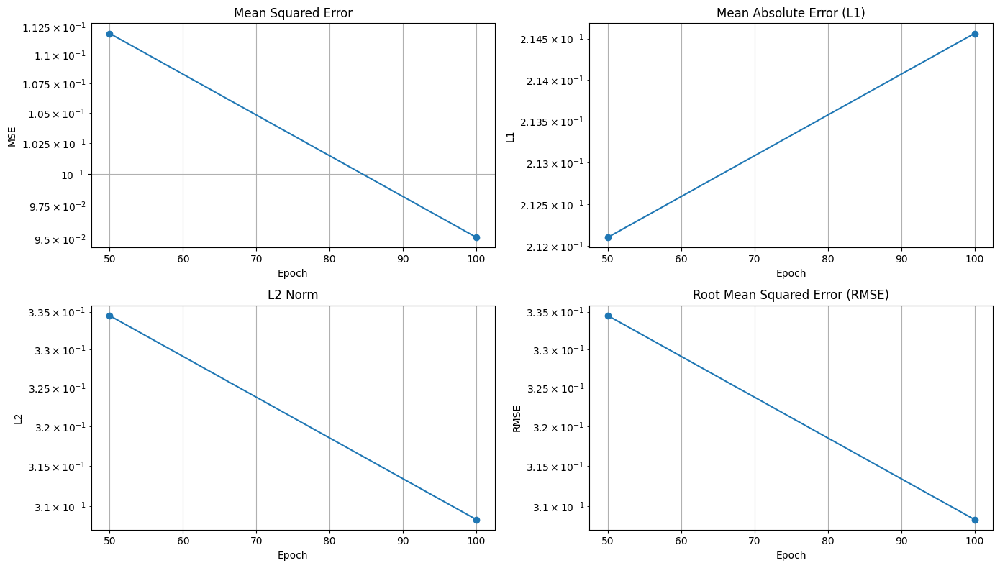

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 519ms/step - loss: 0.0999 - val_loss: 0.0951
Epoch 101/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0998 - val_loss: 0.0950
Epoch 102/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.1037 - val_loss: 0.0949
Epoch 103/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.1012 - val_loss: 0.0948
Epoch 104/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0974 - val_loss: 0.0947
Epoch 105/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 0.1010 - val_loss: 0.0947
Epoch 106/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.1005 - val_loss: 0.0946
Epoch 107/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0981 - val_loss: 0.0945
Epoch 108/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0961 - val_loss: 0.0944
Epoch 109/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 0.0986 - val_loss: 0.0944
Epoch 110/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0974 - val_loss: 0.0943
Epoch 111/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0950 

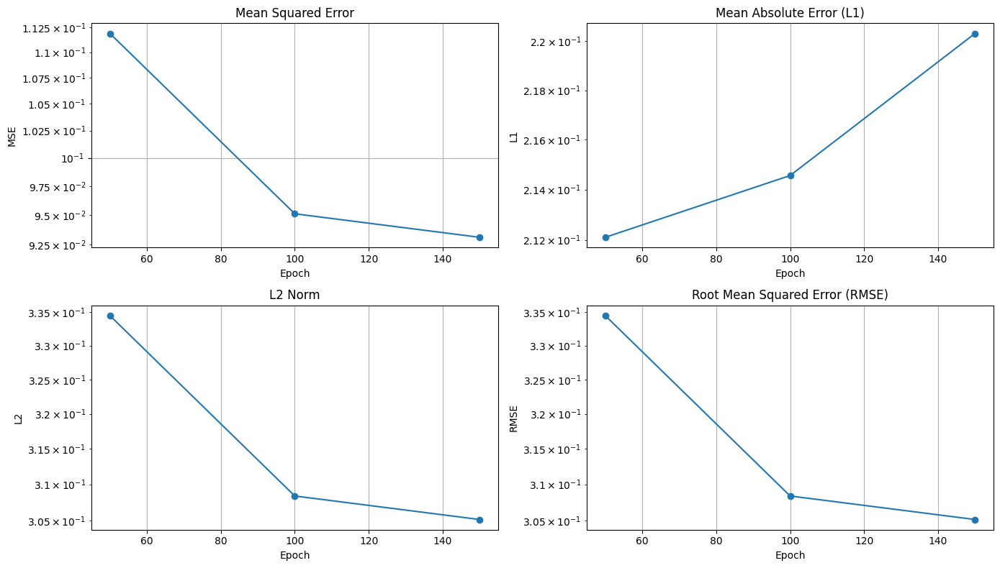

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 488ms/step - loss: 0.0967 - val_loss: 0.0931
Epoch 151/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0969 - val_loss: 0.0931
Epoch 152/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0951 - val_loss: 0.0931
Epoch 153/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0939 - val_loss: 0.0931
Epoch 154/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0918 - val_loss: 0.0930
Epoch 155/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 0.0991 - val_loss: 0.0930
Epoch 156/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.0926 - val_loss: 0.0930
Epoch 157/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0952 - val_loss: 0.0930
Epoch 158/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0984 - val_loss: 0.0930
Epoch 159/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0946 - val_loss: 0.0930
Epoch 160/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0975 - val_loss: 0.0930
Epoch 161/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0962 

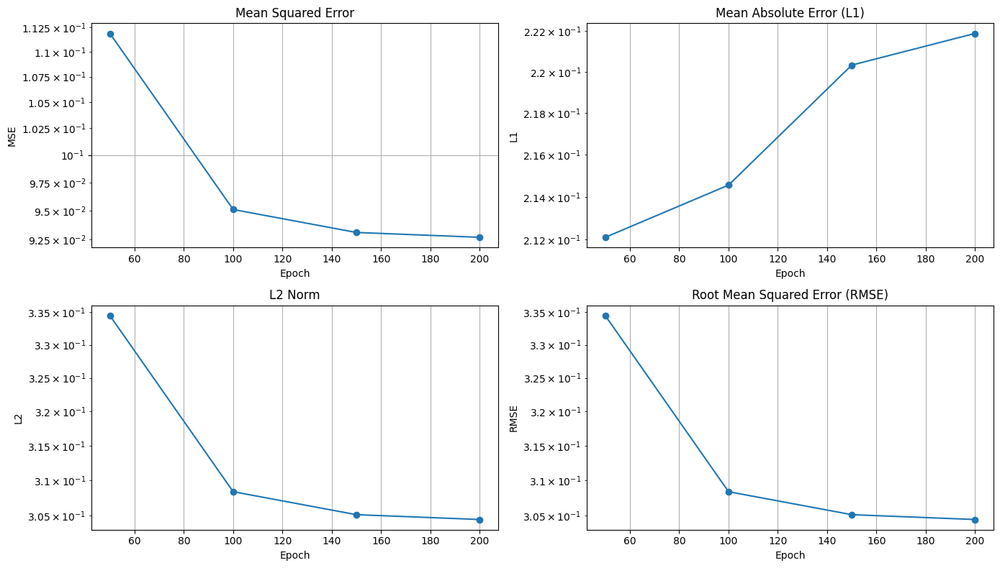

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 498ms/step - loss: 0.0951 - val_loss: 0.0927
Epoch 201/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0940 - val_loss: 0.0927
Epoch 202/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0939 - val_loss: 0.0927
Epoch 203/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0941 - val_loss: 0.0927
Epoch 204/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 0.0956 - val_loss: 0.0927
Epoch 205/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0963 - val_loss: 0.0927
Epoch 206/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.0948 - val_loss: 0.0927
Epoch 207/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0928 - val_loss: 0.0927
Epoch 208/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0965 - val_loss: 0.0927
Epoch 209/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0934 - val_loss: 0.0927
Epoch 210/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0942 - val_loss: 0.0926
Epoch 211/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0928 

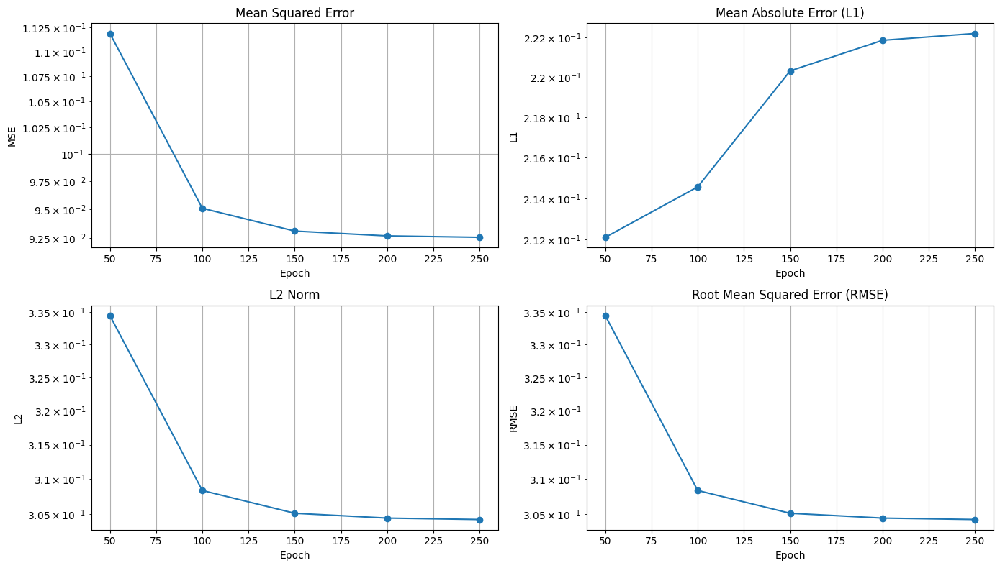

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 493ms/step - loss: 0.0977 - val_loss: 0.0926
Epoch 251/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0930 - val_loss: 0.0926
Epoch 252/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0962 - val_loss: 0.0926
Epoch 253/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0947 - val_loss: 0.0925
Epoch 254/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0927 - val_loss: 0.0925
Epoch 255/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0958 - val_loss: 0.0925
Epoch 256/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0974 - val_loss: 0.0926
Epoch 257/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0913 - val_loss: 0.0925
Epoch 258/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0926 - val_loss: 0.0925
Epoch 259/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0918 - val_loss: 0.0926
Epoch 260/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0964 - val_loss: 0.0926
Epoch 261/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0924 

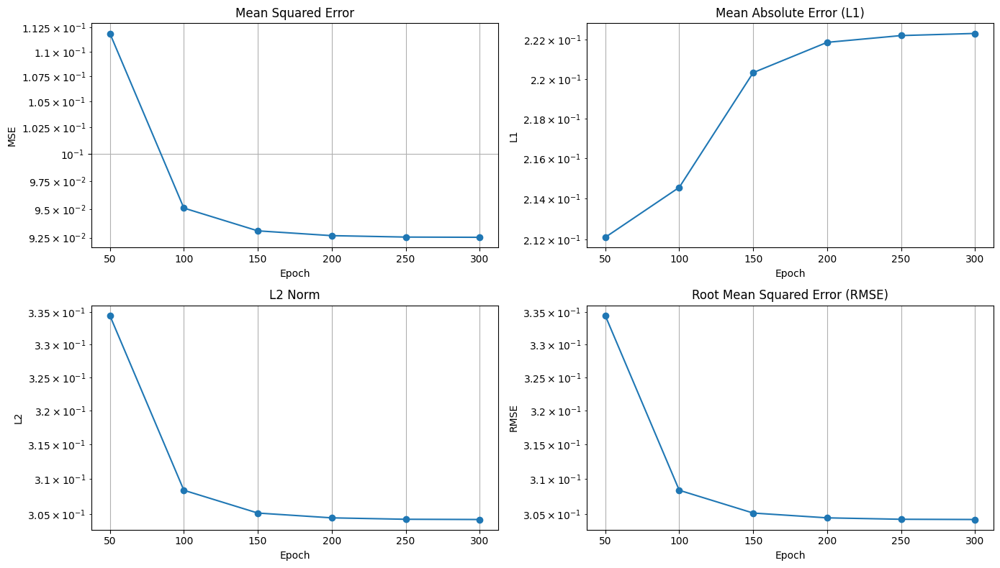

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 638ms/step - loss: 0.0922 - val_loss: 0.0925
Epoch 301/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0962 - val_loss: 0.0925
Epoch 302/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0945 - val_loss: 0.0925
Epoch 303/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 0.0919 - val_loss: 0.0925
Epoch 304/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0964 - val_loss: 0.0925
Epoch 305/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.0935 - val_loss: 0.0925
Epoch 306/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0935 - val_loss: 0.0925
Epoch 307/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 0.0918 - val_loss: 0.0925
Epoch 308/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 0.0921 - val_loss: 0.0925
Epoch 309/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 0.0934 - val_loss: 0.0925
Epoch 310/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0918 - val_loss: 0.0925
Epoch 311/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 0.0936 

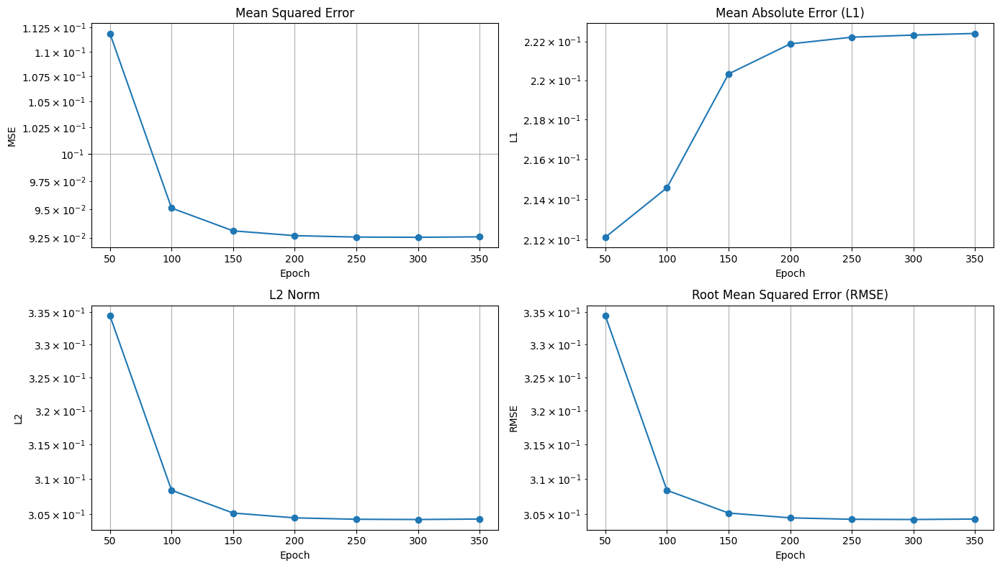

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 509ms/step - loss: 0.0942 - val_loss: 0.0926
Epoch 351/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - loss: 0.0918 - val_loss: 0.0926
Epoch 352/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0953 - val_loss: 0.0926
Epoch 353/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0911 - val_loss: 0.0926
Epoch 354/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 0.0951 - val_loss: 0.0926
Epoch 355/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0958 - val_loss: 0.0926
Epoch 356/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 0.0971 - val_loss: 0.0926
Epoch 357/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0932 - val_loss: 0.0926
Epoch 358/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 0.0922 - val_loss: 0.0926
Epoch 359/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0913 - val_loss: 0.0926
Epoch 360/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0935 - val_loss: 0.0926
Epoch 361/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0930 

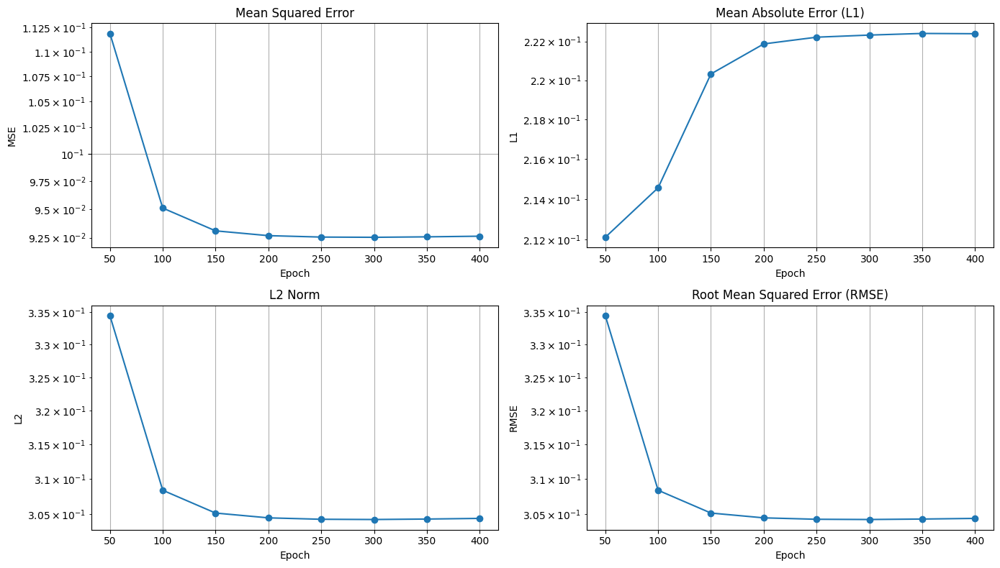

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 514ms/step - loss: 0.0940 - val_loss: 0.0926
Epoch 401/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0960 - val_loss: 0.0926
Epoch 402/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0922 - val_loss: 0.0926
Epoch 403/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0922 - val_loss: 0.0926
Epoch 404/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0957 - val_loss: 0.0926
Epoch 405/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0940 - val_loss: 0.0926
Epoch 406/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0952 - val_loss: 0.0926
Epoch 407/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 0.0916 - val_loss: 0.0926
Epoch 408/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0957 - val_loss: 0.0926
Epoch 409/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 0.0927 - val_loss: 0.0926
Epoch 410/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0923 - val_loss: 0.0926
Epoch 411/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 0.0944 

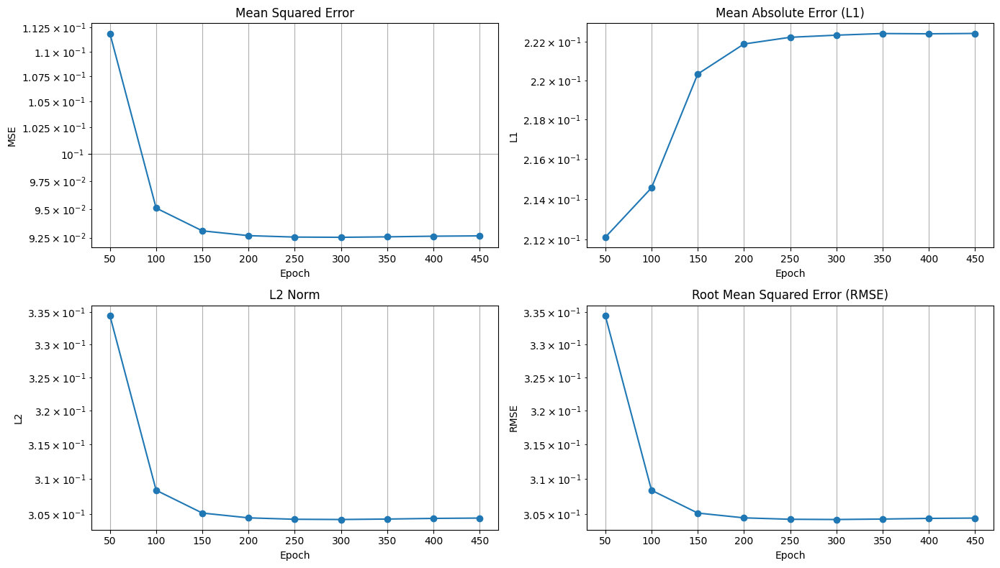

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 507ms/step - loss: 0.0940 - val_loss: 0.0927
Epoch 451/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0912 - val_loss: 0.0927
Epoch 452/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0932 - val_loss: 0.0927
Epoch 453/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0914 - val_loss: 0.0927
Epoch 454/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0943 - val_loss: 0.0927
Epoch 455/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0953 - val_loss: 0.0927
Epoch 456/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0962 - val_loss: 0.0927
Epoch 457/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0934 - val_loss: 0.0927
Epoch 458/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0924 - val_loss: 0.0927
Epoch 459/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0934 - val_loss: 0.0927
Epoch 460/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0962 - val_loss: 0.0927
Epoch 461/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 0.0910 

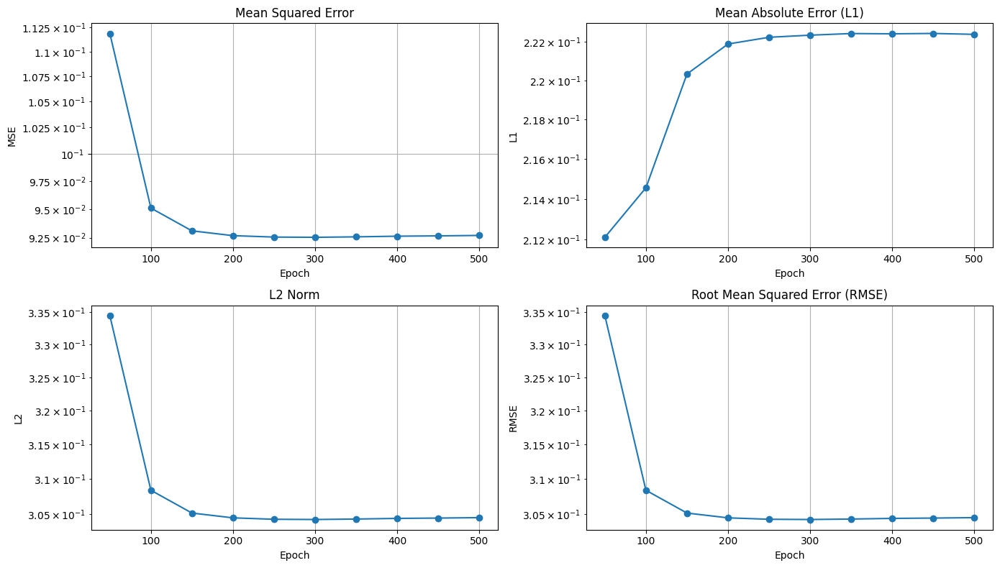

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 494ms/step - loss: 0.0953 - val_loss: 0.0927


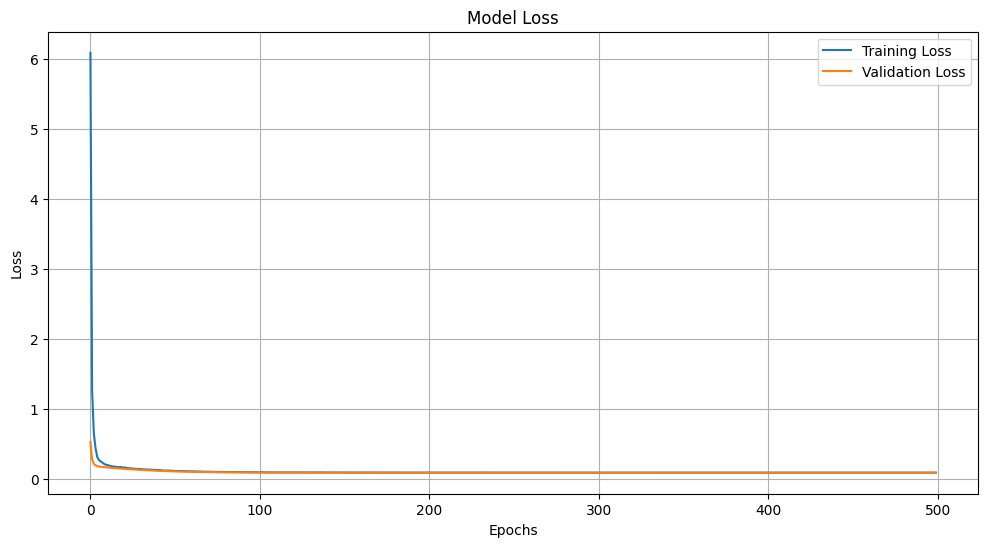

Epoch 1/500


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - loss: 37.5882 - val_loss: 4.0085
Epoch 2/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 8.4253 - val_loss: 2.9341
Epoch 3/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 4.9552 - val_loss: 2.7129
Epoch 4/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 3.8210 - val_loss: 2.6477
Epoch 5/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 3.3206 - val_loss: 2.6229
Epoch 6/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 3.0999 - val_loss: 2.6082
Epoch 7/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 2.8674 - val_loss: 2.5961
Epoch 8/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 2.8359 - val_loss: 2.5823
Epoch 9/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 2.8204 - val_loss: 2.5654
Epoch 10/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 2.7462 - val_loss: 2.5434
Epoch 11/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 2.6224 - val_loss: 2.5170
Epoch 12/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 2.6711 - val_loss: 2.4770


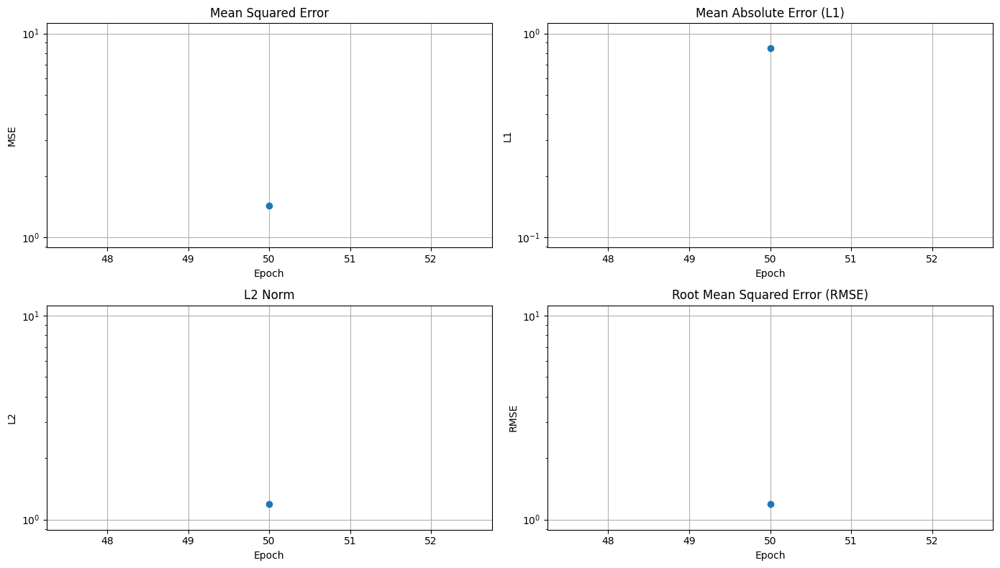

6/6 ━━━━━━━━━━━━━━━━━━━━ 6s 1s/step - loss: 1.6359 - val_loss: 1.4272
Epoch 51/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 1.6434 - val_loss: 1.4261
Epoch 52/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 1.5709 - val_loss: 1.4343
Epoch 53/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 1.5675 - val_loss: 1.4397
Epoch 54/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 1.5709 - val_loss: 1.4440
Epoch 55/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 1.6463 - val_loss: 1.4367
Epoch 56/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 1.6003 - val_loss: 1.4268
Epoch 57/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 1.5522 - val_loss: 1.4255
Epoch 58/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 1.5464 - val_loss: 1.4186
Epoch 59/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 1.5496 - val_loss: 1.4174
Epoch 60/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 1.5649 - val_loss: 1.4204
Epoch 61/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 1.5417 - val_loss: 1.

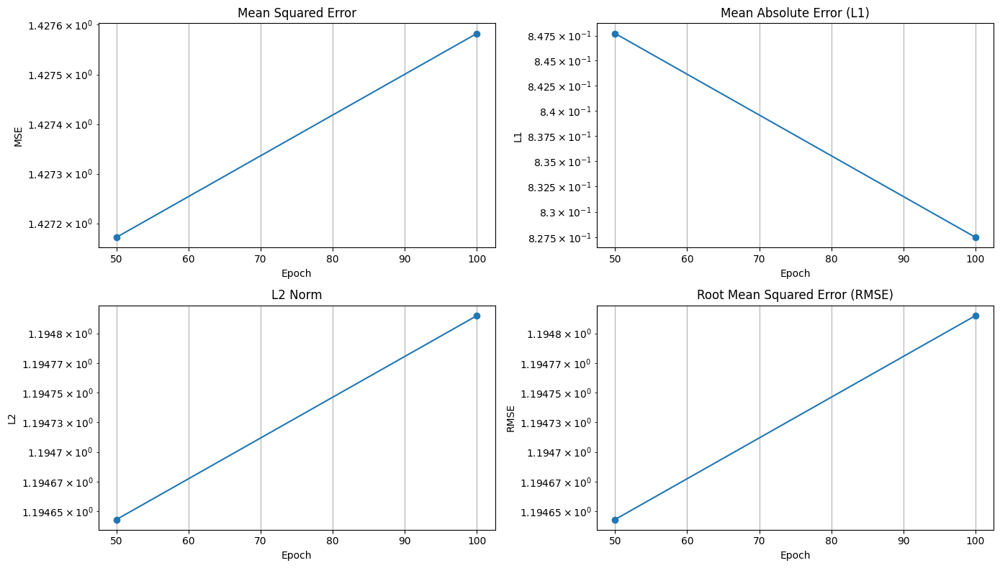

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 605ms/step - loss: 1.5359 - val_loss: 1.4276
Epoch 101/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 1.5139 - val_loss: 1.4264
Epoch 102/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 1.5406 - val_loss: 1.4169
Epoch 103/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 1.5763 - val_loss: 1.4060
Epoch 104/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 1.4965 - val_loss: 1.4034
Epoch 105/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 1.4456 - val_loss: 1.3958
Epoch 106/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - loss: 1.4957 - val_loss: 1.3990
Epoch 107/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 1.4884 - val_loss: 1.4048
Epoch 108/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - loss: 1.4943 - val_loss: 1.4146
Epoch 109/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 1.5090 - val_loss: 1.4151
Epoch 110/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 1.4784 - val_loss: 1.4110
Epoch 111/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - loss: 1.4360 

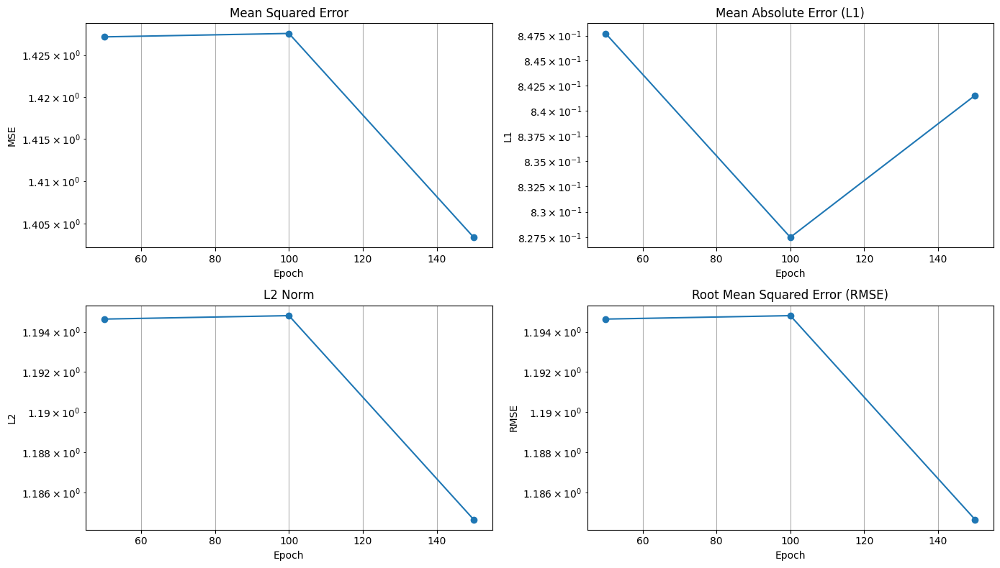

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 467ms/step - loss: 1.4561 - val_loss: 1.4034
Epoch 151/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 1.4598 - val_loss: 1.4041
Epoch 152/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.4241 - val_loss: 1.4156
Epoch 153/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.4754 - val_loss: 1.4214
Epoch 154/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.4444 - val_loss: 1.4065
Epoch 155/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 1.4344 - val_loss: 1.3989
Epoch 156/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 1.3757 - val_loss: 1.4098
Epoch 157/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 1.3721 - val_loss: 1.4399
Epoch 158/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 1.4461 - val_loss: 1.4408
Epoch 159/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 1.3823 - val_loss: 1.4133
Epoch 160/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 1.4617 - val_loss: 1.4003
Epoch 161/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.4001 

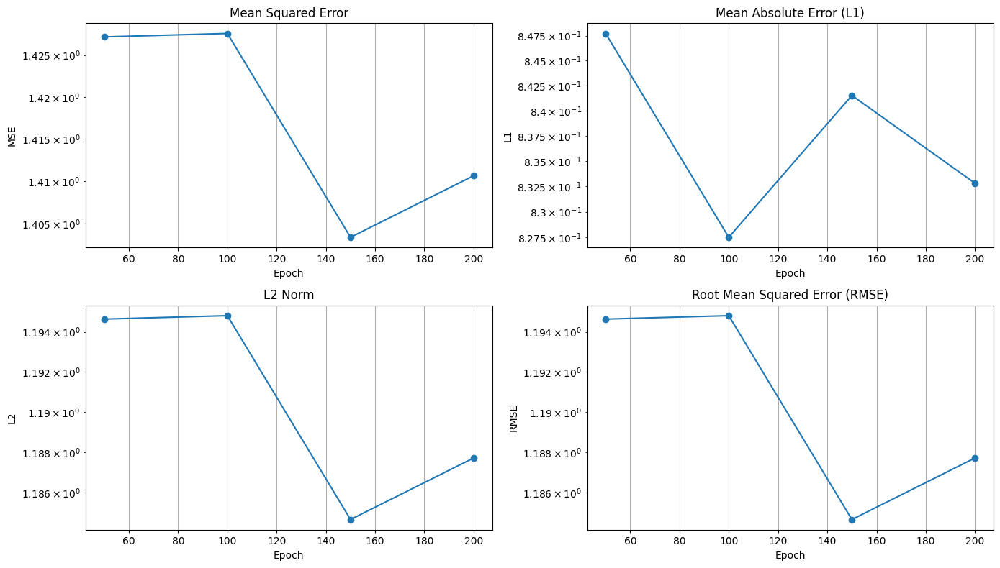

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 482ms/step - loss: 1.3289 - val_loss: 1.4107
Epoch 201/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.3425 - val_loss: 1.4160
Epoch 202/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.3526 - val_loss: 1.4171
Epoch 203/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 1.3961 - val_loss: 1.4235
Epoch 204/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.3489 - val_loss: 1.4296
Epoch 205/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 1.3457 - val_loss: 1.4301
Epoch 206/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.3484 - val_loss: 1.4191
Epoch 207/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.3565 - val_loss: 1.4089
Epoch 208/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.3562 - val_loss: 1.4162
Epoch 209/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 1.3028 - val_loss: 1.4174
Epoch 210/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.3483 - val_loss: 1.4330
Epoch 211/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 1.3383 

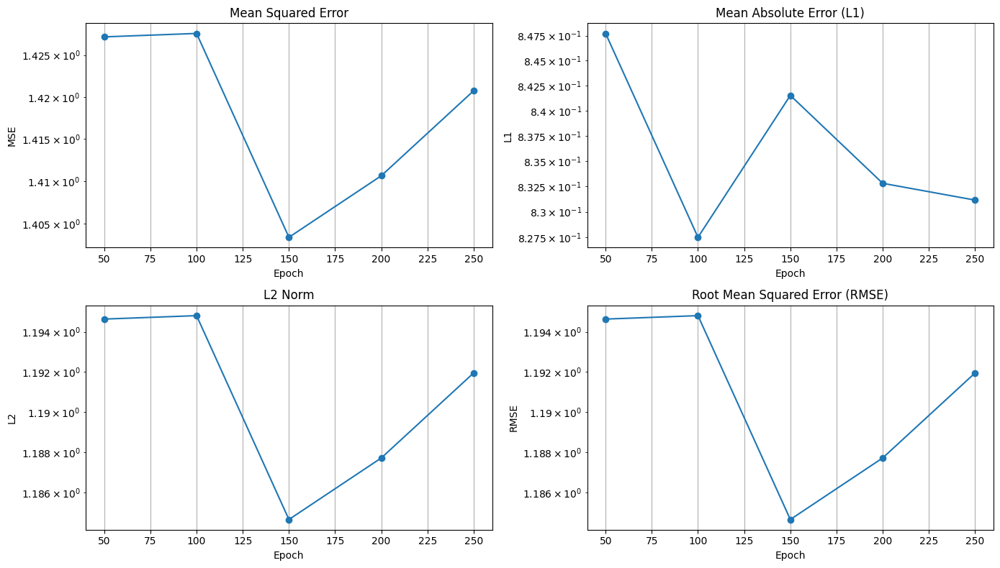

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 501ms/step - loss: 1.3076 - val_loss: 1.4207
Epoch 251/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 1.2442 - val_loss: 1.4229
Epoch 252/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.2373 - val_loss: 1.4156
Epoch 253/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 1.2725 - val_loss: 1.4229
Epoch 254/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 1.2542 - val_loss: 1.4208
Epoch 255/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.2060 - val_loss: 1.4276
Epoch 256/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 1.3241 - val_loss: 1.4319
Epoch 257/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 1.3112 - val_loss: 1.4187
Epoch 258/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 1.2415 - val_loss: 1.4266
Epoch 259/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 1.2252 - val_loss: 1.4269
Epoch 260/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 1.2720 - val_loss: 1.4268
Epoch 261/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 1.2807 

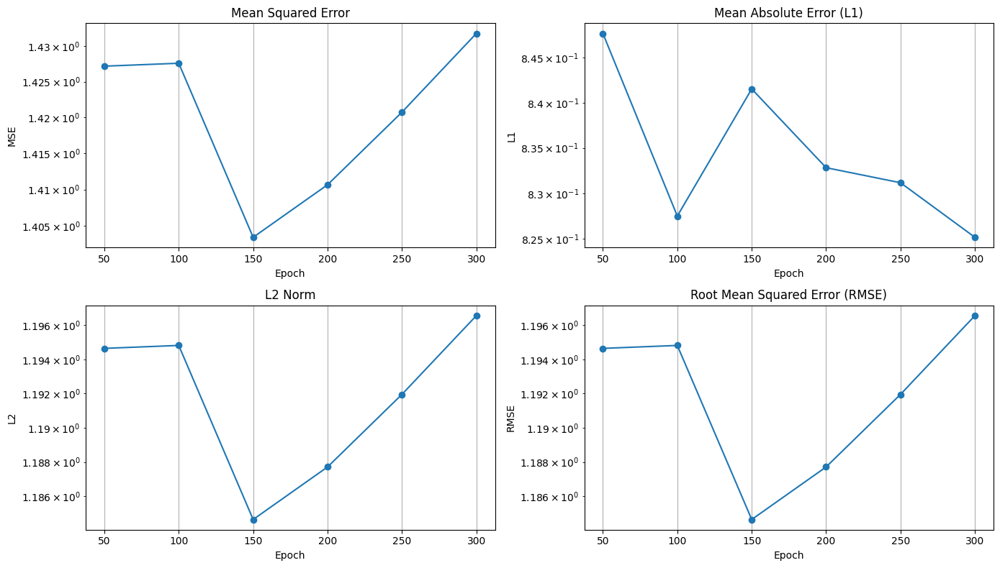

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 455ms/step - loss: 1.2587 - val_loss: 1.4318
Epoch 301/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 1.2404 - val_loss: 1.4384
Epoch 302/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.3111 - val_loss: 1.4292
Epoch 303/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 1.2027 - val_loss: 1.4146
Epoch 304/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 1.2541 - val_loss: 1.4117
Epoch 305/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 1.2677 - val_loss: 1.4266
Epoch 306/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 1.2542 - val_loss: 1.4316
Epoch 307/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 1.1828 - val_loss: 1.4249
Epoch 308/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 1.2113 - val_loss: 1.4277
Epoch 309/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 1.2021 - val_loss: 1.4378
Epoch 310/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 1.1933 - val_loss: 1.4301
Epoch 311/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.1739 

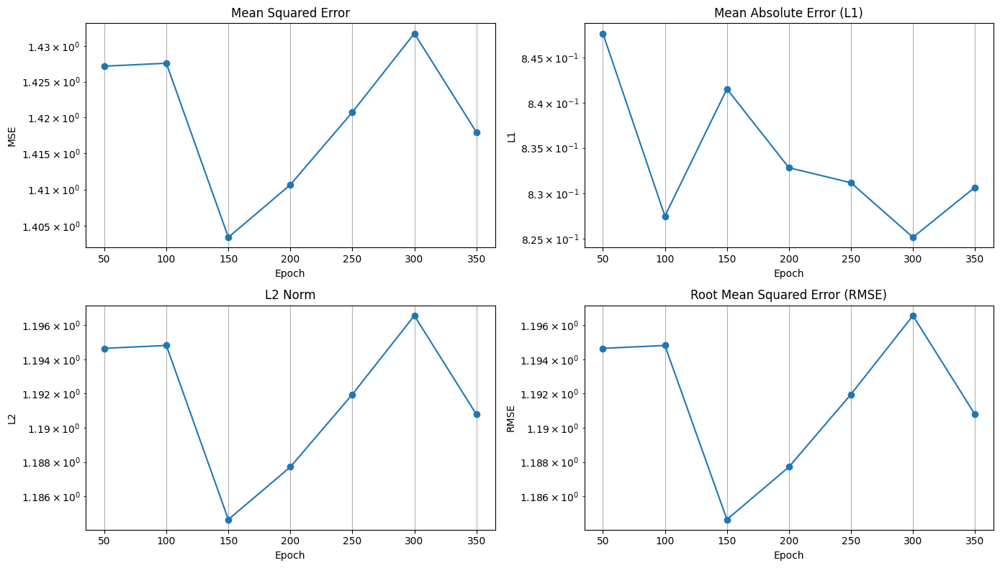

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 468ms/step - loss: 1.1938 - val_loss: 1.4180
Epoch 351/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.1427 - val_loss: 1.4202
Epoch 352/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 1.1649 - val_loss: 1.4238
Epoch 353/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.2022 - val_loss: 1.4324
Epoch 354/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 1.1991 - val_loss: 1.4324
Epoch 355/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 1.1581 - val_loss: 1.4269
Epoch 356/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.1396 - val_loss: 1.4164
Epoch 357/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.2061 - val_loss: 1.4149
Epoch 358/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.2724 - val_loss: 1.4147
Epoch 359/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 1.1713 - val_loss: 1.4202
Epoch 360/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.1434 - val_loss: 1.4278
Epoch 361/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.1531 

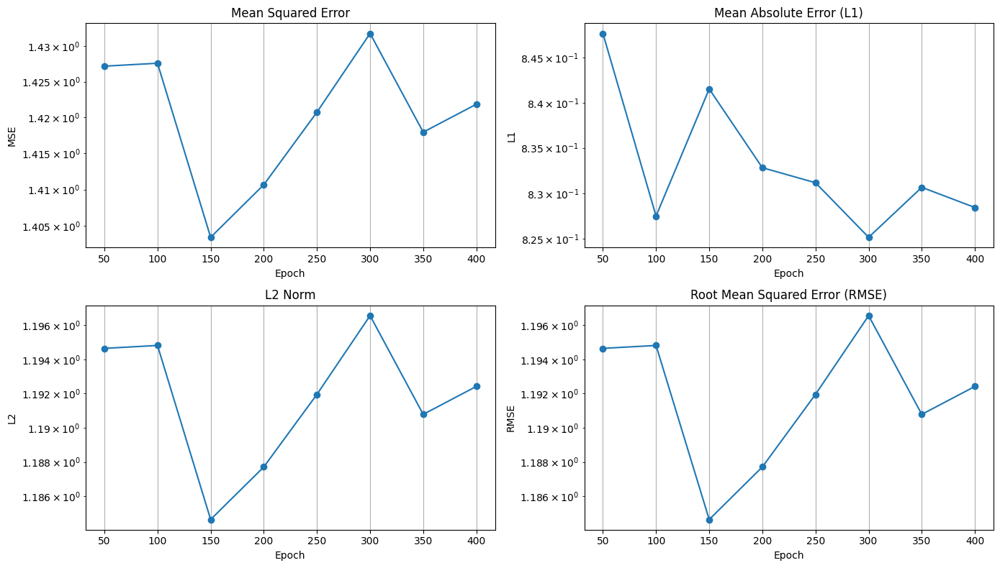

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 466ms/step - loss: 1.1851 - val_loss: 1.4219
Epoch 401/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.0568 - val_loss: 1.4221
Epoch 402/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 1.1142 - val_loss: 1.4213
Epoch 403/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.1824 - val_loss: 1.4199
Epoch 404/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.0937 - val_loss: 1.4202
Epoch 405/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 1.1233 - val_loss: 1.4177
Epoch 406/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.1422 - val_loss: 1.4199
Epoch 407/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 1.0472 - val_loss: 1.4174
Epoch 408/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 1.0939 - val_loss: 1.4147
Epoch 409/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 1.0380 - val_loss: 1.4134
Epoch 410/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.1166 - val_loss: 1.4089
Epoch 411/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 1.0669 

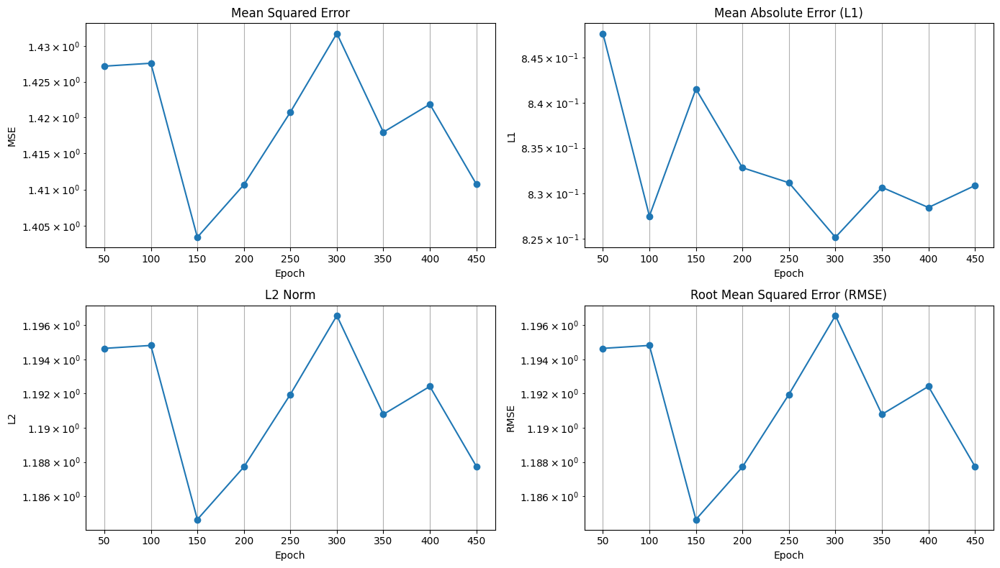

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 614ms/step - loss: 1.0753 - val_loss: 1.4107
Epoch 451/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.0670 - val_loss: 1.4102
Epoch 452/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 1.1146 - val_loss: 1.4107
Epoch 453/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 1.0988 - val_loss: 1.4151
Epoch 454/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 1.1608 - val_loss: 1.4180
Epoch 455/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 1.0338 - val_loss: 1.4183
Epoch 456/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 1.1400 - val_loss: 1.4169
Epoch 457/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.0397 - val_loss: 1.4108
Epoch 458/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 1.0662 - val_loss: 1.4057
Epoch 459/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.0881 - val_loss: 1.4087
Epoch 460/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.9934 - val_loss: 1.4151
Epoch 461/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.0936 

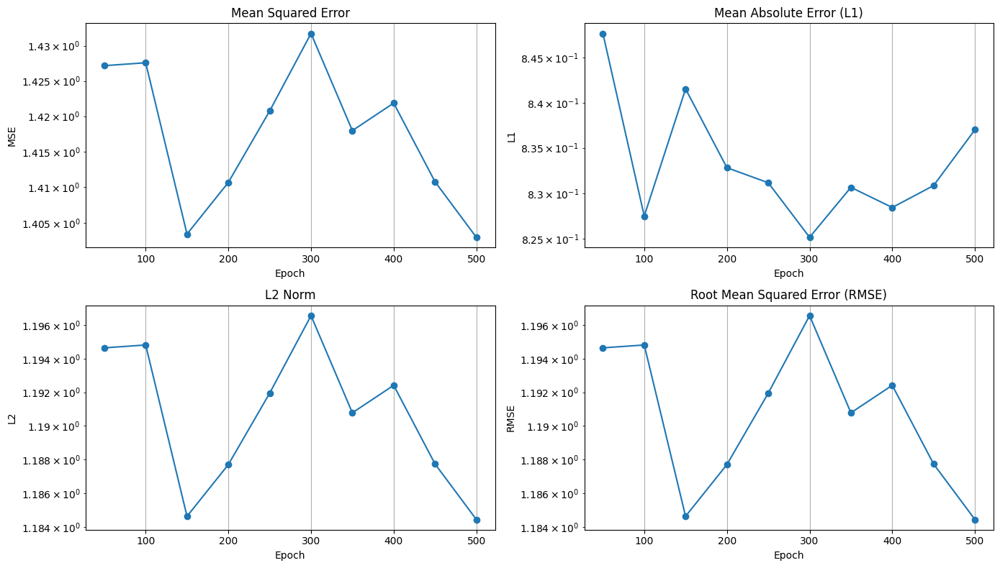

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 477ms/step - loss: 1.0421 - val_loss: 1.4030


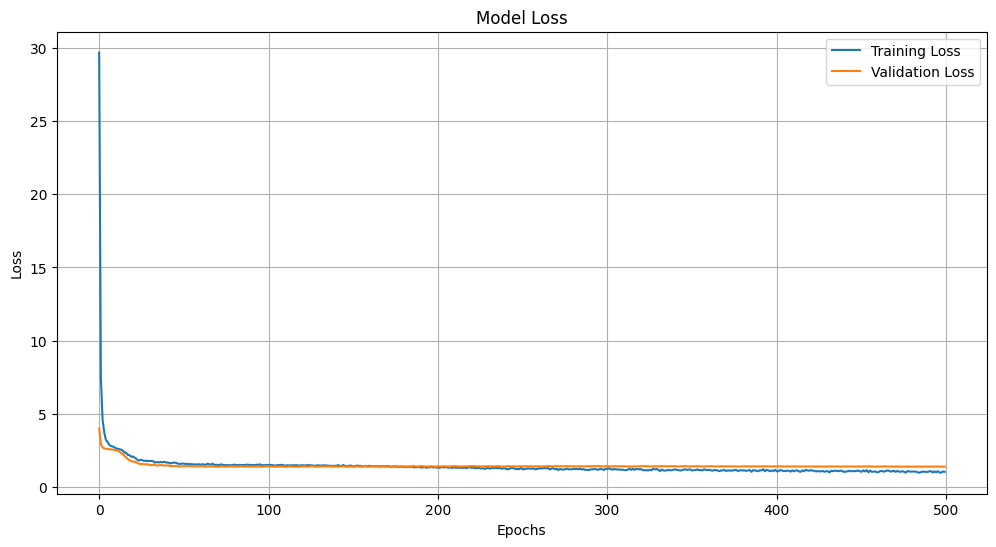

Epoch 1/500


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - loss: 485.7494 - val_loss: 218.7594
Epoch 2/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 236.9422 - val_loss: 208.3926
Epoch 3/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 206.8840 - val_loss: 197.2446
Epoch 4/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 193.4524 - val_loss: 181.7472
Epoch 5/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 177.1939 - val_loss: 162.3038
Epoch 6/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 161.3631 - val_loss: 152.4214
Epoch 7/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 152.0417 - val_loss: 148.6643
Epoch 8/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 145.8873 - val_loss: 143.5349
Epoch 9/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 144.6100 - val_loss: 137.9398
Epoch 10/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 145.0877 - val_loss: 139.6092
Epoch 11/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 137.7576 - val_loss: 140.1904
Epoch 12/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 2

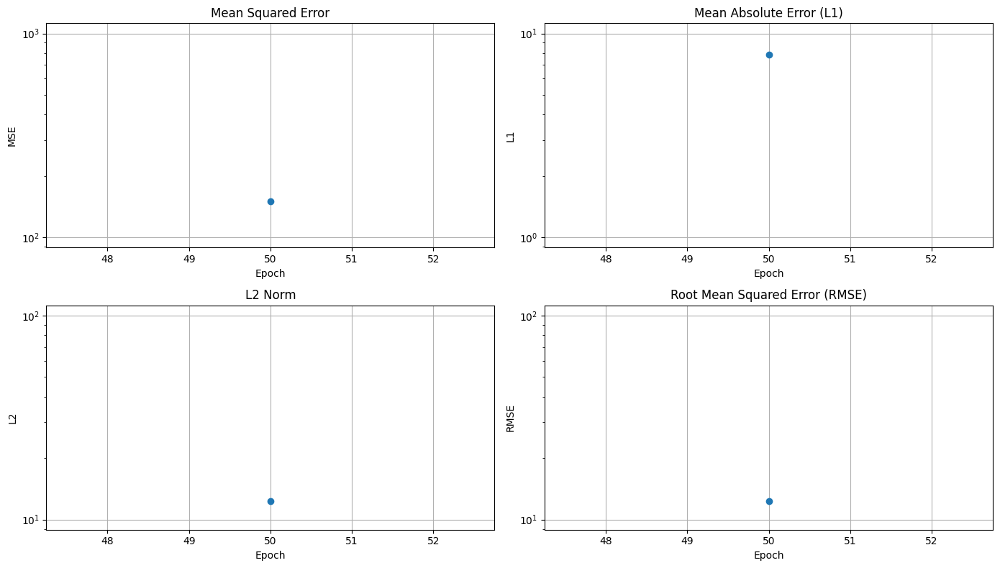

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 547ms/step - loss: 112.4611 - val_loss: 150.5506
Epoch 51/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 105.6889 - val_loss: 148.0769
Epoch 52/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 111.5367 - val_loss: 148.8397
Epoch 53/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 105.7000 - val_loss: 151.5685
Epoch 54/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 107.7303 - val_loss: 152.2934
Epoch 55/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 109.6720 - val_loss: 150.0079
Epoch 56/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 109.6330 - val_loss: 149.4172
Epoch 57/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 107.2636 - val_loss: 153.2709
Epoch 58/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 106.9720 - val_loss: 153.9703
Epoch 59/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 104.6066 - val_loss: 154.9041
Epoch 60/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 106.5558 - val_loss: 157.8724
Epoch 61/500
6/6 ━━━━━━━━━━━━━━━━

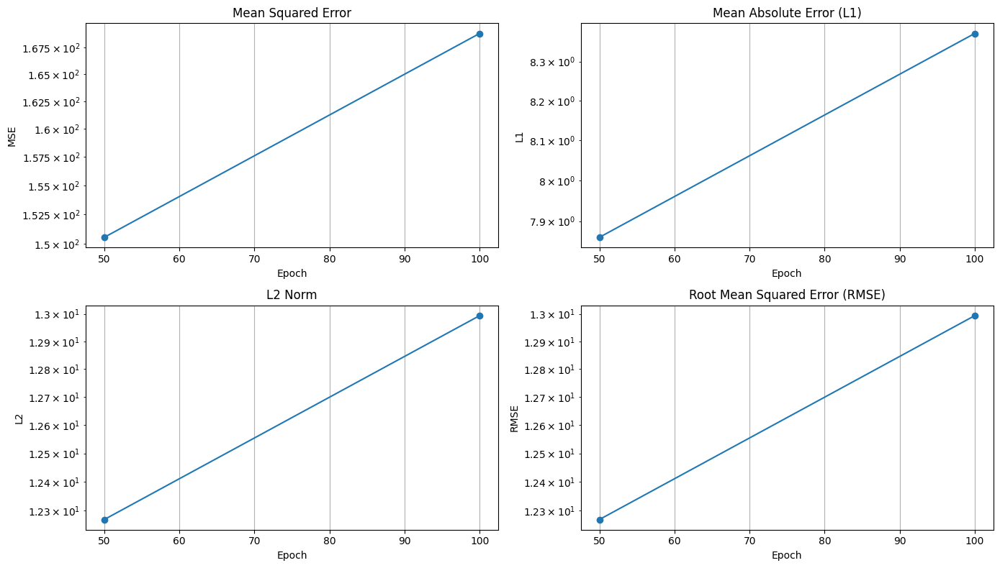

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 490ms/step - loss: 78.2418 - val_loss: 168.8339
Epoch 101/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 79.5835 - val_loss: 172.0020
Epoch 102/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 79.8913 - val_loss: 171.1660
Epoch 103/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 81.4330 - val_loss: 169.3357
Epoch 104/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 78.6747 - val_loss: 167.4235
Epoch 105/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 81.9582 - val_loss: 168.1744
Epoch 106/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 78.1706 - val_loss: 170.3034
Epoch 107/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 78.1602 - val_loss: 169.3826
Epoch 108/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 79.4996 - val_loss: 166.6775
Epoch 109/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 76.7212 - val_loss: 166.8641
Epoch 110/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 74.1313 - val_loss: 170.3299
Epoch 111/500
6/6 ━━━━━━━━━━━━━━━━

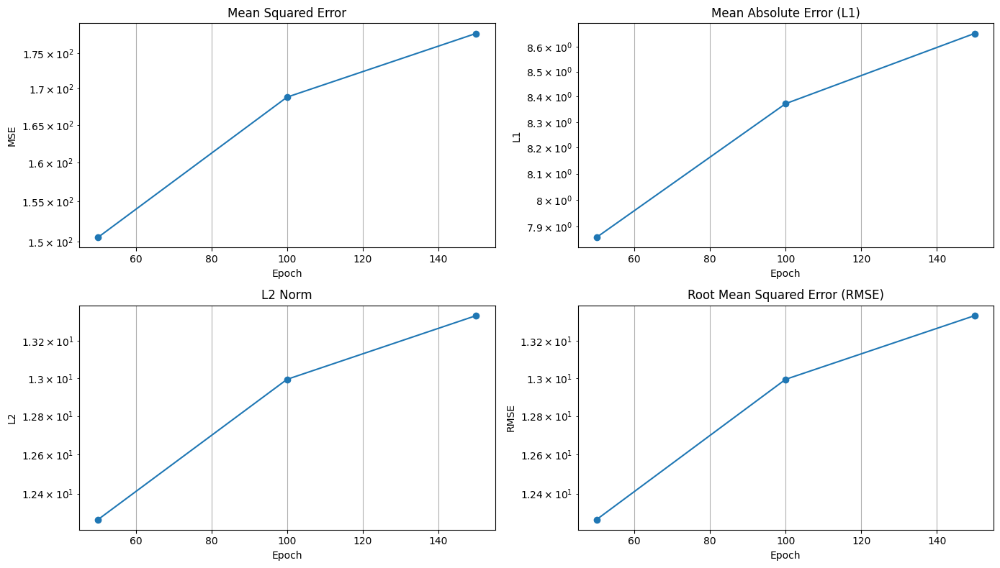

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 537ms/step - loss: 62.4084 - val_loss: 177.8564
Epoch 151/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - loss: 66.7086 - val_loss: 177.7191
Epoch 152/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 66.2066 - val_loss: 175.6627
Epoch 153/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 65.9792 - val_loss: 172.7717
Epoch 154/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 59.4919 - val_loss: 173.3980
Epoch 155/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 58.7107 - val_loss: 173.9441
Epoch 156/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 64.5718 - val_loss: 174.3191
Epoch 157/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 65.3276 - val_loss: 174.8217
Epoch 158/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 59.6834 - val_loss: 175.1691
Epoch 159/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 59.5583 - val_loss: 176.7721
Epoch 160/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 55.9870 - val_loss: 178.0519
Epoch 161/500
6/6 ━━━━━━━━━━━━━━━━

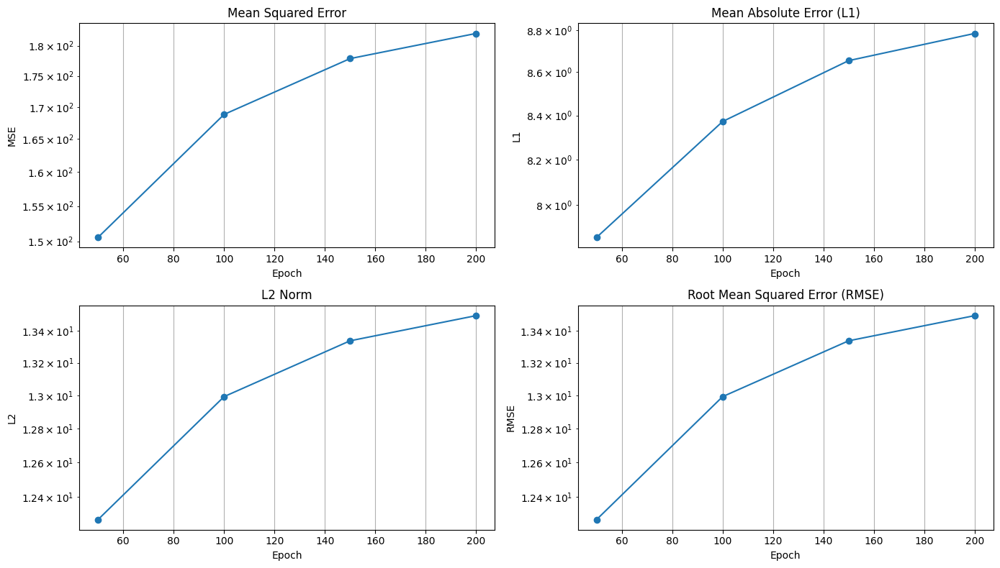

6/6 ━━━━━━━━━━━━━━━━━━━━ 24s 5s/step - loss: 53.8903 - val_loss: 182.0785
Epoch 201/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 18s 28ms/step - loss: 64.3142 - val_loss: 184.0033
Epoch 202/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 51.5700 - val_loss: 183.6895
Epoch 203/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 62.7284 - val_loss: 181.3419
Epoch 204/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 51.1738 - val_loss: 178.2009
Epoch 205/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 54.0020 - val_loss: 179.4624
Epoch 206/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 53.3684 - val_loss: 182.9008
Epoch 207/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 54.7501 - val_loss: 183.5790
Epoch 208/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 49.8628 - val_loss: 183.4113
Epoch 209/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 58.9030 - val_loss: 183.0316
Epoch 210/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 55.8973 - val_loss: 182.0058
Epoch 211/500
6/6 ━━━━━━━━━━━━━━━━━

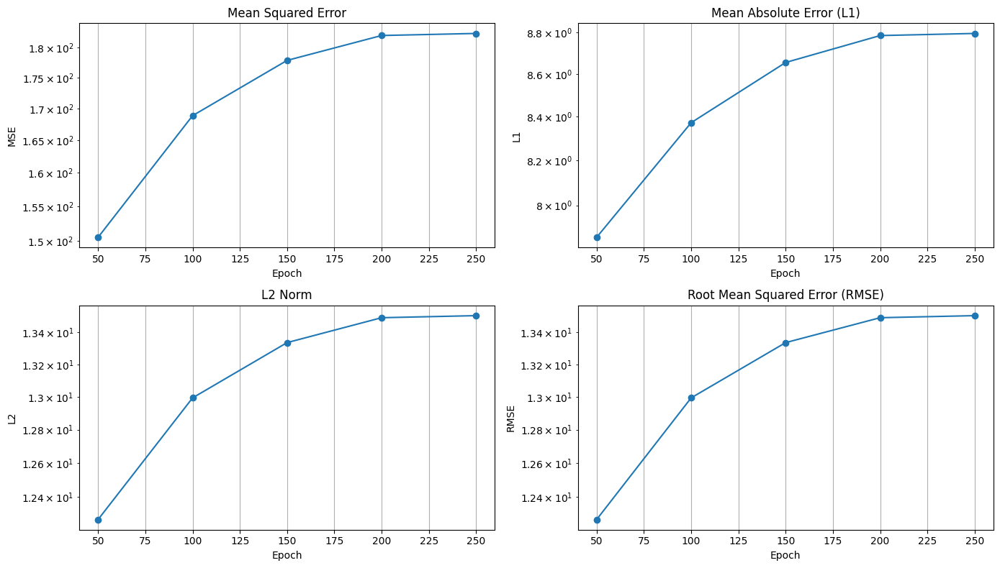

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 543ms/step - loss: 52.7538 - val_loss: 182.4334
Epoch 251/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 25ms/step - loss: 57.4412 - val_loss: 182.3966
Epoch 252/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 46.9581 - val_loss: 183.0018
Epoch 253/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 49.5802 - val_loss: 184.4380
Epoch 254/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 55.3185 - val_loss: 183.6969
Epoch 255/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 52.2035 - val_loss: 182.1591
Epoch 256/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 45.7017 - val_loss: 183.1584
Epoch 257/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 51.6010 - val_loss: 183.6531
Epoch 258/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 50.9841 - val_loss: 183.8884
Epoch 259/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 57.2544 - val_loss: 184.7343
Epoch 260/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 51.5222 - val_loss: 186.8394
Epoch 261/500
6/6 ━━━━━━━━━━━━━━━━

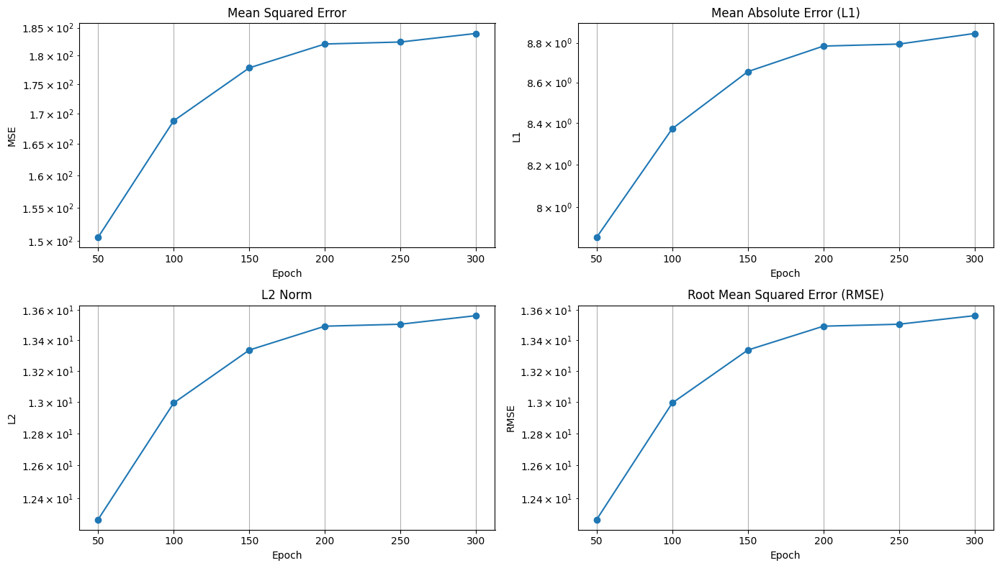

6/6 ━━━━━━━━━━━━━━━━━━━━ 4s 805ms/step - loss: 56.1842 - val_loss: 183.9788
Epoch 301/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - loss: 52.4418 - val_loss: 182.4450
Epoch 302/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - loss: 54.5529 - val_loss: 182.8216
Epoch 303/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 48.8051 - val_loss: 183.4820
Epoch 304/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - loss: 52.9132 - val_loss: 184.2096
Epoch 305/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 70ms/step - loss: 50.4778 - val_loss: 184.1492
Epoch 306/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 85ms/step - loss: 46.2345 - val_loss: 185.1657
Epoch 307/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 78ms/step - loss: 51.3143 - val_loss: 185.2728
Epoch 308/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 58ms/step - loss: 55.3456 - val_loss: 187.5851
Epoch 309/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - loss: 47.0792 - val_loss: 187.3693
Epoch 310/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 66ms/step - loss: 55.6181 - val_loss: 186.2901
Epoch 311/500
6/6 ━━━━━━━━━━━━━━━━

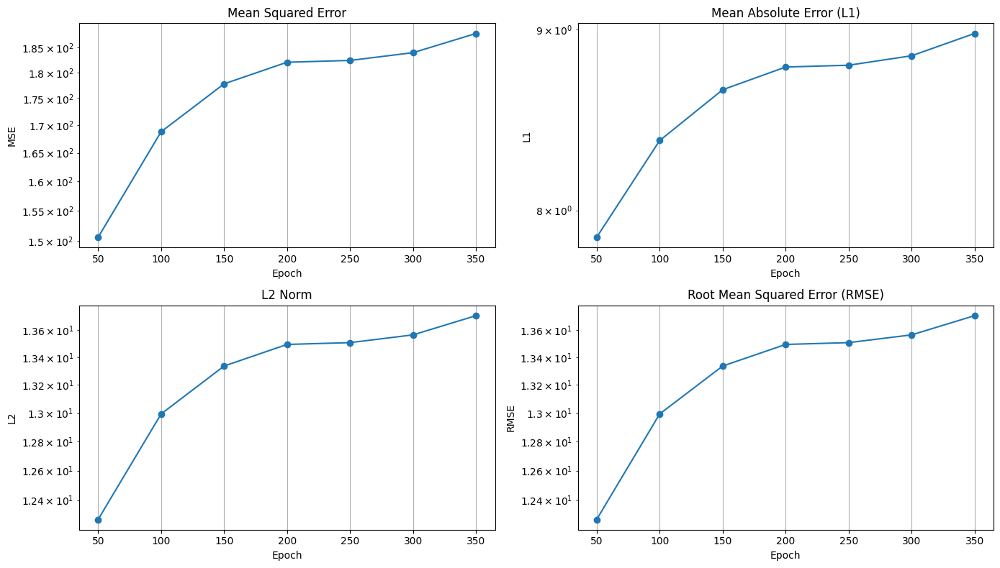

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 478ms/step - loss: 48.5525 - val_loss: 187.8609
Epoch 351/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 53.6911 - val_loss: 187.3883
Epoch 352/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 53.0870 - val_loss: 186.4560
Epoch 353/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 51.2556 - val_loss: 186.7899
Epoch 354/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 51.5141 - val_loss: 186.9143
Epoch 355/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 46.4325 - val_loss: 187.5081
Epoch 356/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 45.8928 - val_loss: 186.3018
Epoch 357/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 51.1219 - val_loss: 185.5064
Epoch 358/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 48.5831 - val_loss: 186.2254
Epoch 359/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 49.3658 - val_loss: 185.8127
Epoch 360/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 53.4476 - val_loss: 183.4864
Epoch 361/500
6/6 ━━━━━━━━━━━━━━━━

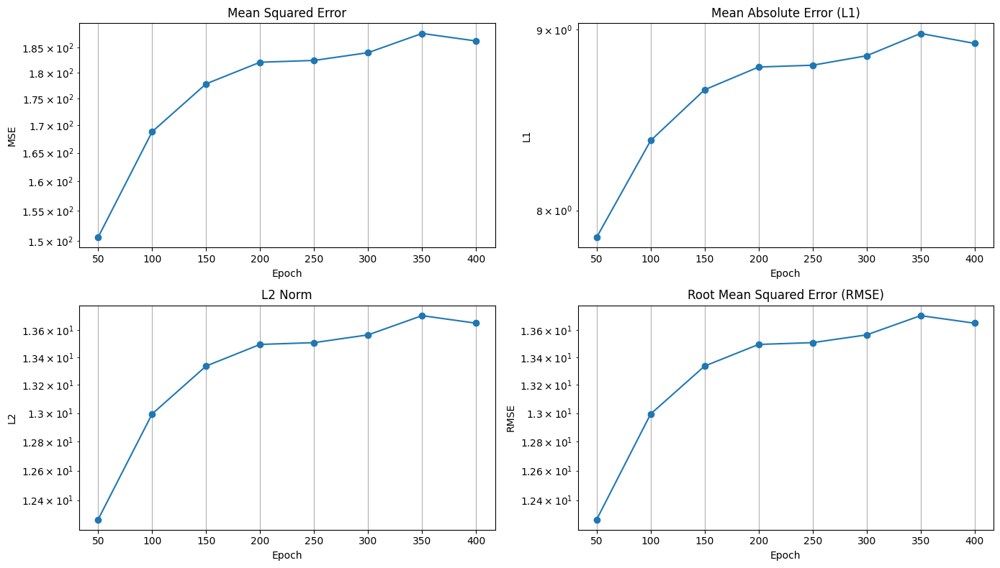

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 487ms/step - loss: 49.4076 - val_loss: 186.3289
Epoch 401/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 46.7283 - val_loss: 185.8625
Epoch 402/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 44.4464 - val_loss: 185.9300
Epoch 403/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 43.1668 - val_loss: 187.3479
Epoch 404/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 49.2913 - val_loss: 187.5495
Epoch 405/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 44.4996 - val_loss: 186.5022
Epoch 406/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 44.9901 - val_loss: 186.7309
Epoch 407/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 46.4582 - val_loss: 187.4357
Epoch 408/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 43.0591 - val_loss: 187.1067
Epoch 409/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 45.1736 - val_loss: 186.8092
Epoch 410/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 41.2089 - val_loss: 186.2127
Epoch 411/500
6/6 ━━━━━━━━━━━━━━━━

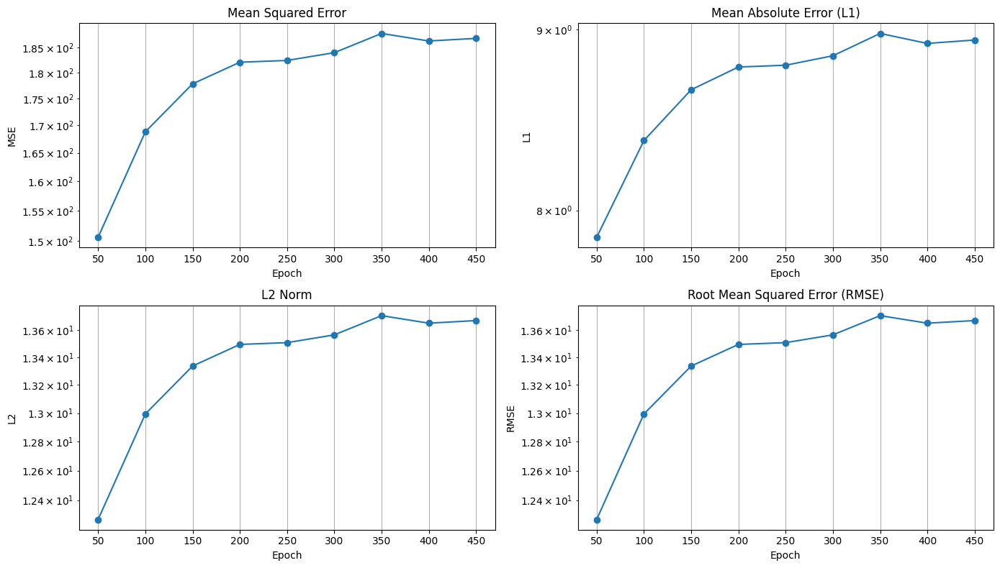

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 489ms/step - loss: 45.8971 - val_loss: 186.8578
Epoch 451/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 50.9722 - val_loss: 185.9785
Epoch 452/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 41.6329 - val_loss: 186.0054
Epoch 453/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 45.7030 - val_loss: 186.0501
Epoch 454/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 48.8055 - val_loss: 185.7214
Epoch 455/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 48.9965 - val_loss: 185.4792
Epoch 456/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 45.7613 - val_loss: 186.2963
Epoch 457/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 32.8471 - val_loss: 188.3553
Epoch 458/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 45.1363 - val_loss: 188.0667
Epoch 459/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 40.9096 - val_loss: 185.7995
Epoch 460/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 42.4028 - val_loss: 184.6228
Epoch 461/500
6/6 ━━━━━━━━━━━━━━━━

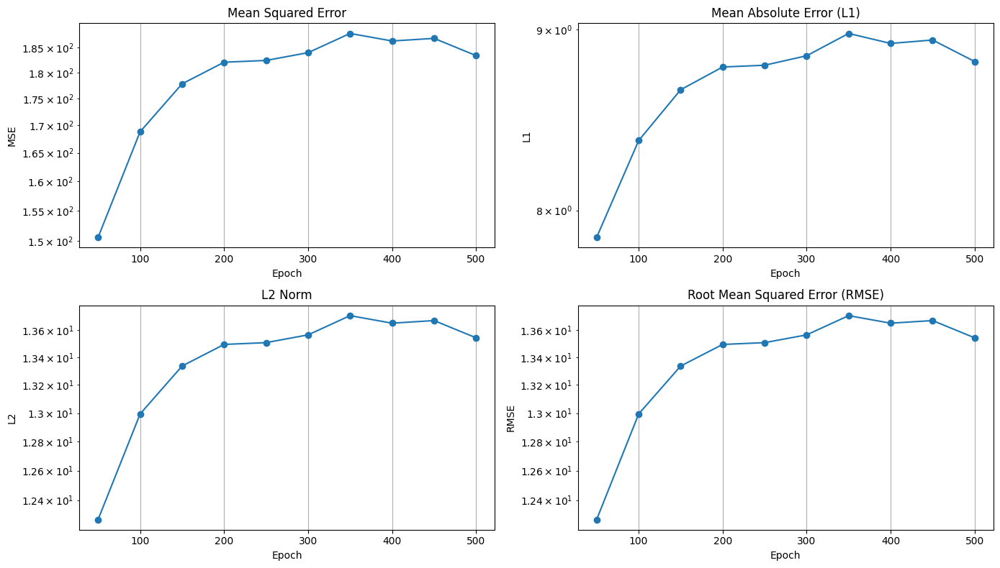

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 540ms/step - loss: 55.3769 - val_loss: 183.3954


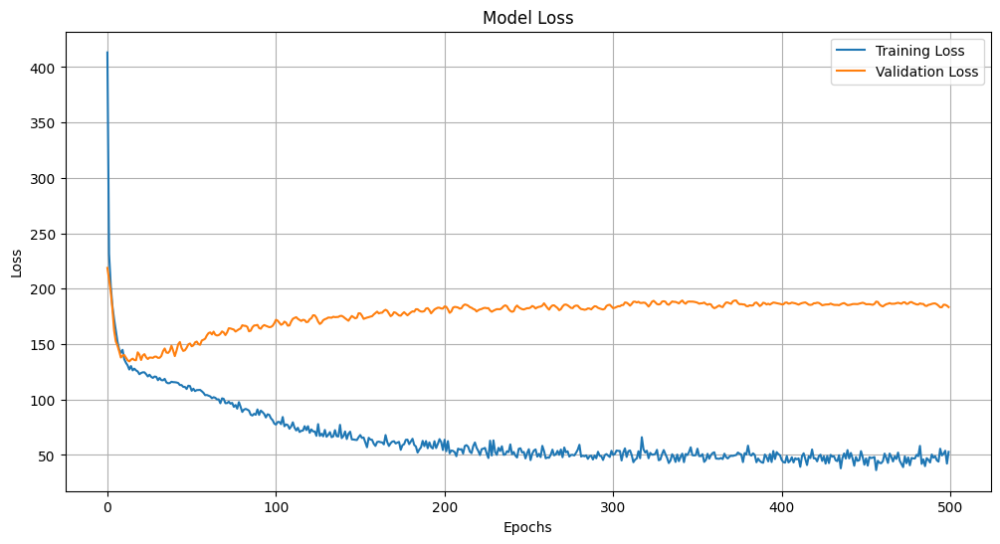


Final Metrics:
Metric     Value     
--------------------
Epoch      500       
MSE        0.0000    
L1         0.0004    
L2         0.0015    
RMSE       0.0015    
Training Time 151.34     seconds

Final Metrics:
Metric     Value     
--------------------
Epoch      500       
MSE        0.0000    
L1         0.0015    
L2         0.0048    
RMSE       0.0048    
Training Time 108.37     seconds

Final Metrics:
Metric     Value     
--------------------
Epoch      500       
MSE        0.0003    
L1         0.0097    
L2         0.0169    
RMSE       0.0169    
Training Time 133.59     seconds

Final Metrics:
Metric     Value     
--------------------
Epoch      500       
MSE        0.0129    
L1         0.0796    
L2         0.1138    
RMSE       0.1138    
Training Time 181.94     seconds

Final Metrics:
Metric     Value     
--------------------
Epoch      500       
MSE        0.0927    
L1         0.2224    
L2         0.3045    
RMSE       0.3045    
Training Time 141.41   

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_8 (Dense)                      │ (None, 256)                 │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_6 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 256)                 │          65,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_7 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_8 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_11 (Dense)                     │ (None, 257)                 │          33,153 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 789,509 (3.01 MB)

 Trainable params: 263,169 (1.00 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 526,340 (2.01 MB)

In [21]:
create_model1,final_epoch1, final_mse1, final_l11, final_l21, final_rmse1, training_time1,X_test1,y_test1=create_model(ruido1.shape[1], psds1.shape[1],ruido1,psds1)
create_model2,final_epoch2, final_mse2, final_l12, final_l22, final_rmse2, training_time2,X_test2,y_test2=create_model(ruido2.shape[1], psds2.shape[1],ruido2,psds2)
create_model3,final_epoch3, final_mse3, final_l13, final_l23, final_rmse3, training_time3,X_test3,y_test3=create_model(ruido3.shape[1], psds3.shape[1],ruido3,psds3)
create_model4,final_epoch4, final_mse4, final_l14, final_l24, final_rmse4, training_time4,X_test4,y_test4=create_model(ruido4.shape[1], psds4.shape[1],ruido4,psds4)
create_model5,final_epoch5, final_mse5, final_l15, final_l25, final_rmse5, training_time5,X_test5,y_test5=create_model(ruido5.shape[1], psds5.shape[1],ruido5,psds5)
create_model6,final_epoch6, final_mse6, final_l16, final_l26, final_rmse6, training_time6,X_test6,y_test6=create_model(ruido6.shape[1], psds6.shape[1],ruido6,psds6)
create_model7,final_epoch7, final_mse7, final_l17, final_l27, final_rmse7, training_time7,X_test7,y_test7=create_model(ruido7.shape[1], psds7.shape[1],ruido7,psds7)
plotear_tablas(final_epoch1, final_mse1, final_l11, final_l21, final_rmse1, training_time1)
plotear_tablas(final_epoch2, final_mse2, final_l12, final_l22, final_rmse2, training_time2)
plotear_tablas(final_epoch3, final_mse3, final_l13, final_l23, final_rmse3, training_time3)
plotear_tablas(final_epoch4, final_mse4, final_l14, final_l24, final_rmse4, training_time4)
plotear_tablas(final_epoch5, final_mse5, final_l15, final_l25, final_rmse5, training_time5)
plotear_tablas(final_epoch6, final_mse6, final_l16, final_l26, final_rmse6, training_time6)
plotear_tablas(final_epoch7, final_mse7, final_l17, final_l27, final_rmse7, training_time7)
create_model1.summary()

In [22]:
signalprueba=gensenales(512, 1, 3, 5, 1,1/3 ,1/5, 3, 2*np.pi)
signalprueba = np.reshape(signalprueba, (1, -1))  # Redimensionar a (1, 1024)


In [23]:
psd_preds0 =create_model1.predict(signalprueba)
psd_preds1=create_model1.predict(signalprueba)
psd_preds2=create_model1.predict(signalprueba)
psd_preds3=create_model1.predict(signalprueba)
psd_preds4=create_model1.predict(signalprueba)
psd_preds5=create_model1.predict(signalprueba)
psd_preds6=create_model1.predict(signalprueba)
psd_preds7=create_model1.predict(signalprueba)
frec,calculados= calcular_welch_arreglo(signalprueba,fs)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


/usr/local/lib/python3.10/dist-packages/scipy/signal/_spectral_py.py:600: UserWarning: nperseg = 1024 is greater than input length  = 512, using nperseg = 512
  freqs, _, Pxy = _spectral_helper(x, y, fs, window, nperseg, noverlap,


<ipython-input-18-ede1d38d7f01>:14: UserWarning: All values for SymLogScale are below linthresh, making it effectively linear. You likely should lower the value of linthresh. 
  plt.yscale('symlog')


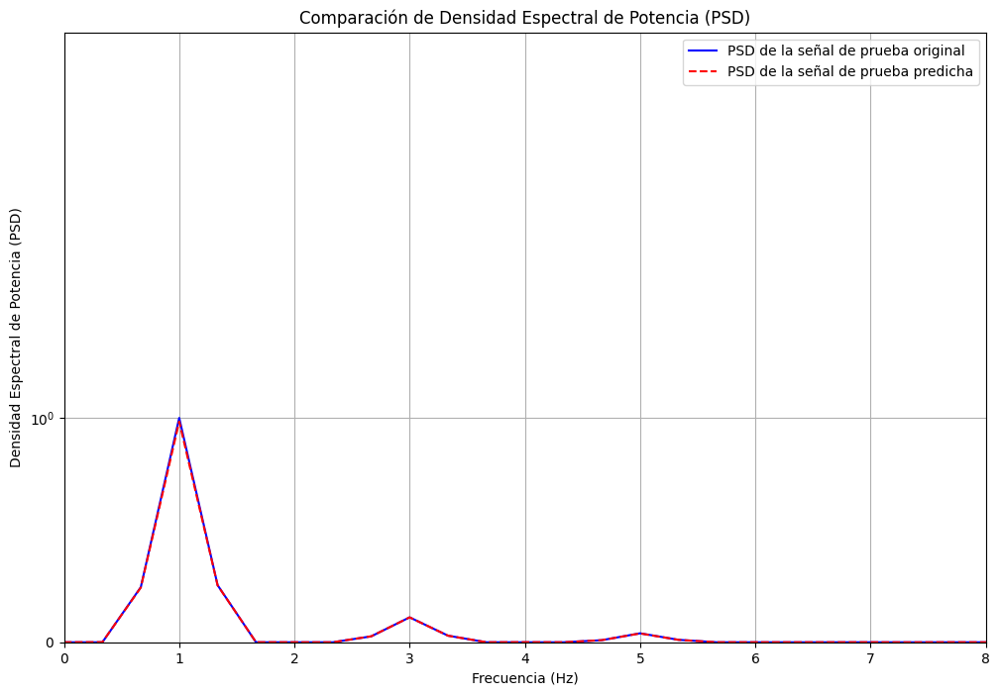

Distancia Euclidiana entre los PSDs: 0.0172


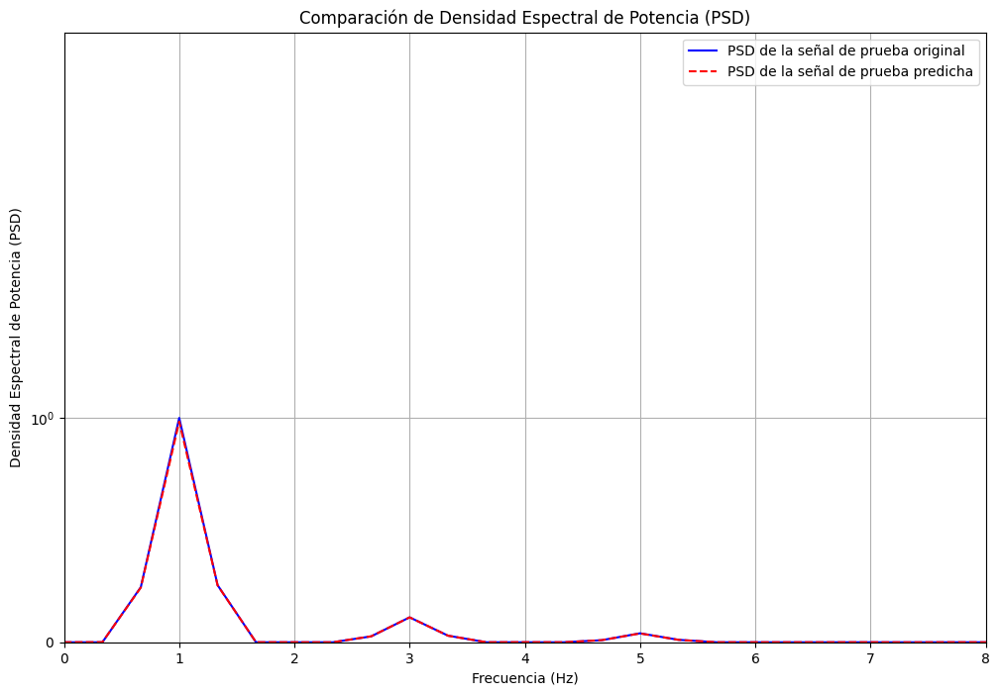

Distancia Euclidiana entre los PSDs: 0.0172


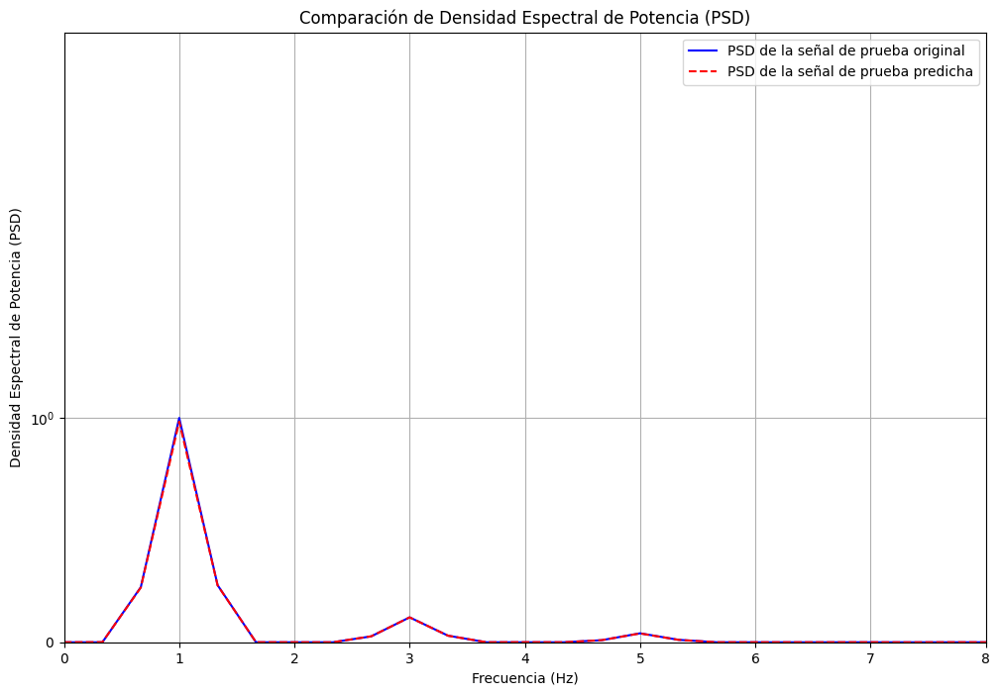

Distancia Euclidiana entre los PSDs: 0.0172


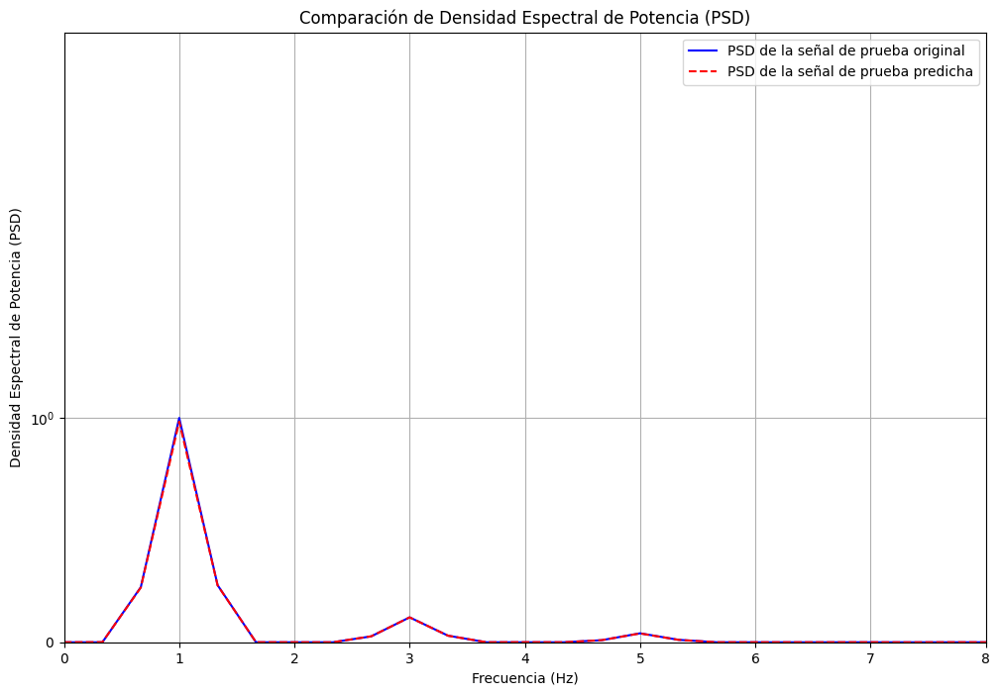

Distancia Euclidiana entre los PSDs: 0.0172


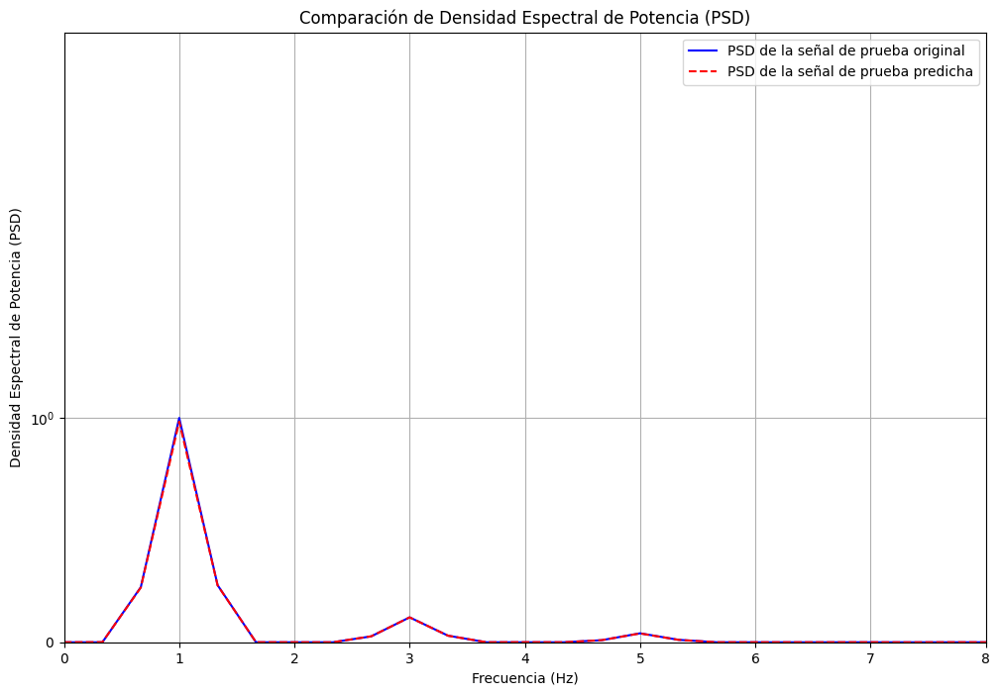

Distancia Euclidiana entre los PSDs: 0.0172


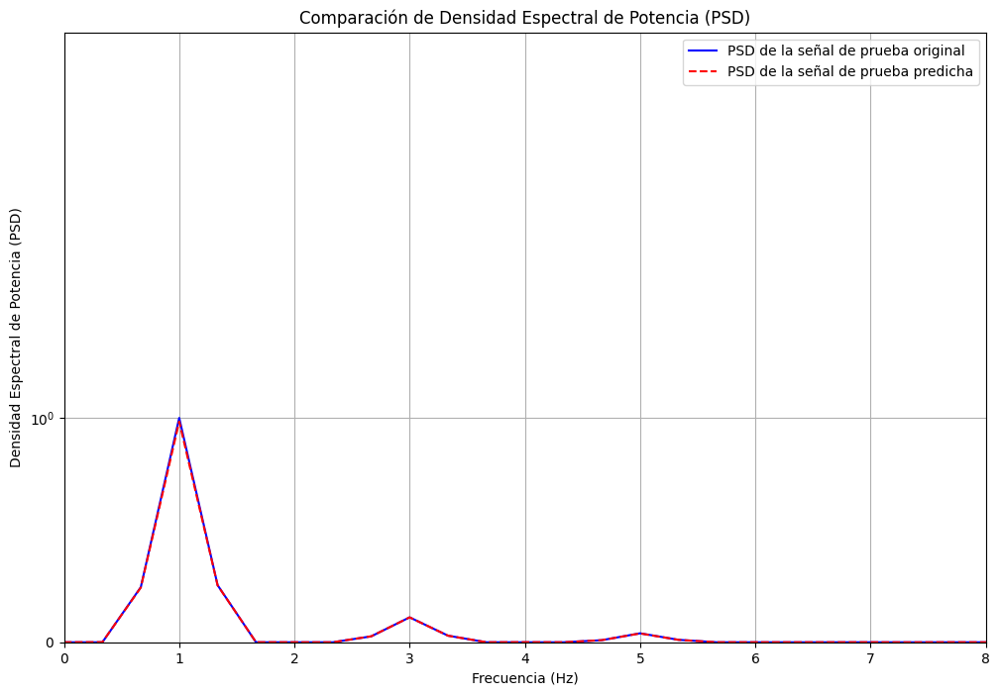

Distancia Euclidiana entre los PSDs: 0.0172


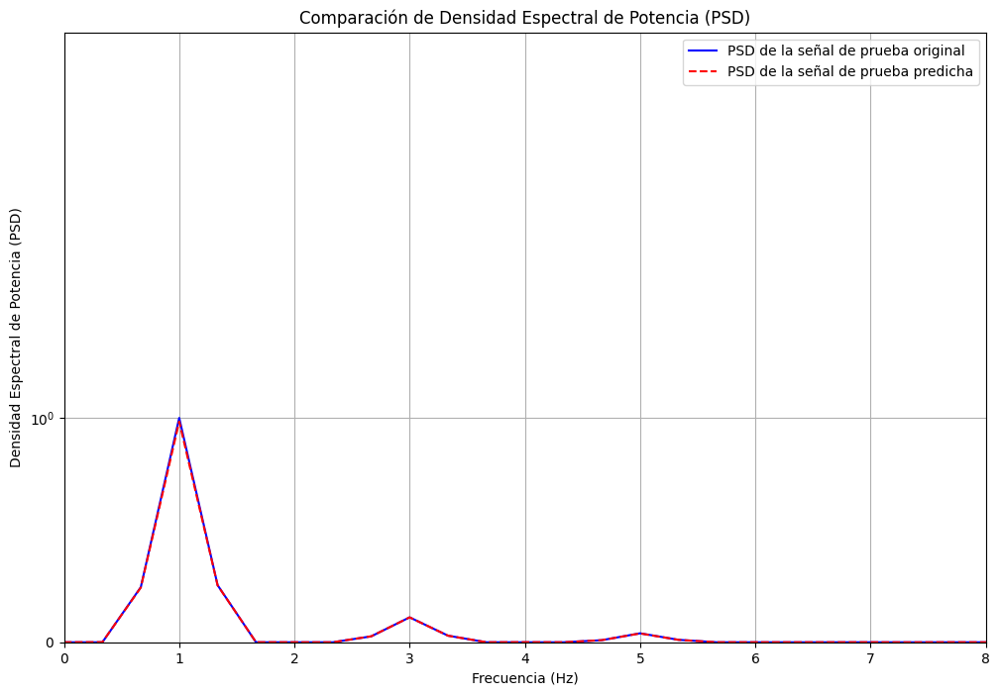

Distancia Euclidiana entre los PSDs: 0.0172


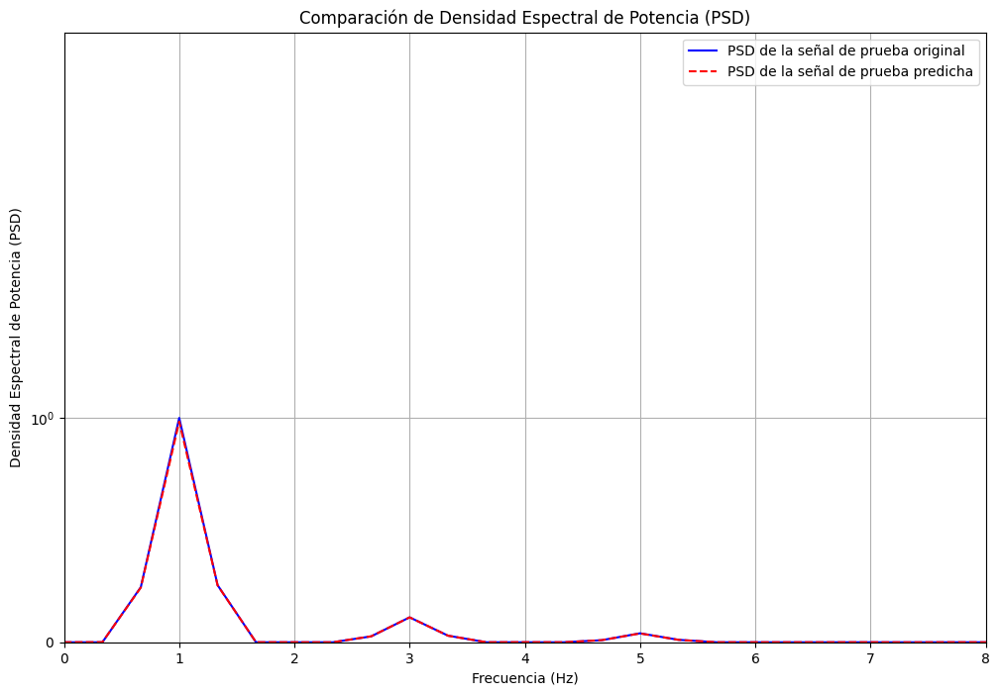

Distancia Euclidiana entre los PSDs: 0.0172


In [24]:
plotear_comparacion(psd_preds1,calculados,frec)
plotear_comparacion(psd_preds2,calculados,frec)
plotear_comparacion(psd_preds3,calculados,frec)
plotear_comparacion(psd_preds1,calculados,frec)
plotear_comparacion(psd_preds4,calculados,frec)
plotear_comparacion(psd_preds5,calculados,frec)
plotear_comparacion(psd_preds6,calculados,frec)
plotear_comparacion(psd_preds7,calculados,frec)

In [31]:

psd_preds11=create_model1.predict(X_test1)
psd_preds21=create_model1.predict(X_test2)
psd_preds31=create_model1.predict(X_test3)
psd_preds41=create_model1.predict(X_test4)
psd_preds51=create_model1.predict(X_test5)
psd_preds61=create_model1.predict(X_test6)
psd_preds71=create_model1.predict(X_test7)



2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


In [53]:
signalt1 = gensenales(2**4, f1, f2, f3, am1, am2, am3, Time, wo)
signalt2 = gensenales(2**6, f1, f2, f3, am1, am2, am3, Time, wo)
signalt3 = gensenales(2**8, f1, f2, f3, am1, am2, am3, Time, wo)
signalt4 = gensenales(2**10, f1, f2, f3, am1, am2, am3, Time, wo)
signalt5 = gensenales(2**12, f1, f2, f3, am1, am2, am3, Time, wo)
ruidot1 = noise_gaussian(512, 1, num_repeats,signal)
ruidot2 = noise_gaussian(512, 1, num_repeats,signal)
ruidot3 = noise_gaussian(512, 1, num_repeats,signal)
ruidot4 = noise_gaussian(512, 1, num_repeats,signal)
ruidot5 = noise_gaussian(512, 1, num_repeats,signal)

In [54]:
freqst1, psdst1 =calcular_welch_arreglo(ruidot1, fs)
freqst2, psdst2 =calcular_welch_arreglo(ruidot2, fs)
freqst3, psdst3 =calcular_welch_arreglo(ruidot3, fs)
freqst4, psdst4 =calcular_welch_arreglo(ruidot4, fs)
freqst5, psdst5 =calcular_welch_arreglo(ruidot5, fs)

/usr/local/lib/python3.10/dist-packages/scipy/signal/_spectral_py.py:600: UserWarning: nperseg = 1024 is greater than input length  = 512, using nperseg = 512
  freqs, _, Pxy = _spectral_helper(x, y, fs, window, nperseg, noverlap,


Epoch 1/500


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 41ms/step - loss: 0.4327 - val_loss: 0.0155
Epoch 2/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0496 - val_loss: 0.0074
Epoch 3/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0194 - val_loss: 0.0058
Epoch 4/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0120 - val_loss: 0.0053
Epoch 5/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0089 - val_loss: 0.0051
Epoch 6/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0071 - val_loss: 0.0050
Epoch 7/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0059 - val_loss: 0.0049
Epoch 8/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0056 - val_loss: 0.0048
Epoch 9/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0058 - val_loss: 0.0047
Epoch 10/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0053 - val_loss: 0.0046
Epoch 11/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0049 - val_loss: 0.0045
Epoch 12/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0050 - val_loss: 0.0044
E

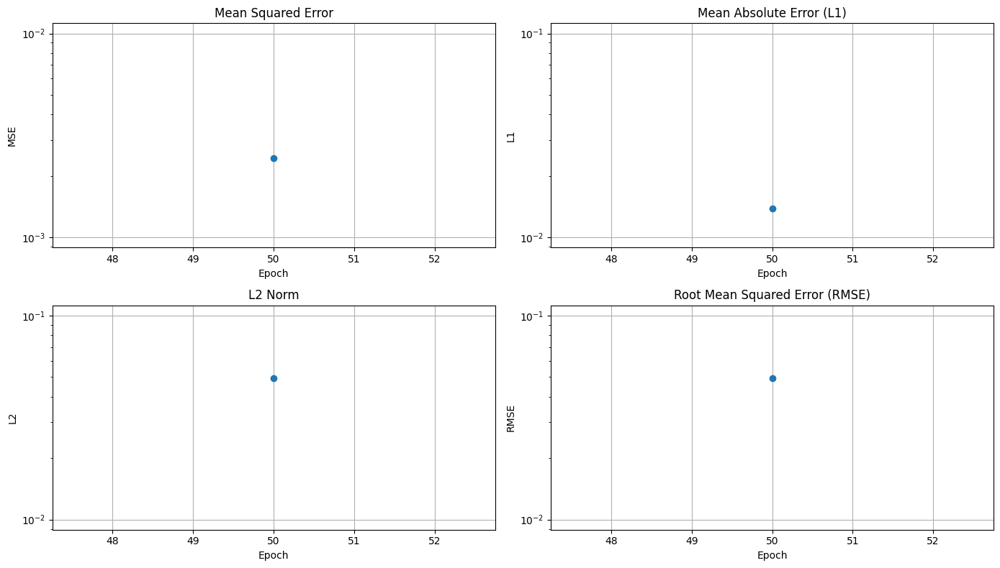

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 375ms/step - loss: 0.0024 - val_loss: 0.0024
Epoch 51/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0024 - val_loss: 0.0024
Epoch 52/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0025 - val_loss: 0.0023
Epoch 53/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0023 - val_loss: 0.0022
Epoch 54/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0023 - val_loss: 0.0021
Epoch 55/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0022 - val_loss: 0.0020
Epoch 56/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0020 - val_loss: 0.0019
Epoch 57/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0019 - val_loss: 0.0018
Epoch 58/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0018 - val_loss: 0.0016
Epoch 59/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0018 - val_loss: 0.0015
Epoch 60/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0017 - val_loss: 0.0014
Epoch 61/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0017 - val_loss:

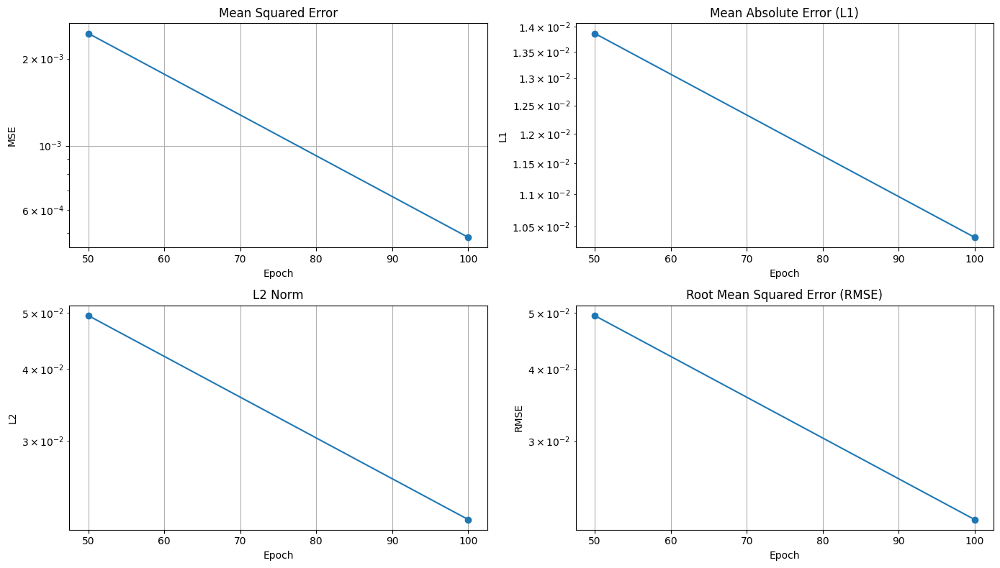

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 342ms/step - loss: 6.8019e-04 - val_loss: 4.8207e-04
Epoch 101/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 7.5737e-04 - val_loss: 4.8110e-04
Epoch 102/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 7.2536e-04 - val_loss: 4.7910e-04
Epoch 103/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 7.9891e-04 - val_loss: 4.6570e-04
Epoch 104/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 7.2990e-04 - val_loss: 4.6124e-04
Epoch 105/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 8.6081e-04 - val_loss: 4.6794e-04
Epoch 106/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 8.1625e-04 - val_loss: 4.8630e-04
Epoch 107/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 7.5007e-04 - val_loss: 4.8010e-04
Epoch 108/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 6.5494e-04 - val_loss: 4.6669e-04
Epoch 109/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 8.1730e-04 - val_loss: 4.5181e-04
Epoch 110/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 5.5741e-04 - 

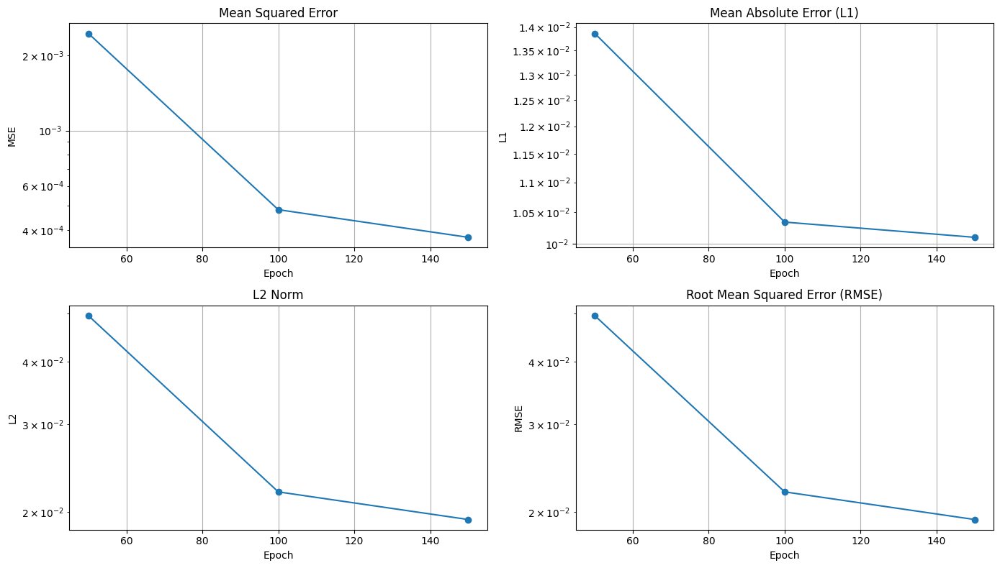

6/6 ━━━━━━━━━━━━━━━━━━━━ 5s 1s/step - loss: 6.5255e-04 - val_loss: 3.7370e-04
Epoch 151/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - loss: 5.6142e-04 - val_loss: 3.7415e-04
Epoch 152/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 6.8291e-04 - val_loss: 3.8115e-04
Epoch 153/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 7.4182e-04 - val_loss: 3.8440e-04
Epoch 154/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 4.6601e-04 - val_loss: 3.8687e-04
Epoch 155/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 6.2058e-04 - val_loss: 3.8153e-04
Epoch 156/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 4.5984e-04 - val_loss: 3.7184e-04
Epoch 157/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 4.1140e-04 - val_loss: 3.6271e-04
Epoch 158/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 4.1134e-04 - val_loss: 3.6736e-04
Epoch 159/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 5.1910e-04 - val_loss: 3.7520e-04
Epoch 160/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 5.4880e-04 - val

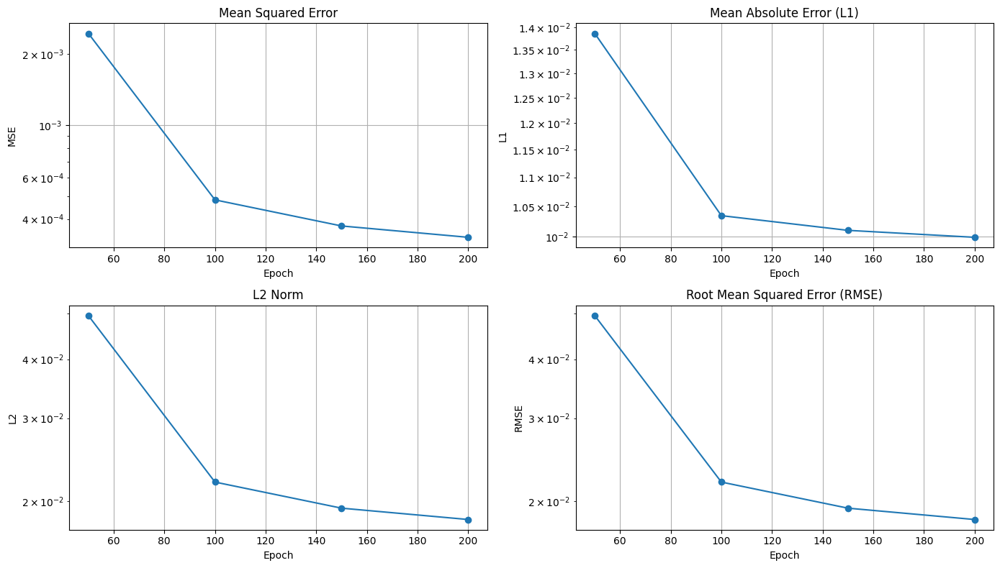

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 488ms/step - loss: 3.6806e-04 - val_loss: 3.3456e-04
Epoch 201/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 4.2238e-04 - val_loss: 3.3594e-04
Epoch 202/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 5.7341e-04 - val_loss: 3.3211e-04
Epoch 203/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 4.5103e-04 - val_loss: 3.2768e-04
Epoch 204/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 3.6583e-04 - val_loss: 3.2600e-04
Epoch 205/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 4.4587e-04 - val_loss: 3.2692e-04
Epoch 206/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 4.2199e-04 - val_loss: 3.2452e-04
Epoch 207/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 4.8195e-04 - val_loss: 3.2176e-04
Epoch 208/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 4.8308e-04 - val_loss: 3.1962e-04
Epoch 209/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 4.0249e-04 - val_loss: 3.1844e-04
Epoch 210/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 4.1549e-04 - 

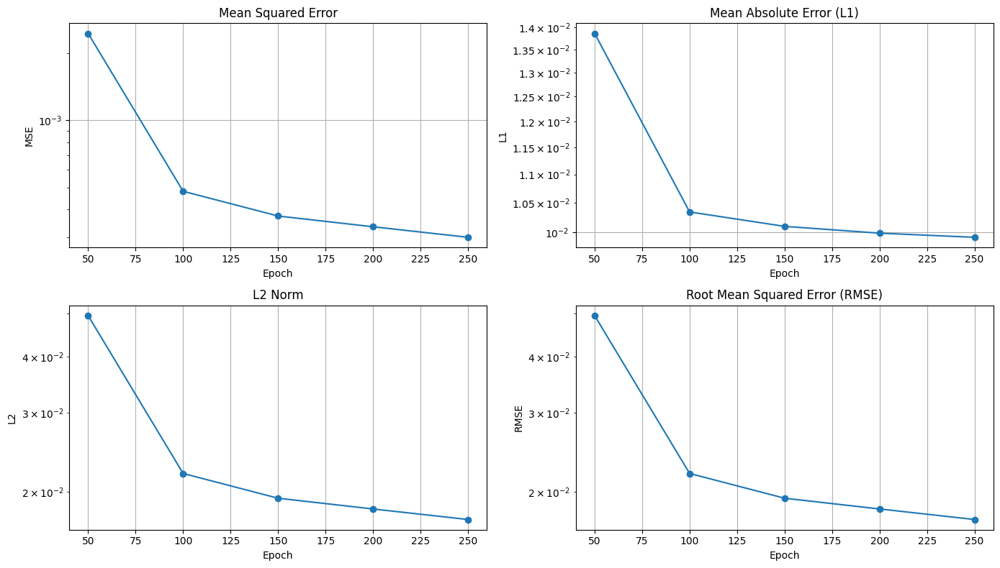

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 369ms/step - loss: 3.1422e-04 - val_loss: 3.0020e-04
Epoch 251/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 4.8822e-04 - val_loss: 2.9902e-04
Epoch 252/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 3.0097e-04 - val_loss: 2.9859e-04
Epoch 253/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 3.7114e-04 - val_loss: 2.9838e-04
Epoch 254/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 4.6046e-04 - val_loss: 2.9808e-04
Epoch 255/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 3.6659e-04 - val_loss: 2.9738e-04
Epoch 256/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 3.5264e-04 - val_loss: 2.9714e-04
Epoch 257/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 3.7736e-04 - val_loss: 2.9667e-04
Epoch 258/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 3.6298e-04 - val_loss: 2.9652e-04
Epoch 259/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 3.4033e-04 - val_loss: 2.9549e-04
Epoch 260/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 3.8659e-04 - 

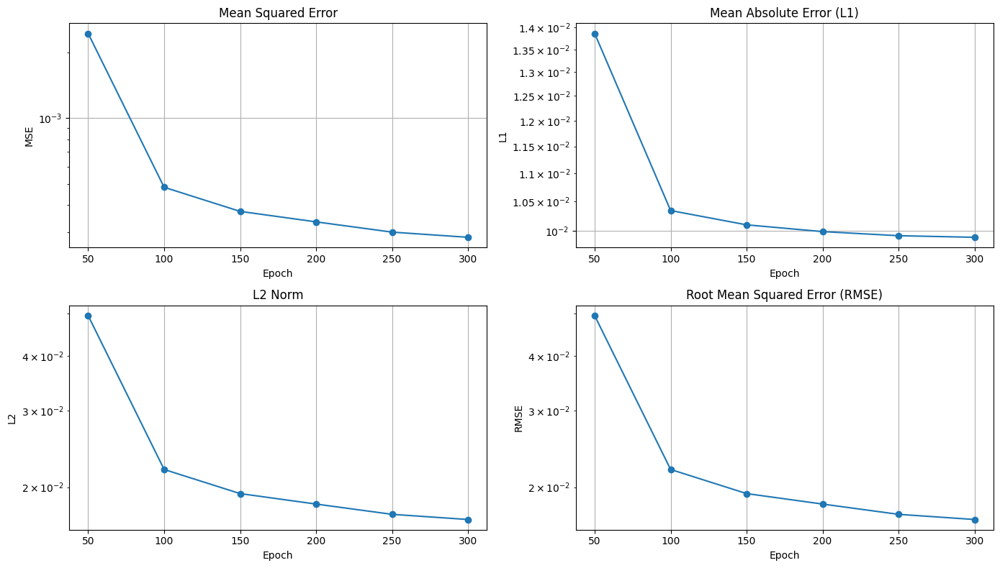

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 530ms/step - loss: 2.6364e-04 - val_loss: 2.8424e-04
Epoch 301/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 29ms/step - loss: 3.1641e-04 - val_loss: 2.8321e-04
Epoch 302/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 3.4782e-04 - val_loss: 2.8326e-04
Epoch 303/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 2.5948e-04 - val_loss: 2.8359e-04
Epoch 304/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 3.1092e-04 - val_loss: 2.8444e-04
Epoch 305/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 3.1297e-04 - val_loss: 2.8477e-04
Epoch 306/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 3.1361e-04 - val_loss: 2.8447e-04
Epoch 307/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 3.4911e-04 - val_loss: 2.8385e-04
Epoch 308/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 2.5763e-04 - val_loss: 2.8335e-04
Epoch 309/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 2.8735e-04 - val_loss: 2.8305e-04
Epoch 310/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 2.4942e-04 - 

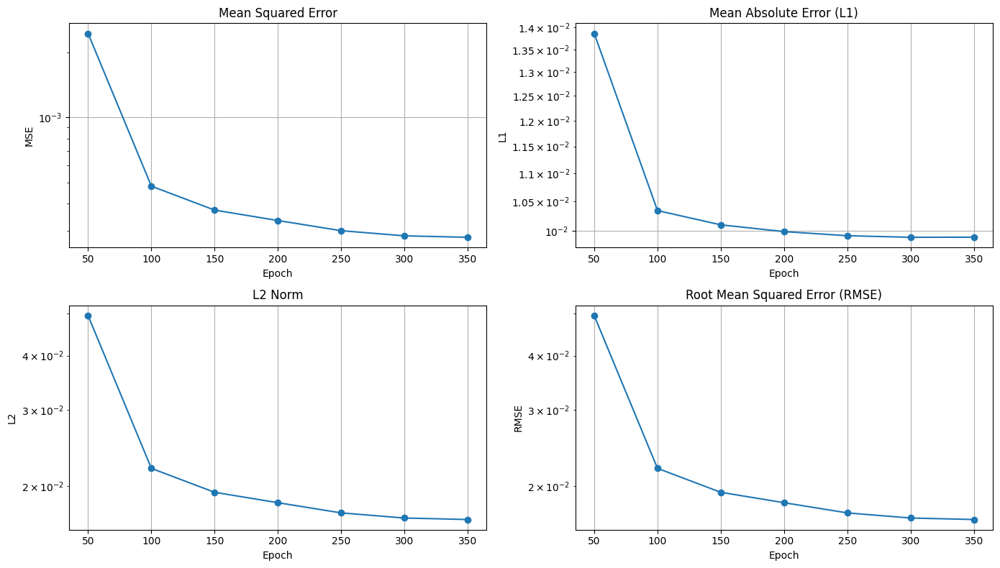

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 575ms/step - loss: 2.9195e-04 - val_loss: 2.7981e-04
Epoch 351/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - loss: 2.9342e-04 - val_loss: 2.7997e-04
Epoch 352/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2.6115e-04 - val_loss: 2.7997e-04
Epoch 353/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 2.5127e-04 - val_loss: 2.7984e-04
Epoch 354/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.3257e-04 - val_loss: 2.7965e-04
Epoch 355/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 3.3673e-04 - val_loss: 2.7959e-04
Epoch 356/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.5882e-04 - val_loss: 2.7953e-04
Epoch 357/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 3.0152e-04 - val_loss: 2.7988e-04
Epoch 358/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.5051e-04 - val_loss: 2.8006e-04
Epoch 359/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 2.3487e-04 - val_loss: 2.7995e-04
Epoch 360/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2.7838e-04 - 

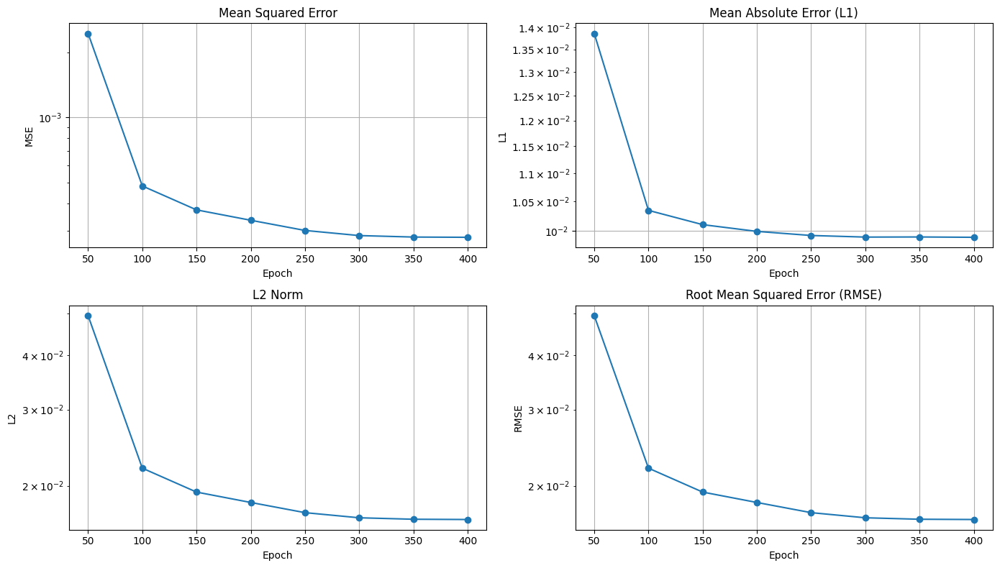

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 365ms/step - loss: 2.4721e-04 - val_loss: 2.7906e-04
Epoch 401/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - loss: 2.3417e-04 - val_loss: 2.7889e-04
Epoch 402/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 2.3291e-04 - val_loss: 2.7828e-04
Epoch 403/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.3267e-04 - val_loss: 2.7816e-04
Epoch 404/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.8123e-04 - val_loss: 2.7875e-04
Epoch 405/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 2.2127e-04 - val_loss: 2.7922e-04
Epoch 406/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 2.3106e-04 - val_loss: 2.7955e-04
Epoch 407/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 2.5549e-04 - val_loss: 2.7886e-04
Epoch 408/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.3230e-04 - val_loss: 2.7843e-04
Epoch 409/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.5693e-04 - val_loss: 2.7927e-04
Epoch 410/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 2.5260e-04 - 

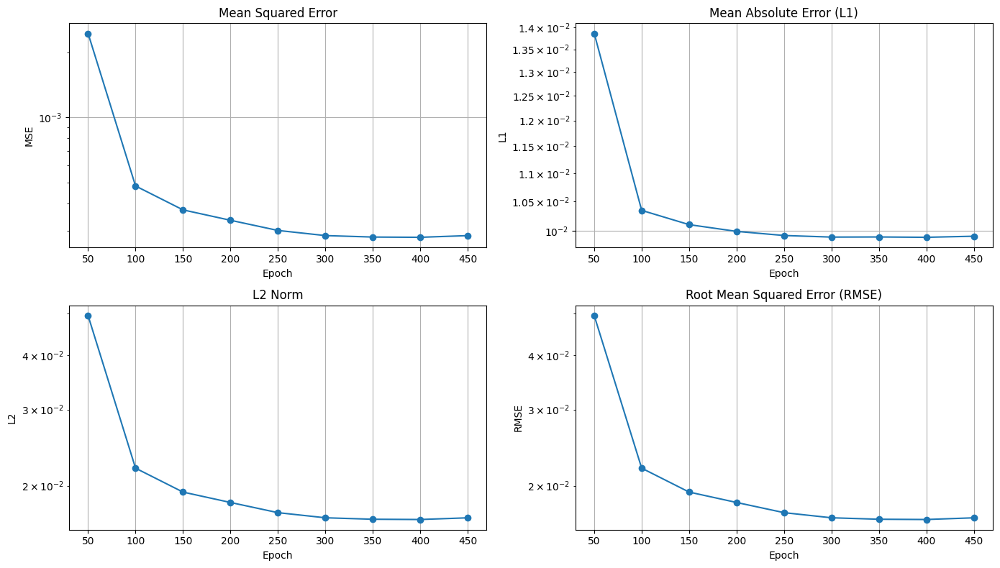

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 499ms/step - loss: 2.2211e-04 - val_loss: 2.8414e-04
Epoch 451/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.3817e-04 - val_loss: 2.8378e-04
Epoch 452/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 2.3762e-04 - val_loss: 2.8469e-04
Epoch 453/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 2.2375e-04 - val_loss: 2.8574e-04
Epoch 454/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 2.4157e-04 - val_loss: 2.8664e-04
Epoch 455/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2.4867e-04 - val_loss: 2.8721e-04
Epoch 456/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.6459e-04 - val_loss: 2.8739e-04
Epoch 457/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 2.4973e-04 - val_loss: 2.8669e-04
Epoch 458/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 2.3925e-04 - val_loss: 2.8729e-04
Epoch 459/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.5885e-04 - val_loss: 2.8797e-04
Epoch 460/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.3557e-04 - 

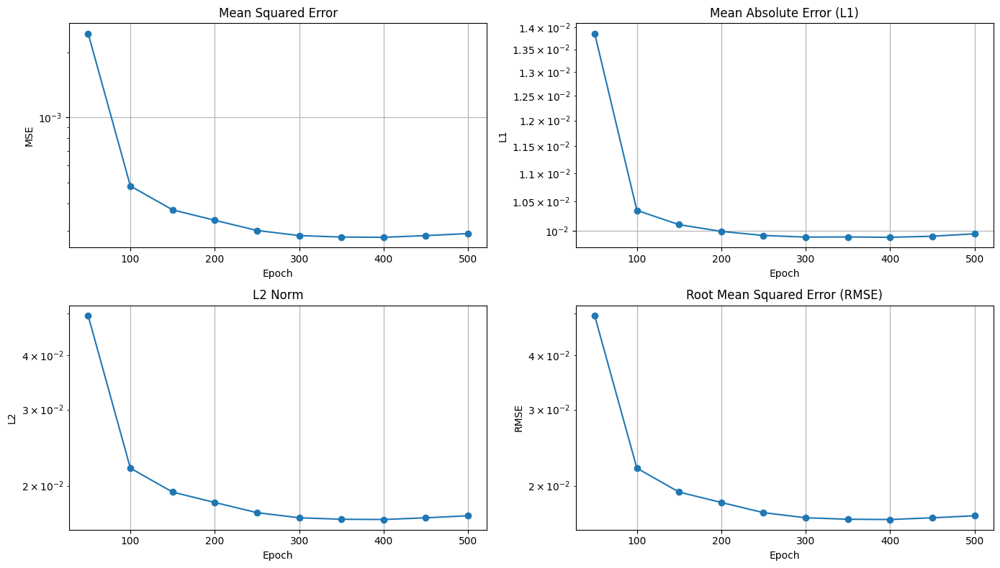

6/6 ━━━━━━━━━━━━━━━━━━━━ 4s 752ms/step - loss: 2.2518e-04 - val_loss: 2.9038e-04


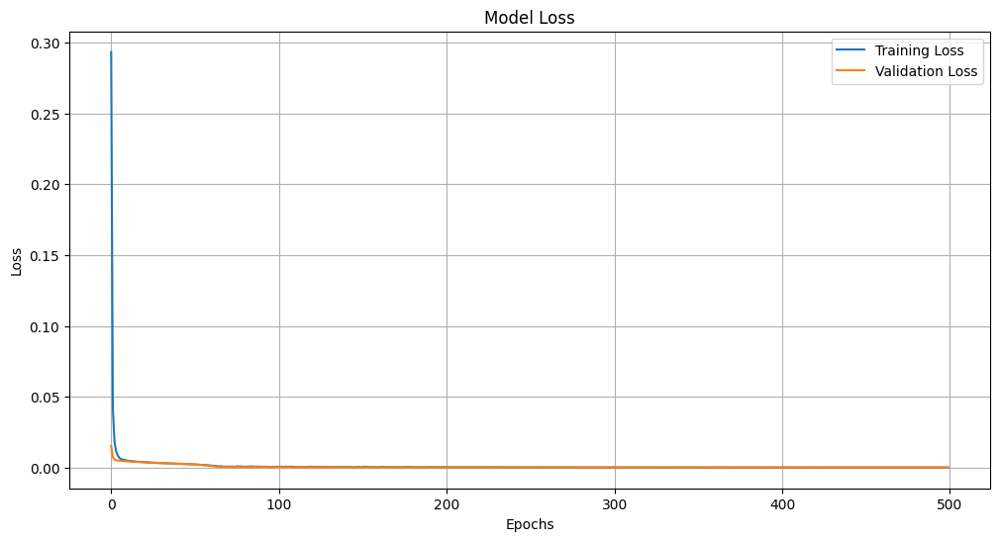

Epoch 1/500


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 70ms/step - loss: 0.5130 - val_loss: 0.0153
Epoch 2/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0430 - val_loss: 0.0073
Epoch 3/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 0.0189 - val_loss: 0.0053
Epoch 4/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - loss: 0.0100 - val_loss: 0.0047
Epoch 5/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0084 - val_loss: 0.0045
Epoch 6/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 0.0069 - val_loss: 0.0044
Epoch 7/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 0.0059 - val_loss: 0.0043
Epoch 8/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 0.0055 - val_loss: 0.0042
Epoch 9/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0054 - val_loss: 0.0042
Epoch 10/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 0.0050 - val_loss: 0.0041
Epoch 11/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0047 - val_loss: 0.0040
Epoch 12/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 0.0046 - val_loss: 0.0039
E

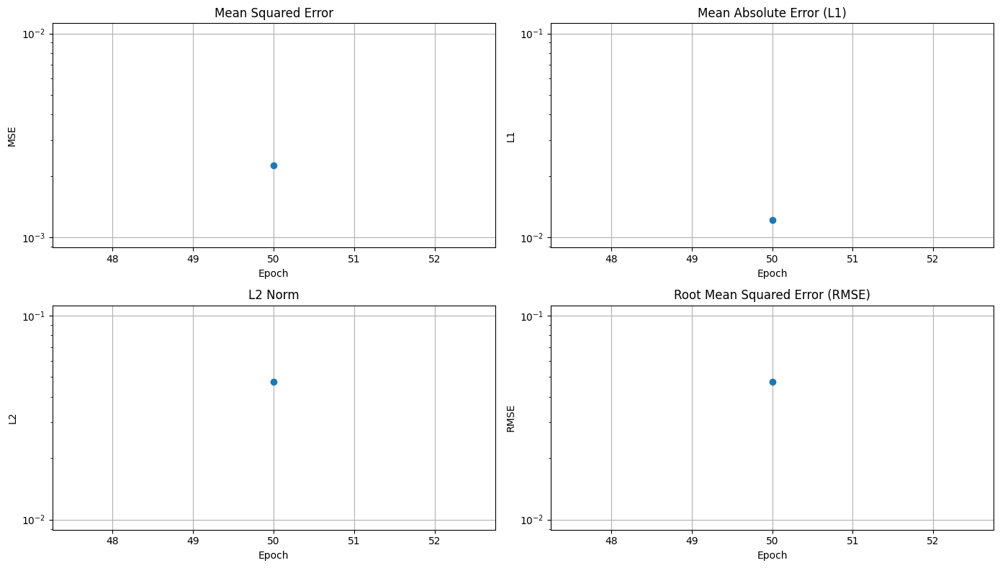

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 498ms/step - loss: 0.0024 - val_loss: 0.0022
Epoch 51/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - loss: 0.0024 - val_loss: 0.0022
Epoch 52/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - loss: 0.0024 - val_loss: 0.0022
Epoch 53/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 67ms/step - loss: 0.0024 - val_loss: 0.0022
Epoch 54/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0023 - val_loss: 0.0021
Epoch 55/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0023 - val_loss: 0.0021
Epoch 56/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 0.0024 - val_loss: 0.0021
Epoch 57/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 0.0022 - val_loss: 0.0020
Epoch 58/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 0.0023 - val_loss: 0.0020
Epoch 59/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 0.0022 - val_loss: 0.0020
Epoch 60/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 0.0020 - val_loss: 0.0020
Epoch 61/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0022 - val_loss:

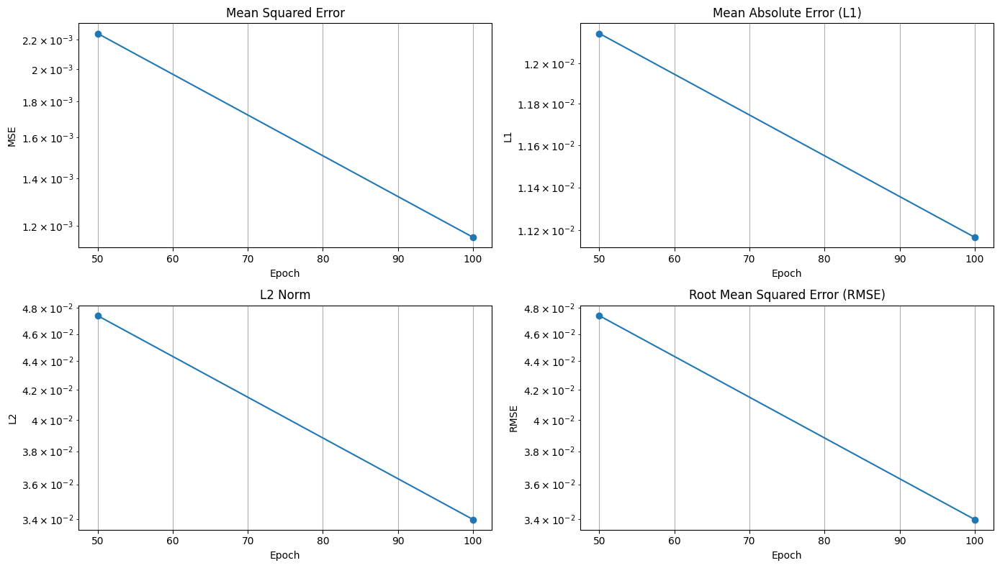

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 564ms/step - loss: 0.0013 - val_loss: 0.0012
Epoch 101/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 102/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0013 - val_loss: 0.0011
Epoch 103/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 104/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 105/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 106/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 107/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 108/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0011 - val_loss: 0.0010
Epoch 109/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0012 - val_loss: 0.0010
Epoch 110/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0011 - val_loss: 0.0010
Epoch 111/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0010 

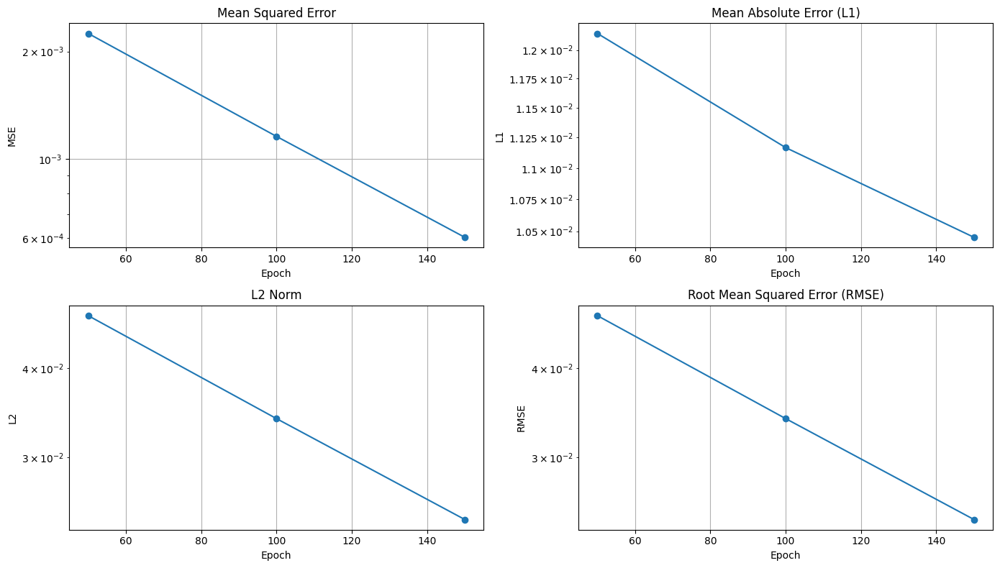

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 603ms/step - loss: 6.7881e-04 - val_loss: 6.0253e-04
Epoch 151/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 6.8827e-04 - val_loss: 5.9539e-04
Epoch 152/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 6.9379e-04 - val_loss: 5.8833e-04
Epoch 153/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 6.4355e-04 - val_loss: 5.8139e-04
Epoch 154/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 6.3396e-04 - val_loss: 5.7450e-04
Epoch 155/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 6.5233e-04 - val_loss: 5.6775e-04
Epoch 156/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 5.9568e-04 - val_loss: 5.6112e-04
Epoch 157/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 6.1869e-04 - val_loss: 5.5461e-04
Epoch 158/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 6.3755e-04 - val_loss: 5.4812e-04
Epoch 159/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 6.0611e-04 - val_loss: 5.4180e-04
Epoch 160/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 6.2342e-04 - 

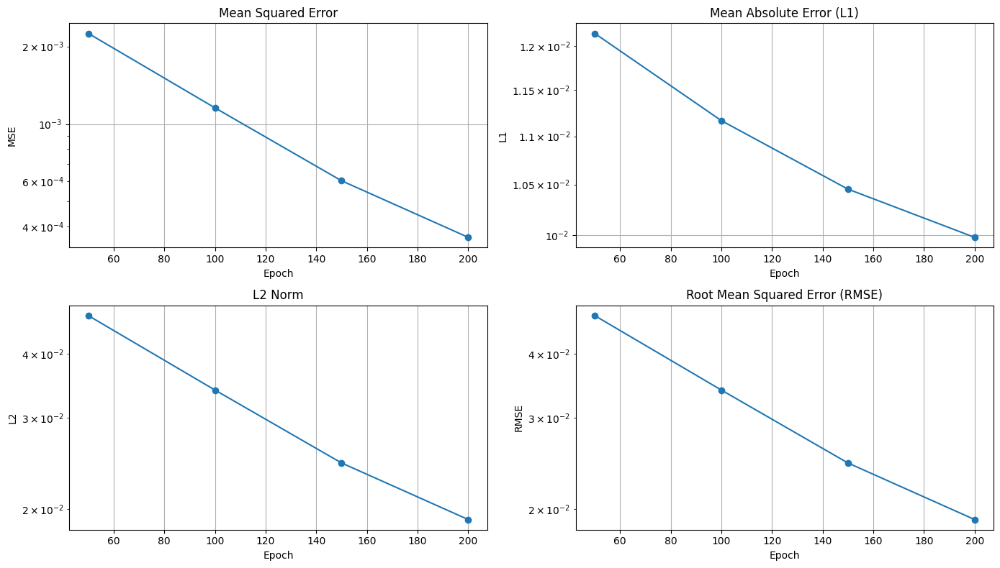

6/6 ━━━━━━━━━━━━━━━━━━━━ 6s 1s/step - loss: 4.0814e-04 - val_loss: 3.6366e-04
Epoch 201/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - loss: 3.9797e-04 - val_loss: 3.6098e-04
Epoch 202/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 4.1313e-04 - val_loss: 3.5830e-04
Epoch 203/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 3.9618e-04 - val_loss: 3.5579e-04
Epoch 204/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 4.1118e-04 - val_loss: 3.5321e-04
Epoch 205/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 3.9478e-04 - val_loss: 3.5074e-04
Epoch 206/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 4.0303e-04 - val_loss: 3.4821e-04
Epoch 207/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 3.7772e-04 - val_loss: 3.4586e-04
Epoch 208/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 4.0188e-04 - val_loss: 3.4351e-04
Epoch 209/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 3.7352e-04 - val_loss: 3.4119e-04
Epoch 210/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 3.9817e-04 - val

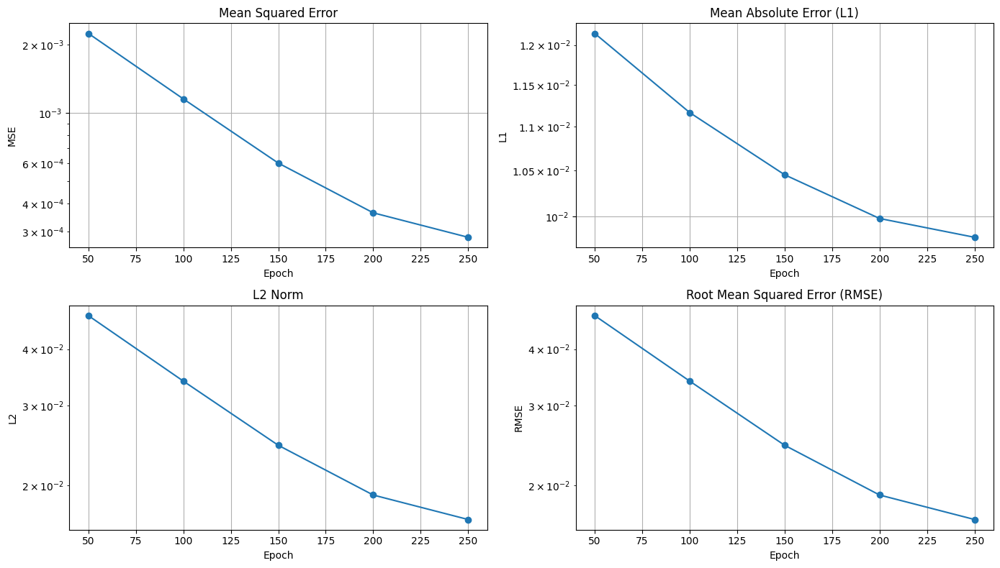

6/6 ━━━━━━━━━━━━━━━━━━━━ 6s 1s/step - loss: 3.4411e-04 - val_loss: 2.8365e-04
Epoch 251/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - loss: 3.0145e-04 - val_loss: 2.8278e-04
Epoch 252/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 3.2606e-04 - val_loss: 2.8206e-04
Epoch 253/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 3.1209e-04 - val_loss: 2.8133e-04
Epoch 254/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 3.0994e-04 - val_loss: 2.8071e-04
Epoch 255/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 3.2001e-04 - val_loss: 2.7999e-04
Epoch 256/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2.9189e-04 - val_loss: 2.7941e-04
Epoch 257/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 3.0825e-04 - val_loss: 2.7881e-04
Epoch 258/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.9627e-04 - val_loss: 2.7812e-04
Epoch 259/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 3.2182e-04 - val_loss: 2.7752e-04
Epoch 260/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 3.0404e-04 - val

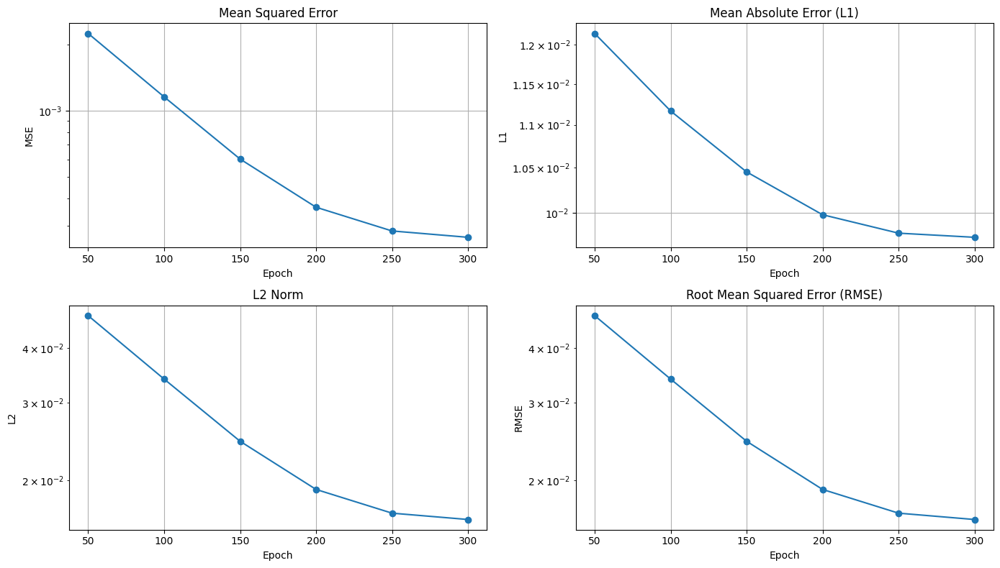

6/6 ━━━━━━━━━━━━━━━━━━━━ 29s 6s/step - loss: 2.8745e-04 - val_loss: 2.6542e-04
Epoch 301/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 13s 29ms/step - loss: 2.8603e-04 - val_loss: 2.6532e-04
Epoch 302/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 2.8492e-04 - val_loss: 2.6518e-04
Epoch 303/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.8648e-04 - val_loss: 2.6513e-04
Epoch 304/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2.9506e-04 - val_loss: 2.6509e-04
Epoch 305/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - loss: 2.8211e-04 - val_loss: 2.6495e-04
Epoch 306/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 3.0739e-04 - val_loss: 2.6488e-04
Epoch 307/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 2.7979e-04 - val_loss: 2.6475e-04
Epoch 308/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.7646e-04 - val_loss: 2.6465e-04
Epoch 309/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.9829e-04 - val_loss: 2.6456e-04
Epoch 310/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 2.7730e-04 - v

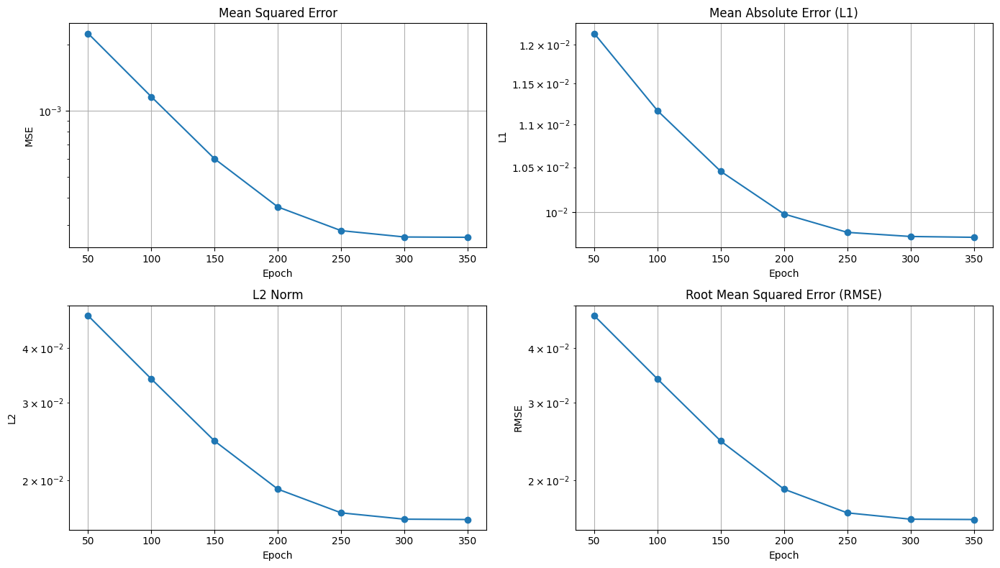

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 558ms/step - loss: 2.9035e-04 - val_loss: 2.6452e-04
Epoch 351/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 2.7577e-04 - val_loss: 2.6460e-04
Epoch 352/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 2.7985e-04 - val_loss: 2.6453e-04
Epoch 353/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - loss: 2.8865e-04 - val_loss: 2.6451e-04
Epoch 354/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 2.9365e-04 - val_loss: 2.6459e-04
Epoch 355/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.9920e-04 - val_loss: 2.6465e-04
Epoch 356/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.8678e-04 - val_loss: 2.6461e-04
Epoch 357/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 2.8675e-04 - val_loss: 2.6453e-04
Epoch 358/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - loss: 2.9584e-04 - val_loss: 2.6455e-04
Epoch 359/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 2.7095e-04 - val_loss: 2.6464e-04
Epoch 360/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.8056e-04 - 

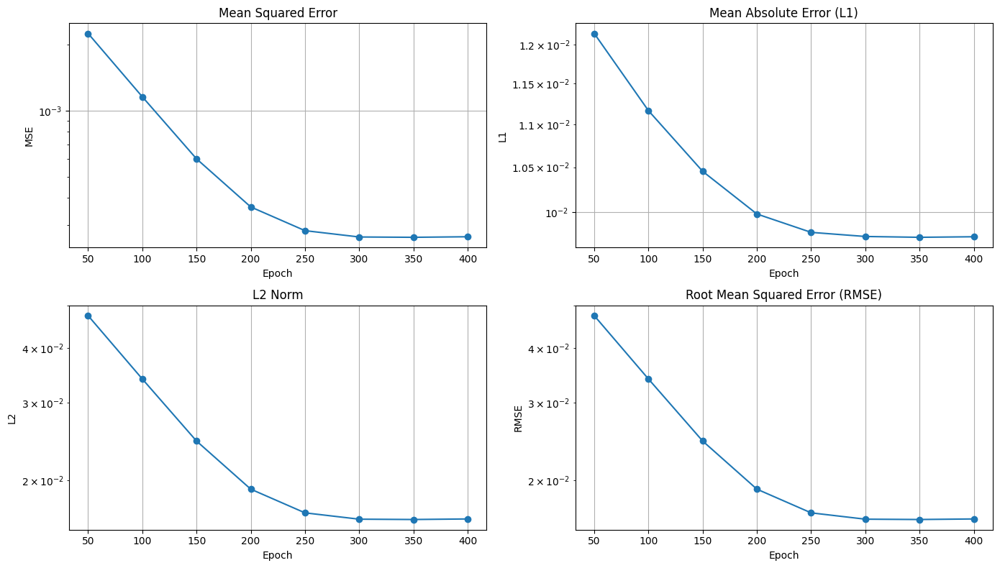

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 450ms/step - loss: 2.7605e-04 - val_loss: 2.6606e-04
Epoch 401/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 2.7899e-04 - val_loss: 2.6602e-04
Epoch 402/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.8704e-04 - val_loss: 2.6606e-04
Epoch 403/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.5744e-04 - val_loss: 2.6595e-04
Epoch 404/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - loss: 2.5491e-04 - val_loss: 2.6586e-04
Epoch 405/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - loss: 2.7895e-04 - val_loss: 2.6561e-04
Epoch 406/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 58ms/step - loss: 2.7943e-04 - val_loss: 2.6556e-04
Epoch 407/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 38ms/step - loss: 2.7662e-04 - val_loss: 2.6561e-04
Epoch 408/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 29ms/step - loss: 2.9897e-04 - val_loss: 2.6565e-04
Epoch 409/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 2.7497e-04 - val_loss: 2.6582e-04
Epoch 410/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 2.6971e-04 - 

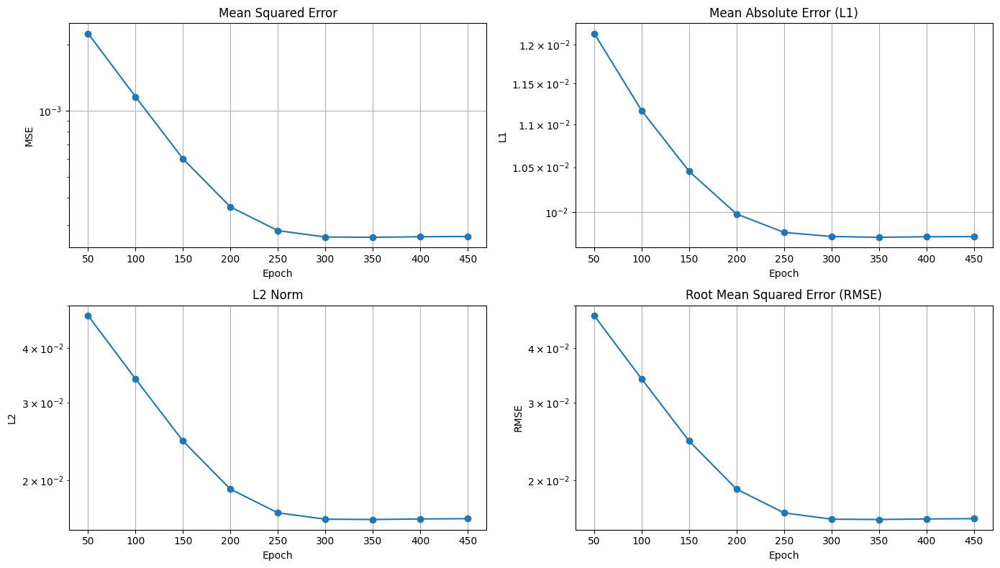

6/6 ━━━━━━━━━━━━━━━━━━━━ 8s 2s/step - loss: 2.7094e-04 - val_loss: 2.6691e-04
Epoch 451/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 2.8316e-04 - val_loss: 2.6675e-04
Epoch 452/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 2.7276e-04 - val_loss: 2.6675e-04
Epoch 453/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - loss: 2.9213e-04 - val_loss: 2.6649e-04
Epoch 454/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 2.7797e-04 - val_loss: 2.6643e-04
Epoch 455/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 2.7446e-04 - val_loss: 2.6646e-04
Epoch 456/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.8018e-04 - val_loss: 2.6661e-04
Epoch 457/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 2.7506e-04 - val_loss: 2.6655e-04
Epoch 458/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 2.7245e-04 - val_loss: 2.6653e-04
Epoch 459/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 2.6605e-04 - val_loss: 2.6653e-04
Epoch 460/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - loss: 2.7358e-04 - val

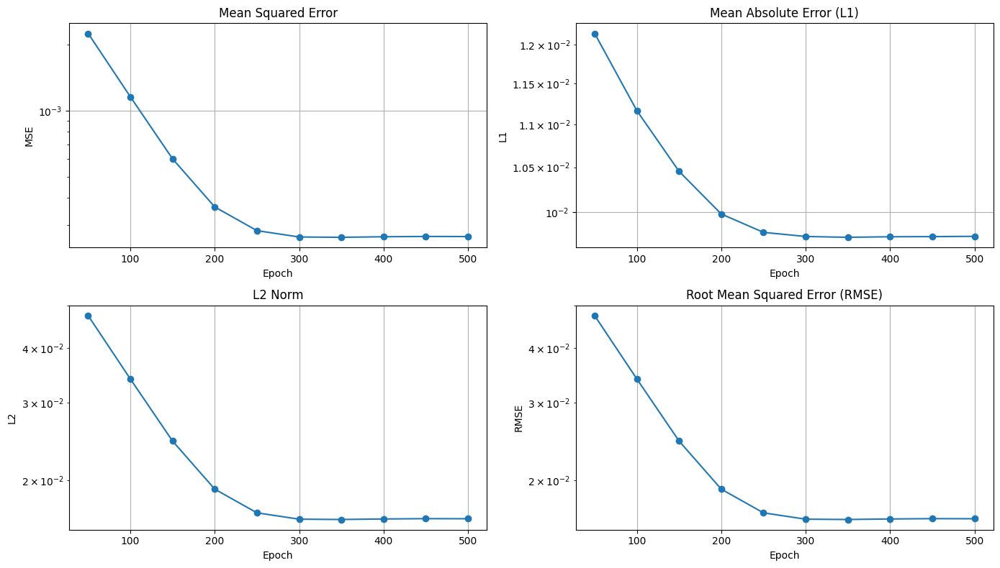

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 402ms/step - loss: 2.8422e-04 - val_loss: 2.6665e-04


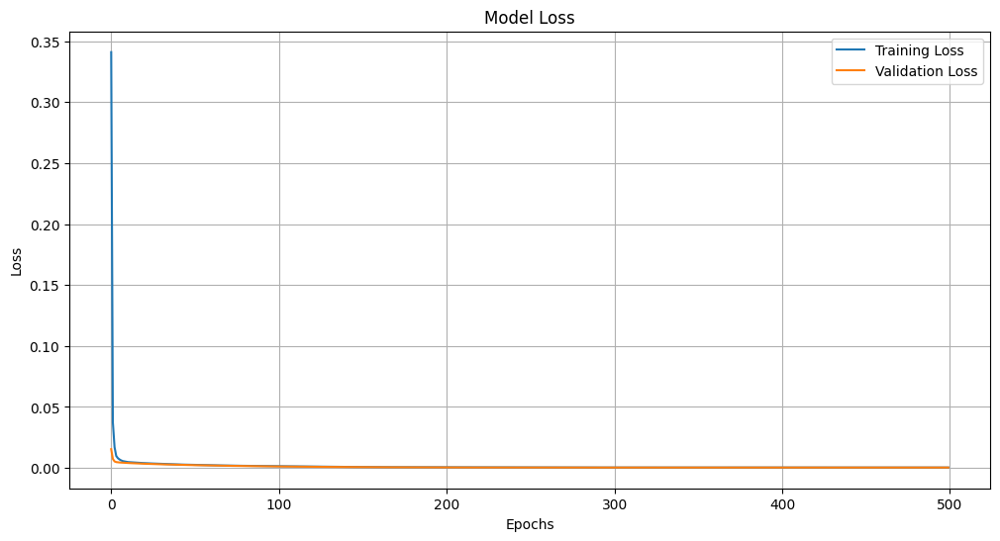

Epoch 1/500


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 44ms/step - loss: 0.3564 - val_loss: 0.0112
Epoch 2/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0336 - val_loss: 0.0060
Epoch 3/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0178 - val_loss: 0.0050
Epoch 4/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0102 - val_loss: 0.0047
Epoch 5/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0080 - val_loss: 0.0046
Epoch 6/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0064 - val_loss: 0.0045
Epoch 7/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0061 - val_loss: 0.0044
Epoch 8/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0058 - val_loss: 0.0043
Epoch 9/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0055 - val_loss: 0.0042
Epoch 10/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0051 - val_loss: 0.0041
Epoch 11/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0049 - val_loss: 0.0041
Epoch 12/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0047 - val_loss: 0.0040
E

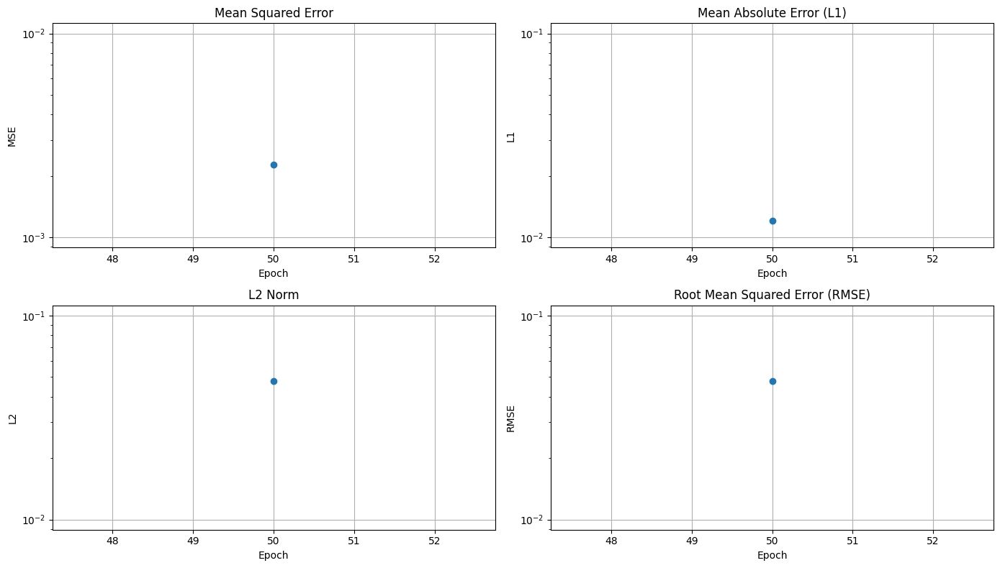

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 373ms/step - loss: 0.0025 - val_loss: 0.0023
Epoch 51/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 0.0025 - val_loss: 0.0022
Epoch 52/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0025 - val_loss: 0.0022
Epoch 53/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0024 - val_loss: 0.0022
Epoch 54/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0025 - val_loss: 0.0022
Epoch 55/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0024 - val_loss: 0.0021
Epoch 56/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0023 - val_loss: 0.0021
Epoch 57/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0022 - val_loss: 0.0021
Epoch 58/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0023 - val_loss: 0.0020
Epoch 59/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 0.0024 - val_loss: 0.0020
Epoch 60/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0023 - val_loss: 0.0020
Epoch 61/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0022 - val_loss:

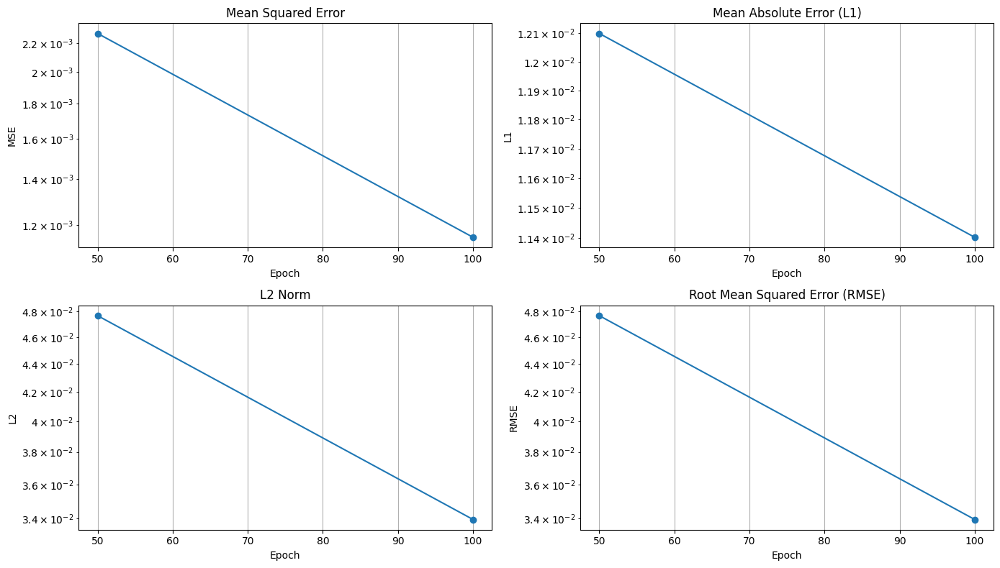

6/6 ━━━━━━━━━━━━━━━━━━━━ 14s 3s/step - loss: 0.0013 - val_loss: 0.0012
Epoch 101/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 0.0013 - val_loss: 0.0011
Epoch 102/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0013 - val_loss: 0.0011
Epoch 103/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 104/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0013 - val_loss: 0.0011
Epoch 105/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - loss: 0.0012 - val_loss: 0.0010
Epoch 106/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0012 - val_loss: 9.8490e-04
Epoch 107/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 0.0012 - val_loss: 9.4912e-04
Epoch 108/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.0012 - val_loss: 9.2993e-04
Epoch 109/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0011 - val_loss: 9.0811e-04
Epoch 110/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0010 - val_loss: 8.8251e-04
Epoch 111/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/st

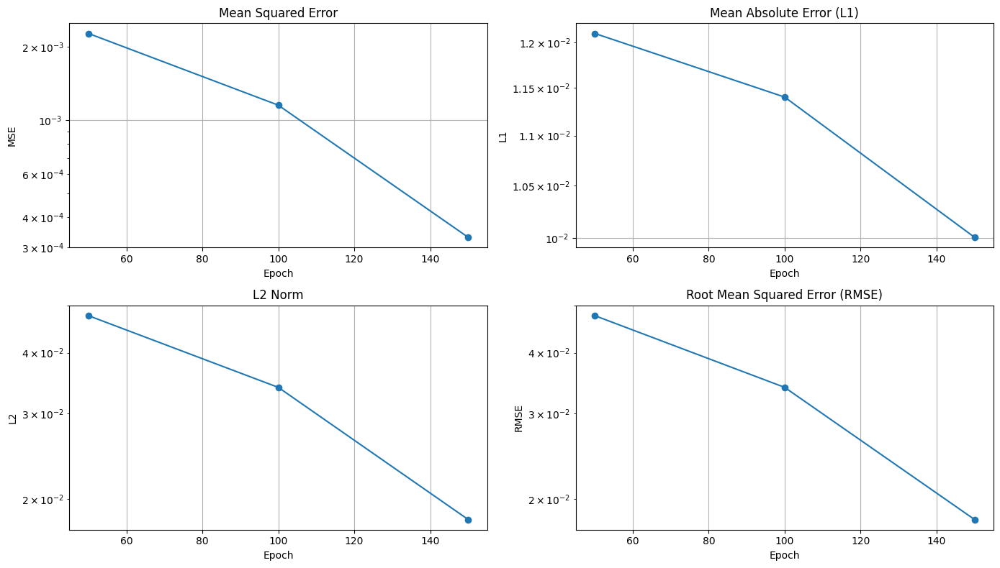

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 658ms/step - loss: 4.3702e-04 - val_loss: 3.2996e-04
Epoch 151/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step - loss: 5.1877e-04 - val_loss: 3.2995e-04
Epoch 152/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 5.2186e-04 - val_loss: 3.3131e-04
Epoch 153/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 4.5213e-04 - val_loss: 3.3342e-04
Epoch 154/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - loss: 4.4964e-04 - val_loss: 3.3203e-04
Epoch 155/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step - loss: 5.0656e-04 - val_loss: 3.2933e-04
Epoch 156/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - loss: 4.5182e-04 - val_loss: 3.2977e-04
Epoch 157/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 4.0426e-04 - val_loss: 3.3099e-04
Epoch 158/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - loss: 4.5287e-04 - val_loss: 3.3187e-04
Epoch 159/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 3.9833e-04 - val_loss: 3.2652e-04
Epoch 160/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - loss: 4.1332e-04 - 

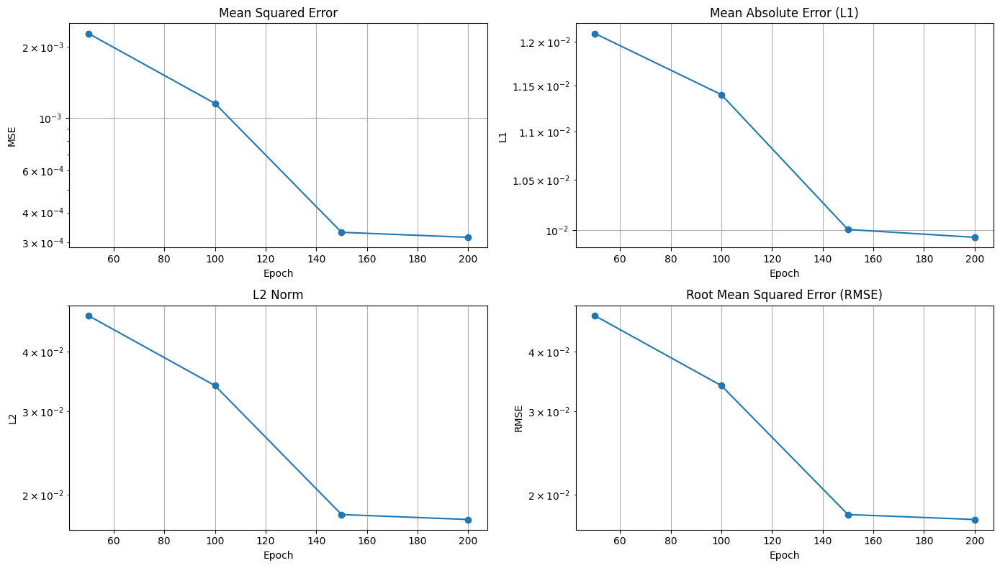

6/6 ━━━━━━━━━━━━━━━━━━━━ 5s 1s/step - loss: 4.2235e-04 - val_loss: 3.1441e-04
Epoch 201/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 5s 38ms/step - loss: 3.6604e-04 - val_loss: 3.1486e-04
Epoch 202/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 4.1354e-04 - val_loss: 3.1525e-04
Epoch 203/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - loss: 3.9041e-04 - val_loss: 3.1490e-04
Epoch 204/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 3.8890e-04 - val_loss: 3.1437e-04
Epoch 205/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 52ms/step - loss: 3.8338e-04 - val_loss: 3.1426e-04
Epoch 206/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 51ms/step - loss: 3.5775e-04 - val_loss: 3.1319e-04
Epoch 207/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 3.7844e-04 - val_loss: 3.1115e-04
Epoch 208/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 55ms/step - loss: 3.4414e-04 - val_loss: 3.0997e-04
Epoch 209/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - loss: 3.1510e-04 - val_loss: 3.1067e-04
Epoch 210/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 3.6401e-04 - val

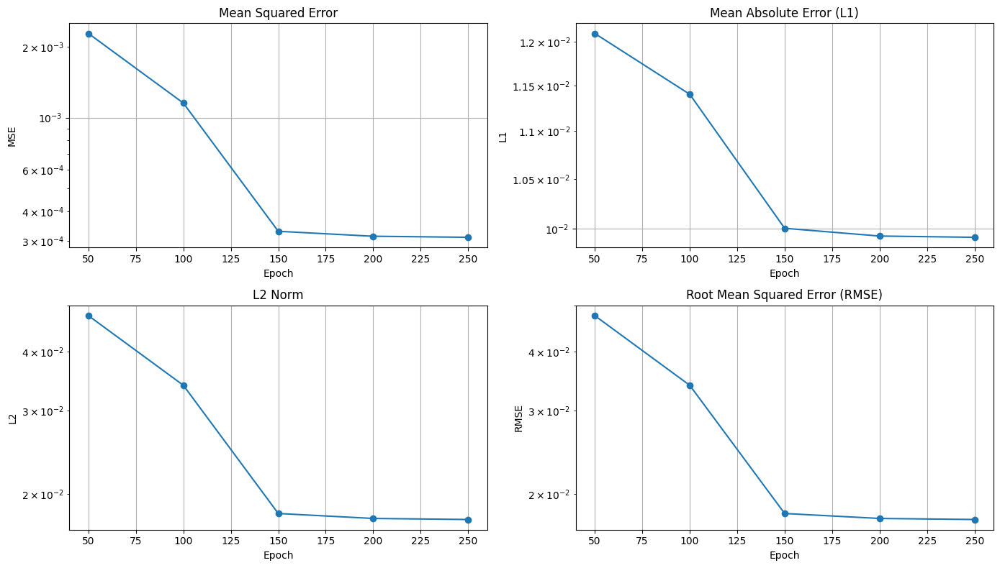

6/6 ━━━━━━━━━━━━━━━━━━━━ 5s 905ms/step - loss: 2.7699e-04 - val_loss: 3.1119e-04
Epoch 251/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 3.5357e-04 - val_loss: 3.1131e-04
Epoch 252/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - loss: 3.3299e-04 - val_loss: 3.1130e-04
Epoch 253/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - loss: 2.8333e-04 - val_loss: 3.1164e-04
Epoch 254/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 3.4521e-04 - val_loss: 3.1226e-04
Epoch 255/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 69ms/step - loss: 3.1110e-04 - val_loss: 3.1270e-04
Epoch 256/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - loss: 3.2215e-04 - val_loss: 3.1355e-04
Epoch 257/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 3.0634e-04 - val_loss: 3.1381e-04
Epoch 258/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 3.3476e-04 - val_loss: 3.1331e-04
Epoch 259/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 3.8005e-04 - val_loss: 3.1220e-04
Epoch 260/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 3.1577e-04 - 

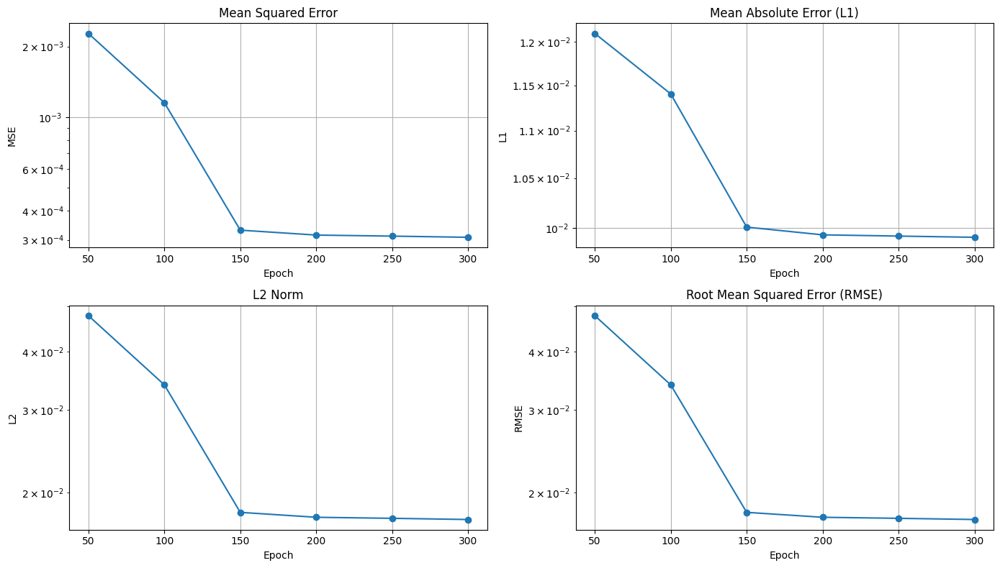

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 346ms/step - loss: 2.4201e-04 - val_loss: 3.0761e-04
Epoch 301/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 2.8248e-04 - val_loss: 3.0757e-04
Epoch 302/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.7490e-04 - val_loss: 3.0799e-04
Epoch 303/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 3.2736e-04 - val_loss: 3.0785e-04
Epoch 304/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.2533e-04 - val_loss: 3.0753e-04
Epoch 305/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.6128e-04 - val_loss: 3.0785e-04
Epoch 306/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.5452e-04 - val_loss: 3.0926e-04
Epoch 307/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.7680e-04 - val_loss: 3.0974e-04
Epoch 308/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 3.2621e-04 - val_loss: 3.0961e-04
Epoch 309/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.6355e-04 - val_loss: 3.0994e-04
Epoch 310/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 2.8414e-04 - 

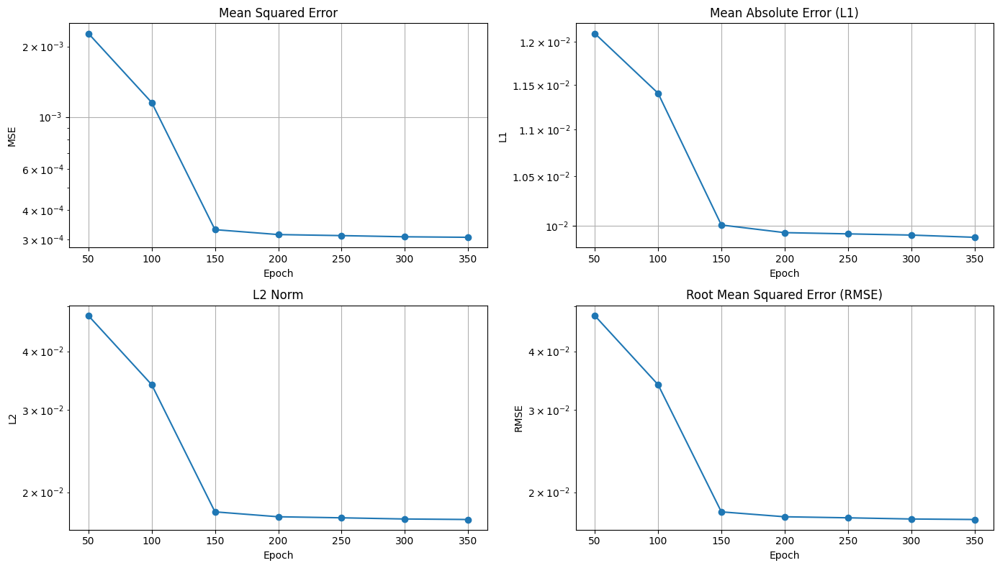

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 473ms/step - loss: 2.4663e-04 - val_loss: 3.0605e-04
Epoch 351/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.9371e-04 - val_loss: 3.0764e-04
Epoch 352/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 2.6649e-04 - val_loss: 3.0933e-04
Epoch 353/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2.5131e-04 - val_loss: 3.1103e-04
Epoch 354/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.8137e-04 - val_loss: 3.1012e-04
Epoch 355/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2.8541e-04 - val_loss: 3.0876e-04
Epoch 356/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.4807e-04 - val_loss: 3.0763e-04
Epoch 357/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.5908e-04 - val_loss: 3.0629e-04
Epoch 358/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.9413e-04 - val_loss: 3.0661e-04
Epoch 359/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.9080e-04 - val_loss: 3.0557e-04
Epoch 360/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.6011e-04 - 

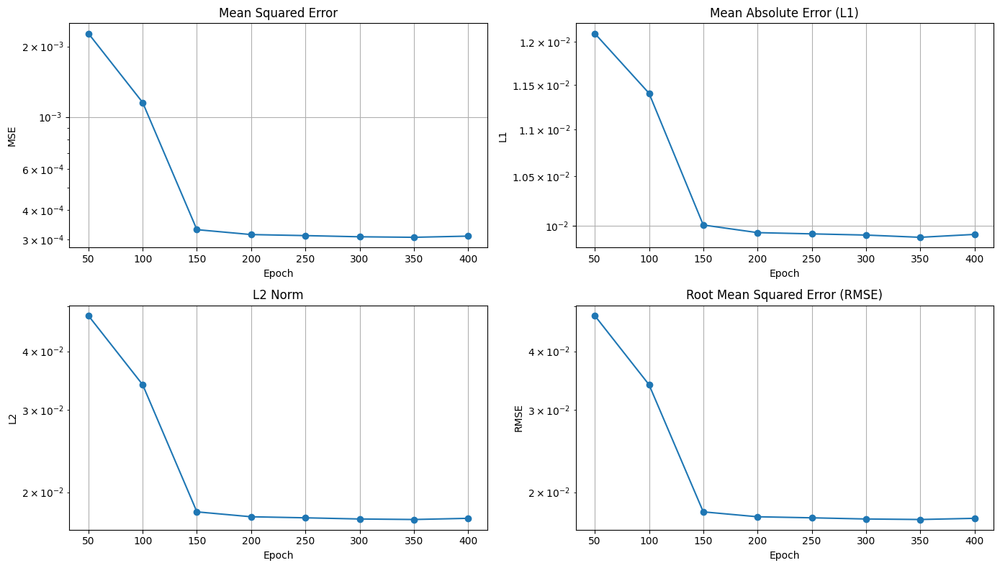

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 522ms/step - loss: 2.3794e-04 - val_loss: 3.0963e-04
Epoch 401/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 2.3961e-04 - val_loss: 3.0819e-04
Epoch 402/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 2.3993e-04 - val_loss: 3.0714e-04
Epoch 403/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 2.6796e-04 - val_loss: 3.0767e-04
Epoch 404/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 2.1895e-04 - val_loss: 3.0897e-04
Epoch 405/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 2.5469e-04 - val_loss: 3.1168e-04
Epoch 406/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 2.5102e-04 - val_loss: 3.1221e-04
Epoch 407/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.7774e-04 - val_loss: 3.0963e-04
Epoch 408/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.5161e-04 - val_loss: 3.0903e-04
Epoch 409/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.4505e-04 - val_loss: 3.0787e-04
Epoch 410/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.4796e-04 - 

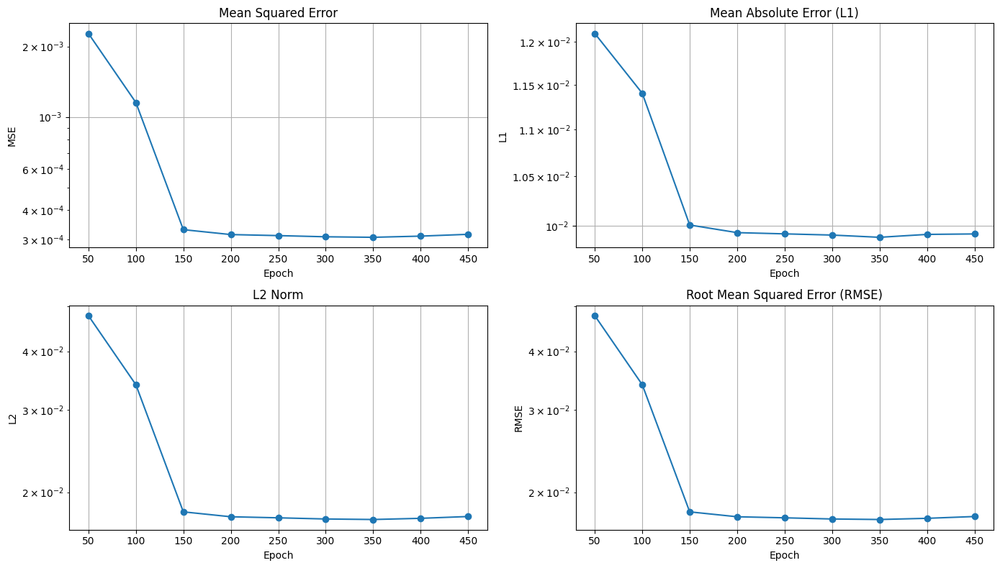

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 520ms/step - loss: 2.3324e-04 - val_loss: 3.1518e-04
Epoch 451/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 26ms/step - loss: 2.5806e-04 - val_loss: 3.0981e-04
Epoch 452/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 2.3422e-04 - val_loss: 3.0912e-04
Epoch 453/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 2.4170e-04 - val_loss: 3.1293e-04
Epoch 454/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 2.4428e-04 - val_loss: 3.1422e-04
Epoch 455/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 2.2858e-04 - val_loss: 3.1088e-04
Epoch 456/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.4507e-04 - val_loss: 3.1240e-04
Epoch 457/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.5481e-04 - val_loss: 3.1736e-04
Epoch 458/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.4168e-04 - val_loss: 3.2057e-04
Epoch 459/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.6147e-04 - val_loss: 3.2168e-04
Epoch 460/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.5157e-04 - 

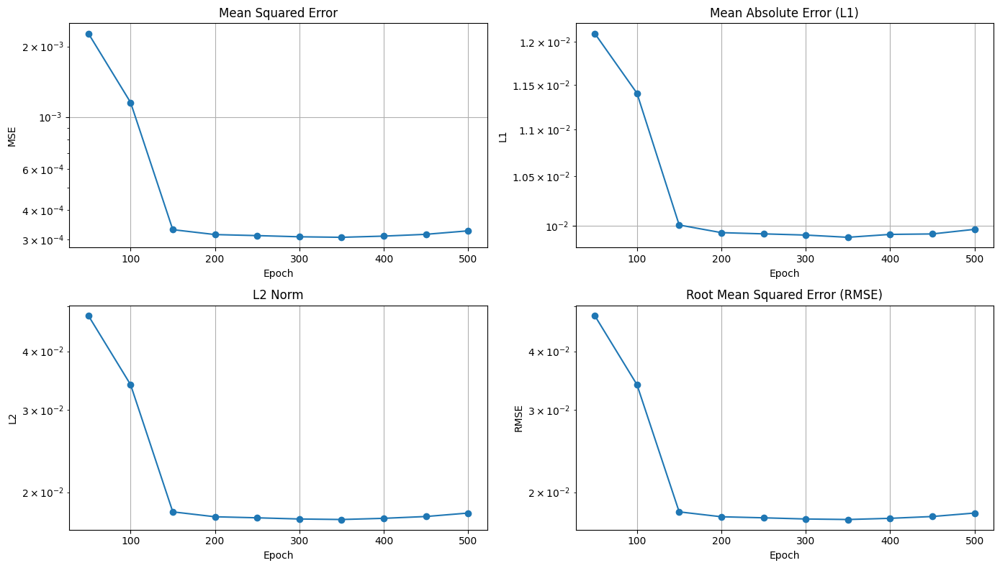

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 571ms/step - loss: 2.6602e-04 - val_loss: 3.2614e-04


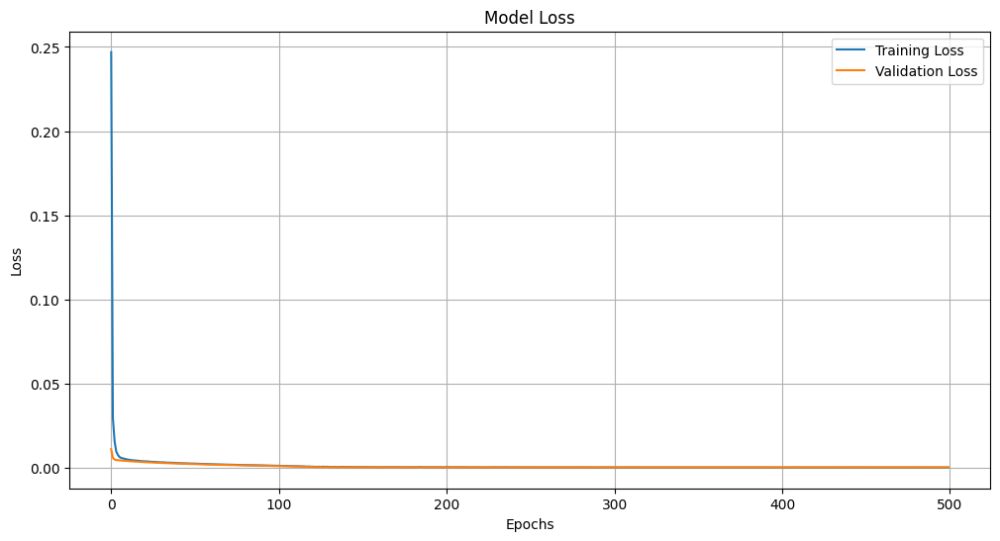

Epoch 1/500


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 43ms/step - loss: 0.3734 - val_loss: 0.0125
Epoch 2/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0389 - val_loss: 0.0061
Epoch 3/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0153 - val_loss: 0.0048
Epoch 4/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0088 - val_loss: 0.0044
Epoch 5/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0071 - val_loss: 0.0043
Epoch 6/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0061 - val_loss: 0.0042
Epoch 7/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0058 - val_loss: 0.0041
Epoch 8/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0053 - val_loss: 0.0040
Epoch 9/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0050 - val_loss: 0.0040
Epoch 10/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0048 - val_loss: 0.0039
Epoch 11/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0046 - val_loss: 0.0038
Epoch 12/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0044 - val_loss: 0.0037
E

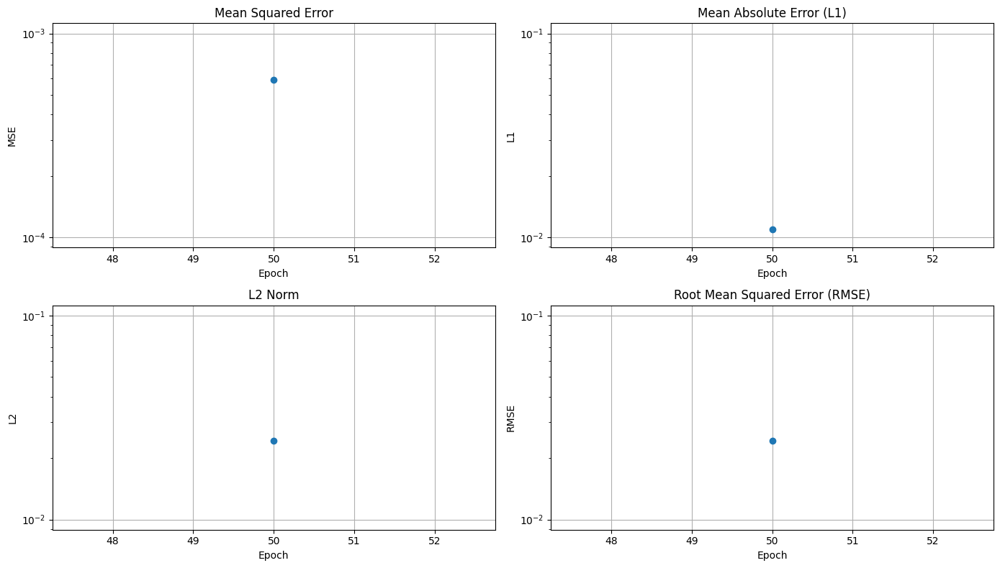

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 562ms/step - loss: 0.0011 - val_loss: 5.9364e-04
Epoch 51/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0015 - val_loss: 5.4858e-04
Epoch 52/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0010 - val_loss: 5.2314e-04
Epoch 53/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 8.7402e-04 - val_loss: 5.3223e-04
Epoch 54/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0011 - val_loss: 5.3375e-04
Epoch 55/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 9.4599e-04 - val_loss: 5.3815e-04
Epoch 56/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0010 - val_loss: 5.4307e-04
Epoch 57/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0011 - val_loss: 5.2770e-04
Epoch 58/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 9.1483e-04 - val_loss: 5.0331e-04
Epoch 59/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 8.0007e-04 - val_loss: 4.9627e-04
Epoch 60/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 9.8409e-04 - val_loss: 5.0188e-04
Epoch 61/500


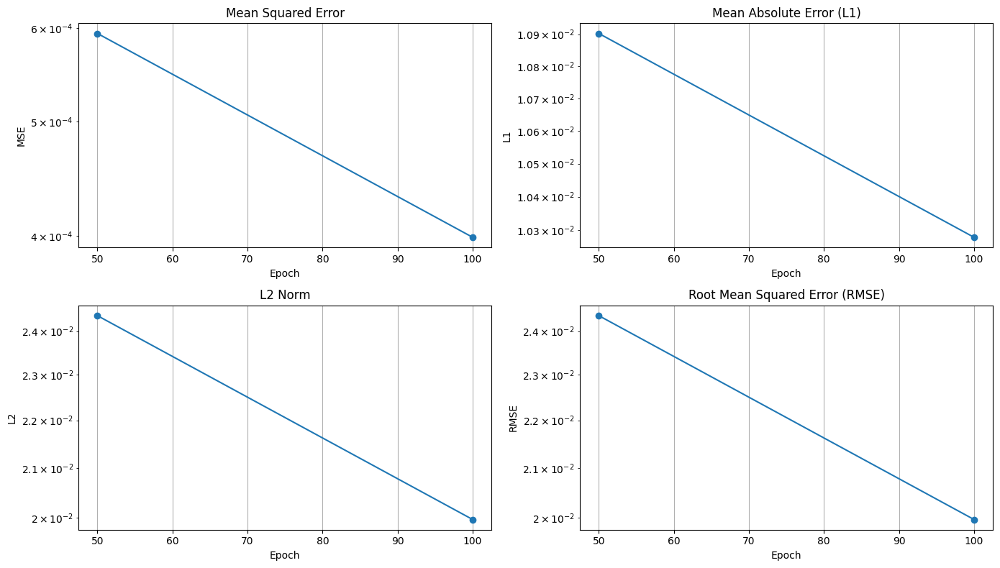

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 389ms/step - loss: 8.6113e-04 - val_loss: 3.9884e-04
Epoch 101/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 6.4477e-04 - val_loss: 3.9478e-04
Epoch 102/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 7.1213e-04 - val_loss: 3.9081e-04
Epoch 103/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 8.3819e-04 - val_loss: 3.9004e-04
Epoch 104/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 6.7118e-04 - val_loss: 3.8970e-04
Epoch 105/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 6.1827e-04 - val_loss: 3.8087e-04
Epoch 106/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 6.1763e-04 - val_loss: 3.8209e-04
Epoch 107/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 8.2006e-04 - val_loss: 3.8978e-04
Epoch 108/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 6.7312e-04 - val_loss: 3.8869e-04
Epoch 109/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 6.6871e-04 - val_loss: 3.8175e-04
Epoch 110/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 7.1921e-04 - 

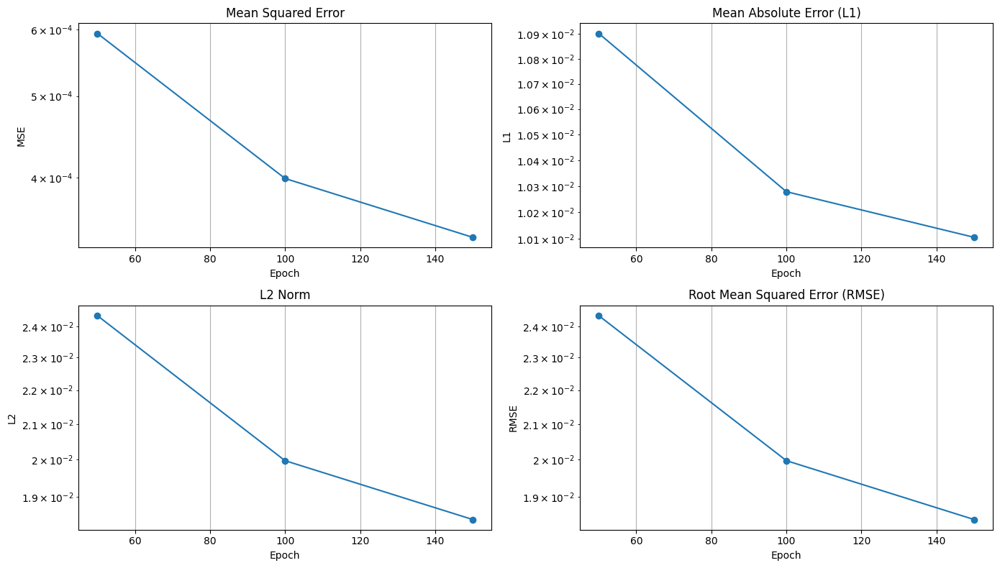

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 336ms/step - loss: 5.3122e-04 - val_loss: 3.3942e-04
Epoch 151/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 4.9187e-04 - val_loss: 3.3993e-04
Epoch 152/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 4.6545e-04 - val_loss: 3.4034e-04
Epoch 153/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 4.6478e-04 - val_loss: 3.3692e-04
Epoch 154/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 6.3943e-04 - val_loss: 3.3481e-04
Epoch 155/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 5.2772e-04 - val_loss: 3.3429e-04
Epoch 156/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 4.3017e-04 - val_loss: 3.3518e-04
Epoch 157/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 5.4267e-04 - val_loss: 3.3547e-04
Epoch 158/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 4.6144e-04 - val_loss: 3.3424e-04
Epoch 159/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 5.4329e-04 - val_loss: 3.3309e-04
Epoch 160/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 5.8443e-04 - 

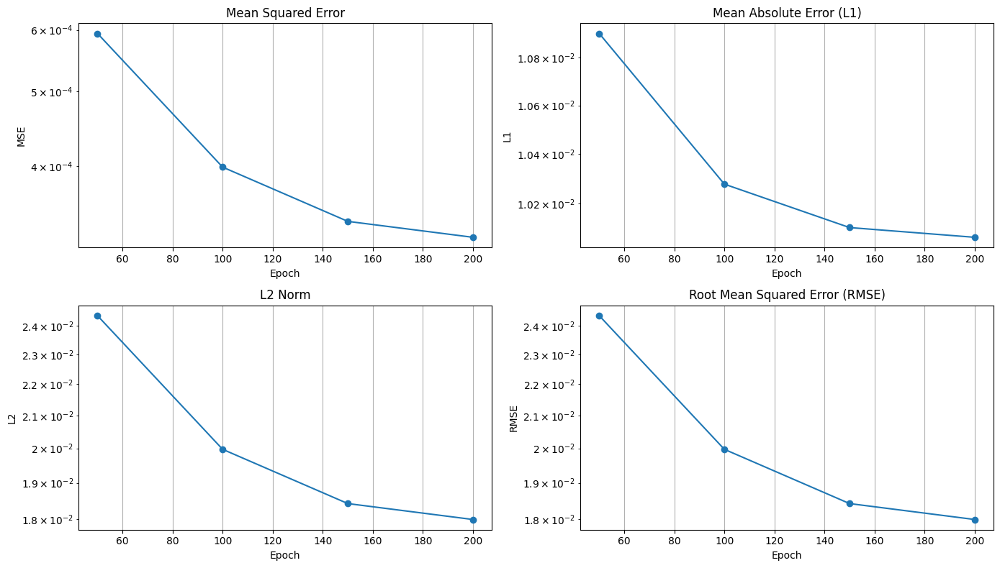

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 323ms/step - loss: 3.9054e-04 - val_loss: 3.2371e-04
Epoch 201/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 3.4538e-04 - val_loss: 3.2347e-04
Epoch 202/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 4.1692e-04 - val_loss: 3.2305e-04
Epoch 203/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 3.5981e-04 - val_loss: 3.2270e-04
Epoch 204/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 3.6230e-04 - val_loss: 3.2304e-04
Epoch 205/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 4.4185e-04 - val_loss: 3.2321e-04
Epoch 206/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 4.4972e-04 - val_loss: 3.2388e-04
Epoch 207/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 4.2999e-04 - val_loss: 3.2399e-04
Epoch 208/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 3.7759e-04 - val_loss: 3.2404e-04
Epoch 209/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 3.7242e-04 - val_loss: 3.2395e-04
Epoch 210/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 3.5981e-04 - 

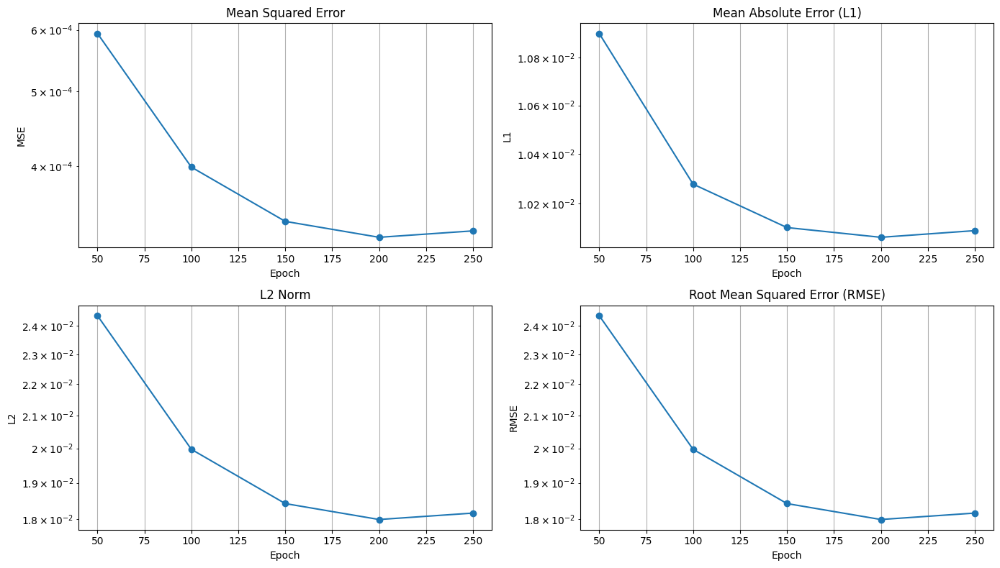

6/6 ━━━━━━━━━━━━━━━━━━━━ 18s 4s/step - loss: 3.6860e-04 - val_loss: 3.2995e-04
Epoch 251/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - loss: 3.1170e-04 - val_loss: 3.2747e-04
Epoch 252/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 3.4208e-04 - val_loss: 3.2592e-04
Epoch 253/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - loss: 3.2118e-04 - val_loss: 3.2546e-04
Epoch 254/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 3.2446e-04 - val_loss: 3.2689e-04
Epoch 255/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 3.0805e-04 - val_loss: 3.2741e-04
Epoch 256/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 3.2557e-04 - val_loss: 3.2707e-04
Epoch 257/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 3.9434e-04 - val_loss: 3.2633e-04
Epoch 258/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 2.9766e-04 - val_loss: 3.2608e-04
Epoch 259/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 3.0565e-04 - val_loss: 3.2767e-04
Epoch 260/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 3.2447e-04 - va

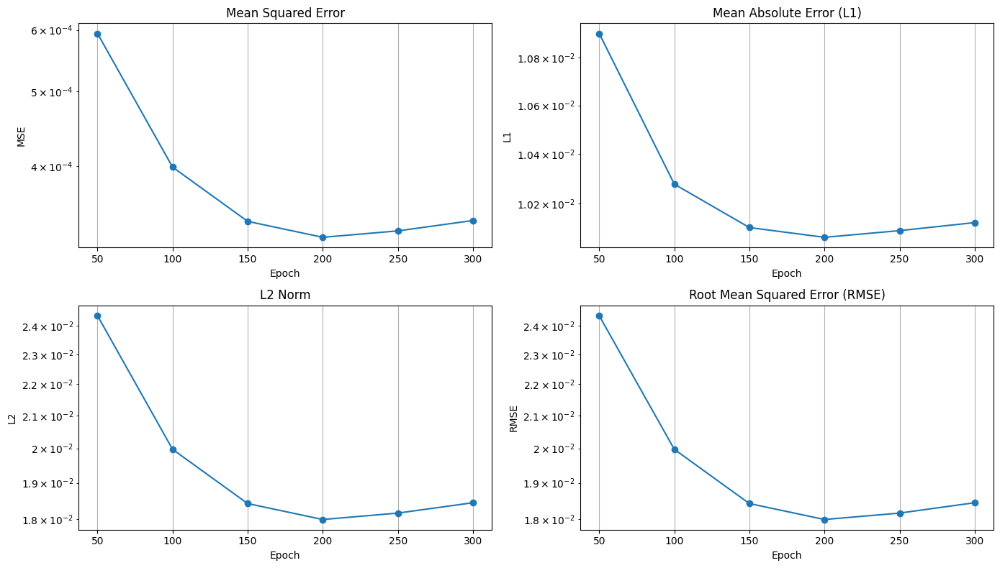

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 322ms/step - loss: 2.9913e-04 - val_loss: 3.4029e-04
Epoch 301/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 2.9786e-04 - val_loss: 3.3784e-04
Epoch 302/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 3.0185e-04 - val_loss: 3.3729e-04
Epoch 303/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 2.6891e-04 - val_loss: 3.3795e-04
Epoch 304/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 3.2586e-04 - val_loss: 3.3865e-04
Epoch 305/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 2.3409e-04 - val_loss: 3.3781e-04
Epoch 306/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 2.5624e-04 - val_loss: 3.3603e-04
Epoch 307/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 2.2801e-04 - val_loss: 3.3701e-04
Epoch 308/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 2.4117e-04 - val_loss: 3.3934e-04
Epoch 309/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 2.7327e-04 - val_loss: 3.4049e-04
Epoch 310/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 3.2393e-04 - 

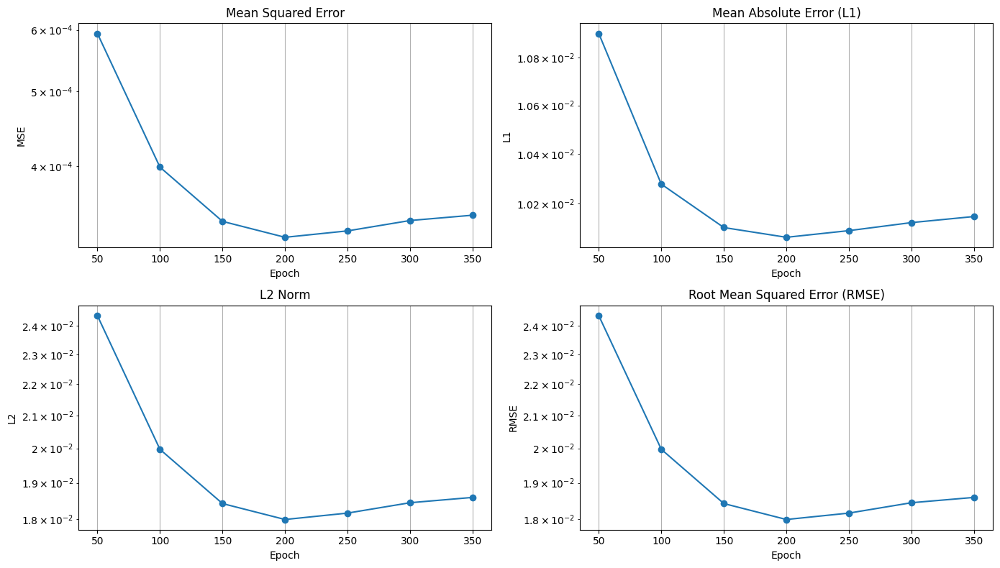

6/6 ━━━━━━━━━━━━━━━━━━━━ 4s 768ms/step - loss: 2.5260e-04 - val_loss: 3.4571e-04
Epoch 351/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 2.6845e-04 - val_loss: 3.4665e-04
Epoch 352/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 2.4376e-04 - val_loss: 3.4867e-04
Epoch 353/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 2.3828e-04 - val_loss: 3.5054e-04
Epoch 354/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 2.3230e-04 - val_loss: 3.5156e-04
Epoch 355/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 2.3738e-04 - val_loss: 3.5227e-04
Epoch 356/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 2.7785e-04 - val_loss: 3.5108e-04
Epoch 357/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 2.3644e-04 - val_loss: 3.4977e-04
Epoch 358/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 2.4812e-04 - val_loss: 3.4868e-04
Epoch 359/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 2.5687e-04 - val_loss: 3.5101e-04
Epoch 360/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 2.4196e-04 - 

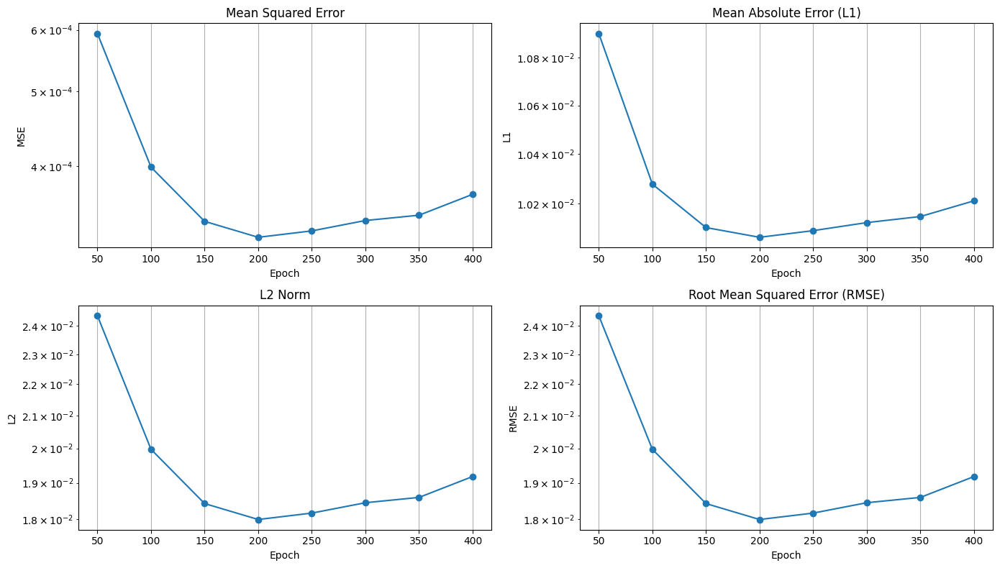

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 346ms/step - loss: 2.3687e-04 - val_loss: 3.6788e-04
Epoch 401/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 2.7777e-04 - val_loss: 3.6900e-04
Epoch 402/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.4011e-04 - val_loss: 3.6840e-04
Epoch 403/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.3115e-04 - val_loss: 3.6864e-04
Epoch 404/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 2.1939e-04 - val_loss: 3.7261e-04
Epoch 405/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 2.5267e-04 - val_loss: 3.7336e-04
Epoch 406/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 2.2146e-04 - val_loss: 3.7141e-04
Epoch 407/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.4442e-04 - val_loss: 3.7129e-04
Epoch 408/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 2.1903e-04 - val_loss: 3.7467e-04
Epoch 409/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 2.2062e-04 - val_loss: 3.7523e-04
Epoch 410/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - loss: 2.4115e-04 - 

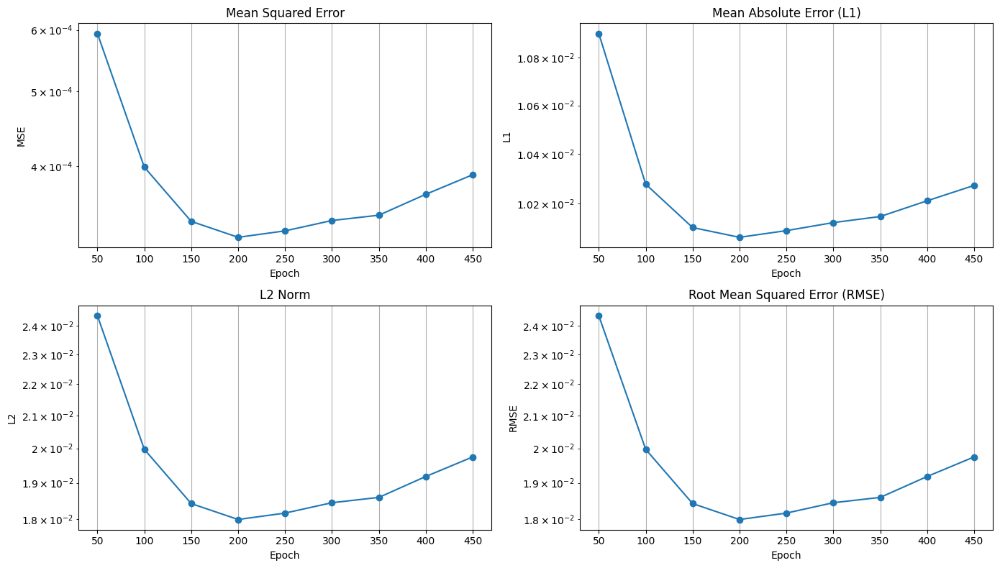

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 423ms/step - loss: 2.2253e-04 - val_loss: 3.8991e-04
Epoch 451/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 2.2541e-04 - val_loss: 3.8929e-04
Epoch 452/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - loss: 2.5303e-04 - val_loss: 3.8822e-04
Epoch 453/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.2453e-04 - val_loss: 3.8658e-04
Epoch 454/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - loss: 2.2561e-04 - val_loss: 3.8341e-04
Epoch 455/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 2.5968e-04 - val_loss: 3.8572e-04
Epoch 456/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 2.3423e-04 - val_loss: 3.8555e-04
Epoch 457/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 2.2257e-04 - val_loss: 3.8915e-04
Epoch 458/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 2.4336e-04 - val_loss: 3.9318e-04
Epoch 459/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - loss: 2.3438e-04 - val_loss: 3.9542e-04
Epoch 460/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 2.1528e-04 - 

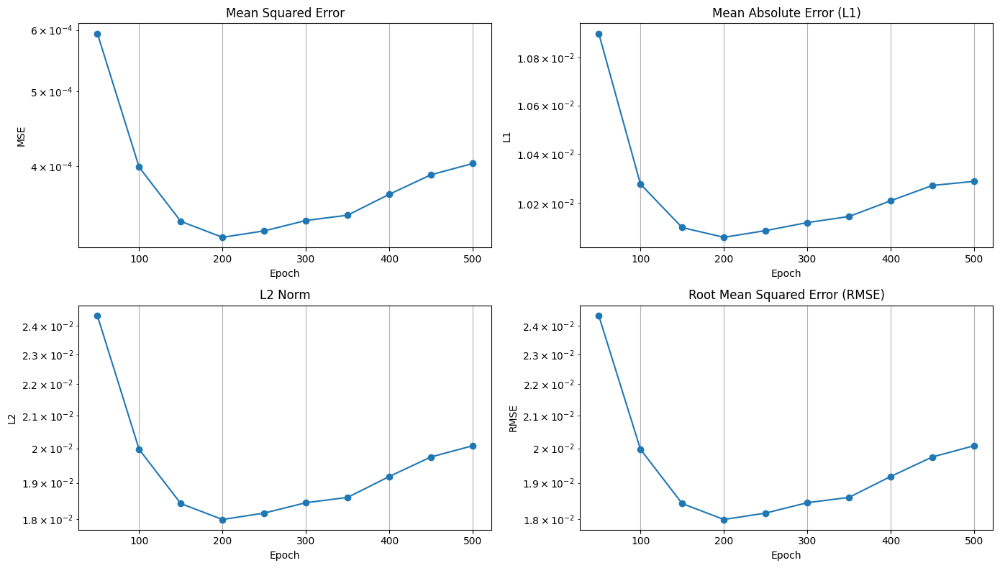

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 322ms/step - loss: 2.3103e-04 - val_loss: 4.0312e-04


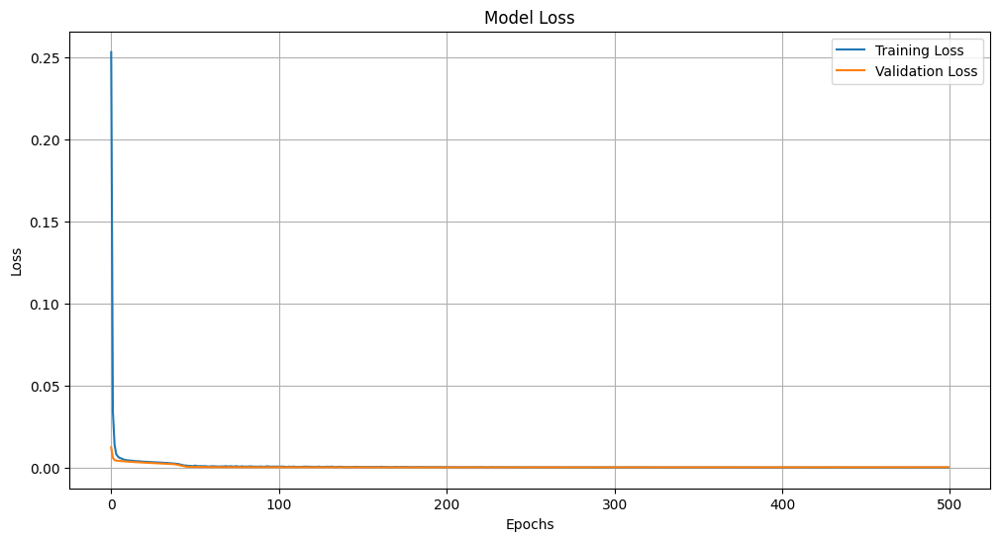

Epoch 1/500


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 75ms/step - loss: 0.3581 - val_loss: 0.0097
Epoch 2/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0421 - val_loss: 0.0058
Epoch 3/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0163 - val_loss: 0.0051
Epoch 4/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0095 - val_loss: 0.0049
Epoch 5/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0076 - val_loss: 0.0048
Epoch 6/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0064 - val_loss: 0.0047
Epoch 7/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0056 - val_loss: 0.0046
Epoch 8/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0052 - val_loss: 0.0046
Epoch 9/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0052 - val_loss: 0.0045
Epoch 10/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 0.0051 - val_loss: 0.0044
Epoch 11/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0051 - val_loss: 0.0043
Epoch 12/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0043 - val_loss: 0.0042
E

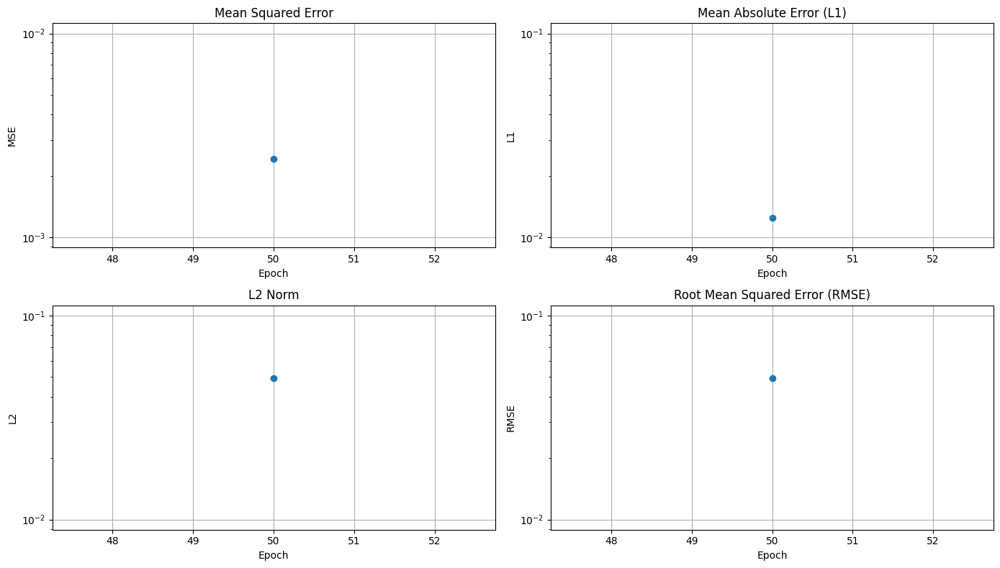

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 447ms/step - loss: 0.0024 - val_loss: 0.0024
Epoch 51/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0025 - val_loss: 0.0024
Epoch 52/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0023 - val_loss: 0.0024
Epoch 53/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0023 - val_loss: 0.0023
Epoch 54/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0023 - val_loss: 0.0023
Epoch 55/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0023 - val_loss: 0.0023
Epoch 56/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0023 - val_loss: 0.0022
Epoch 57/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 0.0023 - val_loss: 0.0022
Epoch 58/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0022 - val_loss: 0.0022
Epoch 59/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 0.0021 - val_loss: 0.0022
Epoch 60/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0021 - val_loss: 0.0021
Epoch 61/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0021 - val_loss:

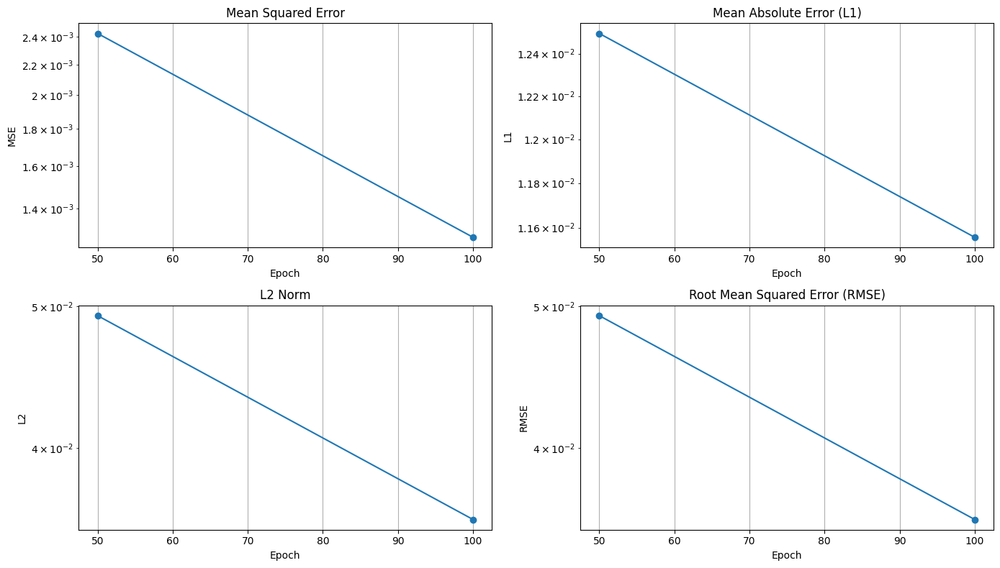

6/6 ━━━━━━━━━━━━━━━━━━━━ 17s 3s/step - loss: 0.0013 - val_loss: 0.0013
Epoch 101/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - loss: 0.0012 - val_loss: 0.0013
Epoch 102/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 0.0013 - val_loss: 0.0012
Epoch 103/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 0.0012 - val_loss: 0.0012
Epoch 104/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 67ms/step - loss: 0.0012 - val_loss: 0.0012
Epoch 105/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 0.0012 - val_loss: 0.0012
Epoch 106/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 0.0011 - val_loss: 0.0012
Epoch 107/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 0.0012 - val_loss: 0.0012
Epoch 108/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 0.0011 - val_loss: 0.0012
Epoch 109/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 102ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 110/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - loss: 9.8718e-04 - val_loss: 0.0011
Epoch 111/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.00

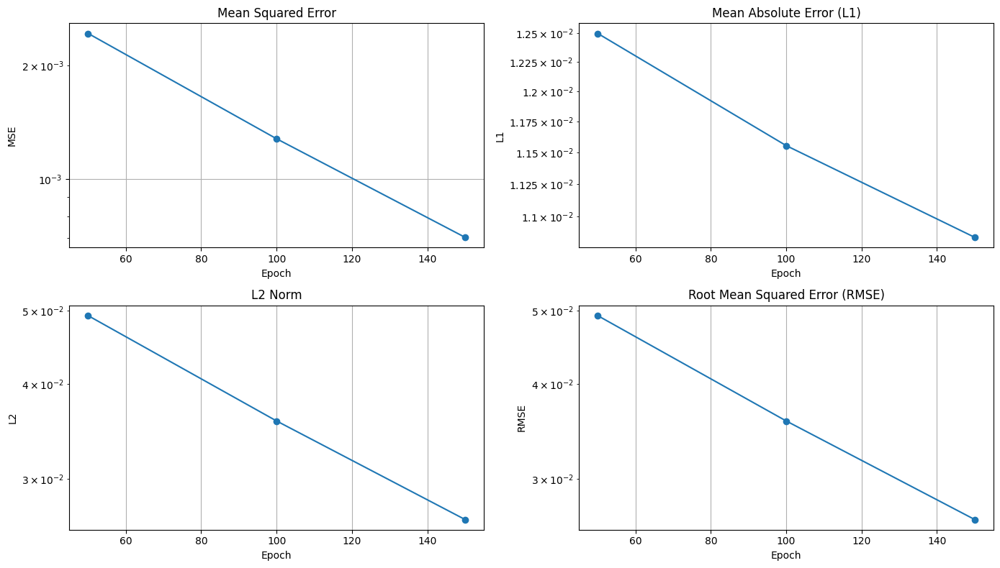

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 543ms/step - loss: 6.7434e-04 - val_loss: 7.0326e-04
Epoch 151/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - loss: 6.4100e-04 - val_loss: 6.9579e-04
Epoch 152/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 6.6646e-04 - val_loss: 6.8818e-04
Epoch 153/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 6.4914e-04 - val_loss: 6.8079e-04
Epoch 154/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 7.2365e-04 - val_loss: 6.7340e-04
Epoch 155/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 5.9050e-04 - val_loss: 6.6634e-04
Epoch 156/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 6.4965e-04 - val_loss: 6.5920e-04
Epoch 157/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 6.2868e-04 - val_loss: 6.5232e-04
Epoch 158/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 5.3758e-04 - val_loss: 6.4568e-04
Epoch 159/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 6.3481e-04 - val_loss: 6.3883e-04
Epoch 160/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 5.9835e-04 - 

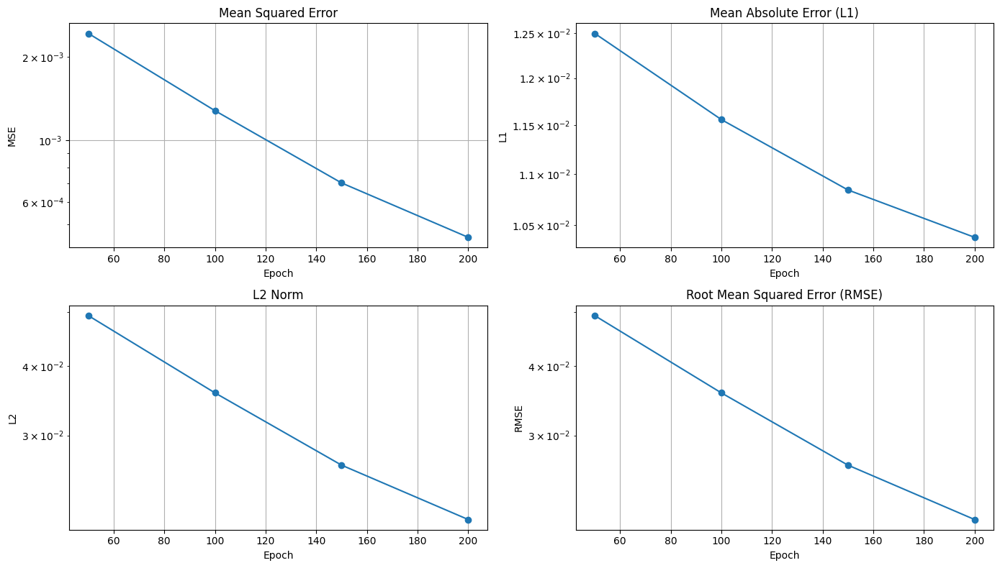

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 479ms/step - loss: 3.8056e-04 - val_loss: 4.4831e-04
Epoch 201/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 4.4076e-04 - val_loss: 4.4522e-04
Epoch 202/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 4.1215e-04 - val_loss: 4.4222e-04
Epoch 203/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 3.8645e-04 - val_loss: 4.3934e-04
Epoch 204/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 4.0568e-04 - val_loss: 4.3647e-04
Epoch 205/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 3.9249e-04 - val_loss: 4.3362e-04
Epoch 206/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 4.1627e-04 - val_loss: 4.3078e-04
Epoch 207/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 4.2639e-04 - val_loss: 4.2802e-04
Epoch 208/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 4.1449e-04 - val_loss: 4.2533e-04
Epoch 209/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 3.8330e-04 - val_loss: 4.2284e-04
Epoch 210/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 3.9091e-04 - 

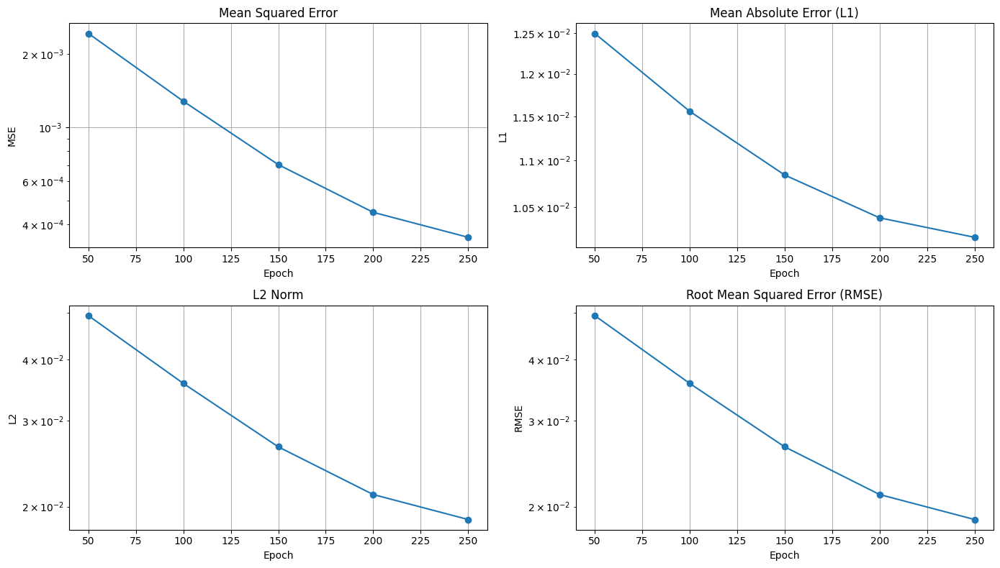

6/6 ━━━━━━━━━━━━━━━━━━━━ 4s 771ms/step - loss: 3.3087e-04 - val_loss: 3.5418e-04
Epoch 251/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 3.3698e-04 - val_loss: 3.5313e-04
Epoch 252/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 3.4039e-04 - val_loss: 3.5219e-04
Epoch 253/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 3.5094e-04 - val_loss: 3.5128e-04
Epoch 254/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 3.2726e-04 - val_loss: 3.5051e-04
Epoch 255/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 3.1712e-04 - val_loss: 3.4955e-04
Epoch 256/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 3.3845e-04 - val_loss: 3.4854e-04
Epoch 257/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 3.1784e-04 - val_loss: 3.4759e-04
Epoch 258/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 3.1357e-04 - val_loss: 3.4683e-04
Epoch 259/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 3.2936e-04 - val_loss: 3.4595e-04
Epoch 260/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.9923e-04 - 

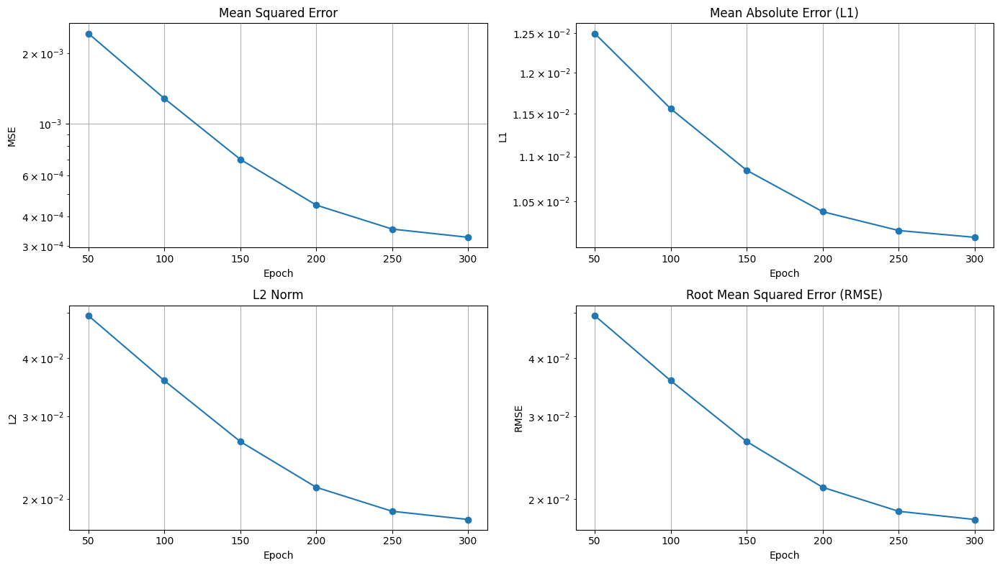

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 577ms/step - loss: 3.0079e-04 - val_loss: 3.2666e-04
Epoch 301/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step - loss: 3.3098e-04 - val_loss: 3.2632e-04
Epoch 302/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 3.0554e-04 - val_loss: 3.2603e-04
Epoch 303/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 3.0828e-04 - val_loss: 3.2579e-04
Epoch 304/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 2.9015e-04 - val_loss: 3.2547e-04
Epoch 305/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 3.0624e-04 - val_loss: 3.2517e-04
Epoch 306/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 3.3709e-04 - val_loss: 3.2491e-04
Epoch 307/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 3.0480e-04 - val_loss: 3.2473e-04
Epoch 308/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 3.0002e-04 - val_loss: 3.2449e-04
Epoch 309/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 3.0879e-04 - val_loss: 3.2419e-04
Epoch 310/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step - loss: 3.3705e-04 - 

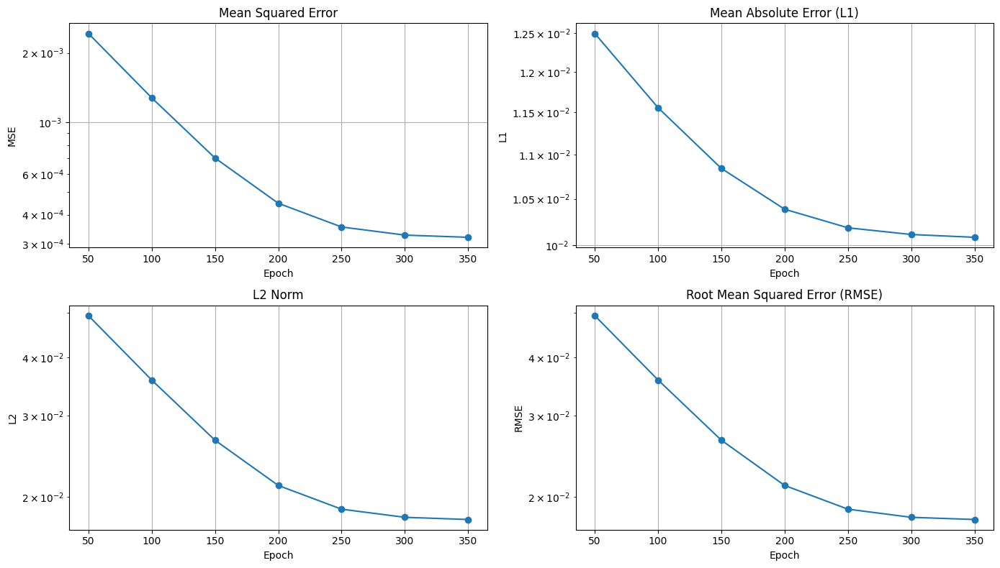

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 663ms/step - loss: 2.9214e-04 - val_loss: 3.1962e-04
Epoch 351/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 2.9676e-04 - val_loss: 3.1950e-04
Epoch 352/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 3.1445e-04 - val_loss: 3.1944e-04
Epoch 353/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 3.0398e-04 - val_loss: 3.1955e-04
Epoch 354/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 3.0556e-04 - val_loss: 3.1937e-04
Epoch 355/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 3.1263e-04 - val_loss: 3.1913e-04
Epoch 356/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 3.2186e-04 - val_loss: 3.1901e-04
Epoch 357/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.9109e-04 - val_loss: 3.1907e-04
Epoch 358/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.8886e-04 - val_loss: 3.1924e-04
Epoch 359/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.9975e-04 - val_loss: 3.1938e-04
Epoch 360/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.9480e-04 - 

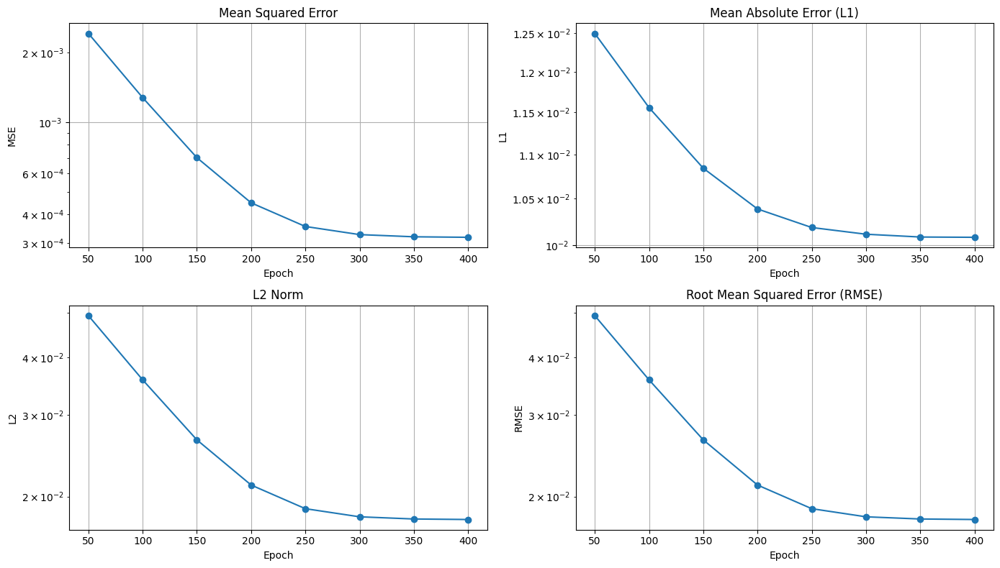

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 617ms/step - loss: 2.8645e-04 - val_loss: 3.1799e-04
Epoch 401/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 3.0960e-04 - val_loss: 3.1809e-04
Epoch 402/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 3.1340e-04 - val_loss: 3.1783e-04
Epoch 403/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 2.9575e-04 - val_loss: 3.1791e-04
Epoch 404/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 3.1064e-04 - val_loss: 3.1780e-04
Epoch 405/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 3.0777e-04 - val_loss: 3.1787e-04
Epoch 406/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.8698e-04 - val_loss: 3.1782e-04
Epoch 407/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 3.0641e-04 - val_loss: 3.1778e-04
Epoch 408/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 3.1550e-04 - val_loss: 3.1782e-04
Epoch 409/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.8894e-04 - val_loss: 3.1790e-04
Epoch 410/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.9472e-04 - 

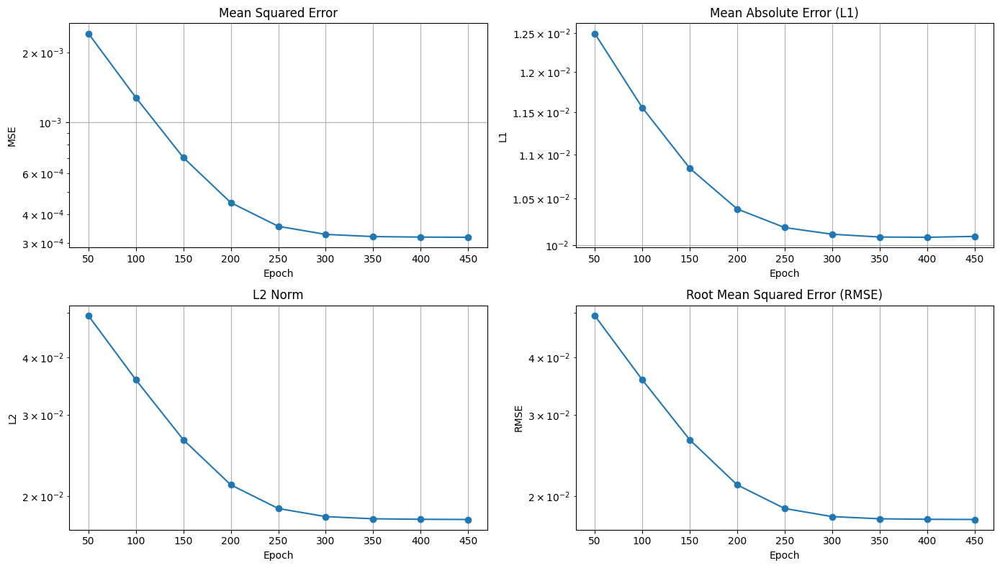

6/6 ━━━━━━━━━━━━━━━━━━━━ 7s 1s/step - loss: 2.9795e-04 - val_loss: 3.1732e-04
Epoch 451/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 3.3110e-04 - val_loss: 3.1717e-04
Epoch 452/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 3.1596e-04 - val_loss: 3.1725e-04
Epoch 453/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - loss: 3.0118e-04 - val_loss: 3.1726e-04
Epoch 454/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 3.0020e-04 - val_loss: 3.1737e-04
Epoch 455/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 3.1033e-04 - val_loss: 3.1745e-04
Epoch 456/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 2.9702e-04 - val_loss: 3.1754e-04
Epoch 457/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 3.0857e-04 - val_loss: 3.1756e-04
Epoch 458/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.8634e-04 - val_loss: 3.1758e-04
Epoch 459/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 3.2345e-04 - val_loss: 3.1766e-04
Epoch 460/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 3.2304e-04 - val

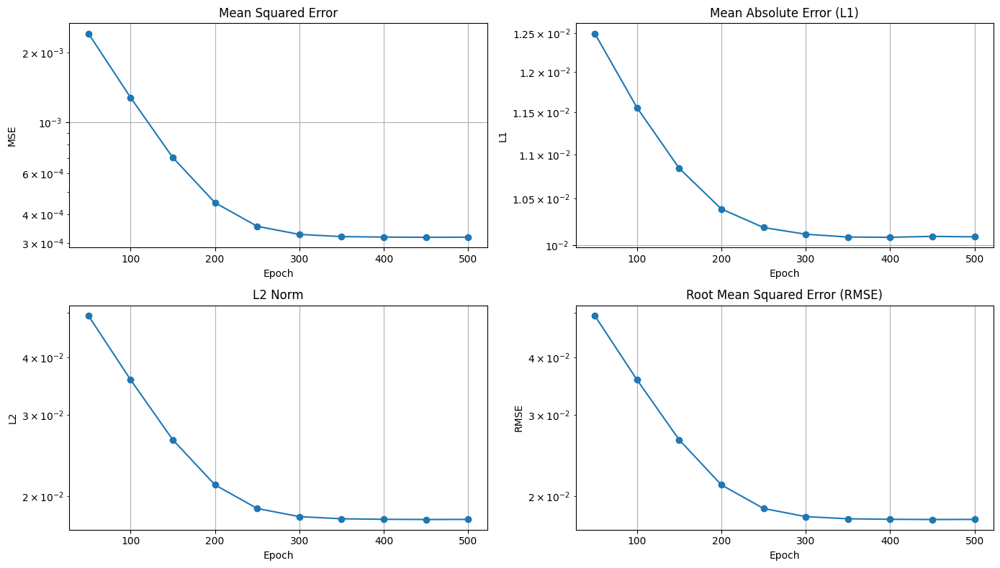

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 527ms/step - loss: 2.9529e-04 - val_loss: 3.1763e-04


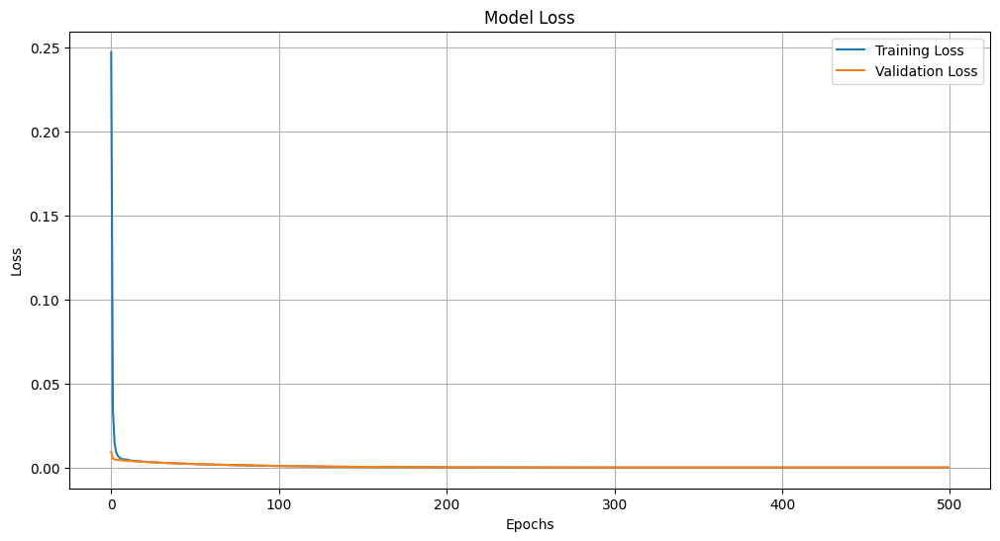

In [55]:
create_modelt1,final_epocht1, final_mset1, final_lt11, final_lt21, final_rmset1, training_timet1,X_testt1,y_testt1=create_model(ruidot1.shape[1], psdst1.shape[1],ruidot1,psdst1)
create_modelt2,final_epocht2, final_mset2, final_lt12, final_lt22, final_rmset2, training_timet2,X_testt2,y_testt2=create_model(ruidot2.shape[1], psdst2.shape[1],ruidot2,psdst2)
create_modelt3,final_epocht3, final_mset3, final_lt13, final_lt23, final_rmset3, training_timet3,X_testt3,y_testt3=create_model(ruidot3.shape[1], psdst3.shape[1],ruidot3,psdst3)
create_modelt4,final_epocht4, final_mset4, final_lt14, final_lt24, final_rmset4, training_timet4,X_testt4,y_testt4=create_model(ruidot4.shape[1], psdst4.shape[1],ruidot4,psdst4)
create_modelt5,final_epocht5, final_mset5, final_lt15, final_lt25, final_rmset5, training_timet5,X_testt5,y_testt5=create_model(ruidot5.shape[1], psdst5.shape[1],ruidot5,psdst5)

In [56]:
plotear_tablas(final_epocht1, final_mset1, final_lt11, final_lt21, final_rmset1, training_timet1)
plotear_tablas(final_epocht2, final_mset2, final_lt12, final_lt22, final_rmset2, training_timet2)
plotear_tablas(final_epocht3, final_mset3, final_lt13, final_lt23, final_rmset3, training_timet3)
plotear_tablas(final_epocht4, final_mset4, final_lt14, final_lt24, final_rmset4, training_timet4)
plotear_tablas(final_epocht5, final_mset5, final_lt15, final_lt25, final_rmset5, training_timet5)


Final Metrics:
Metric     Value     
--------------------
Epoch      500       
MSE        0.0003    
L1         0.0099    
L2         0.0170    
RMSE       0.0170    
Training Time 136.14     seconds

Final Metrics:
Metric     Value     
--------------------
Epoch      500       
MSE        0.0003    
L1         0.0097    
L2         0.0163    
RMSE       0.0163    
Training Time 229.82     seconds

Final Metrics:
Metric     Value     
--------------------
Epoch      500       
MSE        0.0003    
L1         0.0100    
L2         0.0181    
RMSE       0.0181    
Training Time 186.66     seconds

Final Metrics:
Metric     Value     
--------------------
Epoch      500       
MSE        0.0004    
L1         0.0103    
L2         0.0201    
RMSE       0.0201    
Training Time 161.53     seconds

Final Metrics:
Metric     Value     
--------------------
Epoch      500       
MSE        0.0003    
L1         0.0101    
L2         0.0178    
RMSE       0.0178    
Training Time 191.33   

In [57]:
signalM = gensenales(512, f1, f2, f3, am1, am2, am3, Time, wo)
ruidom1 = noise_gaussian(512, 1, 2**3,signalM)
ruidom2 = noise_gaussian(512, 1, 2**4,signalM)
ruidom3 = noise_gaussian(512, 1, 2**5,signalM)
ruidom4 = noise_gaussian(512, 1, 2**6,signalM)
ruidom5 = noise_gaussian(512, 1, 2**7,signalM)
ruidom6 = noise_gaussian(512, 1, 2**8,signalM)

In [58]:
freqsm1, psdsm1 =calcular_welch_arreglo(ruidom1, fs)
freqsm2, psdsm2 =calcular_welch_arreglo(ruidom2, fs)
freqsm3, psdsm3 =calcular_welch_arreglo(ruidom3, fs)
freqsm4, psdsm4 =calcular_welch_arreglo(ruidom4, fs)
freqsm5, psdsm5 =calcular_welch_arreglo(ruidom5, fs)
freqsm6, psdsm6 =calcular_welch_arreglo(ruidom6, fs)

/usr/local/lib/python3.10/dist-packages/scipy/signal/_spectral_py.py:600: UserWarning: nperseg = 1024 is greater than input length  = 512, using nperseg = 512
  freqs, _, Pxy = _spectral_helper(x, y, fs, window, nperseg, noverlap,


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.4872 - val_loss: 0.0892
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step - loss: 0.3623 - val_loss: 0.0570
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - loss: 0.2010 - val_loss: 0.0421
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - loss: 0.2007 - val_loss: 0.0332
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step - loss: 0.1193 - val_loss: 0.0279
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step - loss: 0.0878 - val_loss: 0.0235
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.0633 - val_loss: 0.0201
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - loss: 0.0496 - val_loss: 0.0174
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - loss: 0.0477 - val_loss: 0.0153
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - loss: 0.0379 - val_loss: 0.0135
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - loss: 0.0266 - val_loss: 0.0121
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - loss: 0.0293 - va

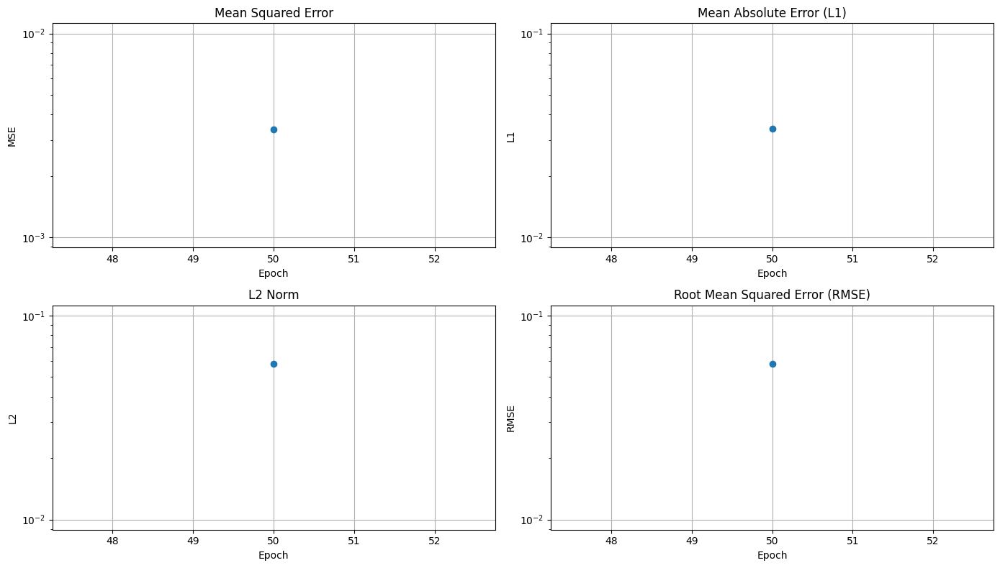

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.0050 - val_loss: 0.0034
Epoch 51/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - loss: 0.0051 - val_loss: 0.0034
Epoch 52/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.0051 - val_loss: 0.0034
Epoch 53/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.0049 - val_loss: 0.0034
Epoch 54/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - loss: 0.0049 - val_loss: 0.0033
Epoch 55/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - loss: 0.0047 - val_loss: 0.0033
Epoch 56/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - loss: 0.0051 - val_loss: 0.0033
Epoch 57/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.0050 - val_loss: 0.0033
Epoch 58/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - loss: 0.0048 - val_loss: 0.0033
Epoch 59/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step - loss: 0.0047 - val_loss: 0.0033
Epoch 60/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.0047 - val_loss: 0.0033
Epoch 61/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step - loss: 0.0047 - val_loss: 

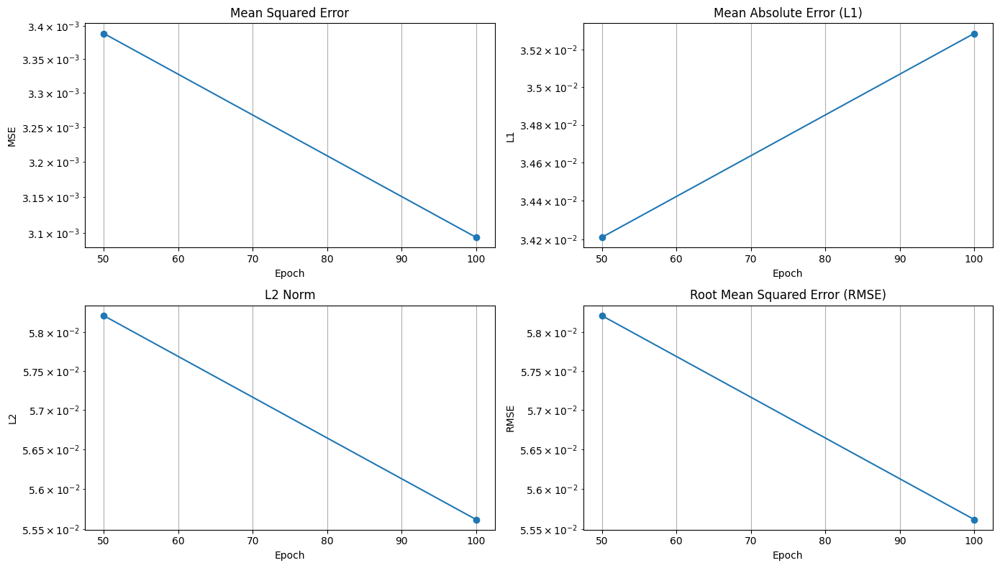

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.0041 - val_loss: 0.0031
Epoch 101/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - loss: 0.0041 - val_loss: 0.0031
Epoch 102/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - loss: 0.0041 - val_loss: 0.0031
Epoch 103/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step - loss: 0.0040 - val_loss: 0.0031
Epoch 104/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - loss: 0.0040 - val_loss: 0.0031
Epoch 105/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - loss: 0.0039 - val_loss: 0.0031
Epoch 106/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - loss: 0.0040 - val_loss: 0.0031
Epoch 107/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - loss: 0.0039 - val_loss: 0.0031
Epoch 108/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step - loss: 0.0040 - val_loss: 0.0031
Epoch 109/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - loss: 0.0039 - val_loss: 0.0031
Epoch 110/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step - loss: 0.0038 - val_loss: 0.0031
Epoch 111/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - loss: 0.00

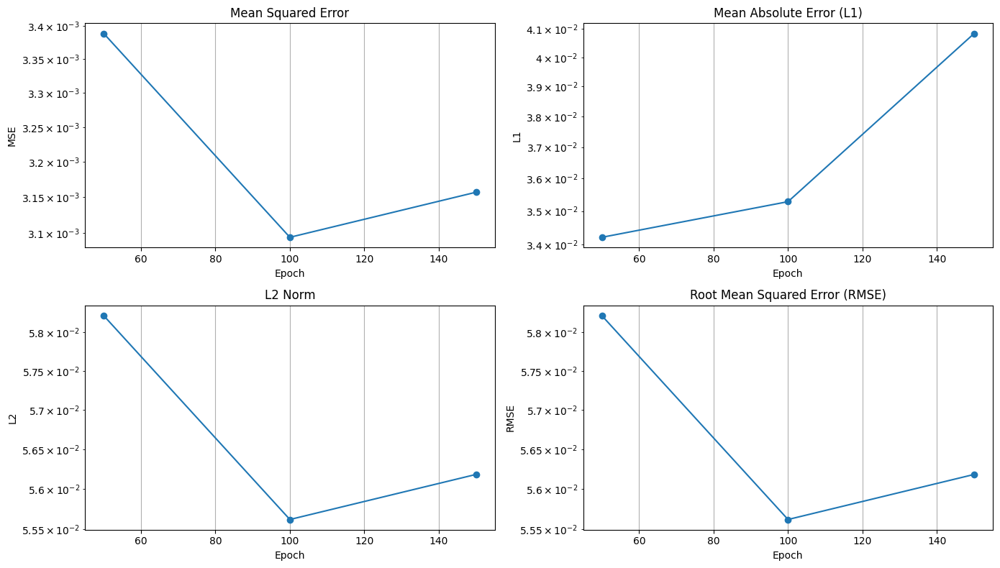

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.0031 - val_loss: 0.0032
Epoch 151/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.0032 - val_loss: 0.0032
Epoch 152/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step - loss: 0.0032 - val_loss: 0.0032
Epoch 153/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step - loss: 0.0032 - val_loss: 0.0032
Epoch 154/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0032 - val_loss: 0.0032
Epoch 155/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.0031 - val_loss: 0.0032
Epoch 156/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - loss: 0.0030 - val_loss: 0.0032
Epoch 157/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - loss: 0.0029 - val_loss: 0.0032
Epoch 158/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - loss: 0.0031 - val_loss: 0.0032
Epoch 159/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - loss: 0.0030 - val_loss: 0.0033
Epoch 160/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - loss: 0.0030 - val_loss: 0.0033
Epoch 161/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step - loss: 0.0030 -

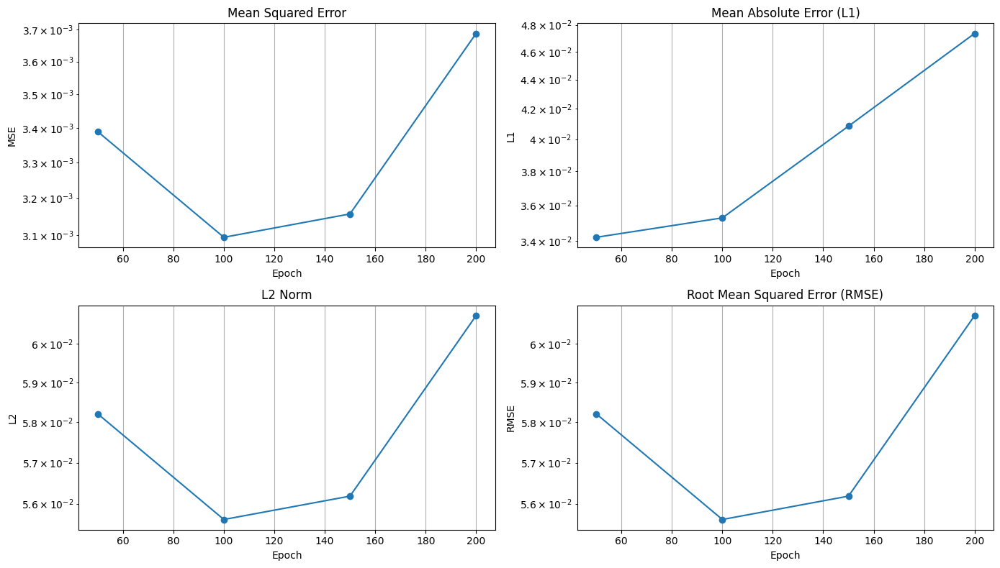

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.0020 - val_loss: 0.0037
Epoch 201/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step - loss: 0.0021 - val_loss: 0.0037
Epoch 202/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0018 - val_loss: 0.0038
Epoch 203/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step - loss: 0.0021 - val_loss: 0.0038
Epoch 204/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0020 - val_loss: 0.0038
Epoch 205/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0018 - val_loss: 0.0038
Epoch 206/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - loss: 0.0015 - val_loss: 0.0038
Epoch 207/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.0022 - val_loss: 0.0038
Epoch 208/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - loss: 0.0017 - val_loss: 0.0038
Epoch 209/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - loss: 0.0019 - val_loss: 0.0038
Epoch 210/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step - loss: 0.0017 - val_loss: 0.0038
Epoch 211/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - loss: 0.0020 

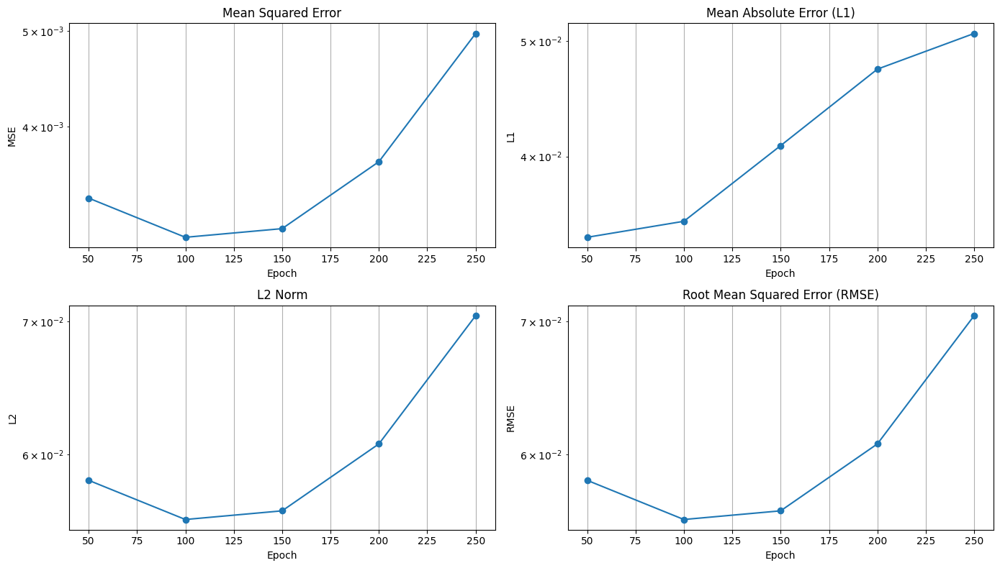

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 8.1242e-04 - val_loss: 0.0050
Epoch 251/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 9.5925e-04 - val_loss: 0.0050
Epoch 252/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step - loss: 9.4087e-04 - val_loss: 0.0050
Epoch 253/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - loss: 0.0014 - val_loss: 0.0050
Epoch 254/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - loss: 6.9847e-04 - val_loss: 0.0050
Epoch 255/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step - loss: 0.0010 - val_loss: 0.0051
Epoch 256/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - loss: 0.0011 - val_loss: 0.0051
Epoch 257/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step - loss: 9.9596e-04 - val_loss: 0.0052
Epoch 258/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step - loss: 0.0011 - val_loss: 0.0052
Epoch 259/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step - loss: 9.8861e-04 - val_loss: 0.0053
Epoch 260/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0011 - val_loss: 0.0053
Epoch 261/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 1

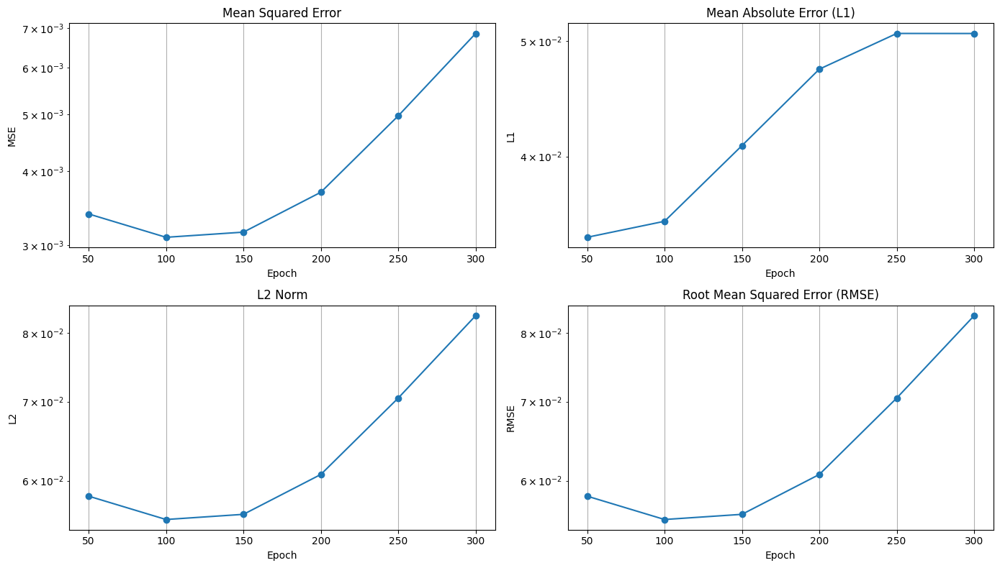

1/1 ━━━━━━━━━━━━━━━━━━━━ 21s 21s/step - loss: 5.9898e-04 - val_loss: 0.0069
Epoch 301/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 20s 20s/step - loss: 4.7378e-04 - val_loss: 0.0068
Epoch 302/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step - loss: 7.2493e-04 - val_loss: 0.0068
Epoch 303/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - loss: 7.2789e-04 - val_loss: 0.0068
Epoch 304/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 7.4536e-04 - val_loss: 0.0069
Epoch 305/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step - loss: 6.6931e-04 - val_loss: 0.0069
Epoch 306/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 5.5842e-04 - val_loss: 0.0069
Epoch 307/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - loss: 9.2147e-04 - val_loss: 0.0069
Epoch 308/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step - loss: 4.8471e-04 - val_loss: 0.0070
Epoch 309/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - loss: 6.0463e-04 - val_loss: 0.0070
Epoch 310/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step - loss: 8.9294e-04 - val_loss: 0.0071
Epoch 311/500
1/

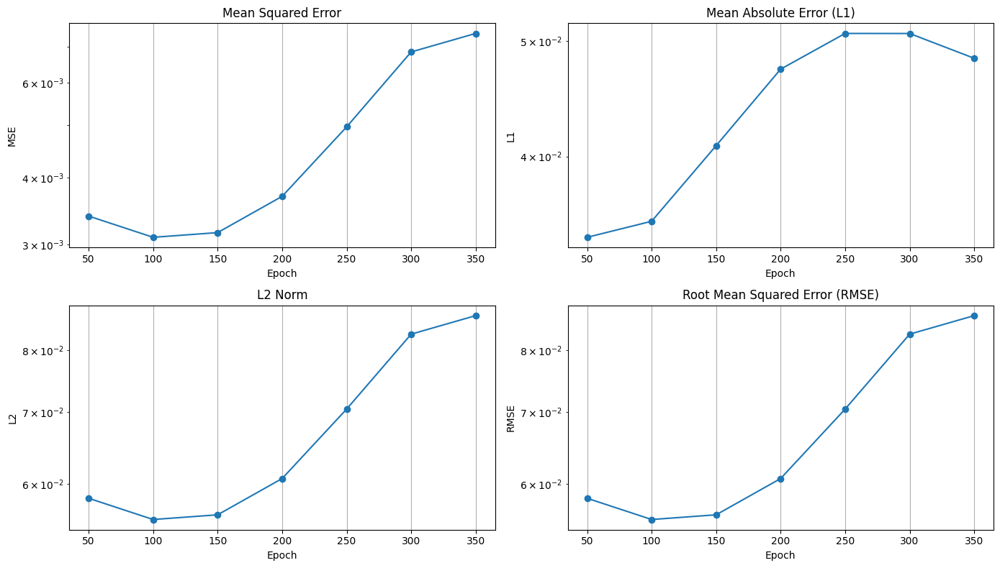

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 4.8201e-04 - val_loss: 0.0074
Epoch 351/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step - loss: 4.7500e-04 - val_loss: 0.0073
Epoch 352/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step - loss: 7.8242e-04 - val_loss: 0.0072
Epoch 353/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step - loss: 6.9585e-04 - val_loss: 0.0071
Epoch 354/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - loss: 7.9714e-04 - val_loss: 0.0071
Epoch 355/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - loss: 6.4903e-04 - val_loss: 0.0071
Epoch 356/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - loss: 5.9074e-04 - val_loss: 0.0070
Epoch 357/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step - loss: 4.4418e-04 - val_loss: 0.0071
Epoch 358/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step - loss: 5.4535e-04 - val_loss: 0.0071
Epoch 359/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - loss: 0.0011 - val_loss: 0.0071
Epoch 360/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step - loss: 4.6865e-04 - val_loss: 0.0072
Epoch 361/500
1/1 ━━━━━━━━━

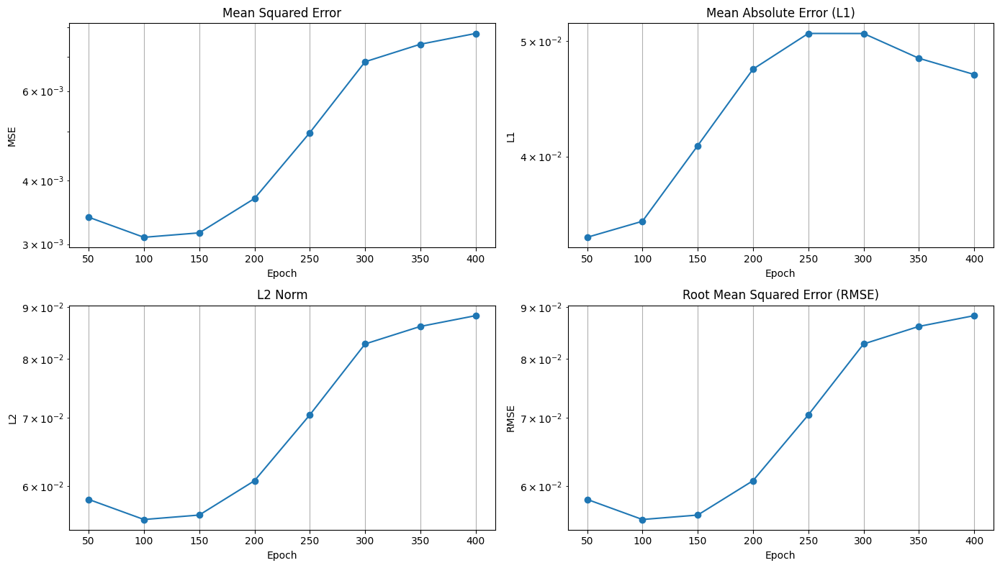

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 4.7506e-04 - val_loss: 0.0078
Epoch 401/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step - loss: 6.1941e-04 - val_loss: 0.0078
Epoch 402/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - loss: 5.1095e-04 - val_loss: 0.0078
Epoch 403/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step - loss: 4.1530e-04 - val_loss: 0.0078
Epoch 404/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step - loss: 6.8090e-04 - val_loss: 0.0078
Epoch 405/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - loss: 3.9877e-04 - val_loss: 0.0079
Epoch 406/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step - loss: 5.1871e-04 - val_loss: 0.0079
Epoch 407/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step - loss: 5.4013e-04 - val_loss: 0.0079
Epoch 408/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step - loss: 4.4119e-04 - val_loss: 0.0080
Epoch 409/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step - loss: 3.3072e-04 - val_loss: 0.0080
Epoch 410/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step - loss: 5.5661e-04 - val_loss: 0.0081
Epoch 411/500
1/1 ━

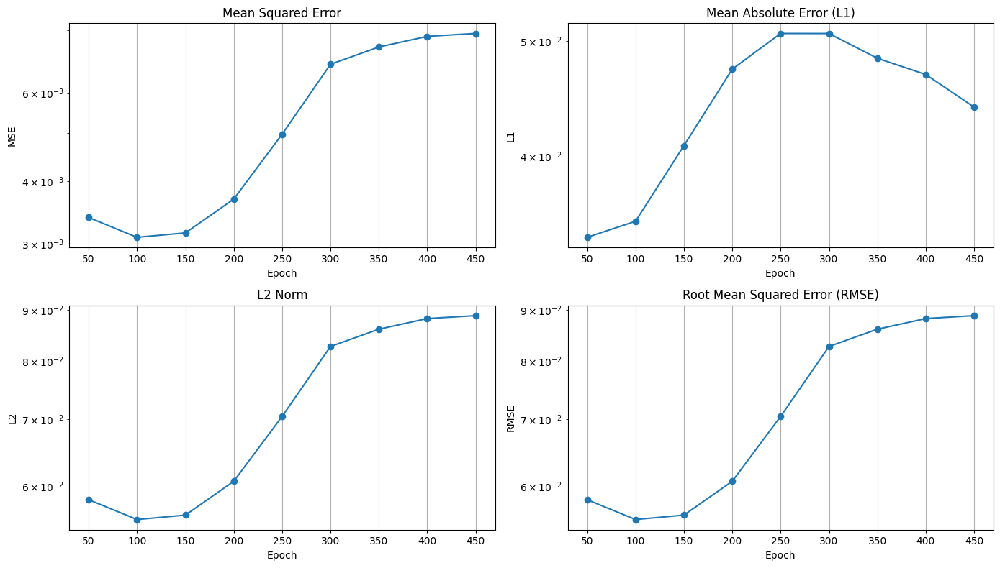

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 3.0796e-04 - val_loss: 0.0079
Epoch 451/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step - loss: 6.0258e-04 - val_loss: 0.0079
Epoch 452/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step - loss: 3.8385e-04 - val_loss: 0.0080
Epoch 453/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - loss: 6.5559e-04 - val_loss: 0.0081
Epoch 454/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step - loss: 4.5262e-04 - val_loss: 0.0081
Epoch 455/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step - loss: 4.4357e-04 - val_loss: 0.0082
Epoch 456/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - loss: 3.4509e-04 - val_loss: 0.0083
Epoch 457/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step - loss: 6.3754e-04 - val_loss: 0.0083
Epoch 458/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step - loss: 3.1373e-04 - val_loss: 0.0084
Epoch 459/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - loss: 4.1694e-04 - val_loss: 0.0084
Epoch 460/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - loss: 3.1438e-04 - val_loss: 0.0085
Epoch 461/500
1/1 ━

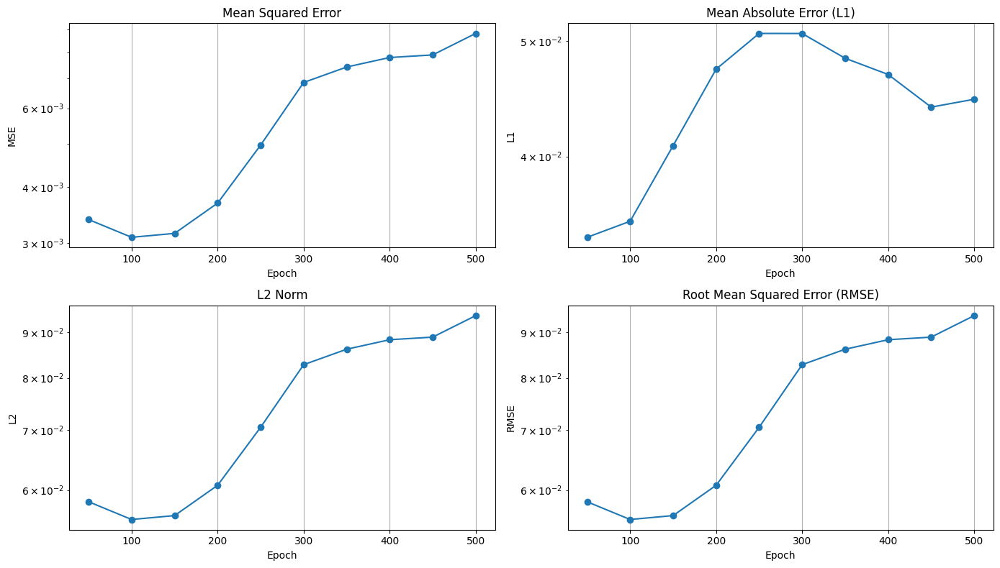

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 3.0179e-04 - val_loss: 0.0088


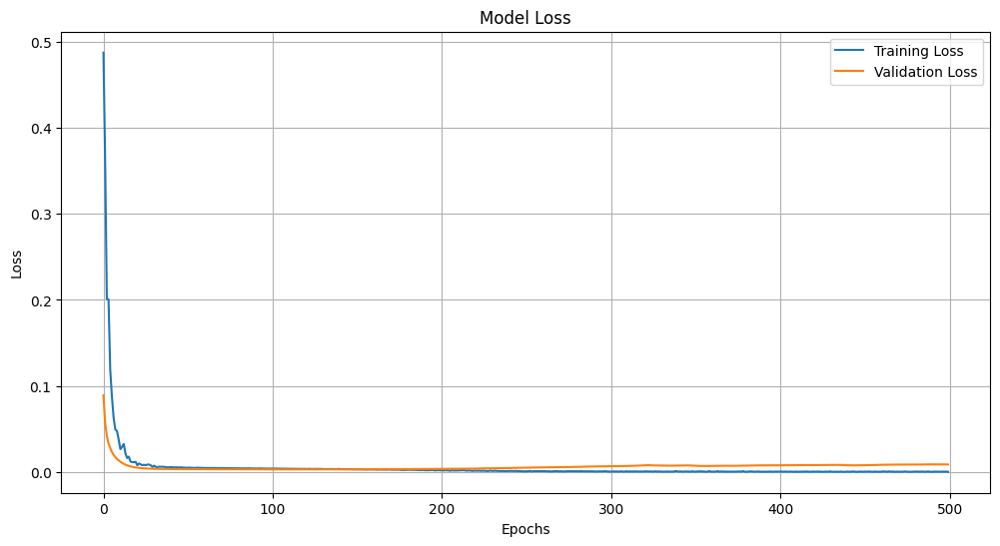

Epoch 1/500


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.5190 - val_loss: 0.0663
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step - loss: 0.2619 - val_loss: 0.0373
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - loss: 0.1367 - val_loss: 0.0260
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - loss: 0.0835 - val_loss: 0.0202
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - loss: 0.0548 - val_loss: 0.0166
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step - loss: 0.0532 - val_loss: 0.0138
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step - loss: 0.0295 - val_loss: 0.0116
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - loss: 0.0282 - val_loss: 0.0098
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step - loss: 0.0238 - val_loss: 0.0085
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step - loss: 0.0232 - val_loss: 0.0075
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - loss: 0.0215 - val_loss: 0.0067
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - loss: 0.0172 - val_loss: 0.

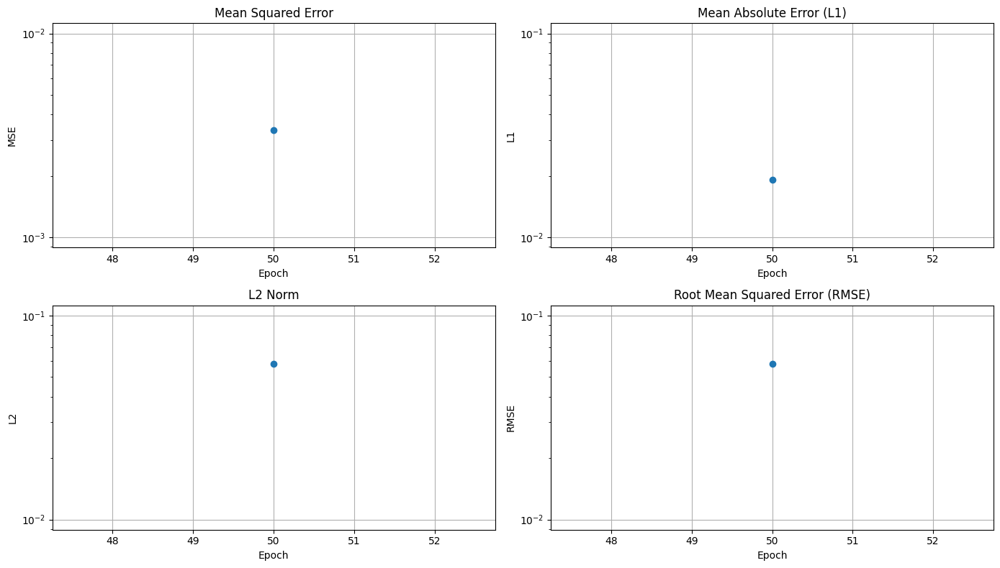

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.0043 - val_loss: 0.0034
Epoch 51/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step - loss: 0.0043 - val_loss: 0.0033
Epoch 52/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step - loss: 0.0043 - val_loss: 0.0033
Epoch 53/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step - loss: 0.0041 - val_loss: 0.0033
Epoch 54/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - loss: 0.0041 - val_loss: 0.0033
Epoch 55/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step - loss: 0.0043 - val_loss: 0.0033
Epoch 56/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.0039 - val_loss: 0.0033
Epoch 57/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step - loss: 0.0040 - val_loss: 0.0033
Epoch 58/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - loss: 0.0040 - val_loss: 0.0032
Epoch 59/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - loss: 0.0039 - val_loss: 0.0032
Epoch 60/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step - loss: 0.0040 - val_loss: 0.0032
Epoch 61/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step - loss: 0.0040 - val_lo

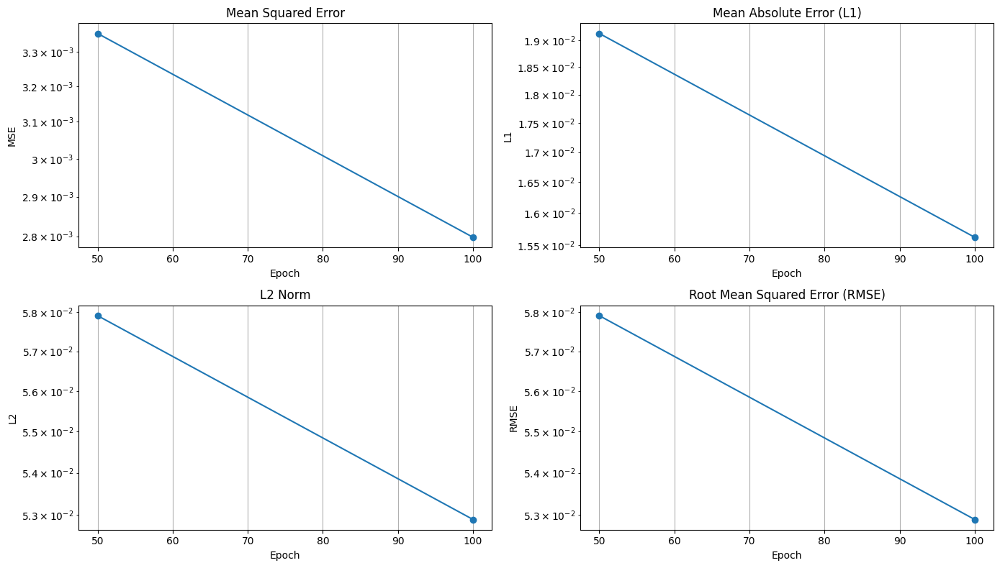

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.0034 - val_loss: 0.0028
Epoch 101/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 984ms/step - loss: 0.0034 - val_loss: 0.0028
Epoch 102/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step - loss: 0.0033 - val_loss: 0.0028
Epoch 103/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step - loss: 0.0034 - val_loss: 0.0028
Epoch 104/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - loss: 0.0033 - val_loss: 0.0028
Epoch 105/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step - loss: 0.0033 - val_loss: 0.0028
Epoch 106/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step - loss: 0.0033 - val_loss: 0.0027
Epoch 107/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - loss: 0.0033 - val_loss: 0.0027
Epoch 108/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - loss: 0.0033 - val_loss: 0.0027
Epoch 109/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step - loss: 0.0033 - val_loss: 0.0027
Epoch 110/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step - loss: 0.0032 - val_loss: 0.0027
Epoch 111/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step - loss: 0

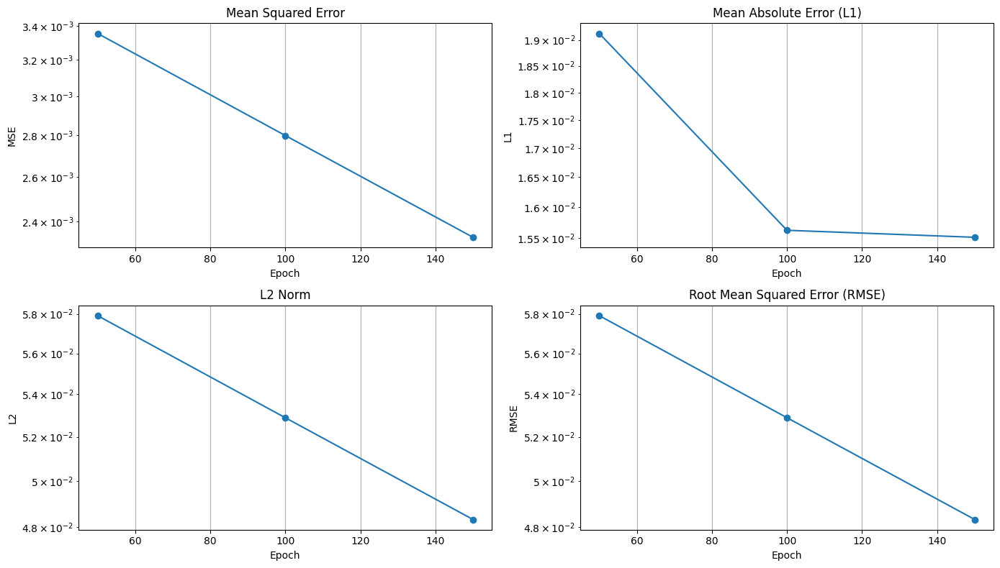

1/1 ━━━━━━━━━━━━━━━━━━━━ 14s 14s/step - loss: 0.0028 - val_loss: 0.0023
Epoch 151/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step - loss: 0.0028 - val_loss: 0.0023
Epoch 152/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step - loss: 0.0027 - val_loss: 0.0023
Epoch 153/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step - loss: 0.0027 - val_loss: 0.0023
Epoch 154/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.0026 - val_loss: 0.0022
Epoch 155/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step - loss: 0.0026 - val_loss: 0.0022
Epoch 156/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - loss: 0.0026 - val_loss: 0.0022
Epoch 157/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step - loss: 0.0026 - val_loss: 0.0021
Epoch 158/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - loss: 0.0026 - val_loss: 0.0021
Epoch 159/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - loss: 0.0026 - val_loss: 0.0021
Epoch 160/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - loss: 0.0026 - val_loss: 0.0021
Epoch 161/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - loss: 0.

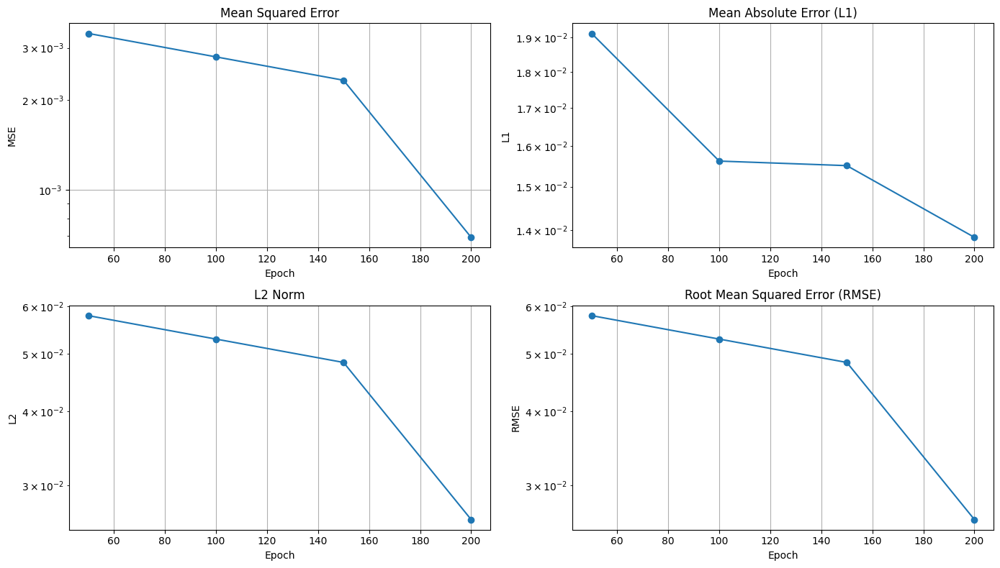

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.0015 - val_loss: 6.9163e-04
Epoch 201/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - loss: 0.0010 - val_loss: 6.7195e-04
Epoch 202/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step - loss: 0.0017 - val_loss: 6.5281e-04
Epoch 203/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - loss: 9.8120e-04 - val_loss: 6.3438e-04
Epoch 204/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - loss: 6.2087e-04 - val_loss: 6.1684e-04
Epoch 205/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step - loss: 0.0012 - val_loss: 6.0054e-04
Epoch 206/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - loss: 9.0856e-04 - val_loss: 5.8751e-04
Epoch 207/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.0015 - val_loss: 5.7588e-04
Epoch 208/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - loss: 0.0010 - val_loss: 5.6562e-04
Epoch 209/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.0013 - val_loss: 5.5658e-04
Epoch 210/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step - loss: 0.0014 - val_loss: 5.4721e-04
Epoch

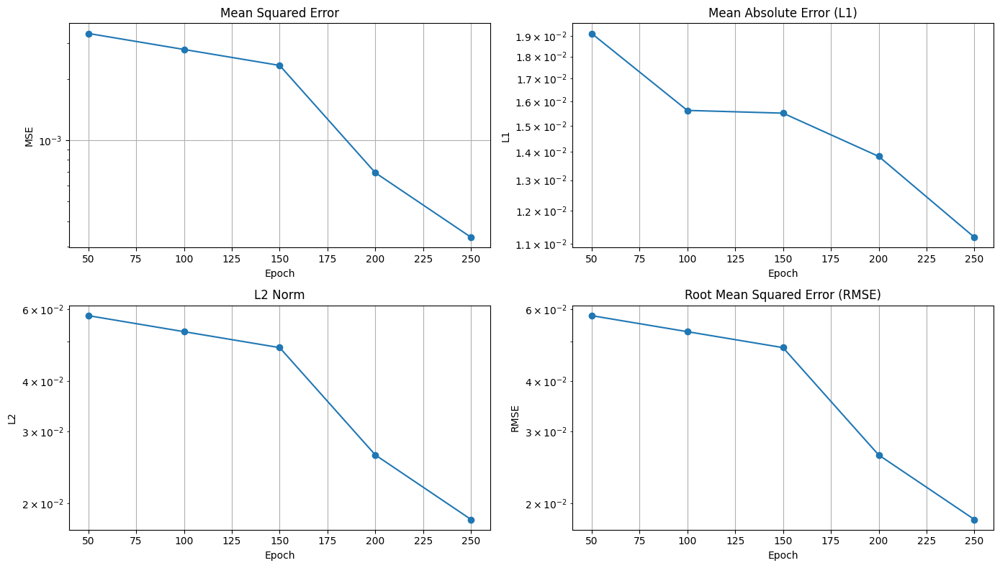

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.0012 - val_loss: 3.3297e-04
Epoch 251/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 725ms/step - loss: 0.0011 - val_loss: 3.3119e-04
Epoch 252/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step - loss: 0.0011 - val_loss: 3.2875e-04
Epoch 253/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step - loss: 0.0012 - val_loss: 3.2624e-04
Epoch 254/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step - loss: 0.0010 - val_loss: 3.2337e-04
Epoch 255/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - loss: 0.0013 - val_loss: 3.2052e-04
Epoch 256/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step - loss: 0.0011 - val_loss: 3.1789e-04
Epoch 257/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step - loss: 7.6787e-04 - val_loss: 3.1586e-04
Epoch 258/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step - loss: 5.3673e-04 - val_loss: 3.1432e-04
Epoch 259/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - loss: 9.0392e-04 - val_loss: 3.1323e-04
Epoch 260/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step - loss: 0.0015 - val_loss: 3.1236e-04
Epoc

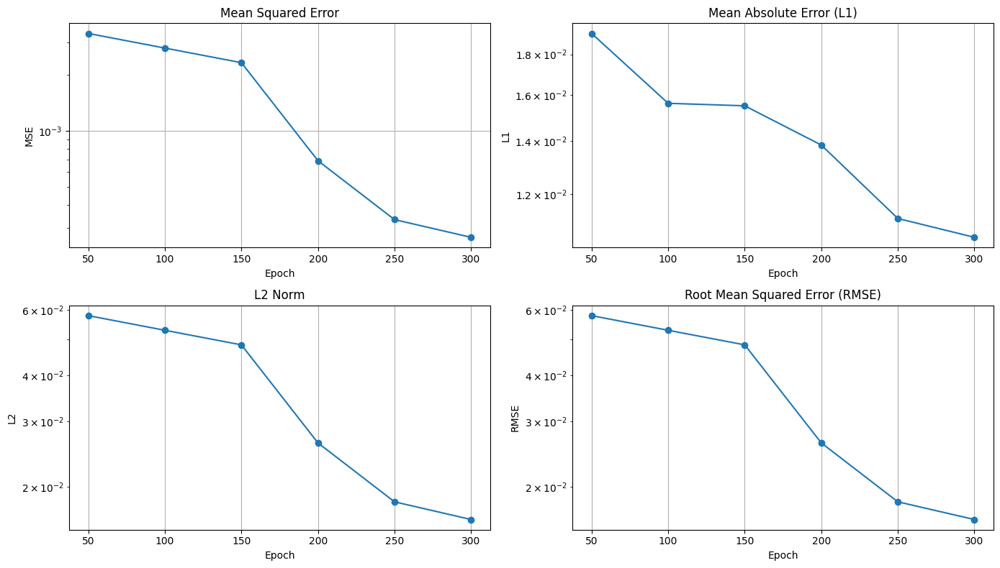

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 8.5621e-04 - val_loss: 2.6738e-04
Epoch 301/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step - loss: 0.0012 - val_loss: 2.6709e-04
Epoch 302/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step - loss: 0.0010 - val_loss: 2.6638e-04
Epoch 303/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step - loss: 9.9148e-04 - val_loss: 2.6599e-04
Epoch 304/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - loss: 0.0012 - val_loss: 2.6596e-04
Epoch 305/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step - loss: 9.1470e-04 - val_loss: 2.6602e-04
Epoch 306/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - loss: 6.2652e-04 - val_loss: 2.6635e-04
Epoch 307/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step - loss: 6.4938e-04 - val_loss: 2.6673e-04
Epoch 308/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - loss: 0.0010 - val_loss: 2.6749e-04
Epoch 309/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step - loss: 6.1889e-04 - val_loss: 2.6803e-04
Epoch 310/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - loss: 5.8572e-04 - val_loss: 2

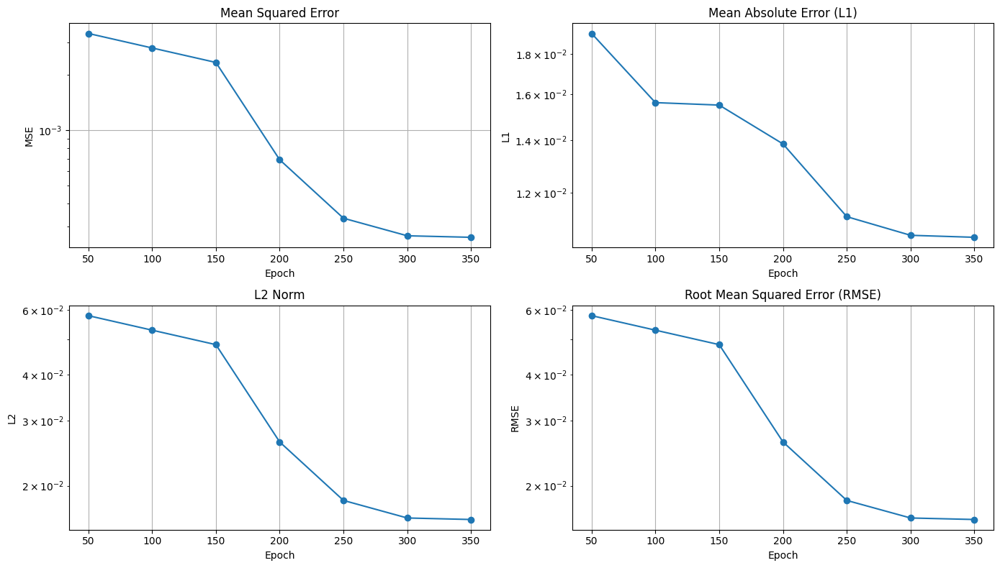

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 7.3940e-04 - val_loss: 2.6236e-04
Epoch 351/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step - loss: 7.3416e-04 - val_loss: 2.6259e-04
Epoch 352/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step - loss: 8.9092e-04 - val_loss: 2.6279e-04
Epoch 353/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step - loss: 7.6215e-04 - val_loss: 2.6320e-04
Epoch 354/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step - loss: 6.1664e-04 - val_loss: 2.6357e-04
Epoch 355/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - loss: 3.4688e-04 - val_loss: 2.6378e-04
Epoch 356/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step - loss: 7.8474e-04 - val_loss: 2.6408e-04
Epoch 357/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - loss: 7.3072e-04 - val_loss: 2.6421e-04
Epoch 358/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step - loss: 9.5061e-04 - val_loss: 2.6419e-04
Epoch 359/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step - loss: 5.3049e-04 - val_loss: 2.6394e-04
Epoch 360/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - loss: 7.6254e-0

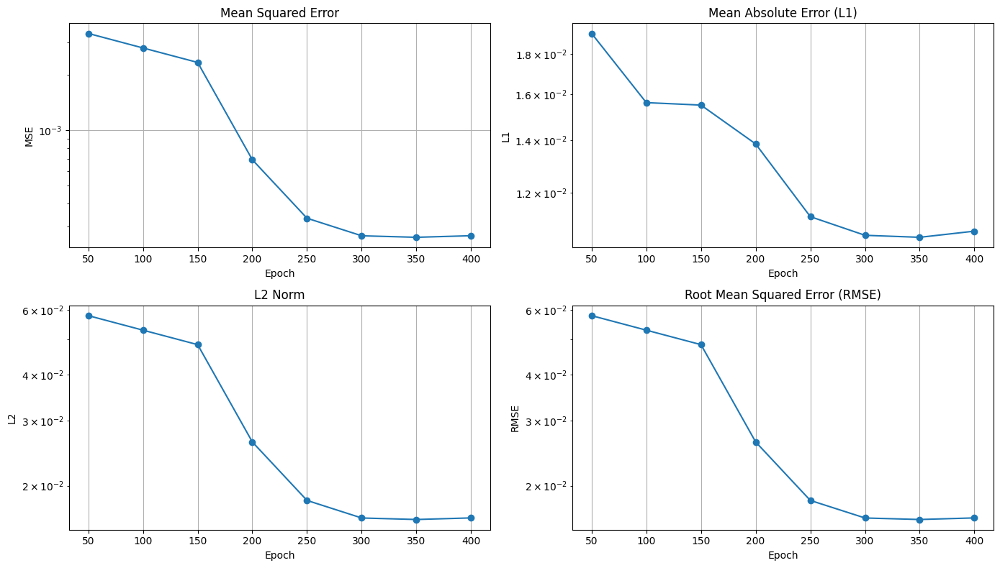

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 5.4399e-04 - val_loss: 2.6765e-04
Epoch 401/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step - loss: 6.9305e-04 - val_loss: 2.6773e-04
Epoch 402/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - loss: 7.1897e-04 - val_loss: 2.6762e-04
Epoch 403/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - loss: 6.6731e-04 - val_loss: 2.6767e-04
Epoch 404/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - loss: 4.4706e-04 - val_loss: 2.6775e-04
Epoch 405/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 9.0080e-04 - val_loss: 2.6733e-04
Epoch 406/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step - loss: 0.0012 - val_loss: 2.6708e-04
Epoch 407/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - loss: 6.8104e-04 - val_loss: 2.6719e-04
Epoch 408/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - loss: 8.8158e-04 - val_loss: 2.6738e-04
Epoch 409/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step - loss: 0.0012 - val_loss: 2.6750e-04
Epoch 410/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step - loss: 9.9049e-04 - val

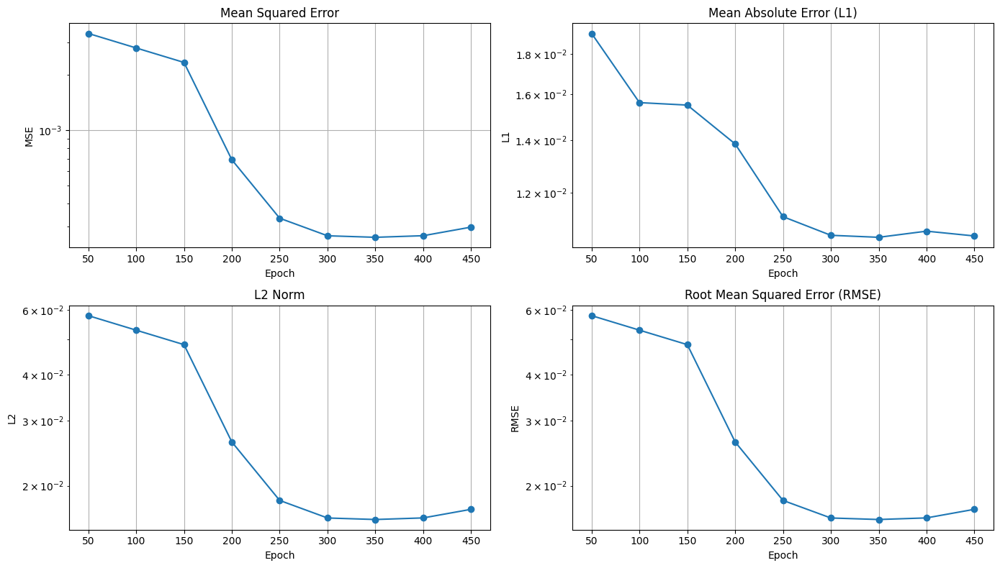

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.0016 - val_loss: 2.9798e-04
Epoch 451/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step - loss: 8.3714e-04 - val_loss: 3.0024e-04
Epoch 452/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - loss: 5.4457e-04 - val_loss: 3.0244e-04
Epoch 453/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step - loss: 4.8749e-04 - val_loss: 3.0430e-04
Epoch 454/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - loss: 6.8218e-04 - val_loss: 3.0586e-04
Epoch 455/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - loss: 2.9121e-04 - val_loss: 3.0730e-04
Epoch 456/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - loss: 3.9958e-04 - val_loss: 3.0835e-04
Epoch 457/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step - loss: 3.9875e-04 - val_loss: 3.0913e-04
Epoch 458/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step - loss: 0.0011 - val_loss: 3.0981e-04
Epoch 459/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step - loss: 5.0069e-04 - val_loss: 3.1022e-04
Epoch 460/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step - loss: 0.0012 - val_loss

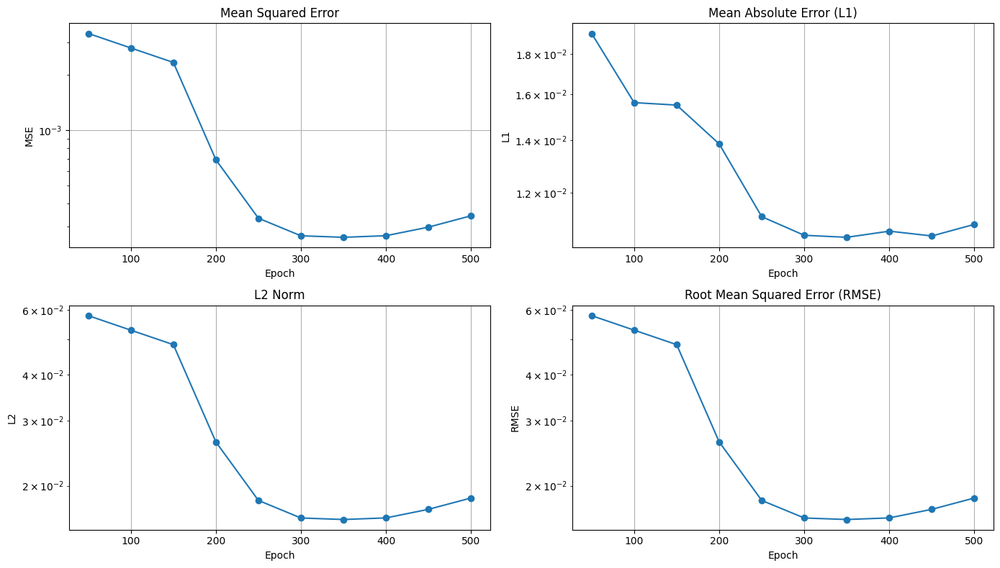

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 4.8155e-04 - val_loss: 3.4334e-04


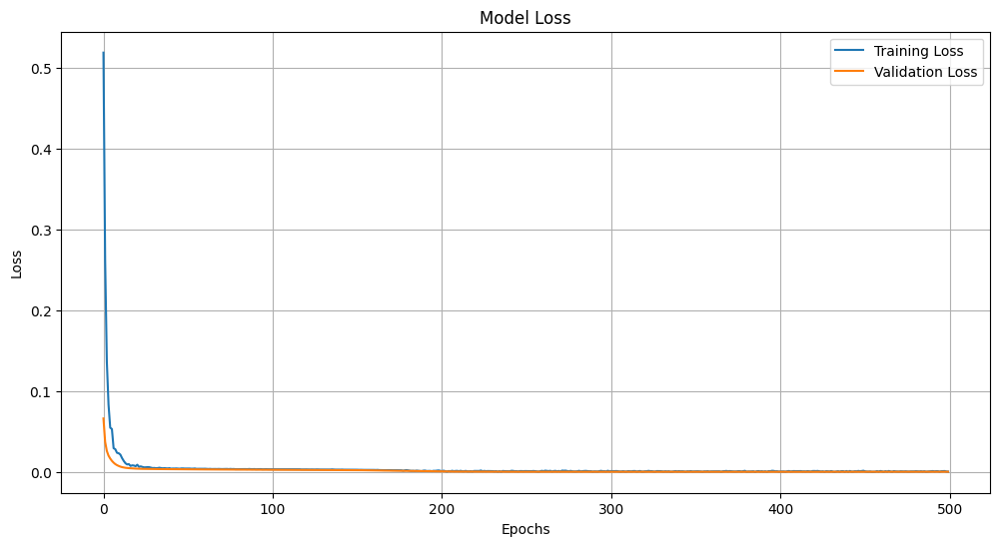

Epoch 1/500


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 187ms/step - loss: 0.6593 - val_loss: 0.0558
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 0.1985 - val_loss: 0.0248
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - loss: 0.0941 - val_loss: 0.0145
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 0.0533 - val_loss: 0.0100
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 0.0413 - val_loss: 0.0076
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 0.0301 - val_loss: 0.0064
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - loss: 0.0186 - val_loss: 0.0057
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - loss: 0.0191 - val_loss: 0.0053
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - loss: 0.0163 - val_loss: 0.0050
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - loss: 0.0115 - val_loss: 0.0047
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 0.0105 - val_loss: 0.0046
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.0084 - val_loss: 0.0045


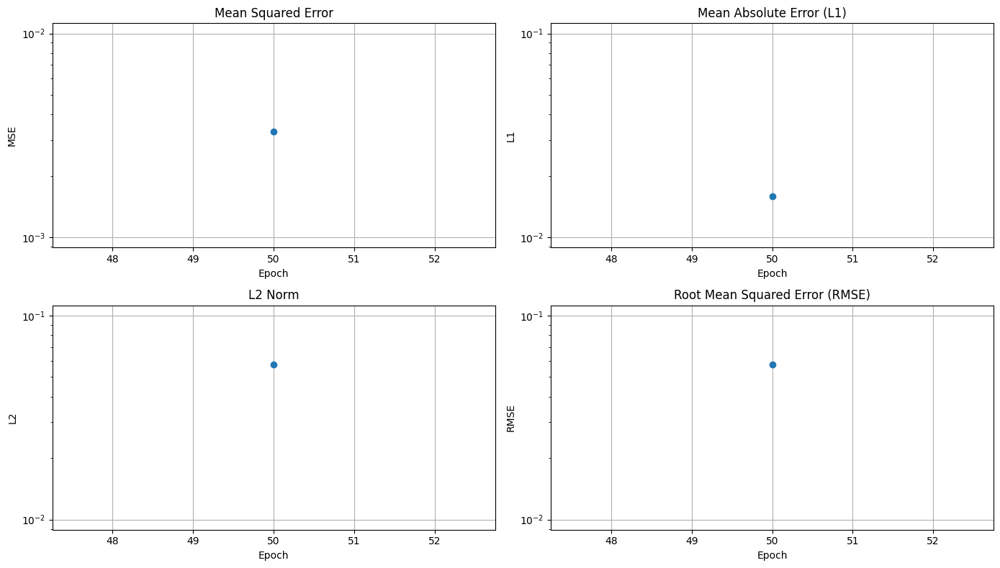

2/2 ━━━━━━━━━━━━━━━━━━━━ 11s 11s/step - loss: 0.0041 - val_loss: 0.0033
Epoch 51/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 9s 76ms/step - loss: 0.0042 - val_loss: 0.0033
Epoch 52/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0041 - val_loss: 0.0033
Epoch 53/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - loss: 0.0043 - val_loss: 0.0032
Epoch 54/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - loss: 0.0041 - val_loss: 0.0032
Epoch 55/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - loss: 0.0040 - val_loss: 0.0032
Epoch 56/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - loss: 0.0042 - val_loss: 0.0032
Epoch 57/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - loss: 0.0041 - val_loss: 0.0032
Epoch 58/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - loss: 0.0040 - val_loss: 0.0032
Epoch 59/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - loss: 0.0038 - val_loss: 0.0031
Epoch 60/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - loss: 0.0040 - val_loss: 0.0031
Epoch 61/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - loss: 0.0039 - val_loss: 

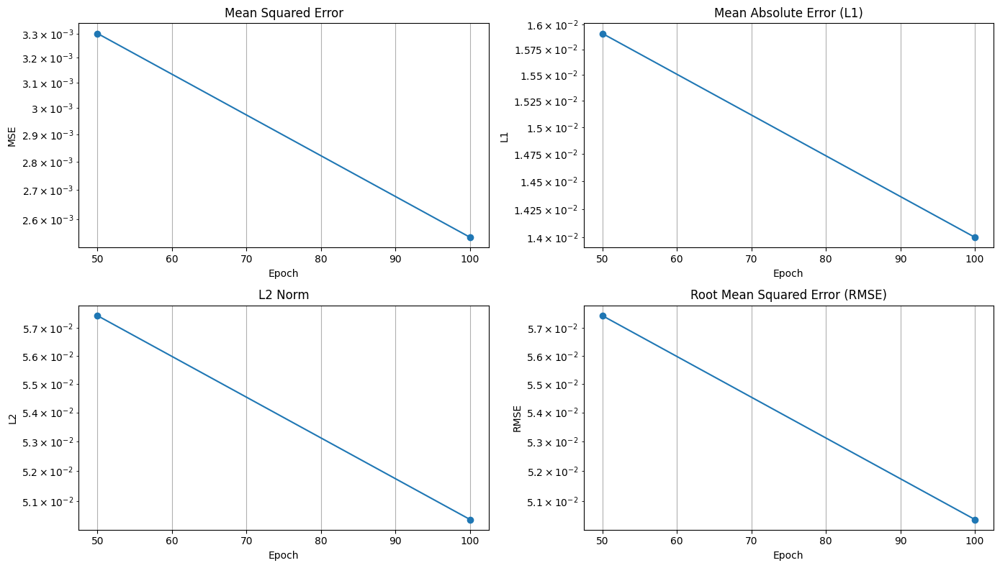

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.0033 - val_loss: 0.0025
Epoch 101/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step - loss: 0.0031 - val_loss: 0.0025
Epoch 102/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - loss: 0.0031 - val_loss: 0.0025
Epoch 103/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - loss: 0.0032 - val_loss: 0.0025
Epoch 104/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - loss: 0.0030 - val_loss: 0.0025
Epoch 105/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0030 - val_loss: 0.0025
Epoch 106/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step - loss: 0.0032 - val_loss: 0.0025
Epoch 107/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - loss: 0.0030 - val_loss: 0.0025
Epoch 108/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - loss: 0.0029 - val_loss: 0.0024
Epoch 109/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.0030 - val_loss: 0.0024
Epoch 110/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.0030 - val_loss: 0.0024
Epoch 111/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - loss: 0.0031 - v

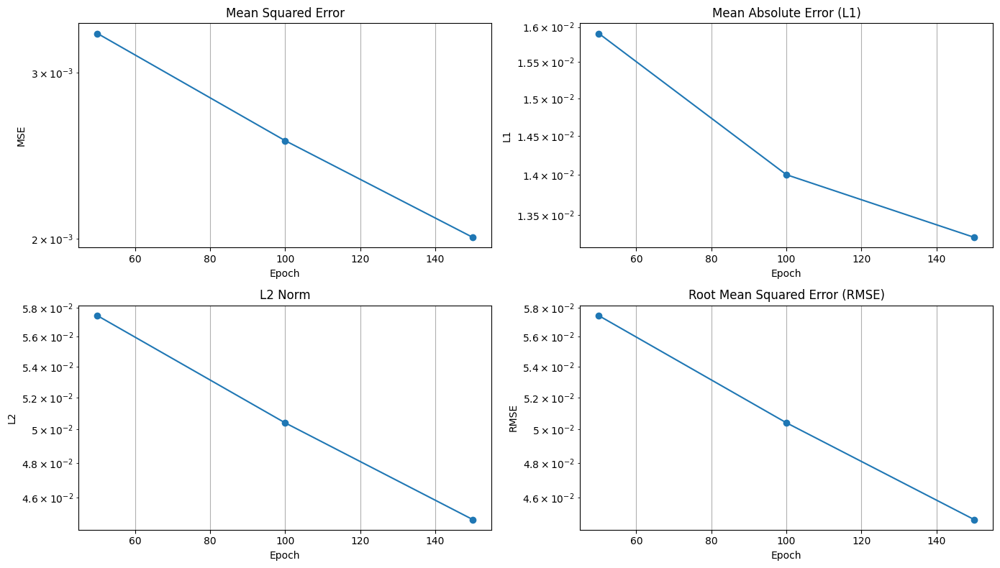

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.0025 - val_loss: 0.0020
Epoch 151/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step - loss: 0.0025 - val_loss: 0.0020
Epoch 152/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step - loss: 0.0025 - val_loss: 0.0020
Epoch 153/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step - loss: 0.0025 - val_loss: 0.0020
Epoch 154/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0025 - val_loss: 0.0020
Epoch 155/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step - loss: 0.0025 - val_loss: 0.0020
Epoch 156/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step - loss: 0.0025 - val_loss: 0.0020
Epoch 157/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - loss: 0.0026 - val_loss: 0.0019
Epoch 158/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - loss: 0.0025 - val_loss: 0.0019
Epoch 159/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.0024 - val_loss: 0.0019
Epoch 160/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - loss: 0.0024 - val_loss: 0.0019
Epoch 161/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - loss: 0.0025 -

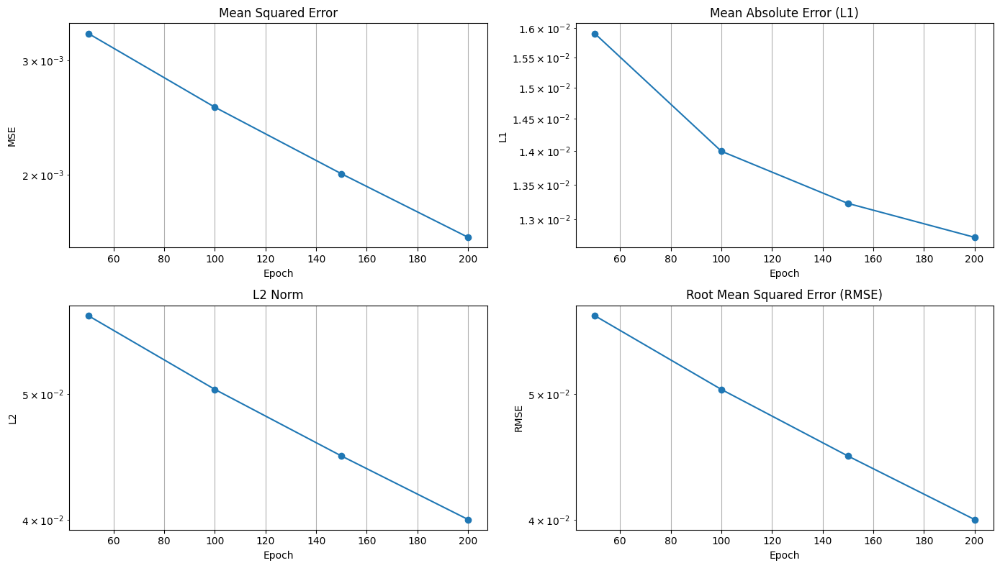

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.0020 - val_loss: 0.0016
Epoch 201/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 54ms/step - loss: 0.0020 - val_loss: 0.0016
Epoch 202/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - loss: 0.0020 - val_loss: 0.0016
Epoch 203/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 0.0020 - val_loss: 0.0016
Epoch 204/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - loss: 0.0020 - val_loss: 0.0016
Epoch 205/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - loss: 0.0020 - val_loss: 0.0016
Epoch 206/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step - loss: 0.0020 - val_loss: 0.0016
Epoch 207/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - loss: 0.0020 - val_loss: 0.0016
Epoch 208/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - loss: 0.0019 - val_loss: 0.0015
Epoch 209/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - loss: 0.0019 - val_loss: 0.0015
Epoch 210/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.0020 - val_loss: 0.0015
Epoch 211/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - loss: 0.0019 - v

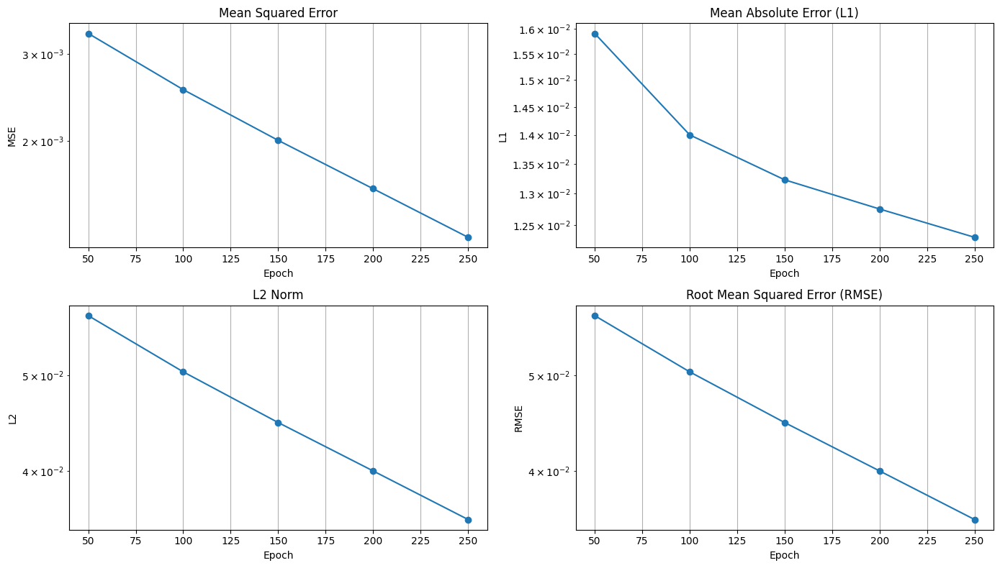

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.0015 - val_loss: 0.0013
Epoch 251/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.0016 - val_loss: 0.0013
Epoch 252/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - loss: 0.0016 - val_loss: 0.0013
Epoch 253/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 0.0016 - val_loss: 0.0013
Epoch 254/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - loss: 0.0016 - val_loss: 0.0013
Epoch 255/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step - loss: 0.0016 - val_loss: 0.0012
Epoch 256/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - loss: 0.0016 - val_loss: 0.0012
Epoch 257/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - loss: 0.0015 - val_loss: 0.0012
Epoch 258/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - loss: 0.0015 - val_loss: 0.0012
Epoch 259/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - loss: 0.0015 - val_loss: 0.0012
Epoch 260/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - loss: 0.0015 - val_loss: 0.0012
Epoch 261/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - loss: 0.0015 - v

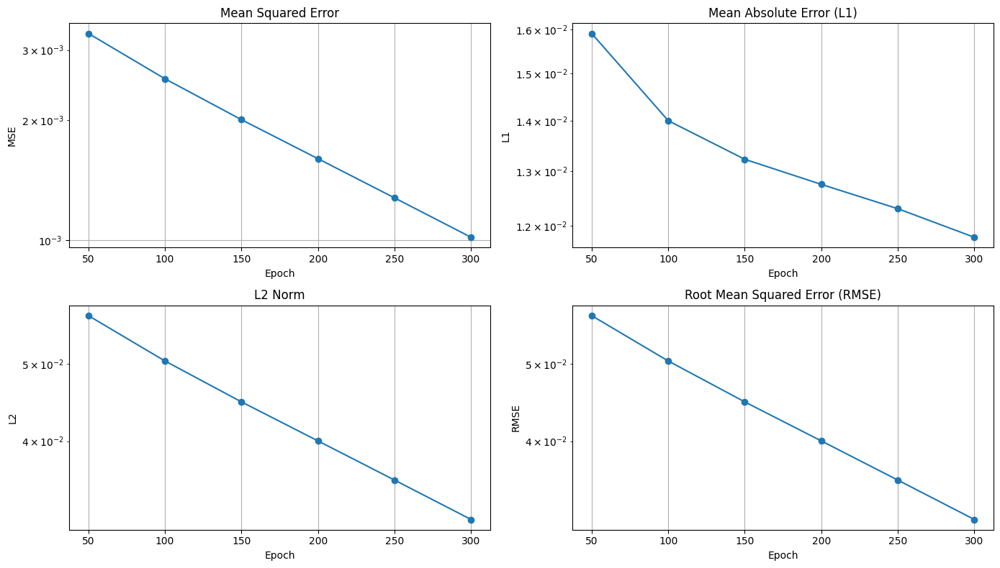

2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 2s/step - loss: 0.0013 - val_loss: 0.0010
Epoch 301/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - loss: 0.0012 - val_loss: 0.0010
Epoch 302/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - loss: 0.0013 - val_loss: 0.0010
Epoch 303/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step - loss: 0.0012 - val_loss: 0.0010
Epoch 304/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - loss: 0.0012 - val_loss: 0.0010
Epoch 305/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - loss: 0.0014 - val_loss: 9.9608e-04
Epoch 306/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 0.0012 - val_loss: 9.9166e-04
Epoch 307/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0013 - val_loss: 9.8723e-04
Epoch 308/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - loss: 0.0012 - val_loss: 9.8284e-04
Epoch 309/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step - loss: 0.0012 - val_loss: 9.7845e-04
Epoch 310/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - loss: 0.0012 - val_loss: 9.7413e-04
Epoch 311/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms

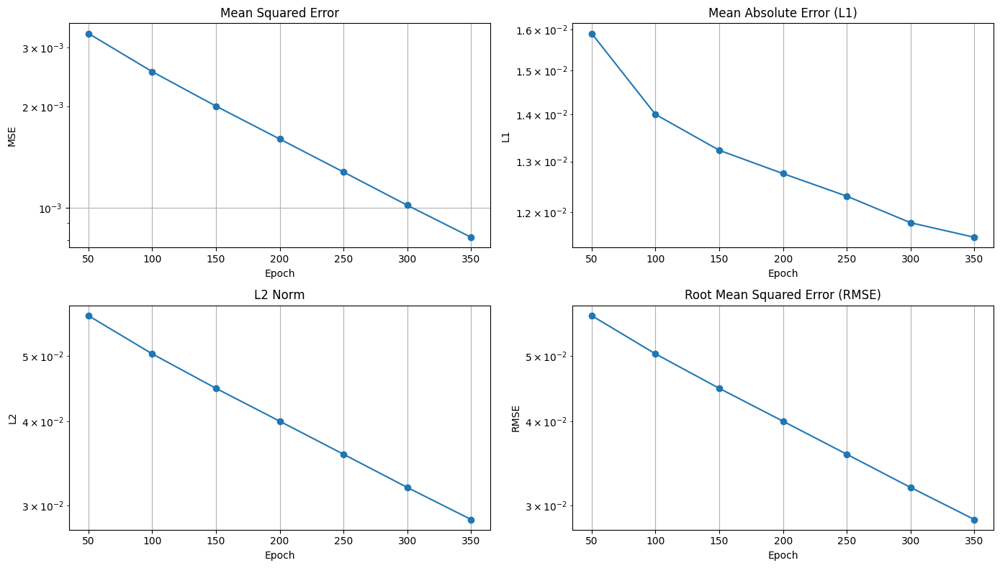

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.0010 - val_loss: 8.1693e-04
Epoch 351/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 58ms/step - loss: 0.0010 - val_loss: 8.1332e-04
Epoch 352/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - loss: 0.0010 - val_loss: 8.0968e-04
Epoch 353/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - loss: 0.0010 - val_loss: 8.0616e-04
Epoch 354/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 9.8301e-04 - val_loss: 8.0267e-04
Epoch 355/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 9.7927e-04 - val_loss: 7.9916e-04
Epoch 356/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 9.8024e-04 - val_loss: 7.9573e-04
Epoch 357/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 9.8414e-04 - val_loss: 7.9243e-04
Epoch 358/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - loss: 9.8888e-04 - val_loss: 7.8916e-04
Epoch 359/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - loss: 9.7034e-04 - val_loss: 7.8595e-04
Epoch 360/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - loss: 9.7635e-04 - val_loss: 7.8279e-0

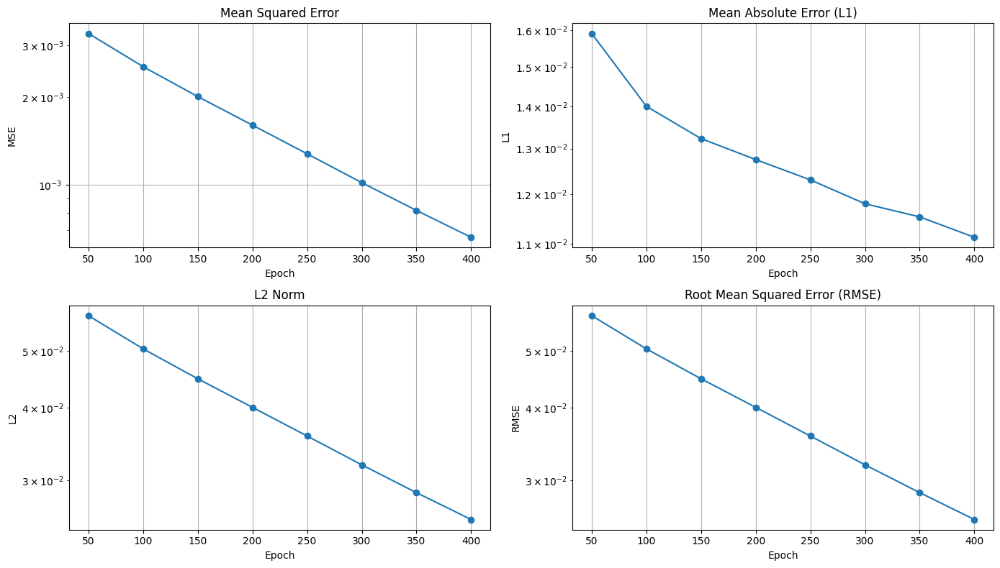

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 8.0359e-04 - val_loss: 6.6093e-04
Epoch 401/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 59ms/step - loss: 8.0791e-04 - val_loss: 6.5820e-04
Epoch 402/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 8.1358e-04 - val_loss: 6.5554e-04
Epoch 403/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 7.8653e-04 - val_loss: 6.5298e-04
Epoch 404/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - loss: 7.9238e-04 - val_loss: 6.5039e-04
Epoch 405/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - loss: 8.0038e-04 - val_loss: 6.4784e-04
Epoch 406/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - loss: 8.1042e-04 - val_loss: 6.4530e-04
Epoch 407/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - loss: 7.9959e-04 - val_loss: 6.4275e-04
Epoch 408/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - loss: 7.9536e-04 - val_loss: 6.4024e-04
Epoch 409/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step - loss: 7.6481e-04 - val_loss: 6.3775e-04
Epoch 410/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - loss: 8.1482e-04 - val

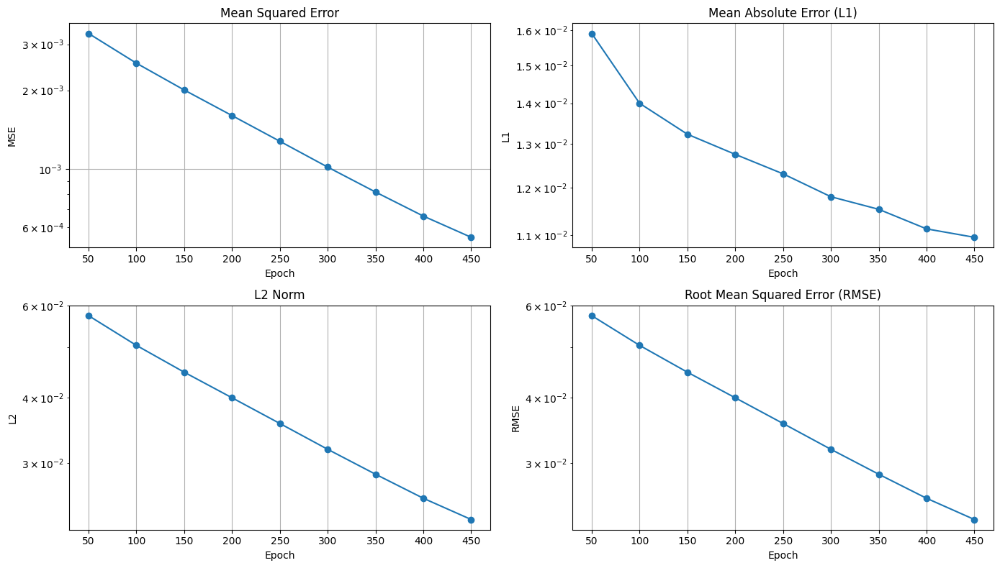

2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 6.5496e-04 - val_loss: 5.4831e-04
Epoch 451/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step - loss: 6.2997e-04 - val_loss: 5.4645e-04
Epoch 452/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - loss: 6.2868e-04 - val_loss: 5.4456e-04
Epoch 453/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - loss: 6.4892e-04 - val_loss: 5.4266e-04
Epoch 454/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - loss: 6.7657e-04 - val_loss: 5.4075e-04
Epoch 455/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - loss: 6.2924e-04 - val_loss: 5.3883e-04
Epoch 456/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - loss: 6.3870e-04 - val_loss: 5.3698e-04
Epoch 457/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - loss: 5.9832e-04 - val_loss: 5.3520e-04
Epoch 458/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - loss: 6.4402e-04 - val_loss: 5.3347e-04
Epoch 459/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step - loss: 6.4082e-04 - val_loss: 5.3173e-04
Epoch 460/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step - loss: 6.2756e-04 - val

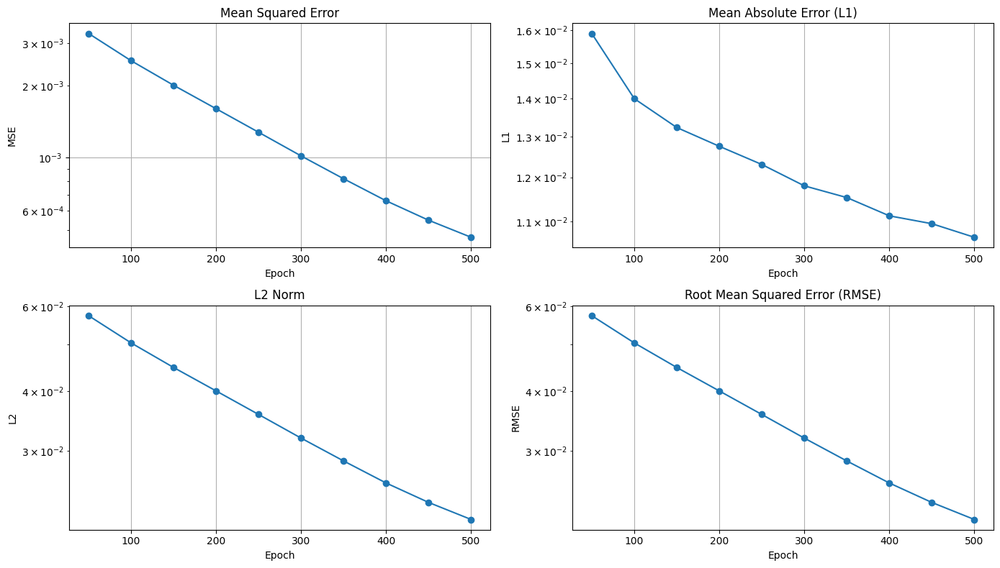

2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 3s/step - loss: 5.2698e-04 - val_loss: 4.6546e-04


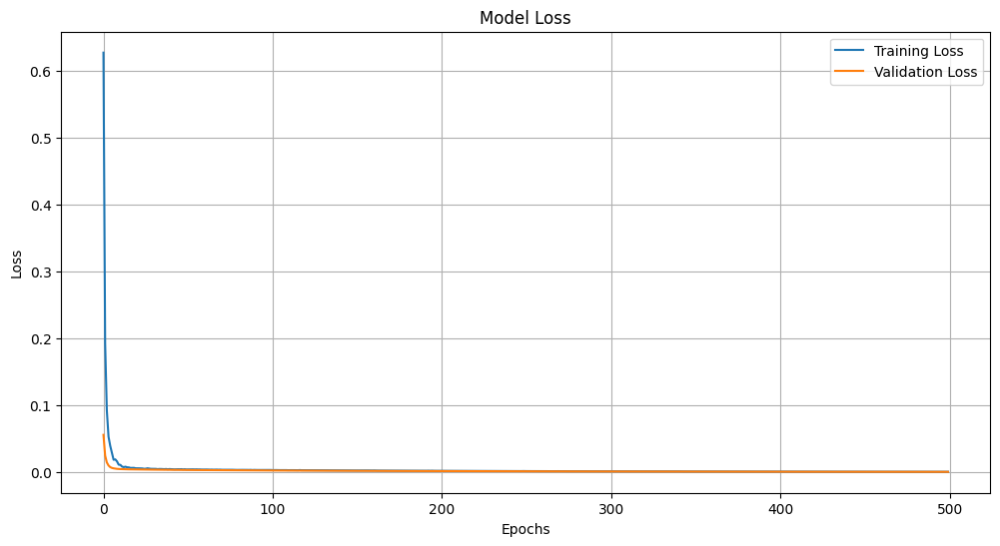

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step - loss: 0.5730 - val_loss: 0.0290
Epoch 2/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 0.1179 - val_loss: 0.0111
Epoch 3/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 0.0369 - val_loss: 0.0074
Epoch 4/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 0.0211 - val_loss: 0.0058
Epoch 5/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 0.0149 - val_loss: 0.0051
Epoch 6/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 0.0115 - val_loss: 0.0047
Epoch 7/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 0.0097 - val_loss: 0.0046
Epoch 8/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0077 - val_loss: 0.0045
Epoch 9/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 0.0078 - val_loss: 0.0044
Epoch 10/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0061 - val_loss: 0.0043
Epoch 11/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 0.0059 - val_loss: 0.0043
Epoch 12/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 0.0060 - val_l

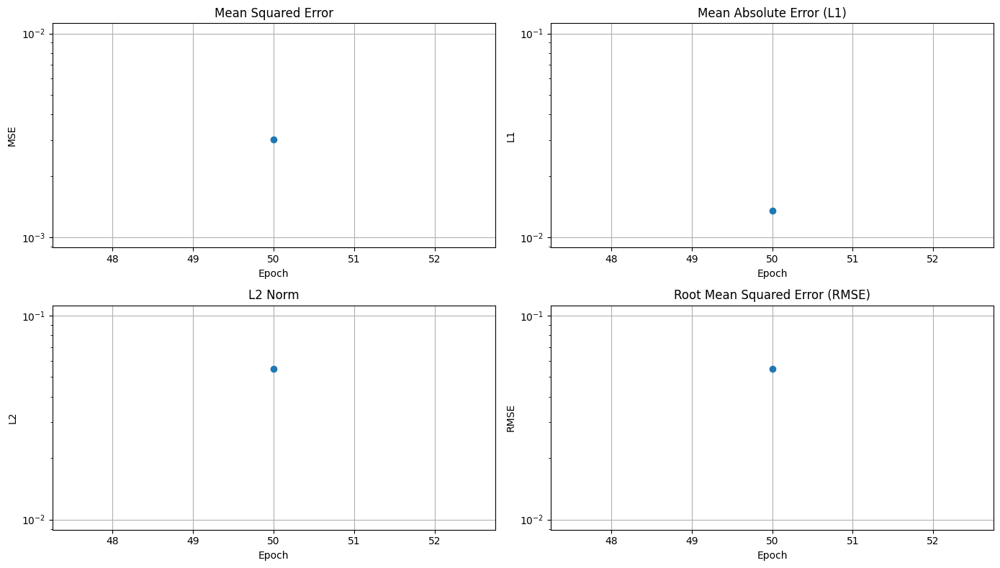

3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 1s/step - loss: 0.0034 - val_loss: 0.0030
Epoch 51/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - loss: 0.0032 - val_loss: 0.0030
Epoch 52/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 0.0032 - val_loss: 0.0030
Epoch 53/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - loss: 0.0032 - val_loss: 0.0029
Epoch 54/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 0.0032 - val_loss: 0.0029
Epoch 55/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - loss: 0.0030 - val_loss: 0.0029
Epoch 56/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.0031 - val_loss: 0.0029
Epoch 57/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 0.0031 - val_loss: 0.0029
Epoch 58/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - loss: 0.0029 - val_loss: 0.0028
Epoch 59/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 0.0031 - val_loss: 0.0028
Epoch 60/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - loss: 0.0031 - val_loss: 0.0028
Epoch 61/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - loss: 0.0030 - val_loss: 0.

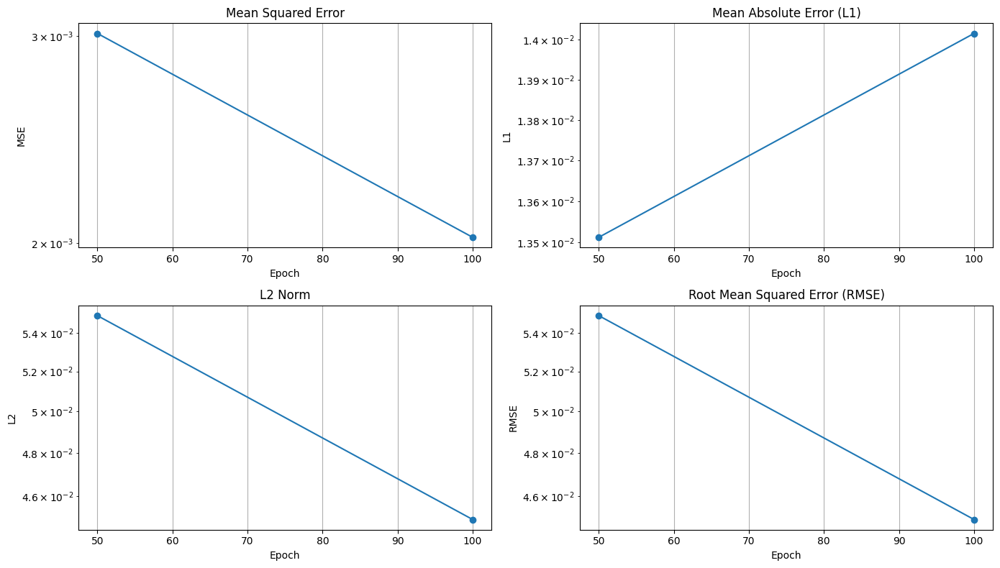

3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 946ms/step - loss: 0.0022 - val_loss: 0.0020
Epoch 101/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 0.0022 - val_loss: 0.0020
Epoch 102/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 0.0021 - val_loss: 0.0020
Epoch 103/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0019 - val_loss: 0.0019
Epoch 104/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 0.0021 - val_loss: 0.0019
Epoch 105/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 0.0019 - val_loss: 0.0019
Epoch 106/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0021 - val_loss: 0.0018
Epoch 107/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 0.0019 - val_loss: 0.0018
Epoch 108/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 0.0019 - val_loss: 0.0018
Epoch 109/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 0.0019 - val_loss: 0.0017
Epoch 110/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0019 - val_loss: 0.0017
Epoch 111/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 0.0019 

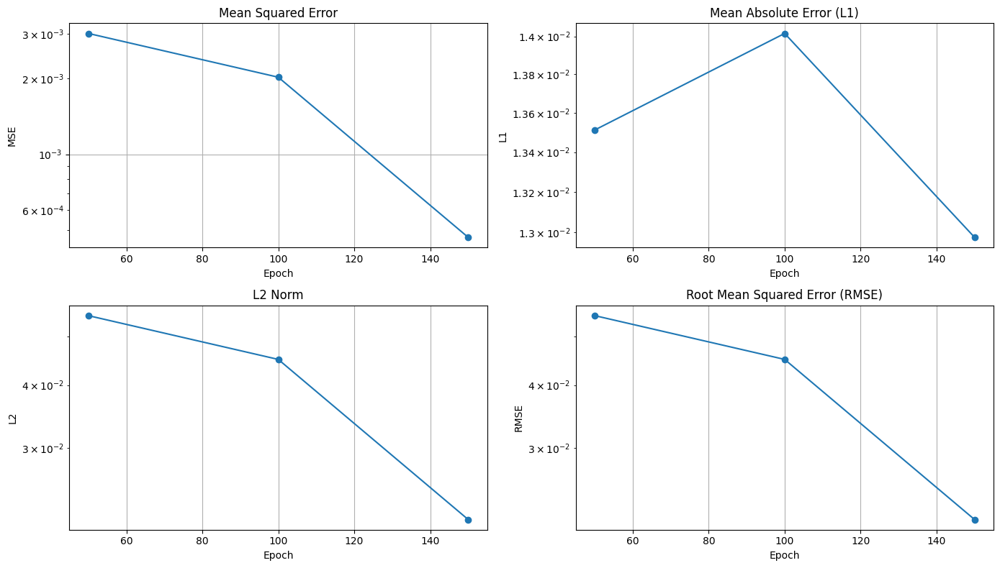

3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 957ms/step - loss: 7.6155e-04 - val_loss: 4.6848e-04
Epoch 151/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 5.7926e-04 - val_loss: 4.6784e-04
Epoch 152/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - loss: 7.9460e-04 - val_loss: 4.6703e-04
Epoch 153/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 8.1562e-04 - val_loss: 4.6667e-04
Epoch 154/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 6.2239e-04 - val_loss: 4.6878e-04
Epoch 155/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 4.8290e-04 - val_loss: 4.7273e-04
Epoch 156/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 6.5664e-04 - val_loss: 4.7378e-04
Epoch 157/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 5.8511e-04 - val_loss: 4.7497e-04
Epoch 158/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 6.7531e-04 - val_loss: 4.7779e-04
Epoch 159/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 6.9298e-04 - val_loss: 4.8075e-04
Epoch 160/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 5.4190e-04 - 

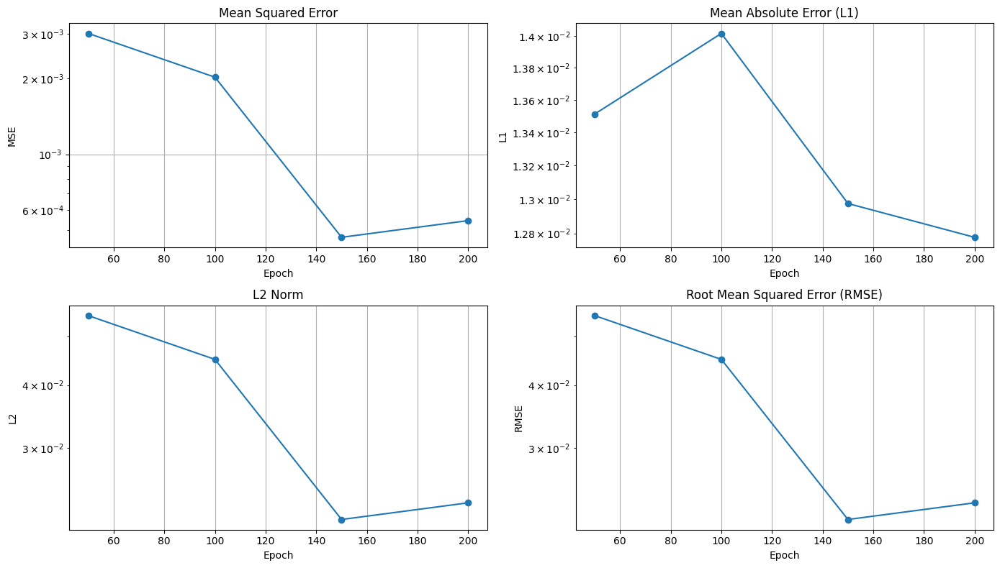

3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 2s/step - loss: 5.3895e-04 - val_loss: 5.4560e-04
Epoch 201/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 41ms/step - loss: 4.7572e-04 - val_loss: 5.6093e-04
Epoch 202/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - loss: 5.6724e-04 - val_loss: 5.7204e-04
Epoch 203/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 5.0612e-04 - val_loss: 5.8077e-04
Epoch 204/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 4.8298e-04 - val_loss: 5.8741e-04
Epoch 205/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 4.7701e-04 - val_loss: 5.9185e-04
Epoch 206/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 5.4101e-04 - val_loss: 5.8409e-04
Epoch 207/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 5.8681e-04 - val_loss: 5.8018e-04
Epoch 208/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 4.9309e-04 - val_loss: 5.7983e-04
Epoch 209/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 4.6416e-04 - val_loss: 5.7950e-04
Epoch 210/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 5.1231e-04 - val

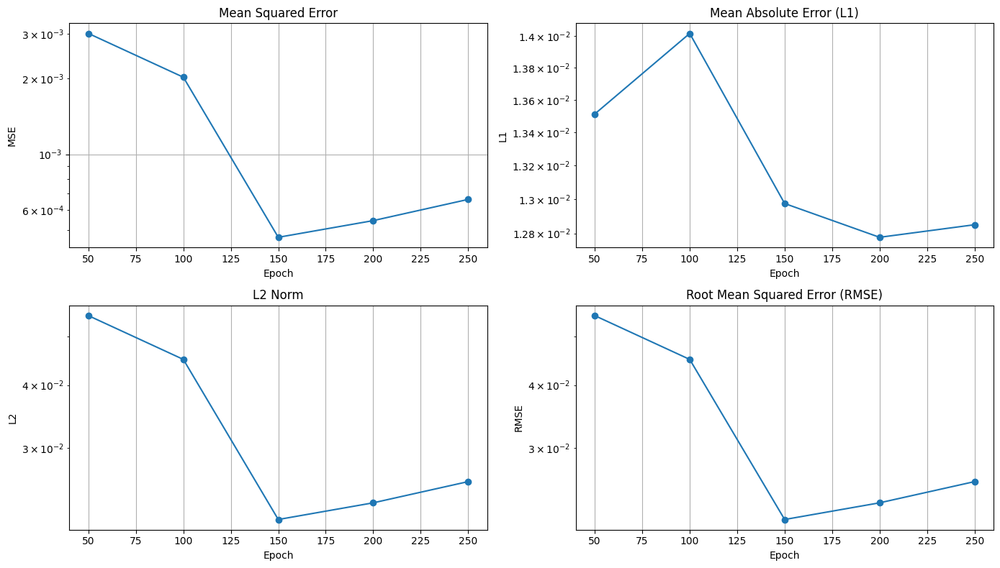

3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - loss: 3.7209e-04 - val_loss: 6.6221e-04
Epoch 251/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step - loss: 4.6868e-04 - val_loss: 6.5953e-04
Epoch 252/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 3.5776e-04 - val_loss: 6.5064e-04
Epoch 253/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 3.9059e-04 - val_loss: 6.4817e-04
Epoch 254/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 5.2887e-04 - val_loss: 6.4762e-04
Epoch 255/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 3.8574e-04 - val_loss: 6.5048e-04
Epoch 256/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 5.1861e-04 - val_loss: 6.5093e-04
Epoch 257/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 4.0027e-04 - val_loss: 6.5599e-04
Epoch 258/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 3.8008e-04 - val_loss: 6.6197e-04
Epoch 259/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 3.9383e-04 - val_loss: 6.7617e-04
Epoch 260/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 4.1914e-04 - val

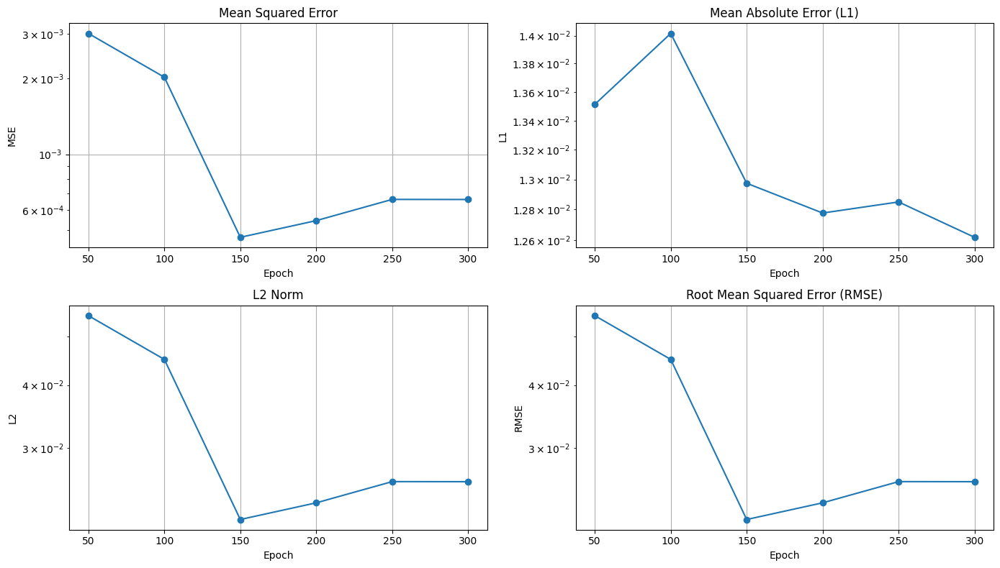

3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - loss: 4.7826e-04 - val_loss: 6.6173e-04
Epoch 301/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 37ms/step - loss: 3.2008e-04 - val_loss: 6.5487e-04
Epoch 302/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - loss: 3.6609e-04 - val_loss: 6.4876e-04
Epoch 303/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - loss: 3.4446e-04 - val_loss: 6.4321e-04
Epoch 304/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 3.7866e-04 - val_loss: 6.4114e-04
Epoch 305/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 3.6526e-04 - val_loss: 6.5231e-04
Epoch 306/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 4.4149e-04 - val_loss: 6.5995e-04
Epoch 307/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 4.1879e-04 - val_loss: 6.5549e-04
Epoch 308/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 3.5644e-04 - val_loss: 6.5431e-04
Epoch 309/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 3.4139e-04 - val_loss: 6.4822e-04
Epoch 310/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 3.1816e-04 - val

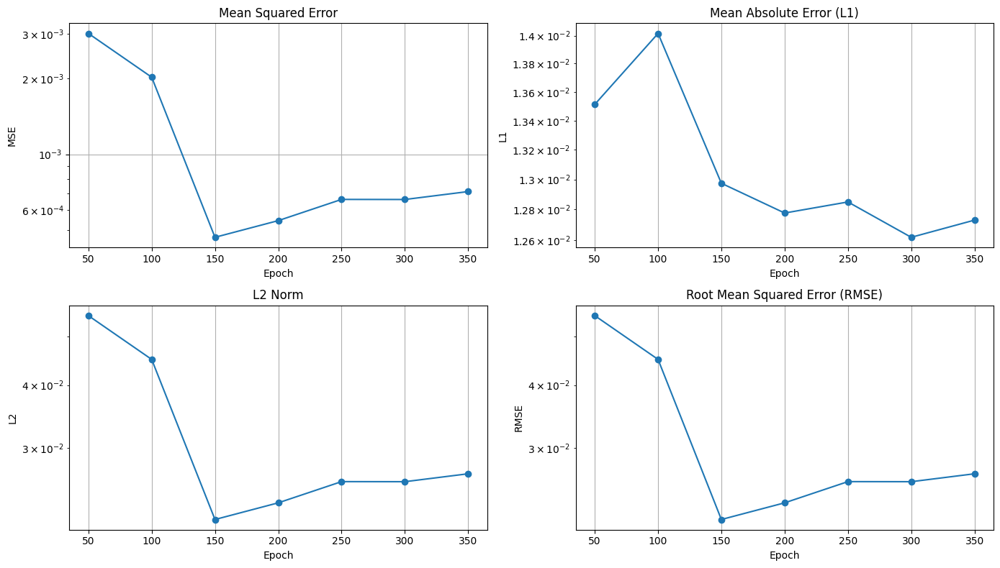

3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 2s/step - loss: 3.6776e-04 - val_loss: 7.1139e-04
Epoch 351/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 41ms/step - loss: 3.6078e-04 - val_loss: 6.9929e-04
Epoch 352/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 3.5549e-04 - val_loss: 6.8691e-04
Epoch 353/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 3.5069e-04 - val_loss: 6.7903e-04
Epoch 354/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 3.7581e-04 - val_loss: 6.7324e-04
Epoch 355/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 3.8559e-04 - val_loss: 6.6500e-04
Epoch 356/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 3.6277e-04 - val_loss: 6.6293e-04
Epoch 357/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 3.6194e-04 - val_loss: 6.6442e-04
Epoch 358/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 4.9945e-04 - val_loss: 6.7535e-04
Epoch 359/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 2.9980e-04 - val_loss: 6.7562e-04
Epoch 360/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 3.5541e-04 - val

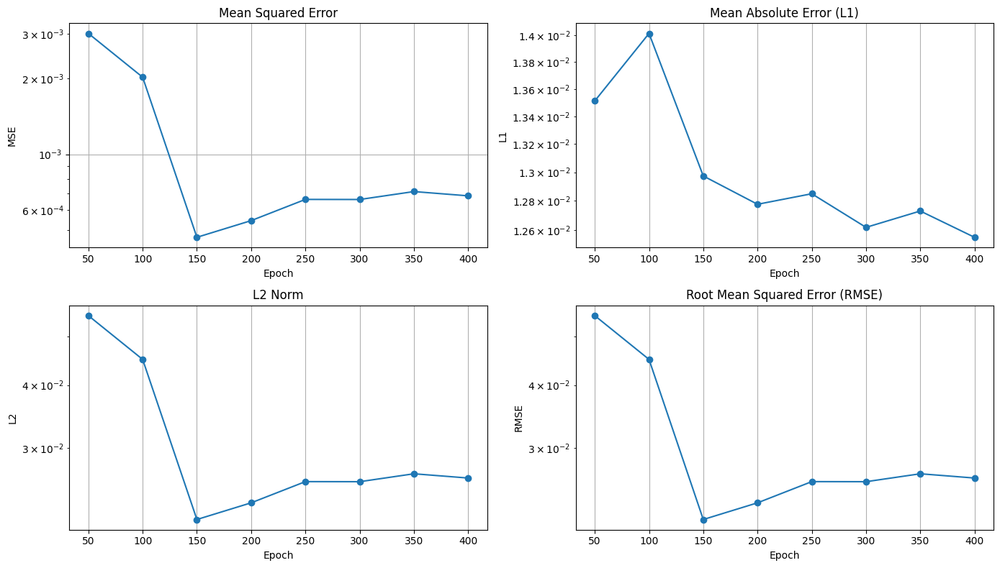

3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - loss: 3.3045e-04 - val_loss: 6.8426e-04
Epoch 401/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 43ms/step - loss: 3.2381e-04 - val_loss: 6.9022e-04
Epoch 402/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - loss: 3.3925e-04 - val_loss: 6.9044e-04
Epoch 403/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - loss: 3.2469e-04 - val_loss: 6.9022e-04
Epoch 404/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - loss: 3.2740e-04 - val_loss: 6.8338e-04
Epoch 405/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 3.2427e-04 - val_loss: 6.8218e-04
Epoch 406/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 3.4675e-04 - val_loss: 6.7827e-04
Epoch 407/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 3.1156e-04 - val_loss: 6.7821e-04
Epoch 408/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 3.0538e-04 - val_loss: 6.7570e-04
Epoch 409/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 3.3244e-04 - val_loss: 6.7500e-04
Epoch 410/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - loss: 3.2251e-04 - val

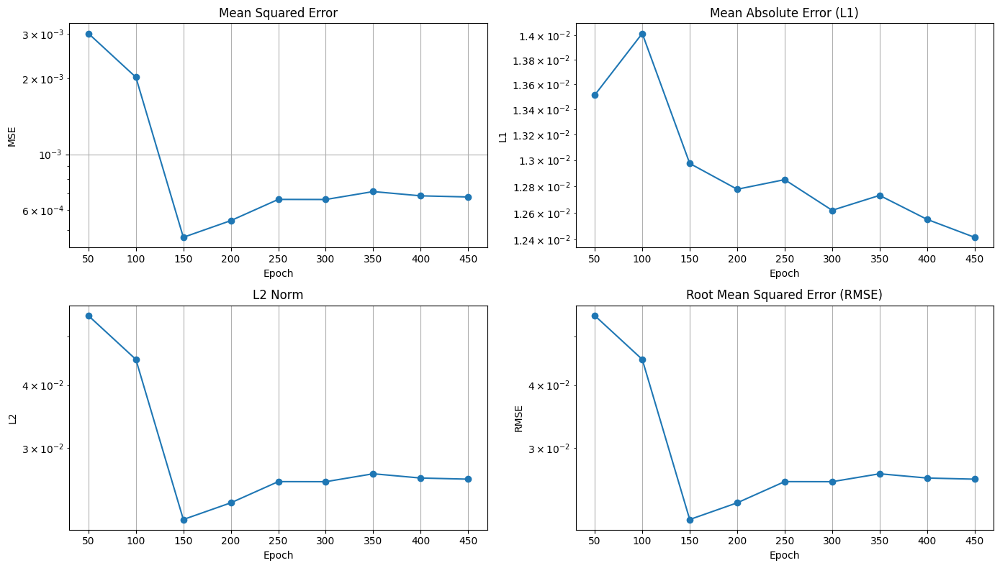

3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - loss: 3.4583e-04 - val_loss: 6.7722e-04
Epoch 451/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - loss: 3.2399e-04 - val_loss: 6.7956e-04
Epoch 452/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 3.5005e-04 - val_loss: 6.8365e-04
Epoch 453/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 3.1621e-04 - val_loss: 6.9024e-04
Epoch 454/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 3.0460e-04 - val_loss: 7.0012e-04
Epoch 455/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 3.6085e-04 - val_loss: 7.0254e-04
Epoch 456/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 3.1556e-04 - val_loss: 6.9831e-04
Epoch 457/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 3.3473e-04 - val_loss: 6.9603e-04
Epoch 458/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 3.5944e-04 - val_loss: 7.0071e-04
Epoch 459/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 3.4688e-04 - val_loss: 7.0560e-04
Epoch 460/500
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 3.1668e-04 - val

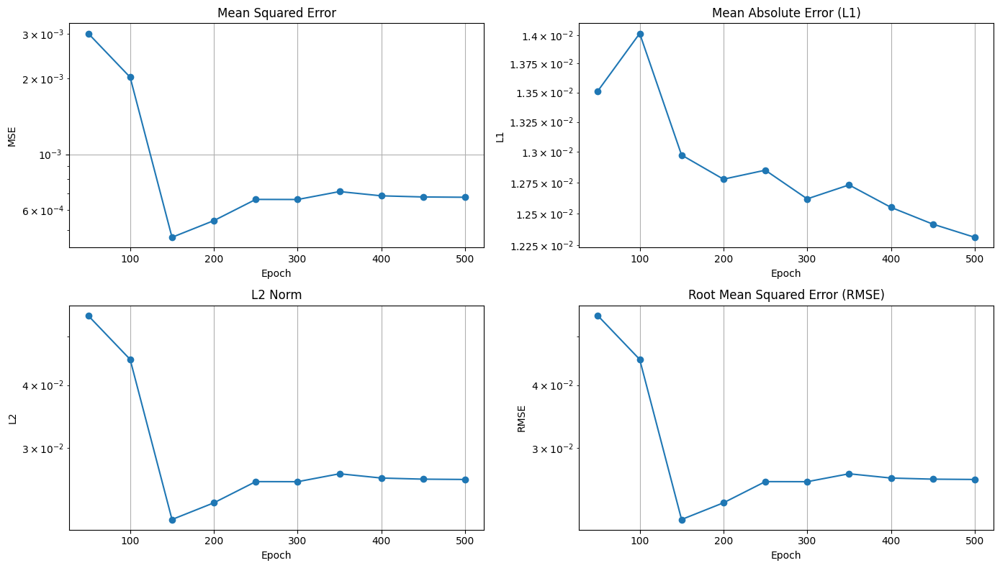

3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - loss: 3.4986e-04 - val_loss: 6.7536e-04


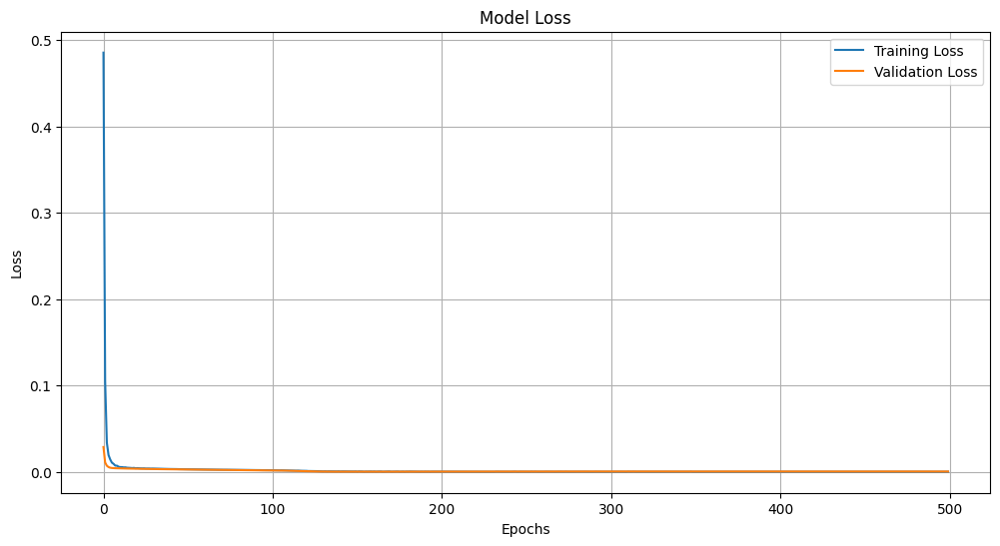

Epoch 1/500


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 79ms/step - loss: 0.3200 - val_loss: 0.0134
Epoch 2/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.0339 - val_loss: 0.0064
Epoch 3/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0151 - val_loss: 0.0052
Epoch 4/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0103 - val_loss: 0.0049
Epoch 5/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0072 - val_loss: 0.0048
Epoch 6/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0062 - val_loss: 0.0047
Epoch 7/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0058 - val_loss: 0.0046
Epoch 8/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0052 - val_loss: 0.0045
Epoch 9/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0051 - val_loss: 0.0044
Epoch 10/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0049 - val_loss: 0.0043
Epoch 11/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0045 - val_loss: 0.0042
Epoch 12/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0046 - val_loss: 0.0041
E

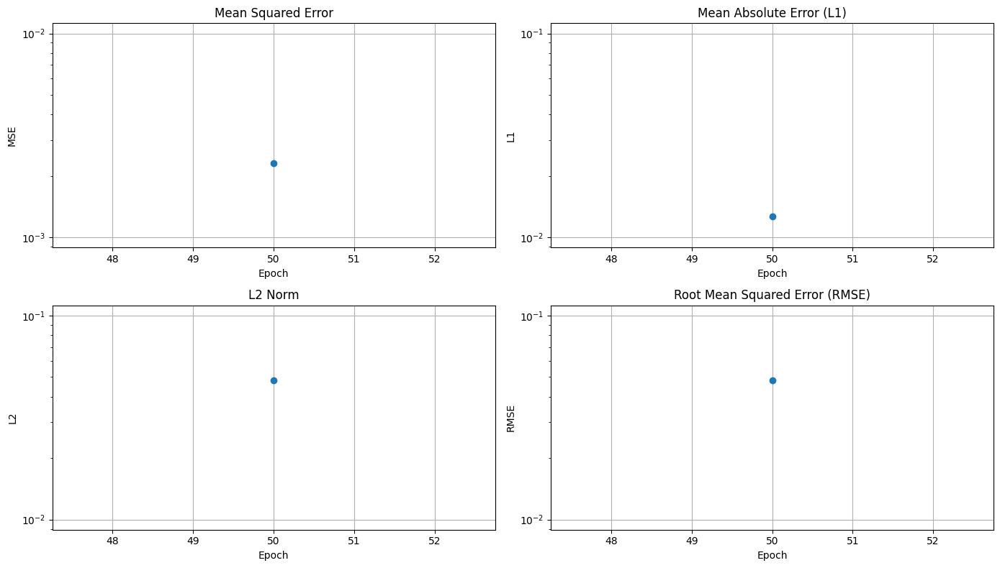

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 579ms/step - loss: 0.0024 - val_loss: 0.0023
Epoch 51/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0023 - val_loss: 0.0022
Epoch 52/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 0.0023 - val_loss: 0.0022
Epoch 53/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0022 - val_loss: 0.0021
Epoch 54/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0023 - val_loss: 0.0020
Epoch 55/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0021 - val_loss: 0.0020
Epoch 56/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0019 - val_loss: 0.0018
Epoch 57/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0019 - val_loss: 0.0017
Epoch 58/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0019 - val_loss: 0.0015
Epoch 59/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0016 - val_loss: 0.0013
Epoch 60/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0014 - val_loss: 0.0011
Epoch 61/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 0.0014 - val_loss:

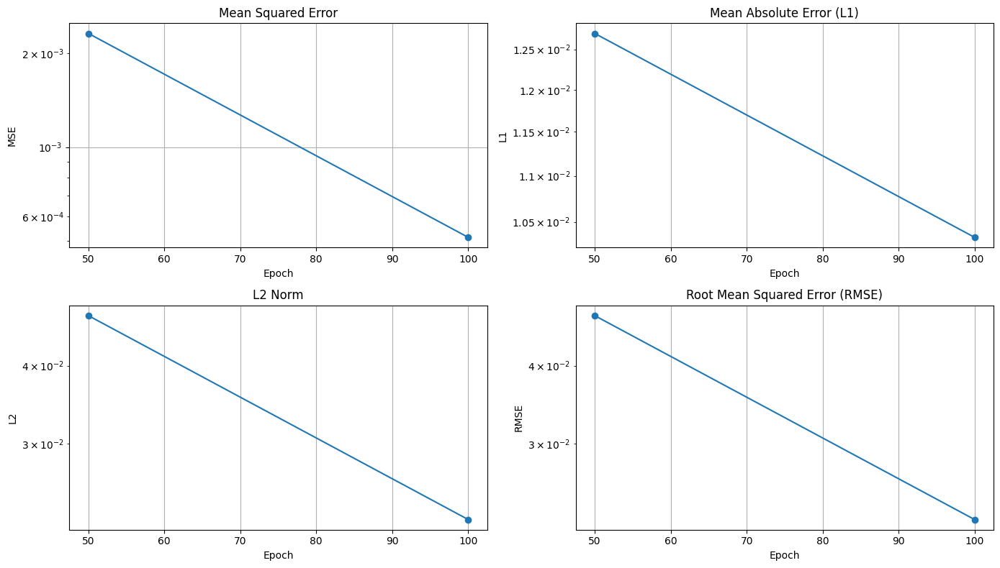

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 471ms/step - loss: 6.7978e-04 - val_loss: 5.1397e-04
Epoch 101/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 6.8701e-04 - val_loss: 5.0589e-04
Epoch 102/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 7.2809e-04 - val_loss: 5.0115e-04
Epoch 103/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 7.4648e-04 - val_loss: 5.0729e-04
Epoch 104/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 5.9530e-04 - val_loss: 5.0594e-04
Epoch 105/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 6.9247e-04 - val_loss: 5.0712e-04
Epoch 106/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 7.9836e-04 - val_loss: 5.0866e-04
Epoch 107/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 6.8999e-04 - val_loss: 4.9083e-04
Epoch 108/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 7.2014e-04 - val_loss: 4.8787e-04
Epoch 109/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 7.3914e-04 - val_loss: 4.9084e-04
Epoch 110/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 7.5194e-04 - 

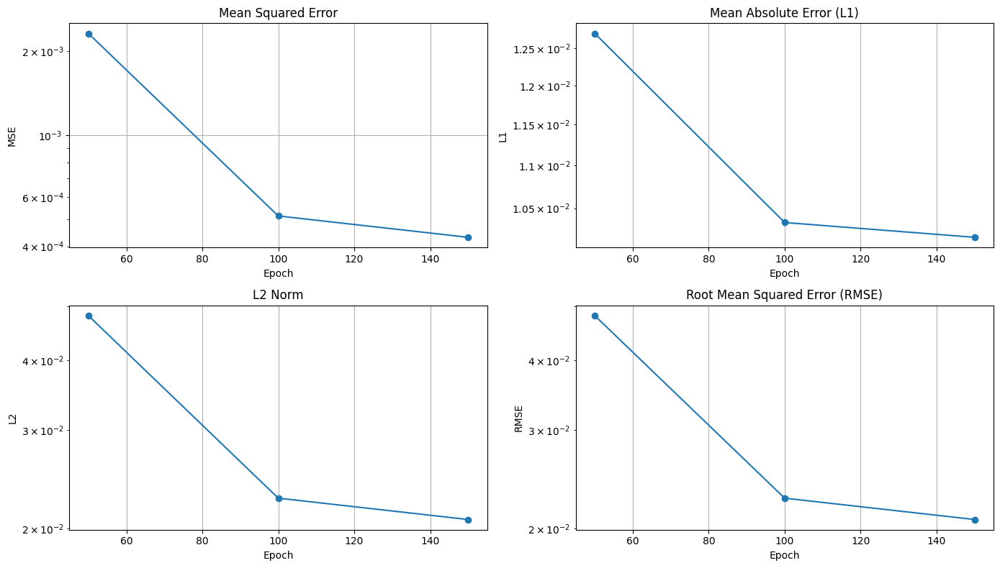

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 508ms/step - loss: 5.6089e-04 - val_loss: 4.3103e-04
Epoch 151/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 4.6769e-04 - val_loss: 4.2968e-04
Epoch 152/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 5.0011e-04 - val_loss: 4.2838e-04
Epoch 153/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 4.8520e-04 - val_loss: 4.2850e-04
Epoch 154/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 5.5961e-04 - val_loss: 4.2571e-04
Epoch 155/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 4.8424e-04 - val_loss: 4.2321e-04
Epoch 156/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 6.3158e-04 - val_loss: 4.2094e-04
Epoch 157/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 5.2917e-04 - val_loss: 4.1520e-04
Epoch 158/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 5.5321e-04 - val_loss: 4.1354e-04
Epoch 159/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 5.4656e-04 - val_loss: 4.2134e-04
Epoch 160/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 4.1180e-04 - 

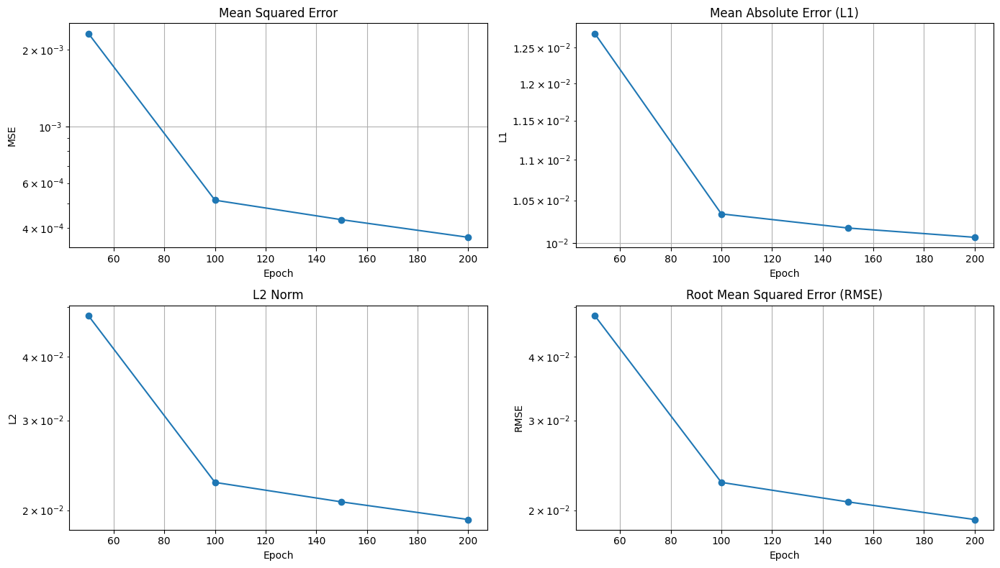

6/6 ━━━━━━━━━━━━━━━━━━━━ 4s 737ms/step - loss: 4.8508e-04 - val_loss: 3.6768e-04
Epoch 201/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 4.3829e-04 - val_loss: 3.6879e-04
Epoch 202/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 4.9494e-04 - val_loss: 3.6517e-04
Epoch 203/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 5.1504e-04 - val_loss: 3.5994e-04
Epoch 204/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 4.9147e-04 - val_loss: 3.5562e-04
Epoch 205/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 3.4896e-04 - val_loss: 3.5674e-04
Epoch 206/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 4.0998e-04 - val_loss: 3.6145e-04
Epoch 207/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 4.2453e-04 - val_loss: 3.6630e-04
Epoch 208/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 3.7313e-04 - val_loss: 3.6735e-04
Epoch 209/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 4.4734e-04 - val_loss: 3.6587e-04
Epoch 210/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 4.8048e-04 - 

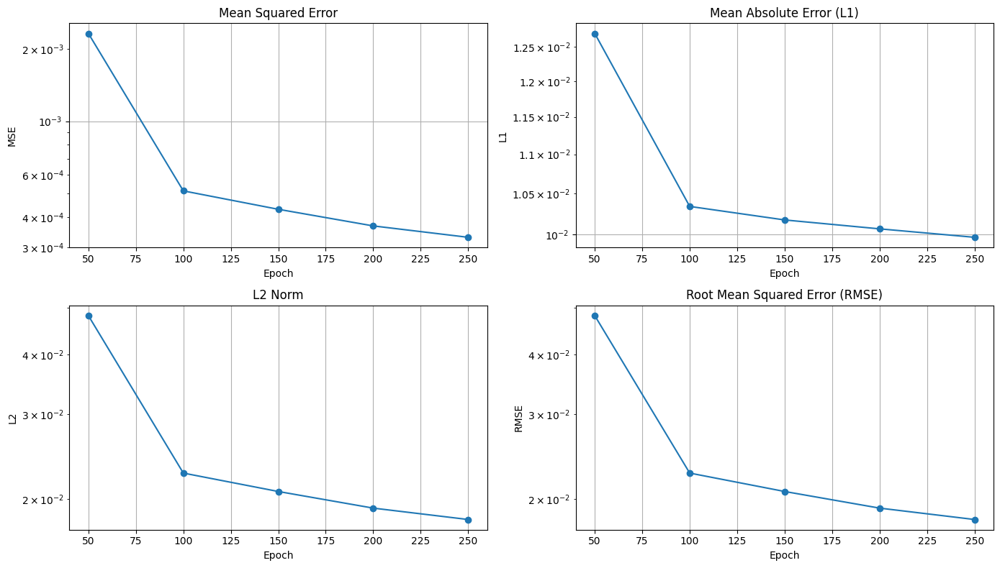

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 531ms/step - loss: 3.6472e-04 - val_loss: 3.2974e-04
Epoch 251/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 40ms/step - loss: 2.8778e-04 - val_loss: 3.2939e-04
Epoch 252/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 3.5111e-04 - val_loss: 3.2883e-04
Epoch 253/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 3.1206e-04 - val_loss: 3.2789e-04
Epoch 254/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 3.6006e-04 - val_loss: 3.2703e-04
Epoch 255/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 3.1671e-04 - val_loss: 3.2731e-04
Epoch 256/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 3.1018e-04 - val_loss: 3.2629e-04
Epoch 257/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 3.3538e-04 - val_loss: 3.2653e-04
Epoch 258/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 2.7067e-04 - val_loss: 3.2718e-04
Epoch 259/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 3.0358e-04 - val_loss: 3.2879e-04
Epoch 260/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 3.3954e-04 - 

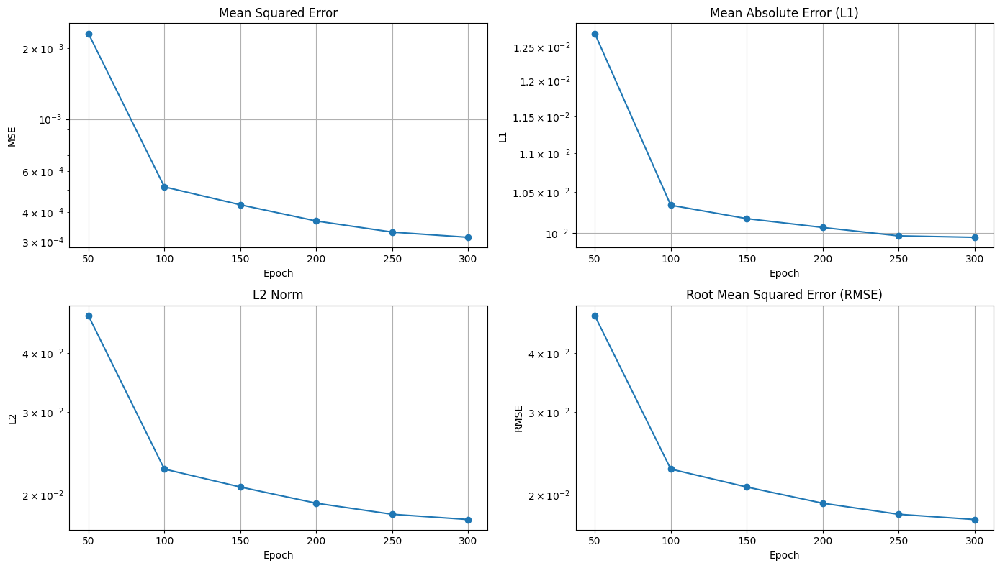

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 629ms/step - loss: 3.3937e-04 - val_loss: 3.1332e-04
Epoch 301/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - loss: 2.4134e-04 - val_loss: 3.1227e-04
Epoch 302/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.8483e-04 - val_loss: 3.1211e-04
Epoch 303/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 2.8217e-04 - val_loss: 3.1273e-04
Epoch 304/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 3.0201e-04 - val_loss: 3.1279e-04
Epoch 305/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.7346e-04 - val_loss: 3.1302e-04
Epoch 306/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.8263e-04 - val_loss: 3.1290e-04
Epoch 307/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 3.0643e-04 - val_loss: 3.1251e-04
Epoch 308/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 3.0374e-04 - val_loss: 3.1225e-04
Epoch 309/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.7834e-04 - val_loss: 3.1232e-04
Epoch 310/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.4923e-04 - 

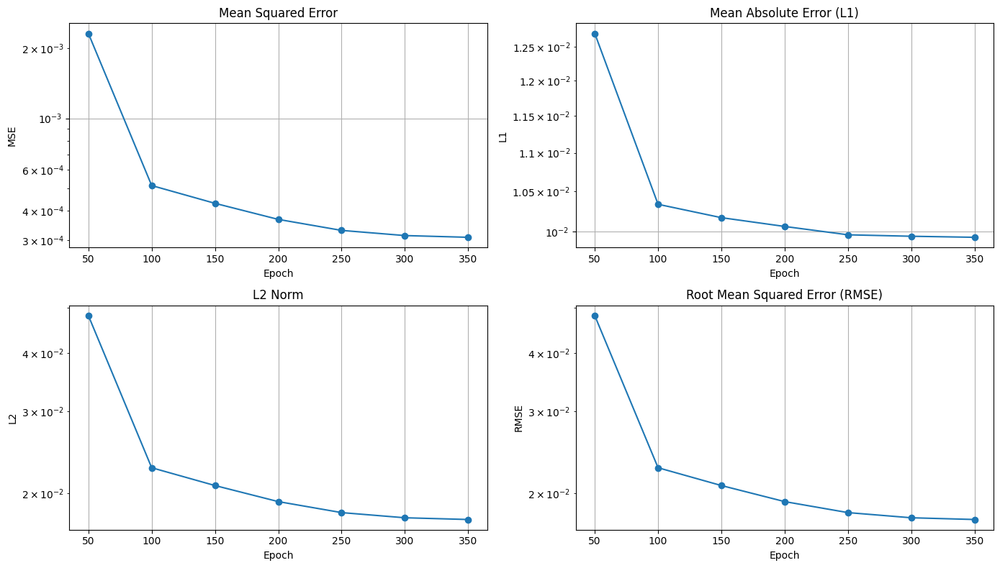

6/6 ━━━━━━━━━━━━━━━━━━━━ 4s 673ms/step - loss: 2.6103e-04 - val_loss: 3.0798e-04
Epoch 351/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 28ms/step - loss: 2.4139e-04 - val_loss: 3.0797e-04
Epoch 352/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.4575e-04 - val_loss: 3.0754e-04
Epoch 353/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.4553e-04 - val_loss: 3.0722e-04
Epoch 354/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.4246e-04 - val_loss: 3.0704e-04
Epoch 355/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.7911e-04 - val_loss: 3.0676e-04
Epoch 356/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.6118e-04 - val_loss: 3.0706e-04
Epoch 357/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.5975e-04 - val_loss: 3.0763e-04
Epoch 358/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 2.5116e-04 - val_loss: 3.0790e-04
Epoch 359/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 2.4765e-04 - val_loss: 3.0774e-04
Epoch 360/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 2.8754e-04 - 

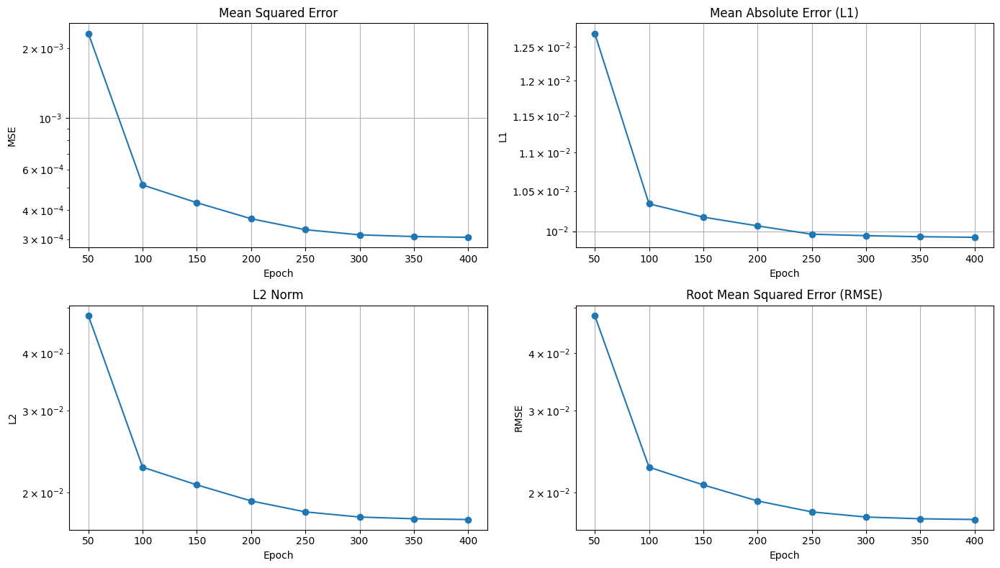

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 585ms/step - loss: 2.8010e-04 - val_loss: 3.0573e-04
Epoch 401/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - loss: 2.5140e-04 - val_loss: 3.0551e-04
Epoch 402/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 2.2488e-04 - val_loss: 3.0529e-04
Epoch 403/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 2.1485e-04 - val_loss: 3.0519e-04
Epoch 404/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.5751e-04 - val_loss: 3.0562e-04
Epoch 405/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.3310e-04 - val_loss: 3.0581e-04
Epoch 406/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 2.4725e-04 - val_loss: 3.0623e-04
Epoch 407/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 2.4264e-04 - val_loss: 3.0612e-04
Epoch 408/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.1672e-04 - val_loss: 3.0581e-04
Epoch 409/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.1803e-04 - val_loss: 3.0590e-04
Epoch 410/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.4722e-04 - 

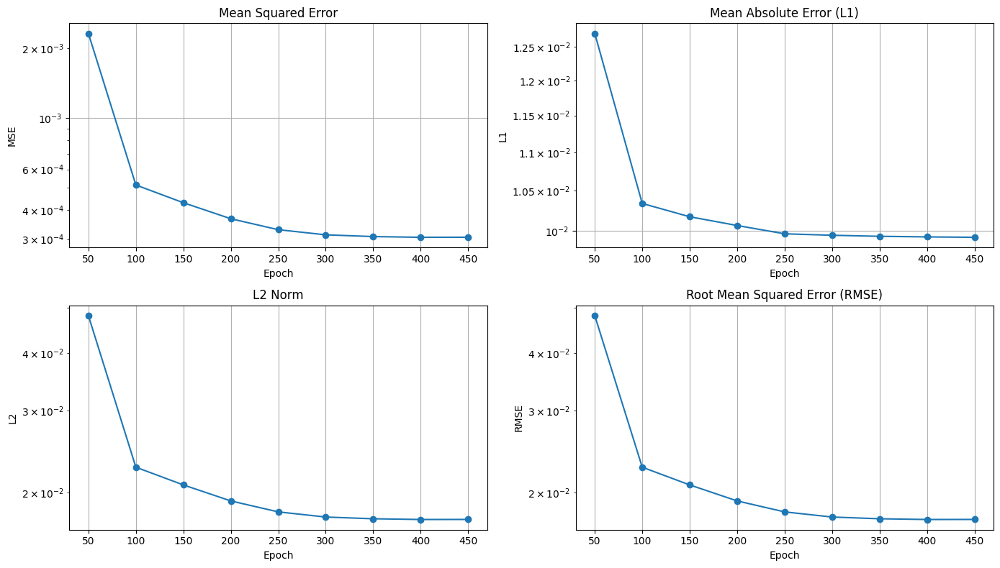

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 558ms/step - loss: 2.2918e-04 - val_loss: 3.0595e-04
Epoch 451/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 24ms/step - loss: 2.1772e-04 - val_loss: 3.0586e-04
Epoch 452/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 2.1160e-04 - val_loss: 3.0569e-04
Epoch 453/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 2.3652e-04 - val_loss: 3.0587e-04
Epoch 454/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 2.6083e-04 - val_loss: 3.0628e-04
Epoch 455/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.1566e-04 - val_loss: 3.0717e-04
Epoch 456/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.3697e-04 - val_loss: 3.0628e-04
Epoch 457/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 2.2956e-04 - val_loss: 3.0604e-04
Epoch 458/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 2.1618e-04 - val_loss: 3.0592e-04
Epoch 459/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.1843e-04 - val_loss: 3.0626e-04
Epoch 460/500
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 2.5341e-04 - 

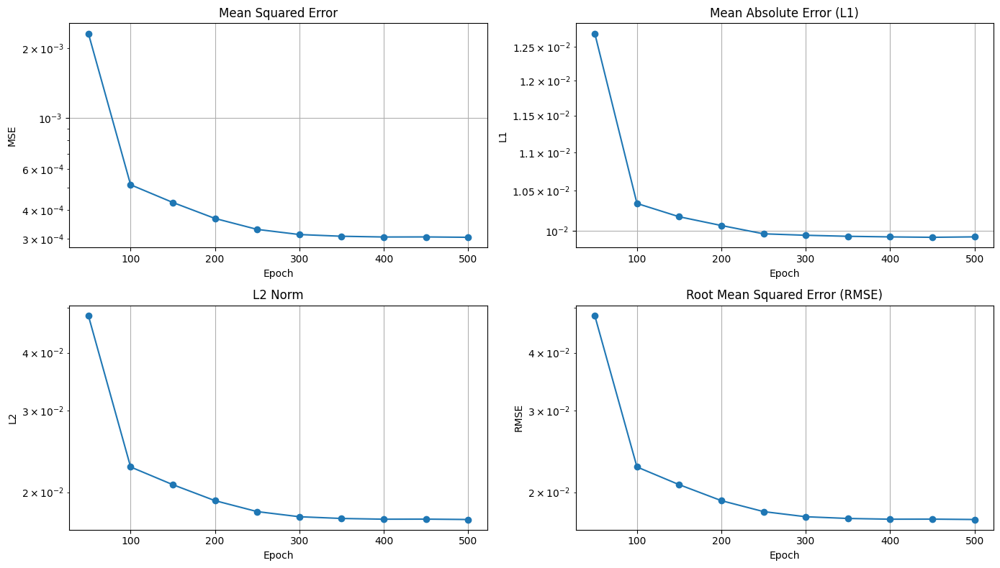

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 518ms/step - loss: 2.4348e-04 - val_loss: 3.0480e-04


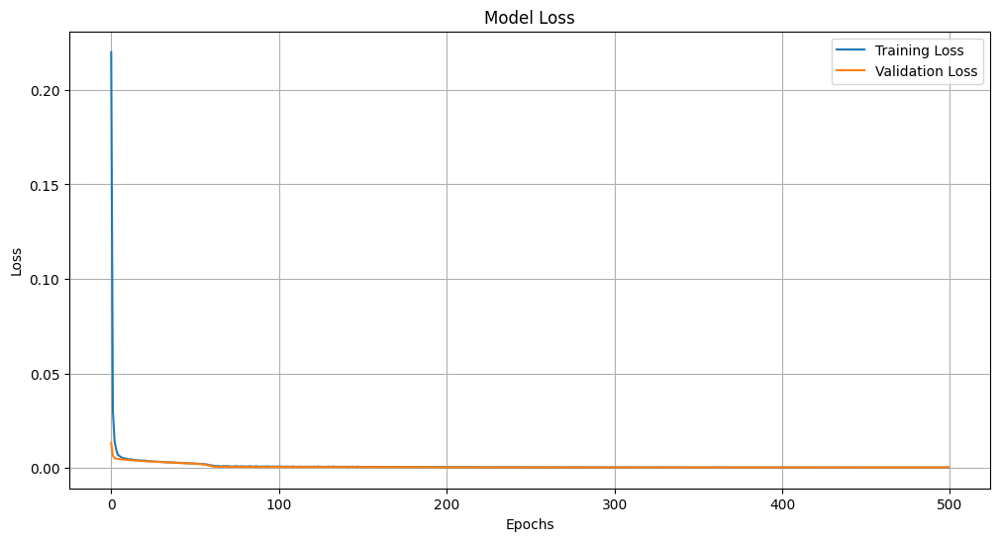

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step - loss: 0.3393 - val_loss: 0.0067
Epoch 2/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0164 - val_loss: 0.0049
Epoch 3/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0080 - val_loss: 0.0046
Epoch 4/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0059 - val_loss: 0.0044
Epoch 5/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0054 - val_loss: 0.0042
Epoch 6/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0048 - val_loss: 0.0040
Epoch 7/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0046 - val_loss: 0.0039
Epoch 8/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0043 - val_loss: 0.0038
Epoch 9/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0040 - val_loss: 0.0036
Epoch 10/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0038 - val_loss: 0.0035
Epoch 11/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0036 - val_loss: 0.0034
Epoch 12/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step

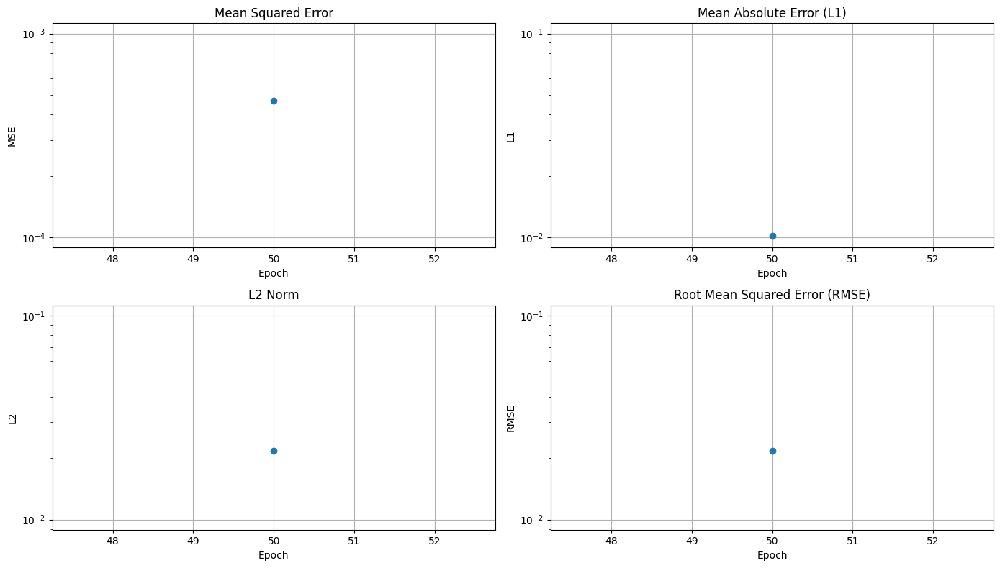

12/12 ━━━━━━━━━━━━━━━━━━━━ 3s 289ms/step - loss: 5.1899e-04 - val_loss: 4.6845e-04
Epoch 51/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - loss: 6.0922e-04 - val_loss: 4.5117e-04
Epoch 52/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 5.5177e-04 - val_loss: 4.3202e-04
Epoch 53/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 6.8010e-04 - val_loss: 4.2649e-04
Epoch 54/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 6.8413e-04 - val_loss: 4.3781e-04
Epoch 55/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 4.7300e-04 - val_loss: 4.6549e-04
Epoch 56/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 6.4304e-04 - val_loss: 4.3486e-04
Epoch 57/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 5.1329e-04 - val_loss: 4.3339e-04
Epoch 58/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 5.0760e-04 - val_loss: 4.2371e-04
Epoch 59/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 5.8634e-04 - val_loss: 4.3694e-04
Epoch 60/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 5

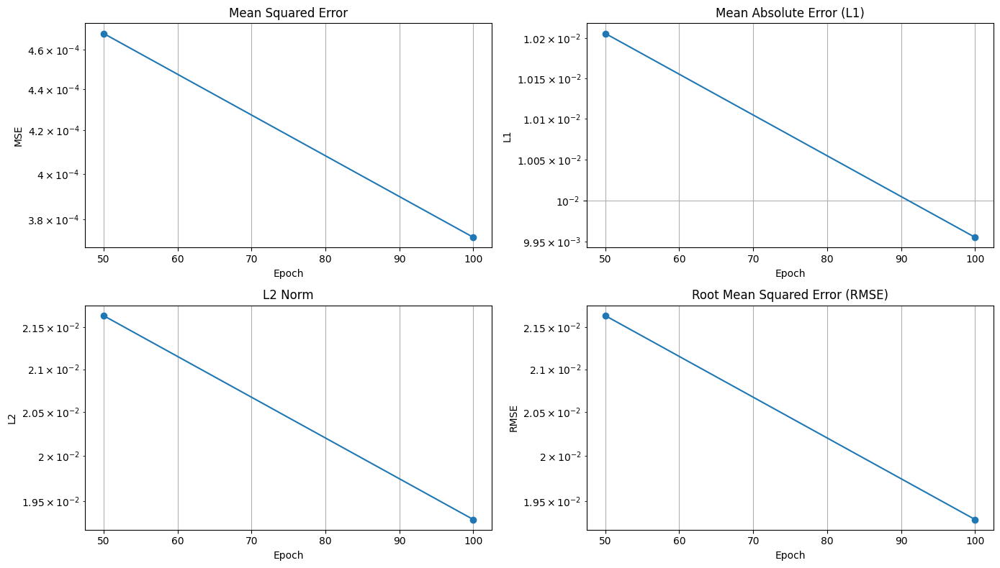

12/12 ━━━━━━━━━━━━━━━━━━━━ 44s 4s/step - loss: 3.6759e-04 - val_loss: 3.7241e-04
Epoch 101/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 38s 17ms/step - loss: 4.1453e-04 - val_loss: 3.6090e-04
Epoch 102/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 3.8787e-04 - val_loss: 3.5653e-04
Epoch 103/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 4.1061e-04 - val_loss: 3.7378e-04
Epoch 104/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 3.5649e-04 - val_loss: 3.7159e-04
Epoch 105/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 3.3006e-04 - val_loss: 3.6316e-04
Epoch 106/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 3.7308e-04 - val_loss: 3.5771e-04
Epoch 107/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 3.7926e-04 - val_loss: 3.6260e-04
Epoch 108/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 3.2229e-04 - val_loss: 3.6600e-04
Epoch 109/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 3.9740e-04 - val_loss: 3.5787e-04
Epoch 110/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step 

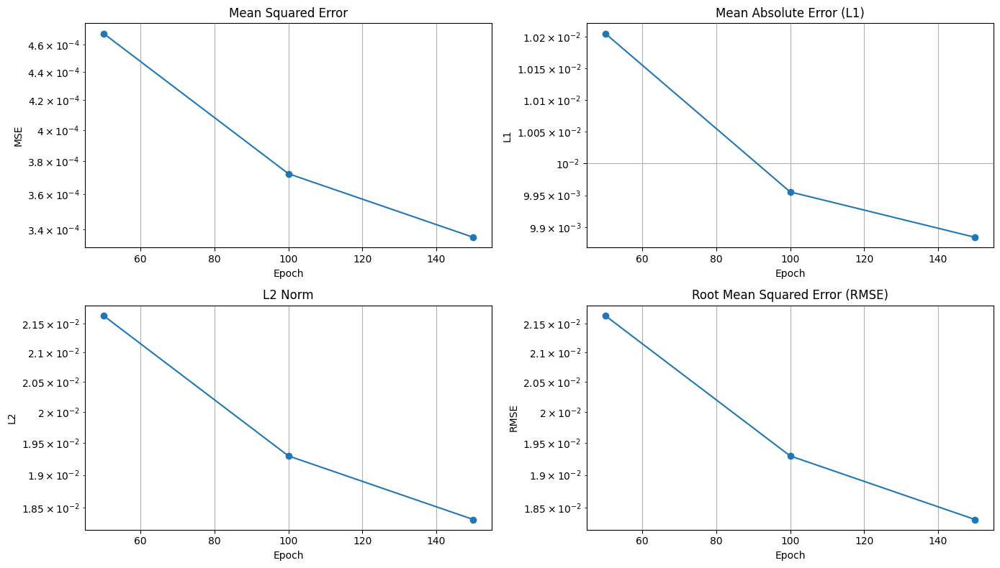

12/12 ━━━━━━━━━━━━━━━━━━━━ 3s 236ms/step - loss: 3.2358e-04 - val_loss: 3.3563e-04
Epoch 151/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.9630e-04 - val_loss: 3.3650e-04
Epoch 152/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.8960e-04 - val_loss: 3.3483e-04
Epoch 153/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 2.8314e-04 - val_loss: 3.3486e-04
Epoch 154/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 3.0970e-04 - val_loss: 3.3534e-04
Epoch 155/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 3.0296e-04 - val_loss: 3.3812e-04
Epoch 156/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 2.6667e-04 - val_loss: 3.3585e-04
Epoch 157/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 2.8528e-04 - val_loss: 3.3484e-04
Epoch 158/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - loss: 2.6921e-04 - val_loss: 3.3526e-04
Epoch 159/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - loss: 2.9029e-04 - val_loss: 3.3625e-04
Epoch 160/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step

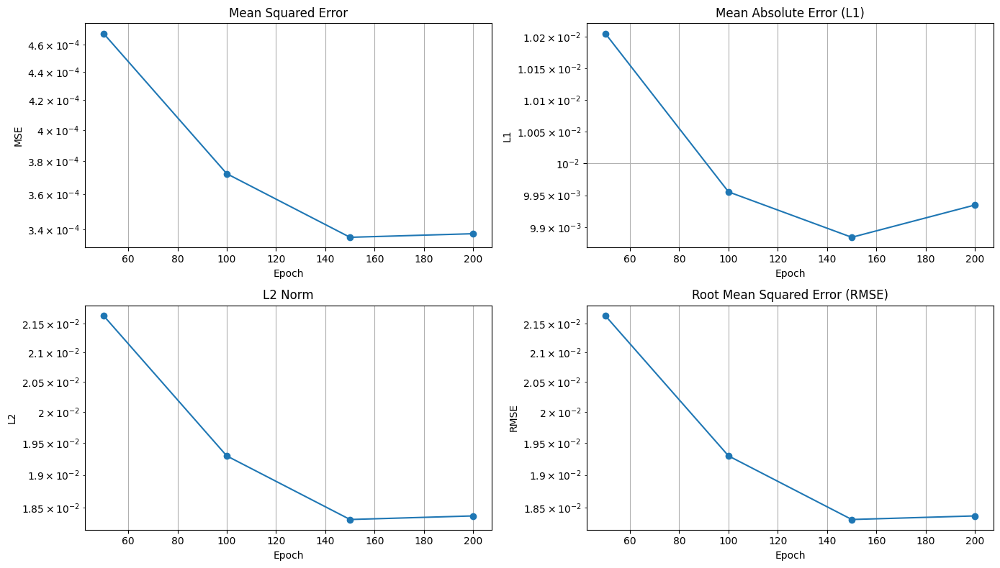

12/12 ━━━━━━━━━━━━━━━━━━━━ 3s 282ms/step - loss: 2.2438e-04 - val_loss: 3.3761e-04
Epoch 201/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 2.3726e-04 - val_loss: 3.3228e-04
Epoch 202/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.4584e-04 - val_loss: 3.3274e-04
Epoch 203/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.3692e-04 - val_loss: 3.3182e-04
Epoch 204/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.3320e-04 - val_loss: 3.3183e-04
Epoch 205/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.6137e-04 - val_loss: 3.3206e-04
Epoch 206/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 2.4799e-04 - val_loss: 3.3069e-04
Epoch 207/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.5363e-04 - val_loss: 3.3180e-04
Epoch 208/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.3270e-04 - val_loss: 3.3481e-04
Epoch 209/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.3301e-04 - val_loss: 3.3292e-04
Epoch 210/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step

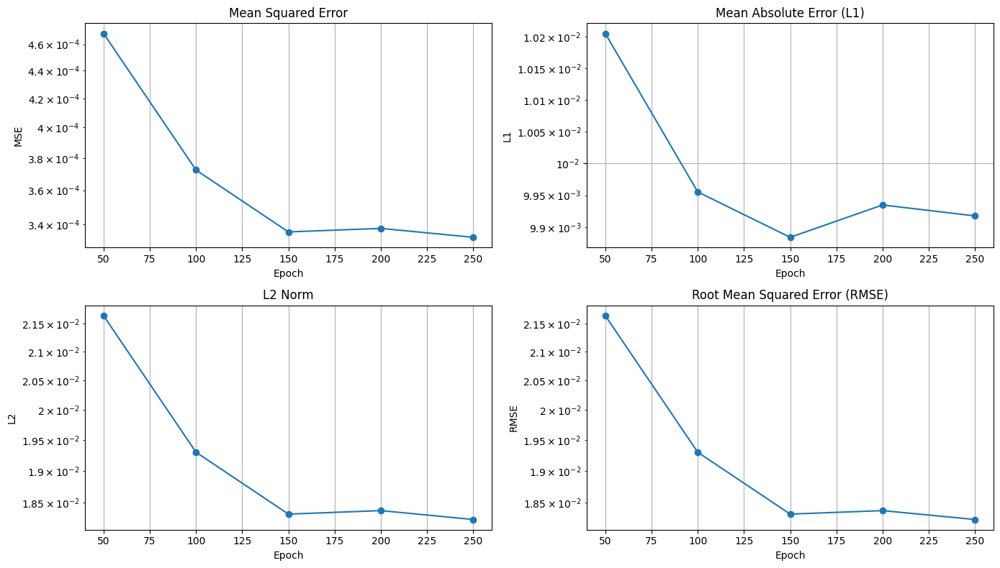

12/12 ━━━━━━━━━━━━━━━━━━━━ 3s 248ms/step - loss: 2.4309e-04 - val_loss: 3.3260e-04
Epoch 251/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - loss: 2.2216e-04 - val_loss: 3.3669e-04
Epoch 252/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.3243e-04 - val_loss: 3.3348e-04
Epoch 253/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.1250e-04 - val_loss: 3.3446e-04
Epoch 254/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.3647e-04 - val_loss: 3.3276e-04
Epoch 255/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2.1257e-04 - val_loss: 3.3291e-04
Epoch 256/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2.1868e-04 - val_loss: 3.3983e-04
Epoch 257/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.1828e-04 - val_loss: 3.3503e-04
Epoch 258/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2.0968e-04 - val_loss: 3.3627e-04
Epoch 259/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.2152e-04 - val_loss: 3.3866e-04
Epoch 260/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step

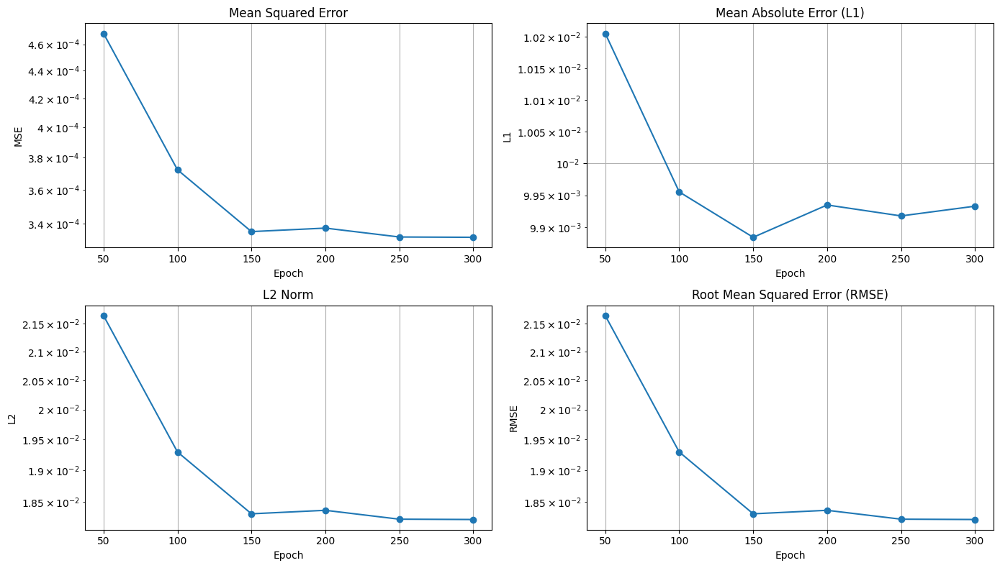

12/12 ━━━━━━━━━━━━━━━━━━━━ 3s 241ms/step - loss: 2.2057e-04 - val_loss: 3.3243e-04
Epoch 301/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 2.1829e-04 - val_loss: 3.2925e-04
Epoch 302/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.1165e-04 - val_loss: 3.2694e-04
Epoch 303/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 2.1675e-04 - val_loss: 3.3048e-04
Epoch 304/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 2.1375e-04 - val_loss: 3.4034e-04
Epoch 305/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 2.2486e-04 - val_loss: 3.3612e-04
Epoch 306/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - loss: 2.1920e-04 - val_loss: 3.3207e-04
Epoch 307/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.0963e-04 - val_loss: 3.2728e-04
Epoch 308/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 2.1826e-04 - val_loss: 3.2973e-04
Epoch 309/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 2.1206e-04 - val_loss: 3.2971e-04
Epoch 310/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step

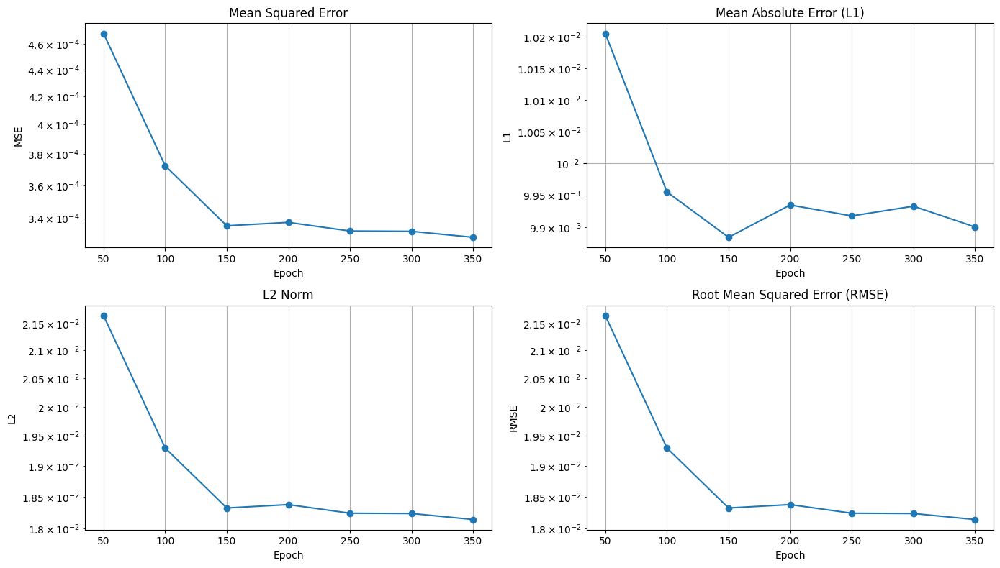

12/12 ━━━━━━━━━━━━━━━━━━━━ 3s 299ms/step - loss: 2.1537e-04 - val_loss: 3.2900e-04
Epoch 351/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - loss: 2.1622e-04 - val_loss: 3.2765e-04
Epoch 352/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 2.1572e-04 - val_loss: 3.3610e-04
Epoch 353/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 2.2671e-04 - val_loss: 3.3460e-04
Epoch 354/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.1318e-04 - val_loss: 3.3228e-04
Epoch 355/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.2763e-04 - val_loss: 3.3668e-04
Epoch 356/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 2.2244e-04 - val_loss: 3.3175e-04
Epoch 357/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.1236e-04 - val_loss: 3.3061e-04
Epoch 358/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.6010e-04 - val_loss: 3.3146e-04
Epoch 359/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.1885e-04 - val_loss: 3.3052e-04
Epoch 360/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step

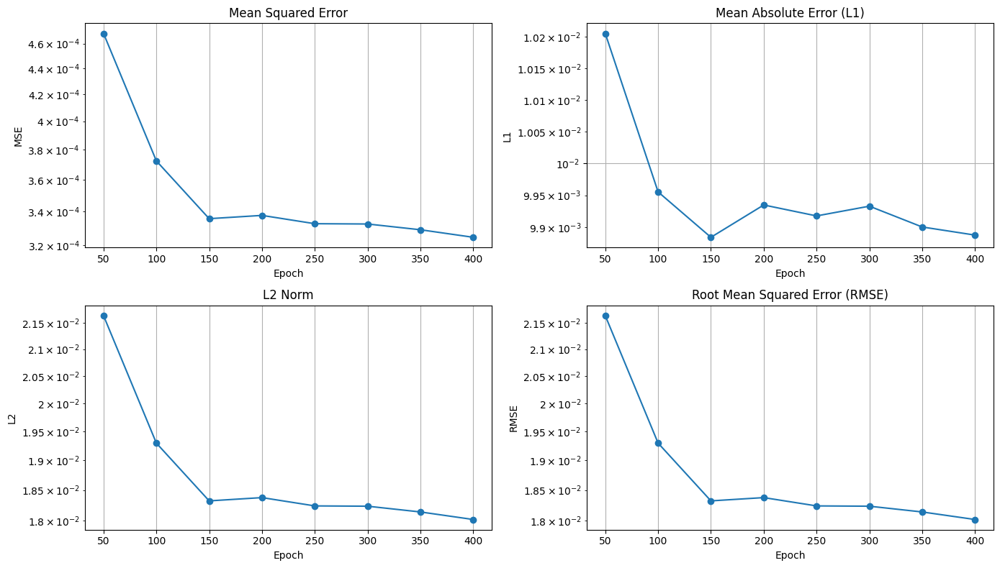

12/12 ━━━━━━━━━━━━━━━━━━━━ 3s 266ms/step - loss: 2.1474e-04 - val_loss: 3.2456e-04
Epoch 401/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 2.2141e-04 - val_loss: 3.2677e-04
Epoch 402/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.2515e-04 - val_loss: 3.2130e-04
Epoch 403/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.2335e-04 - val_loss: 3.2655e-04
Epoch 404/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 2.2706e-04 - val_loss: 3.2536e-04
Epoch 405/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.0581e-04 - val_loss: 3.2249e-04
Epoch 406/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.2249e-04 - val_loss: 3.2313e-04
Epoch 407/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 2.2229e-04 - val_loss: 3.2873e-04
Epoch 408/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.1137e-04 - val_loss: 3.2519e-04
Epoch 409/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.1338e-04 - val_loss: 3.2179e-04
Epoch 410/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step

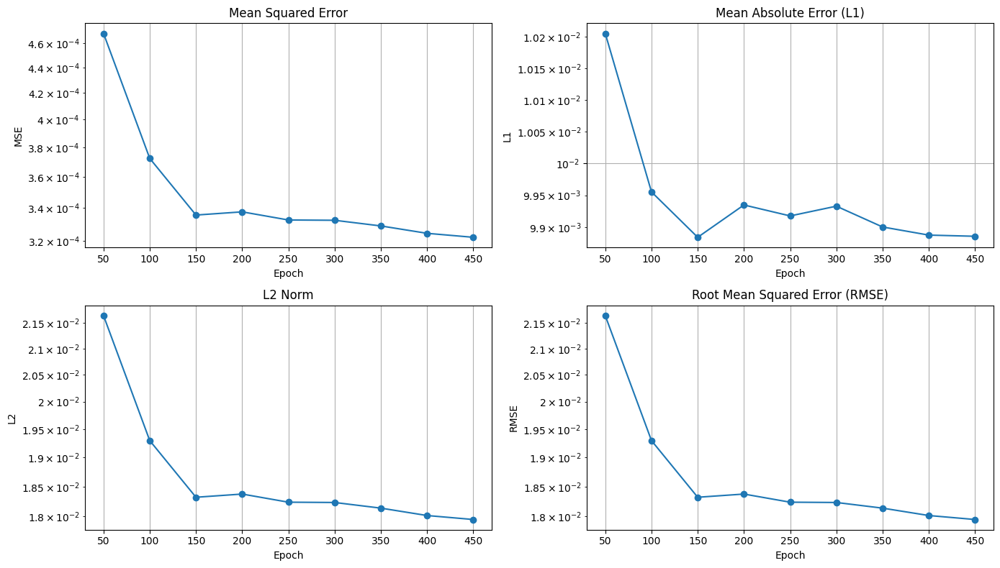

12/12 ━━━━━━━━━━━━━━━━━━━━ 3s 255ms/step - loss: 2.1777e-04 - val_loss: 3.2220e-04
Epoch 451/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 2.0903e-04 - val_loss: 3.2128e-04
Epoch 452/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.1394e-04 - val_loss: 3.1999e-04
Epoch 453/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 2.2761e-04 - val_loss: 3.2119e-04
Epoch 454/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.1547e-04 - val_loss: 3.1937e-04
Epoch 455/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.2233e-04 - val_loss: 3.1849e-04
Epoch 456/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.0665e-04 - val_loss: 3.2092e-04
Epoch 457/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 2.3018e-04 - val_loss: 3.2292e-04
Epoch 458/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 2.0706e-04 - val_loss: 3.2532e-04
Epoch 459/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.2029e-04 - val_loss: 3.2335e-04
Epoch 460/500
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step

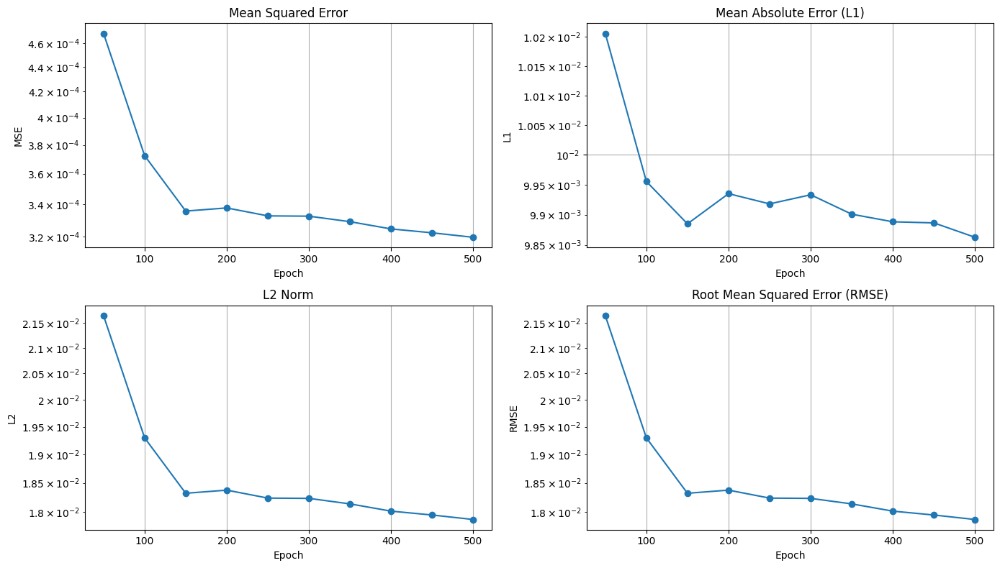

12/12 ━━━━━━━━━━━━━━━━━━━━ 3s 236ms/step - loss: 2.0772e-04 - val_loss: 3.1950e-04


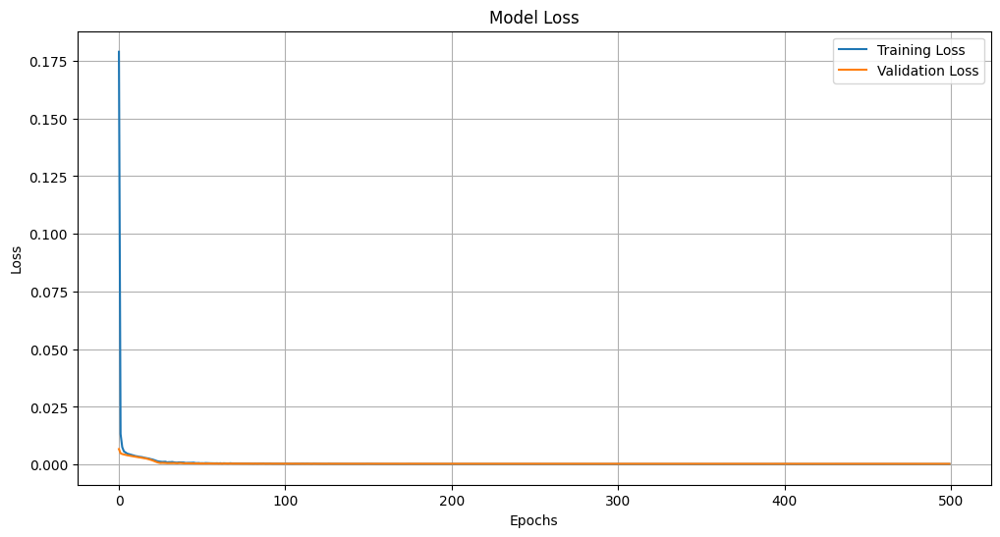

In [60]:
create_modelm1,final_epochm1, final_msem1, final_lm11, final_lm21, final_rmsem1, training_timem1,X_testm1,y_testm1=create_model(ruidom1.shape[1], psdsm1.shape[1],ruidom1,psdsm1)
create_modelm2,final_epochm2, final_msem2, final_lm12, final_lm22, final_rmsem2, training_timem2,X_testm2,y_testm2=create_model(ruidom2.shape[1], psdsm2.shape[1],ruidom2,psdsm2)
create_modelm3,final_epochm3, final_msem3, final_lm13, final_lm23, final_rmsem3, training_timem3,X_testm3,y_testm3=create_model(ruidom3.shape[1], psdsm3.shape[1],ruidom3,psdsm3)
create_modelm4,final_epochm4, final_msem4, final_lm14, final_lm24, final_rmsem4, training_timem4,X_testm4,y_testm4=create_model(ruidom4.shape[1], psdsm4.shape[1],ruidom4,psdsm4)
create_modelm5,final_epochm5, final_msem5, final_lm15, final_lm25, final_rmsem5, training_timem5,X_testm5,y_testm5=create_model(ruidom5.shape[1], psdsm5.shape[1],ruidom5,psdsm5)
create_modelm6,final_epochm6, final_msem6, final_lm16, final_lm26, final_rmsem6, training_timem6,X_testm6,y_testm6=create_model(ruidom6.shape[1], psdsm6.shape[1],ruidom6,psdsm6)

In [61]:
plotear_tablas(final_epochm1, final_msem1, final_lm11, final_lm21, final_rmsem1, training_timem1)
plotear_tablas(final_epochm2, final_msem2, final_lm12, final_lm22, final_rmsem2, training_timem2)
plotear_tablas(final_epochm3, final_msem3, final_lm13, final_lm23, final_rmsem3, training_timem3)
plotear_tablas(final_epochm4, final_msem4, final_lm14, final_lm24, final_rmsem4, training_timem4)
plotear_tablas(final_epochm5, final_msem5, final_lm15, final_lm25, final_rmsem5, training_timem5)
plotear_tablas(final_epochm6, final_msem6, final_lm16, final_lm26, final_rmsem6, training_timem6 )



Final Metrics:
Metric     Value     
--------------------
Epoch      500       
MSE        0.0088    
L1         0.0447    
L2         0.0939    
RMSE       0.0939    
Training Time 115.13     seconds

Final Metrics:
Metric     Value     
--------------------
Epoch      500       
MSE        0.0003    
L1         0.0109    
L2         0.0185    
RMSE       0.0185    
Training Time 110.56     seconds

Final Metrics:
Metric     Value     
--------------------
Epoch      500       
MSE        0.0005    
L1         0.0107    
L2         0.0216    
RMSE       0.0216    
Training Time 121.60     seconds

Final Metrics:
Metric     Value     
--------------------
Epoch      500       
MSE        0.0007    
L1         0.0123    
L2         0.0260    
RMSE       0.0260    
Training Time 119.81     seconds

Final Metrics:
Metric     Value     
--------------------
Epoch      500       
MSE        0.0003    
L1         0.0099    
L2         0.0175    
RMSE       0.0175    
Training Time 159.30   

Eficacia de la detección (%): {1: 83.1, 3: 82.6, 5: 50.3}
Error de detección (%): {1: 16.900000000000002, 3: 17.4, 5: 49.7}
Eficacia total de la detección (%): 72.0
Error total de detección (%): 28.000000000000004


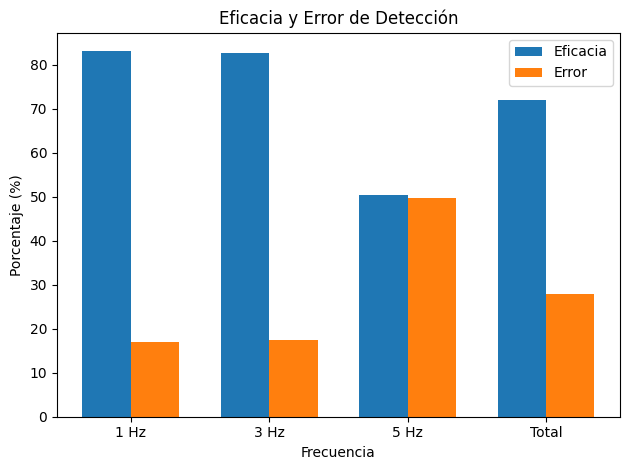

In [78]:
def main():
    resultados = realizar_experimento()
    metricas = calcular_eficacia(resultados)

    print("Eficacia de la detección (%):", metricas['eficacia'])
    print("Error de detección (%):", metricas['error'])
    print("Eficacia total de la detección (%):", metricas['eficacia_total'])
    print("Error total de detección (%):", metricas['error_total'])

    graficar_eficacia(metricas)

if __name__ == "__main__":
    main()


In [33]:
psd_preds11.shape

(39, 257)

In [34]:
y_test1.shape

(39, 257)

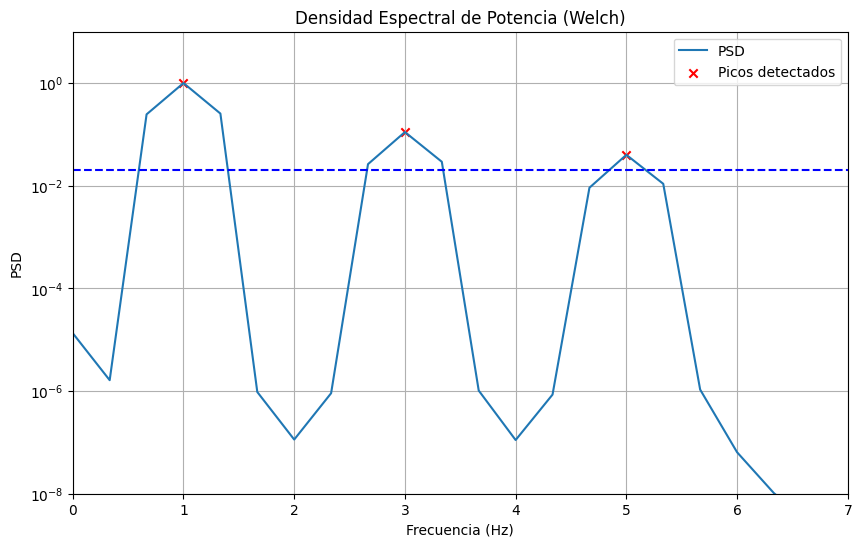

In [51]:
calculados=calculados.squeeze()
frec=frec.squeeze()
peak_freqs,peak_psd_values,min_peak_value=umbral_error(calculados,frec)
ploteo_umbral(calculados,frec,peak_freqs,peak_psd_values,min_peak_value)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━

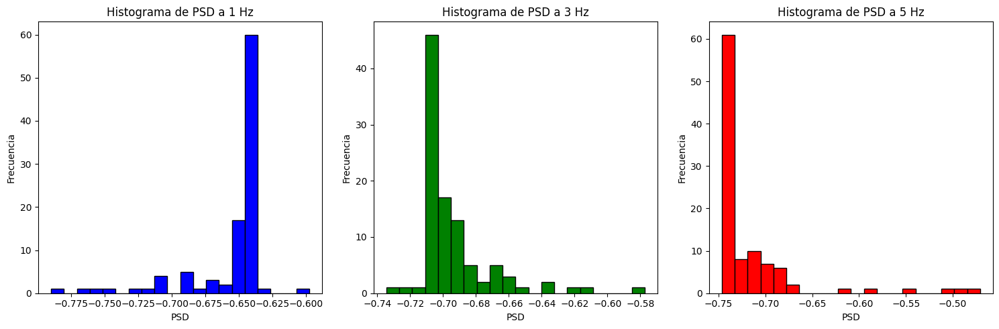

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Suponiendo que ya tienes el modelo entrenado y definido como 'model'

# Número de puntos en cada señal (esto debe coincidir con el valor que usaste para entrenar el modelo)
M_points_signal = 512  # Ajusta esto al valor correcto que estés utilizando

# Frecuencias básicas para las componentes sinusoidales
frecuencia1 = 1  # 1 Hz
frecuencia3 = 3  # 3 Hz
frecuencia5 = 5  # 5 Hz

# Frecuencia de muestreo
sampling_rate = 100  # Hz

# Tiempo correspondiente a cada punto
t = np.linspace(0, M_points_signal / sampling_rate, M_points_signal)

# Generar las 100 señales
new_signals = []

for _ in range(100):
    # Crear una señal con componentes en las frecuencias de interés más algo de ruido
    signal = (np.sin(2 * np.pi * frecuencia1 * t) +
              np.sin(2 * np.pi * frecuencia3 * t) +
              np.sin(2 * np.pi * frecuencia5 * t) +
              np.random.normal(0, 0.5, M_points_signal))

    new_signals.append(signal)

# Convertir la lista a un arreglo numpy
new_signals = np.array(new_signals)

# Ahora 'new_signals' contiene las 100 señales sintéticas
# Inicializar listas para almacenar los valores en las frecuencias 1, 3, y 5 Hz
historial_f1 = []
historial_f3 = []
historial_f5 = []

# Realizar predicciones sobre las 100 nuevas señales
for i in range(len(new_signals)):
    # Obtener la predicción del modelo para la muestra i-ésima
    predicted_psd = create_model.predict(np.expand_dims(new_signals[i], axis=0))

    # Extraer los valores correspondientes a las frecuencias de interés
    for freq_val in [1, 3, 5]:
        idx = np.argmin(np.abs(frec - freq_val))
        valor_psd = predicted_psd[0][idx]  # El valor de la PSD en la frecuencia deseada

        # Almacenar los valores en las listas correspondientes
        if freq_val == 1:
            historial_f1.append(valor_psd)
        elif freq_val == 3:
            historial_f3.append(valor_psd)
        elif freq_val == 5:
            historial_f5.append(valor_psd)

# Ahora que tenemos los valores guardados, graficamos los histogramas

plt.figure(figsize=(15, 5))

# Histograma para la frecuencia de 1 Hz
plt.subplot(1, 3, 1)
plt.hist(historial_f1, bins=20, color='blue', edgecolor='black')
plt.title('Histograma de PSD a 1 Hz')
plt.xlabel('PSD')
plt.ylabel('Frecuencia')

# Histograma para la frecuencia de 3 Hz
plt.subplot(1, 3, 2)
plt.hist(historial_f3, bins=20, color='green', edgecolor='black')
plt.title('Histograma de PSD a 3 Hz')
plt.xlabel('PSD')
plt.ylabel('Frecuencia')

# Histograma para la frecuencia de 5 Hz
plt.subplot(1, 3, 3)
plt.hist(historial_f5, bins=20, color='red', edgecolor='black')
plt.title('Histograma de PSD a 5 Hz')
plt.xlabel('PSD')
plt.ylabel('Frecuencia')

# Mostrar los histogramas
plt.tight_layout()
plt.show()

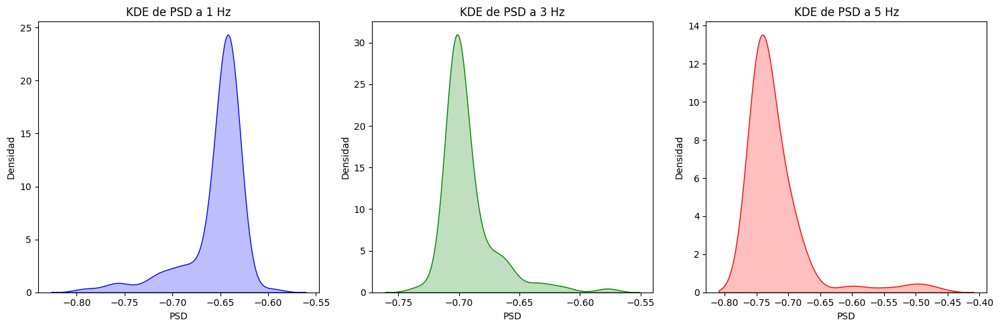

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Supongamos que historial_f1, historial_f3, historial_f5 son tus datos
# Aquí va tu código para preparar los datos si no está hecho aún

plt.figure(figsize=(15, 5))

# KDE para la frecuencia de 1 Hz
plt.subplot(1, 3, 1)
sns.kdeplot(historial_f1, color='blue', fill=True)
plt.title('KDE de PSD a 1 Hz')
plt.xlabel('PSD')
plt.ylabel('Densidad')

# KDE para la frecuencia de 3 Hz
plt.subplot(1, 3, 2)
sns.kdeplot(historial_f3, color='green', fill=True)
plt.title('KDE de PSD a 3 Hz')
plt.xlabel('PSD')
plt.ylabel('Densidad')

# KDE para la frecuencia de 5 Hz
plt.subplot(1, 3, 3)
sns.kdeplot(historial_f5, color='red', fill=True)
plt.title('KDE de PSD a 5 Hz')
plt.xlabel('PSD')
plt.ylabel('Densidad')

# Ajustar diseño para no solaparse
plt.tight_layout()
plt.show()

## Repetir el proceso para LSTM

In [ ]:
# Definir la forma de entrada
output_shape = 513  # Ajusta esto según la salida que necesites
create_model2 = create_model_2(1024,1024//2+1)

# Imprimir el resumen del modelo para verificar
create_model2.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                          │ (None, 1024, 64)            │          16,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 1024, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ (None, 32)                  │          12,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_4 (Dropout)                  │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 513)                 │          16,929 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 46,241 (180.63 KB)

 Trainable params: 46,241 (180.63 KB)

 Non-trainable params: 0 (0.00 B)

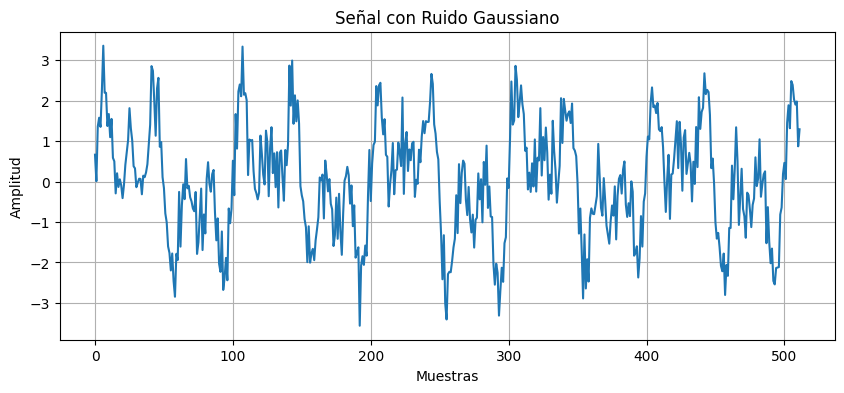

In [ ]:
# Definir parámetros para el ruido
#1024, [0.1, 0.3, 1,3,5,10,30], 50
sigmas = [0.1, 0.3, 1,3,5,10,30]  # niveles de ruido (desviación estándar)
num_repeats = 15  # cantidad de veces que se repite para cada sigma

# Generar ruido
ruido = noise_gaussian(512, sigmas, num_repeats)
señales_con_ruido = signal + ruido

# Visualización de la señal con ruido agregado
plt.figure(figsize=(10, 4))
plt.plot(señales_con_ruido[0])  # mostrar la primera señal con ruido
plt.title('Señal con Ruido Gaussiano')
plt.xlabel('Muestras')
plt.ylabel('Amplitud')
plt.grid(True)
plt.show()

# Frecuencia de muestreo
fs = signal_len / Time

# Calcular PSD utilizando el método de Welch
freqs, psds =calcular_welch_arreglo(señales_con_ruido, fs)


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(señales_con_ruido, psds, test_size=0.3, random_state=42)
modellstm,kl=train_model_with_metrics(create_model2,X_train, y_train, X_test, y_test, epochs=210)

Epoch 1/210


ValueError: Dimensions must be equal, but are 257 and 513 for '{{node compile_loss/mse/sub}} = Sub[T=DT_FLOAT](data_1, sequential_1_1/dense_4_1/Add)' with input shapes: [?,257], [?,513].

In [ ]:
pip install tensorflow

In [ ]:
import tensorflow as tf


In [ ]:
#create_model2.save('create_model2.keras')
create_model2 = tf.keras.models.load_model('create_model2.keras')

In [ ]:
signalprueba=gensenales(1024, 1, 3, 5, 1,1/3 ,1/5, 3, 2*np.pi)
signalprueba = np.reshape(signalprueba, (1, -1))  # Redimensionar a (1, 1024)
psd_preds1 =create_model2.predict(signalprueba)
psd_preds2=create_model2.predict(X_test)
frec,calculados= calcular_welch_arreglo(signalprueba,1024/3)

In [ ]:
psd_preds = psd_preds1.squeeze()  # Si psd_preds tiene forma (1, 350), esto lo convierte en (350,)
frec = frec.squeeze()

# Graficar ambas curvas en el mismo gráfico
plt.figure(figsize=(12, 8))
plt.plot(frec, calculados[0], label='PSD de la señal de prueba original', color='blue')
plt.plot(frec, psd_preds, label='PSD de la señal de prueba predicha', color='red', linestyle='--')
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Densidad Espectral de Potencia (PSD)')
plt.title('Comparación de Densidad Espectral de Potencia (PSD)')
plt.grid(True)
plt.xlim(0, 8)  # Ajusta el rango de frecuencias si es necesario
plt.ylim(0, 1)  # Ajuste de rango de PSD para visualizar mejor
plt.legend()
plt.show()

# Calcular la distancia euclidiana entre los PSDs
# Asegúrate de que los datos sean arrays numpy
calculado = calculados.squeeze()  # Si calculado tiene forma (1, 350), esto lo convierte en (350,)
psd_preds = psd_preds.squeeze()
distancia_euclidiana = np.linalg.norm(calculado - psd_preds)

# Calcular el porcentaje de error
# Se asume que calculado no tiene valores cero para evitar división por cero
error = np.abs((calculados - psd_preds) / (calculados + 1e-10))  # Añadir un pequeño valor para evitar división por cero
porcentaje_error = np.mean(error) * 100

# Imprimir los resultados
print(f"Distancia Euclidiana entre los PSDs: {distancia_euclidiana:.4f}")

In [ ]:
# Predicción de la PSD usando el modelo
predicted_psd = psd_preds  # Ya está en la variable `psd_preds`
frequencies = frec  # Ya está en la variable `frec`

# Establecer un umbral adaptativo basado en el percentil 98
percentil = 98
umbral_adaptativo = np.percentile(predicted_psd, percentil)

# Identificar el índice más cercano al umbral adaptativo para graficar la línea horizontal
umbral_index = np.argmin(np.abs(predicted_psd - umbral_adaptativo))
frecuencia_umbral = frequencies[umbral_index]

# Identificar las posiciones que superan el umbral
indices_sobre_umbral = np.where(predicted_psd > umbral_adaptativo)[0]
frecuencias_sobre_umbral = frequencies[indices_sobre_umbral]
psd_sobre_umbral = predicted_psd[indices_sobre_umbral]

# Visualizar la PSD real y la predicha
plt.figure(figsize=(12, 6))
plt.plot(frequencies, calculado, label='PSD Real', color='yellow')
plt.plot(frequencies, predicted_psd, label='PSD Predicha', color='blue')

# Marcar con 'x' los valores que superan el umbral
plt.scatter(frecuencias_sobre_umbral, psd_sobre_umbral, color='black', marker='x', s=100, label='Sobre Umbral')

plt.xlabel('Frecuencia (Hz)')
plt.ylabel('PSD')
plt.title('Comparación entre la PSD Real y Predicha')
plt.axhline(umbral_adaptativo, color='red', linestyle='--', label=f'Umbral Adaptativo ({percentil}º Percentil)')
plt.legend()
plt.grid(True)
plt.xlim(0, 6)
plt.ylim(10**-9, 10**0.1)
plt.show()

In [ ]:
# Comparación muestra a muestra vs promedio de todas las muestras
avg_pred = np.mean(psd_preds2, axis=0)
avg_real = np.mean(y_test, axis=0)

plt.figure(figsize=(12, 6))
plt.plot(frec, avg_real, label='PSD Real Promedio', color='blue')
plt.plot(frec, avg_pred, label='PSD Predicho Promedio', color='red')
plt.xlabel('Frequency')
plt.ylabel('PSD')
plt.title('Comparación entre PSD Real y Predicha (Promedio de todas las muestras)')
plt.legend()
plt.grid(True)
plt.yscale('log')
plt.xlim(0, 8)
plt.ylim(10**-1, 10**0.4)
plt.show()

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Suponiendo que ya tienes el modelo entrenado y definido como 'model'

# Número de puntos en cada señal (esto debe coincidir con el valor que usaste para entrenar el modelo)
M_points_signal = 1024  # Ajusta esto al valor correcto que estés utilizando

# Frecuencias básicas para las componentes sinusoidales
frecuencia1 = 1  # 1 Hz
frecuencia3 = 3  # 3 Hz
frecuencia5 = 5  # 5 Hz

# Frecuencia de muestreo
sampling_rate = 100  # Hz

# Tiempo correspondiente a cada punto
t = np.linspace(0, M_points_signal / sampling_rate, M_points_signal)

# Generar las 100 señales
new_signals = []

for _ in range(100):
    # Crear una señal con componentes en las frecuencias de interés más algo de ruido
    signal = (np.sin(2 * np.pi * frecuencia1 * t) +
              np.sin(2 * np.pi * frecuencia3 * t) +
              np.sin(2 * np.pi * frecuencia5 * t) +
              np.random.normal(0, 0.5, M_points_signal))

    new_signals.append(signal)

# Convertir la lista a un arreglo numpy
new_signals = np.array(new_signals)

# Ahora 'new_signals' contiene las 100 señales sintéticas
# Inicializar listas para almacenar los valores en las frecuencias 1, 3, y 5 Hz
historial_f1 = []
historial_f3 = []
historial_f5 = []

# Realizar predicciones sobre las 100 nuevas señales
for i in range(len(new_signals)):
    # Obtener la predicción del modelo para la muestra i-ésima
    predicted_psd = create_model2.predict(np.expand_dims(new_signals[i], axis=0))

    # Extraer los valores correspondientes a las frecuencias de interés
    for freq_val in [1, 3, 5]:
        idx = np.argmin(np.abs(frec - freq_val))
        valor_psd = predicted_psd[0][idx]  # El valor de la PSD en la frecuencia deseada

        # Almacenar los valores en las listas correspondientes
        if freq_val == 1:
            historial_f1.append(valor_psd)
        elif freq_val == 3:
            historial_f3.append(valor_psd)
        elif freq_val == 5:
            historial_f5.append(valor_psd)

# Ahora que tenemos los valores guardados, graficamos los histogramas

plt.figure(figsize=(15, 5))

# Histograma para la frecuencia de 1 Hz
plt.subplot(1, 3, 1)
plt.hist(historial_f1, bins=20, color='blue', edgecolor='black')
plt.title('Histograma de PSD a 1 Hz')
plt.xlabel('PSD')
plt.ylabel('Frecuencia')

# Histograma para la frecuencia de 3 Hz
plt.subplot(1, 3, 2)
plt.hist(historial_f3, bins=20, color='green', edgecolor='black')
plt.title('Histograma de PSD a 3 Hz')
plt.xlabel('PSD')
plt.ylabel('Frecuencia')

# Histograma para la frecuencia de 5 Hz
plt.subplot(1, 3, 3)
plt.hist(historial_f5, bins=20, color='red', edgecolor='black')
plt.title('Histograma de PSD a 5 Hz')
plt.xlabel('PSD')
plt.ylabel('Frecuencia')

# Mostrar los histogramas
plt.tight_layout()
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Supongamos que historial_f1, historial_f3, historial_f5 son tus datos
# Aquí va tu código para preparar los datos si no está hecho aún

plt.figure(figsize=(15, 5))

# KDE para la frecuencia de 1 Hz
plt.subplot(1, 3, 1)
sns.kdeplot(historial_f1, color='blue', fill=True)
plt.title('KDE de PSD a 1 Hz')
plt.xlabel('PSD')
plt.ylabel('Densidad')

# KDE para la frecuencia de 3 Hz
plt.subplot(1, 3, 2)
sns.kdeplot(historial_f3, color='green', fill=True)
plt.title('KDE de PSD a 3 Hz')
plt.xlabel('PSD')
plt.ylabel('Densidad')

# KDE para la frecuencia de 5 Hz
plt.subplot(1, 3, 3)
sns.kdeplot(historial_f5, color='red', fill=True)
plt.title('KDE de PSD a 5 Hz')
plt.xlabel('PSD')
plt.ylabel('Densidad')

# Ajustar diseño para no solaparse
plt.tight_layout()
plt.show()